In [1]:
#Import tensorflow

import tensorflow as tf
tf.compat.v1.disable_v2_behavior()
gpu_devices = tf.config.experimental.list_physical_devices("GPU")
for device in gpu_devices:
    tf.config.experimental.set_memory_growth(device, True)

Instructions for updating:
non-resource variables are not supported in the long term


In [2]:
#Test if GPU is found

if tf.test.gpu_device_name():
    print('GPU found')
else:
    print("No GPU found")

GPU found


In [3]:
#Autosaving every 10s

%autosave 10

Autosaving every 10 seconds


In [4]:
#Training & Testing files

xtrain_file = "xtrain.csv"
ytrain_file = "ytrain.csv"
xval_file = "xval.csv"
yval_file = "yval.csv"
xtest_file = "xtest.csv"
ytest_file = "ytest.csv"

In [5]:
import pandas as pd
import numpy as np
import scipy.io
import tensorflow_probability as tfp
import matplotlib as plt
import matplotlib.pyplot as plt
import pickle
import scipy.io as spio
import pickle
from tensorflow.keras import optimizers, regularizers
from tensorflow.keras.models import Sequential, model_from_json, load_model
from tensorflow.keras.layers import Dense, LSTM, Dropout, Masking
tfd = tfp.distributions

In [6]:
# fix random seed for reproducibility

np.random.seed(0)

In [7]:
#load Training & Testing files into Pandas Dataframes

xtrain = pd.read_csv(xtrain_file, index_col=False)
ytrain = pd.read_csv(ytrain_file, index_col=False)
xval = pd.read_csv(xval_file, index_col=False)
yval = pd.read_csv(yval_file, index_col=False)
xtest = pd.read_csv(xtest_file, index_col=False)
ytest = pd.read_csv(ytest_file, index_col=False)

In [8]:
#Load Hyperparameters Obtained by BayesOpt

matlab_file = 'T4_2.mat'
mat = spio.loadmat(matlab_file, squeeze_me=True)
lr = mat['lr']
ep = mat['ep']
epochs = mat['epochs']
batch = mat['batch']
L2 = mat['L2'] 
unit1 = mat['unit'] 
size1 = mat['size']
drop1 = mat['drop']

C:\Users\Asus\anaconda3\lib\site-packages\scipy\io\matlab\mio.py:218: MatReadWarning: Duplicate variable name "None" in stream - replacing previous with new
Consider mio5.varmats_from_mat to split file into single variable files
  matfile_dict = MR.get_variables(variable_names)


In [9]:
#Xtrain to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,4)

In [10]:
#Ytrain to Numpy multidimensional array

ytrain = ytrain.to_numpy()
ytrain = ytrain.reshape(278,24,1)

In [11]:
#Xval to Numpy multidimensional array

xval = xval.to_numpy()
xval = xval.reshape(34,24,4)

In [12]:
#Yval to Numpy multidimensional array

yval = yval.to_numpy()
yval = yval.reshape(34,24,1)

In [13]:
#Xtest to Numpy multidimensional array

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,4)

In [14]:
#Ground truth to Numpy multidimensional array

ytest = ytest.to_numpy()
ytest = ytest.reshape(34,24,1)

In [15]:
#Ytrain2 to Numpy multidimensional array - for SHAP

ytrain2 = np.zeros((278,1))
for i in range(278):
    ytrain2[i] =  ytrain[i][0]
    
ytrain2=ytrain2.reshape(278,)

In [16]:
#Yval2 to Numpy multidimensional array - for SHAP

yval2 = np.zeros((34,1))
for i in range(34):
    yval2[i] =  yval[i][0]
    
yval2 =yval2.reshape(34,)

In [17]:
#Set ytrain, yval for 3 outputs

x_train = xtrain
y_train = [ytrain,ytrain]
x_val = xval
y_val = [yval,yval]
x_test = xtest

In [18]:
import sklearn
import math
from tensorflow.keras import layers
from tensorflow.keras import activations
from tensorflow.keras import callbacks
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, Callback,ReduceLROnPlateau
from tensorflow.keras.layers import Flatten, Reshape
import warnings
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Input, Lambda, concatenate
from tensorflow.keras.models import Model
from IPython.display import display
from sklearn import metrics

In [19]:
#Define trainable prior

def posterior_mean_field(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  c = np.log(np.expm1(1.))
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(2 * n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t[..., :n],
                     scale=1e-5 + tf.nn.softplus(c + t[..., n:])),
          reinterpreted_batch_ndims=1)),
  ])

# Specify the prior over `keras.layers.Dense` `kernel` and `bias`.
def prior_trainable(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t, scale=1),
          reinterpreted_batch_ndims=1)),
  ])

In [20]:
#Define probabilistic LSTM, fx

#LSTM layers

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)

#Output 1 = Aleatoric output layer

layer3 = Dense(1+1)(layer2)
layer4 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t[..., :1],scale=1e-3 + tf.math.softplus(0.05 * t[..., 1:])),name='out1')(layer3) #aleatoric

#Output 2 = Epistemic output layer

layer5 = tfp.layers.DenseVariational(1, posterior_mean_field, prior_trainable)(layer2)
layer6 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t, scale=1),name = 'out2')(layer5)

model = tf.keras.Model(inputs=inputs, outputs=[layer4,layer6])
model.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 24, 4)]      0                                            
__________________________________________________________________________________________________
lstm (LSTM)                     (None, 24, 386)      603704      input_1[0][0]                    
__________________________________________________________________________________________________
dense (Dense)                   (None, 24, 486)      188082      lstm[0][0]                       
__________________________________________________________________________________________________
dense_1 (Dense)                 (None, 24, 2)        974         dense[0][0]                      
_______________________________________________________________________________________

In [21]:
#Define directory for best weights checkpoint

import os
checkpoint_path = "C:/Users/Asus/Desktop/Anomaly Detection/Anomaly-Detection/Consistency/Bayes_Lstm_T4-2/model checkpoint/T4-2_ckpt"
checkpoint_dir = os.path.dirname(checkpoint_path)

#Callback for best weights checkpoint

model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    monitor='val_loss',
    mode='min',
    save_best_only=True,
    verbose = 1)

In [22]:
#Compile model

optimizers.Adam(learning_rate=lr, beta_1 = 0.9,beta_2 = 0.999, epsilon = ep, amsgrad = False, name = "Adam")
negloglik = lambda y, rv_y: -rv_y.log_prob(y)
model.compile(loss = {'out1': negloglik,'out2': negloglik},loss_weights=[0.5,0.5],optimizer= 'Adam')

In [23]:
#Set Tensorboard  

%load_ext tensorboard
import tensorboard
tensorboard.__version__
from datetime import datetime
from tensorflow import keras
# Define the Keras TensorBoard callback.
logdir="logs/fit/" + datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = keras.callbacks.TensorBoard(log_dir=logdir)

In [24]:
# Run training

history = model.fit(x_train, y_train, validation_data = (x_val, y_val), epochs = 5000, batch_size  = batch, verbose = 0, callbacks=[model_checkpoint_callback])

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.

Epoch 00001: val_loss improved from inf to 222513.87500, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_T4-2/model checkpoint\T4-2_ckpt

Epoch 00002: val_loss improved from 222513.87500 to 134402.45312, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_T4-2/model checkpoint\T4-2_ckpt

Epoch 00003: val_loss improved from 134402.45312 to 118353.17969, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_T4-2/model checkpoint\T4-2_ckpt

Epoch 00004: val_loss did not improve from 118353.17969

Epoch 00005: val_loss improved from 118353.17969 to 71454.26562, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_T4-2/model checkpoint\T4-2_ckpt

Epoch 00006: val_loss did not improve from 71454.26562

Epoch 00007: val_loss did not improve from 71454.26562

Epoch 00008: val_loss did not improve from 71454.26562

Epoch 00009: val_loss did not improve from 71454.26562

Epoch 00010: val_lo


Epoch 00107: val_loss did not improve from 3930.10303

Epoch 00108: val_loss did not improve from 3930.10303

Epoch 00109: val_loss did not improve from 3930.10303

Epoch 00110: val_loss did not improve from 3930.10303

Epoch 00111: val_loss improved from 3930.10303 to 3819.98608, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_T4-2/model checkpoint\T4-2_ckpt

Epoch 00112: val_loss did not improve from 3819.98608

Epoch 00113: val_loss did not improve from 3819.98608

Epoch 00114: val_loss did not improve from 3819.98608

Epoch 00115: val_loss improved from 3819.98608 to 3607.43945, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_T4-2/model checkpoint\T4-2_ckpt

Epoch 00116: val_loss did not improve from 3607.43945

Epoch 00117: val_loss did not improve from 3607.43945

Epoch 00118: val_loss did not improve from 3607.43945

Epoch 00119: val_loss did not improve from 3607.43945

Epoch 00120: val_loss did not improve from 3607.43945

Epoch 00121: val_loss did not improve from 3607.439


Epoch 00236: val_loss did not improve from 2148.77417

Epoch 00237: val_loss improved from 2148.77417 to 2099.74512, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_T4-2/model checkpoint\T4-2_ckpt

Epoch 00238: val_loss did not improve from 2099.74512

Epoch 00239: val_loss did not improve from 2099.74512

Epoch 00240: val_loss did not improve from 2099.74512

Epoch 00241: val_loss did not improve from 2099.74512

Epoch 00242: val_loss did not improve from 2099.74512

Epoch 00243: val_loss did not improve from 2099.74512

Epoch 00244: val_loss improved from 2099.74512 to 2039.65076, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_T4-2/model checkpoint\T4-2_ckpt

Epoch 00245: val_loss improved from 2039.65076 to 1820.89929, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_T4-2/model checkpoint\T4-2_ckpt

Epoch 00246: val_loss did not improve from 1820.89929

Epoch 00247: val_loss did not improve from 1820.89929

Epoch 00248: val_loss did not improve from 1820.89929

Epoch 00249: val_


Epoch 00368: val_loss did not improve from 845.83331

Epoch 00369: val_loss did not improve from 845.83331

Epoch 00370: val_loss did not improve from 845.83331

Epoch 00371: val_loss did not improve from 845.83331

Epoch 00372: val_loss did not improve from 845.83331

Epoch 00373: val_loss did not improve from 845.83331

Epoch 00374: val_loss improved from 845.83331 to 705.02991, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_T4-2/model checkpoint\T4-2_ckpt

Epoch 00375: val_loss improved from 705.02991 to 489.41916, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_T4-2/model checkpoint\T4-2_ckpt

Epoch 00376: val_loss did not improve from 489.41916

Epoch 00377: val_loss did not improve from 489.41916

Epoch 00378: val_loss did not improve from 489.41916

Epoch 00379: val_loss did not improve from 489.41916

Epoch 00380: val_loss did not improve from 489.41916

Epoch 00381: val_loss did not improve from 489.41916

Epoch 00382: val_loss did not improve from 489.41916

Epoch 00383: 


Epoch 00512: val_loss did not improve from 87.80366

Epoch 00513: val_loss did not improve from 87.80366

Epoch 00514: val_loss did not improve from 87.80366

Epoch 00515: val_loss did not improve from 87.80366

Epoch 00516: val_loss did not improve from 87.80366

Epoch 00517: val_loss did not improve from 87.80366

Epoch 00518: val_loss did not improve from 87.80366

Epoch 00519: val_loss did not improve from 87.80366

Epoch 00520: val_loss did not improve from 87.80366

Epoch 00521: val_loss did not improve from 87.80366

Epoch 00522: val_loss did not improve from 87.80366

Epoch 00523: val_loss did not improve from 87.80366

Epoch 00524: val_loss did not improve from 87.80366

Epoch 00525: val_loss did not improve from 87.80366

Epoch 00526: val_loss did not improve from 87.80366

Epoch 00527: val_loss did not improve from 87.80366

Epoch 00528: val_loss did not improve from 87.80366

Epoch 00529: val_loss did not improve from 87.80366

Epoch 00530: val_loss did not improve from 87


Epoch 00662: val_loss did not improve from 15.35699

Epoch 00663: val_loss did not improve from 15.35699

Epoch 00664: val_loss did not improve from 15.35699

Epoch 00665: val_loss did not improve from 15.35699

Epoch 00666: val_loss did not improve from 15.35699

Epoch 00667: val_loss did not improve from 15.35699

Epoch 00668: val_loss did not improve from 15.35699

Epoch 00669: val_loss did not improve from 15.35699

Epoch 00670: val_loss did not improve from 15.35699

Epoch 00671: val_loss did not improve from 15.35699

Epoch 00672: val_loss did not improve from 15.35699

Epoch 00673: val_loss improved from 15.35699 to 12.94948, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_T4-2/model checkpoint\T4-2_ckpt

Epoch 00674: val_loss did not improve from 12.94948

Epoch 00675: val_loss did not improve from 12.94948

Epoch 00676: val_loss did not improve from 12.94948

Epoch 00677: val_loss did not improve from 12.94948

Epoch 00678: val_loss did not improve from 12.94948

Epoch 00679


Epoch 00816: val_loss did not improve from 12.94948

Epoch 00817: val_loss did not improve from 12.94948

Epoch 00818: val_loss did not improve from 12.94948

Epoch 00819: val_loss did not improve from 12.94948

Epoch 00820: val_loss did not improve from 12.94948

Epoch 00821: val_loss did not improve from 12.94948

Epoch 00822: val_loss did not improve from 12.94948

Epoch 00823: val_loss did not improve from 12.94948

Epoch 00824: val_loss did not improve from 12.94948

Epoch 00825: val_loss did not improve from 12.94948

Epoch 00826: val_loss did not improve from 12.94948

Epoch 00827: val_loss did not improve from 12.94948

Epoch 00828: val_loss did not improve from 12.94948

Epoch 00829: val_loss did not improve from 12.94948

Epoch 00830: val_loss did not improve from 12.94948

Epoch 00831: val_loss did not improve from 12.94948

Epoch 00832: val_loss did not improve from 12.94948

Epoch 00833: val_loss did not improve from 12.94948

Epoch 00834: val_loss did not improve from 12


Epoch 00972: val_loss did not improve from 12.94948

Epoch 00973: val_loss did not improve from 12.94948

Epoch 00974: val_loss did not improve from 12.94948

Epoch 00975: val_loss did not improve from 12.94948

Epoch 00976: val_loss did not improve from 12.94948

Epoch 00977: val_loss did not improve from 12.94948

Epoch 00978: val_loss did not improve from 12.94948

Epoch 00979: val_loss did not improve from 12.94948

Epoch 00980: val_loss did not improve from 12.94948

Epoch 00981: val_loss did not improve from 12.94948

Epoch 00982: val_loss did not improve from 12.94948

Epoch 00983: val_loss did not improve from 12.94948

Epoch 00984: val_loss did not improve from 12.94948

Epoch 00985: val_loss did not improve from 12.94948

Epoch 00986: val_loss did not improve from 12.94948

Epoch 00987: val_loss did not improve from 12.94948

Epoch 00988: val_loss did not improve from 12.94948

Epoch 00989: val_loss did not improve from 12.94948

Epoch 00990: val_loss did not improve from 12


Epoch 01127: val_loss did not improve from 12.94948

Epoch 01128: val_loss did not improve from 12.94948

Epoch 01129: val_loss did not improve from 12.94948

Epoch 01130: val_loss did not improve from 12.94948

Epoch 01131: val_loss did not improve from 12.94948

Epoch 01132: val_loss did not improve from 12.94948

Epoch 01133: val_loss did not improve from 12.94948

Epoch 01134: val_loss did not improve from 12.94948

Epoch 01135: val_loss did not improve from 12.94948

Epoch 01136: val_loss did not improve from 12.94948

Epoch 01137: val_loss did not improve from 12.94948

Epoch 01138: val_loss did not improve from 12.94948

Epoch 01139: val_loss did not improve from 12.94948

Epoch 01140: val_loss did not improve from 12.94948

Epoch 01141: val_loss did not improve from 12.94948

Epoch 01142: val_loss did not improve from 12.94948

Epoch 01143: val_loss did not improve from 12.94948

Epoch 01144: val_loss did not improve from 12.94948

Epoch 01145: val_loss did not improve from 12


Epoch 01283: val_loss did not improve from 12.94948

Epoch 01284: val_loss did not improve from 12.94948

Epoch 01285: val_loss did not improve from 12.94948

Epoch 01286: val_loss did not improve from 12.94948

Epoch 01287: val_loss did not improve from 12.94948

Epoch 01288: val_loss did not improve from 12.94948

Epoch 01289: val_loss did not improve from 12.94948

Epoch 01290: val_loss did not improve from 12.94948

Epoch 01291: val_loss did not improve from 12.94948

Epoch 01292: val_loss did not improve from 12.94948

Epoch 01293: val_loss did not improve from 12.94948

Epoch 01294: val_loss did not improve from 12.94948

Epoch 01295: val_loss did not improve from 12.94948

Epoch 01296: val_loss did not improve from 12.94948

Epoch 01297: val_loss did not improve from 12.94948

Epoch 01298: val_loss did not improve from 12.94948

Epoch 01299: val_loss did not improve from 12.94948

Epoch 01300: val_loss did not improve from 12.94948

Epoch 01301: val_loss did not improve from 12


Epoch 01438: val_loss did not improve from 12.94948

Epoch 01439: val_loss did not improve from 12.94948

Epoch 01440: val_loss did not improve from 12.94948

Epoch 01441: val_loss did not improve from 12.94948

Epoch 01442: val_loss did not improve from 12.94948

Epoch 01443: val_loss did not improve from 12.94948

Epoch 01444: val_loss did not improve from 12.94948

Epoch 01445: val_loss did not improve from 12.94948

Epoch 01446: val_loss did not improve from 12.94948

Epoch 01447: val_loss did not improve from 12.94948

Epoch 01448: val_loss did not improve from 12.94948

Epoch 01449: val_loss did not improve from 12.94948

Epoch 01450: val_loss did not improve from 12.94948

Epoch 01451: val_loss did not improve from 12.94948

Epoch 01452: val_loss did not improve from 12.94948

Epoch 01453: val_loss did not improve from 12.94948

Epoch 01454: val_loss did not improve from 12.94948

Epoch 01455: val_loss did not improve from 12.94948

Epoch 01456: val_loss did not improve from 12


Epoch 01591: val_loss did not improve from 12.44030

Epoch 01592: val_loss did not improve from 12.44030

Epoch 01593: val_loss did not improve from 12.44030

Epoch 01594: val_loss did not improve from 12.44030

Epoch 01595: val_loss did not improve from 12.44030

Epoch 01596: val_loss did not improve from 12.44030

Epoch 01597: val_loss did not improve from 12.44030

Epoch 01598: val_loss did not improve from 12.44030

Epoch 01599: val_loss did not improve from 12.44030

Epoch 01600: val_loss did not improve from 12.44030

Epoch 01601: val_loss did not improve from 12.44030

Epoch 01602: val_loss did not improve from 12.44030

Epoch 01603: val_loss did not improve from 12.44030

Epoch 01604: val_loss did not improve from 12.44030

Epoch 01605: val_loss did not improve from 12.44030

Epoch 01606: val_loss did not improve from 12.44030

Epoch 01607: val_loss did not improve from 12.44030

Epoch 01608: val_loss did not improve from 12.44030

Epoch 01609: val_loss did not improve from 12


Epoch 01747: val_loss did not improve from 12.44030

Epoch 01748: val_loss did not improve from 12.44030

Epoch 01749: val_loss did not improve from 12.44030

Epoch 01750: val_loss did not improve from 12.44030

Epoch 01751: val_loss did not improve from 12.44030

Epoch 01752: val_loss did not improve from 12.44030

Epoch 01753: val_loss did not improve from 12.44030

Epoch 01754: val_loss did not improve from 12.44030

Epoch 01755: val_loss did not improve from 12.44030

Epoch 01756: val_loss did not improve from 12.44030

Epoch 01757: val_loss did not improve from 12.44030

Epoch 01758: val_loss did not improve from 12.44030

Epoch 01759: val_loss did not improve from 12.44030

Epoch 01760: val_loss did not improve from 12.44030

Epoch 01761: val_loss did not improve from 12.44030

Epoch 01762: val_loss did not improve from 12.44030

Epoch 01763: val_loss did not improve from 12.44030

Epoch 01764: val_loss did not improve from 12.44030

Epoch 01765: val_loss did not improve from 12


Epoch 01903: val_loss did not improve from 12.44030

Epoch 01904: val_loss did not improve from 12.44030

Epoch 01905: val_loss did not improve from 12.44030

Epoch 01906: val_loss did not improve from 12.44030

Epoch 01907: val_loss did not improve from 12.44030

Epoch 01908: val_loss did not improve from 12.44030

Epoch 01909: val_loss did not improve from 12.44030

Epoch 01910: val_loss did not improve from 12.44030

Epoch 01911: val_loss did not improve from 12.44030

Epoch 01912: val_loss did not improve from 12.44030

Epoch 01913: val_loss did not improve from 12.44030

Epoch 01914: val_loss did not improve from 12.44030

Epoch 01915: val_loss did not improve from 12.44030

Epoch 01916: val_loss did not improve from 12.44030

Epoch 01917: val_loss did not improve from 12.44030

Epoch 01918: val_loss did not improve from 12.44030

Epoch 01919: val_loss did not improve from 12.44030

Epoch 01920: val_loss did not improve from 12.44030

Epoch 01921: val_loss did not improve from 12


Epoch 02059: val_loss did not improve from 12.44030

Epoch 02060: val_loss did not improve from 12.44030

Epoch 02061: val_loss did not improve from 12.44030

Epoch 02062: val_loss did not improve from 12.44030

Epoch 02063: val_loss did not improve from 12.44030

Epoch 02064: val_loss did not improve from 12.44030

Epoch 02065: val_loss did not improve from 12.44030

Epoch 02066: val_loss did not improve from 12.44030

Epoch 02067: val_loss did not improve from 12.44030

Epoch 02068: val_loss did not improve from 12.44030

Epoch 02069: val_loss did not improve from 12.44030

Epoch 02070: val_loss did not improve from 12.44030

Epoch 02071: val_loss did not improve from 12.44030

Epoch 02072: val_loss did not improve from 12.44030

Epoch 02073: val_loss did not improve from 12.44030

Epoch 02074: val_loss did not improve from 12.44030

Epoch 02075: val_loss did not improve from 12.44030

Epoch 02076: val_loss did not improve from 12.44030

Epoch 02077: val_loss did not improve from 12


Epoch 02215: val_loss did not improve from 12.44030

Epoch 02216: val_loss did not improve from 12.44030

Epoch 02217: val_loss did not improve from 12.44030

Epoch 02218: val_loss did not improve from 12.44030

Epoch 02219: val_loss did not improve from 12.44030

Epoch 02220: val_loss did not improve from 12.44030

Epoch 02221: val_loss did not improve from 12.44030

Epoch 02222: val_loss did not improve from 12.44030

Epoch 02223: val_loss did not improve from 12.44030

Epoch 02224: val_loss did not improve from 12.44030

Epoch 02225: val_loss did not improve from 12.44030

Epoch 02226: val_loss did not improve from 12.44030

Epoch 02227: val_loss did not improve from 12.44030

Epoch 02228: val_loss did not improve from 12.44030

Epoch 02229: val_loss did not improve from 12.44030

Epoch 02230: val_loss did not improve from 12.44030

Epoch 02231: val_loss did not improve from 12.44030

Epoch 02232: val_loss did not improve from 12.44030

Epoch 02233: val_loss did not improve from 12


Epoch 02371: val_loss did not improve from 12.44030

Epoch 02372: val_loss did not improve from 12.44030

Epoch 02373: val_loss did not improve from 12.44030

Epoch 02374: val_loss did not improve from 12.44030

Epoch 02375: val_loss did not improve from 12.44030

Epoch 02376: val_loss did not improve from 12.44030

Epoch 02377: val_loss did not improve from 12.44030

Epoch 02378: val_loss did not improve from 12.44030

Epoch 02379: val_loss did not improve from 12.44030

Epoch 02380: val_loss did not improve from 12.44030

Epoch 02381: val_loss did not improve from 12.44030

Epoch 02382: val_loss did not improve from 12.44030

Epoch 02383: val_loss did not improve from 12.44030

Epoch 02384: val_loss did not improve from 12.44030

Epoch 02385: val_loss did not improve from 12.44030

Epoch 02386: val_loss did not improve from 12.44030

Epoch 02387: val_loss did not improve from 12.44030

Epoch 02388: val_loss did not improve from 12.44030

Epoch 02389: val_loss did not improve from 12


Epoch 02527: val_loss did not improve from 12.44030

Epoch 02528: val_loss did not improve from 12.44030

Epoch 02529: val_loss did not improve from 12.44030

Epoch 02530: val_loss did not improve from 12.44030

Epoch 02531: val_loss did not improve from 12.44030

Epoch 02532: val_loss did not improve from 12.44030

Epoch 02533: val_loss did not improve from 12.44030

Epoch 02534: val_loss did not improve from 12.44030

Epoch 02535: val_loss did not improve from 12.44030

Epoch 02536: val_loss did not improve from 12.44030

Epoch 02537: val_loss did not improve from 12.44030

Epoch 02538: val_loss did not improve from 12.44030

Epoch 02539: val_loss did not improve from 12.44030

Epoch 02540: val_loss did not improve from 12.44030

Epoch 02541: val_loss did not improve from 12.44030

Epoch 02542: val_loss did not improve from 12.44030

Epoch 02543: val_loss did not improve from 12.44030

Epoch 02544: val_loss did not improve from 12.44030

Epoch 02545: val_loss did not improve from 12


Epoch 02683: val_loss did not improve from 12.44030

Epoch 02684: val_loss did not improve from 12.44030

Epoch 02685: val_loss did not improve from 12.44030

Epoch 02686: val_loss did not improve from 12.44030

Epoch 02687: val_loss did not improve from 12.44030

Epoch 02688: val_loss did not improve from 12.44030

Epoch 02689: val_loss did not improve from 12.44030

Epoch 02690: val_loss did not improve from 12.44030

Epoch 02691: val_loss did not improve from 12.44030

Epoch 02692: val_loss did not improve from 12.44030

Epoch 02693: val_loss did not improve from 12.44030

Epoch 02694: val_loss did not improve from 12.44030

Epoch 02695: val_loss did not improve from 12.44030

Epoch 02696: val_loss did not improve from 12.44030

Epoch 02697: val_loss did not improve from 12.44030

Epoch 02698: val_loss did not improve from 12.44030

Epoch 02699: val_loss did not improve from 12.44030

Epoch 02700: val_loss did not improve from 12.44030

Epoch 02701: val_loss did not improve from 12


Epoch 02838: val_loss did not improve from 12.44030

Epoch 02839: val_loss did not improve from 12.44030

Epoch 02840: val_loss did not improve from 12.44030

Epoch 02841: val_loss did not improve from 12.44030

Epoch 02842: val_loss did not improve from 12.44030

Epoch 02843: val_loss did not improve from 12.44030

Epoch 02844: val_loss did not improve from 12.44030

Epoch 02845: val_loss did not improve from 12.44030

Epoch 02846: val_loss did not improve from 12.44030

Epoch 02847: val_loss did not improve from 12.44030

Epoch 02848: val_loss did not improve from 12.44030

Epoch 02849: val_loss did not improve from 12.44030

Epoch 02850: val_loss did not improve from 12.44030

Epoch 02851: val_loss did not improve from 12.44030

Epoch 02852: val_loss did not improve from 12.44030

Epoch 02853: val_loss did not improve from 12.44030

Epoch 02854: val_loss did not improve from 12.44030

Epoch 02855: val_loss did not improve from 12.44030

Epoch 02856: val_loss did not improve from 12


Epoch 02994: val_loss did not improve from 12.44030

Epoch 02995: val_loss did not improve from 12.44030

Epoch 02996: val_loss did not improve from 12.44030

Epoch 02997: val_loss did not improve from 12.44030

Epoch 02998: val_loss did not improve from 12.44030

Epoch 02999: val_loss did not improve from 12.44030

Epoch 03000: val_loss did not improve from 12.44030

Epoch 03001: val_loss did not improve from 12.44030

Epoch 03002: val_loss did not improve from 12.44030

Epoch 03003: val_loss did not improve from 12.44030

Epoch 03004: val_loss did not improve from 12.44030

Epoch 03005: val_loss did not improve from 12.44030

Epoch 03006: val_loss did not improve from 12.44030

Epoch 03007: val_loss did not improve from 12.44030

Epoch 03008: val_loss did not improve from 12.44030

Epoch 03009: val_loss did not improve from 12.44030

Epoch 03010: val_loss did not improve from 12.44030

Epoch 03011: val_loss did not improve from 12.44030

Epoch 03012: val_loss did not improve from 12


Epoch 03150: val_loss did not improve from 12.44030

Epoch 03151: val_loss did not improve from 12.44030

Epoch 03152: val_loss did not improve from 12.44030

Epoch 03153: val_loss did not improve from 12.44030

Epoch 03154: val_loss did not improve from 12.44030

Epoch 03155: val_loss did not improve from 12.44030

Epoch 03156: val_loss did not improve from 12.44030

Epoch 03157: val_loss did not improve from 12.44030

Epoch 03158: val_loss did not improve from 12.44030

Epoch 03159: val_loss did not improve from 12.44030

Epoch 03160: val_loss did not improve from 12.44030

Epoch 03161: val_loss did not improve from 12.44030

Epoch 03162: val_loss did not improve from 12.44030

Epoch 03163: val_loss did not improve from 12.44030

Epoch 03164: val_loss did not improve from 12.44030

Epoch 03165: val_loss did not improve from 12.44030

Epoch 03166: val_loss did not improve from 12.44030

Epoch 03167: val_loss did not improve from 12.44030

Epoch 03168: val_loss did not improve from 12


Epoch 03306: val_loss did not improve from 12.44030

Epoch 03307: val_loss did not improve from 12.44030

Epoch 03308: val_loss did not improve from 12.44030

Epoch 03309: val_loss did not improve from 12.44030

Epoch 03310: val_loss did not improve from 12.44030

Epoch 03311: val_loss did not improve from 12.44030

Epoch 03312: val_loss did not improve from 12.44030

Epoch 03313: val_loss did not improve from 12.44030

Epoch 03314: val_loss did not improve from 12.44030

Epoch 03315: val_loss did not improve from 12.44030

Epoch 03316: val_loss did not improve from 12.44030

Epoch 03317: val_loss did not improve from 12.44030

Epoch 03318: val_loss did not improve from 12.44030

Epoch 03319: val_loss did not improve from 12.44030

Epoch 03320: val_loss did not improve from 12.44030

Epoch 03321: val_loss did not improve from 12.44030

Epoch 03322: val_loss did not improve from 12.44030

Epoch 03323: val_loss did not improve from 12.44030

Epoch 03324: val_loss did not improve from 12


Epoch 03462: val_loss did not improve from 12.44030

Epoch 03463: val_loss did not improve from 12.44030

Epoch 03464: val_loss did not improve from 12.44030

Epoch 03465: val_loss did not improve from 12.44030

Epoch 03466: val_loss did not improve from 12.44030

Epoch 03467: val_loss did not improve from 12.44030

Epoch 03468: val_loss did not improve from 12.44030

Epoch 03469: val_loss did not improve from 12.44030

Epoch 03470: val_loss did not improve from 12.44030

Epoch 03471: val_loss did not improve from 12.44030

Epoch 03472: val_loss did not improve from 12.44030

Epoch 03473: val_loss did not improve from 12.44030

Epoch 03474: val_loss did not improve from 12.44030

Epoch 03475: val_loss did not improve from 12.44030

Epoch 03476: val_loss did not improve from 12.44030

Epoch 03477: val_loss did not improve from 12.44030

Epoch 03478: val_loss did not improve from 12.44030

Epoch 03479: val_loss did not improve from 12.44030

Epoch 03480: val_loss did not improve from 12


Epoch 03618: val_loss did not improve from 12.44030

Epoch 03619: val_loss did not improve from 12.44030

Epoch 03620: val_loss did not improve from 12.44030

Epoch 03621: val_loss did not improve from 12.44030

Epoch 03622: val_loss did not improve from 12.44030

Epoch 03623: val_loss did not improve from 12.44030

Epoch 03624: val_loss did not improve from 12.44030

Epoch 03625: val_loss did not improve from 12.44030

Epoch 03626: val_loss did not improve from 12.44030

Epoch 03627: val_loss did not improve from 12.44030

Epoch 03628: val_loss did not improve from 12.44030

Epoch 03629: val_loss did not improve from 12.44030

Epoch 03630: val_loss did not improve from 12.44030

Epoch 03631: val_loss did not improve from 12.44030

Epoch 03632: val_loss did not improve from 12.44030

Epoch 03633: val_loss did not improve from 12.44030

Epoch 03634: val_loss did not improve from 12.44030

Epoch 03635: val_loss did not improve from 12.44030

Epoch 03636: val_loss did not improve from 12


Epoch 03774: val_loss did not improve from 12.44030

Epoch 03775: val_loss did not improve from 12.44030

Epoch 03776: val_loss did not improve from 12.44030

Epoch 03777: val_loss did not improve from 12.44030

Epoch 03778: val_loss did not improve from 12.44030

Epoch 03779: val_loss did not improve from 12.44030

Epoch 03780: val_loss did not improve from 12.44030

Epoch 03781: val_loss did not improve from 12.44030

Epoch 03782: val_loss did not improve from 12.44030

Epoch 03783: val_loss did not improve from 12.44030

Epoch 03784: val_loss did not improve from 12.44030

Epoch 03785: val_loss did not improve from 12.44030

Epoch 03786: val_loss did not improve from 12.44030

Epoch 03787: val_loss did not improve from 12.44030

Epoch 03788: val_loss did not improve from 12.44030

Epoch 03789: val_loss did not improve from 12.44030

Epoch 03790: val_loss did not improve from 12.44030

Epoch 03791: val_loss did not improve from 12.44030

Epoch 03792: val_loss did not improve from 12


Epoch 03930: val_loss did not improve from 12.44030

Epoch 03931: val_loss did not improve from 12.44030

Epoch 03932: val_loss did not improve from 12.44030

Epoch 03933: val_loss did not improve from 12.44030

Epoch 03934: val_loss did not improve from 12.44030

Epoch 03935: val_loss did not improve from 12.44030

Epoch 03936: val_loss did not improve from 12.44030

Epoch 03937: val_loss did not improve from 12.44030

Epoch 03938: val_loss did not improve from 12.44030

Epoch 03939: val_loss did not improve from 12.44030

Epoch 03940: val_loss did not improve from 12.44030

Epoch 03941: val_loss did not improve from 12.44030

Epoch 03942: val_loss did not improve from 12.44030

Epoch 03943: val_loss did not improve from 12.44030

Epoch 03944: val_loss did not improve from 12.44030

Epoch 03945: val_loss did not improve from 12.44030

Epoch 03946: val_loss did not improve from 12.44030

Epoch 03947: val_loss did not improve from 12.44030

Epoch 03948: val_loss did not improve from 12


Epoch 04086: val_loss did not improve from 12.44030

Epoch 04087: val_loss did not improve from 12.44030

Epoch 04088: val_loss did not improve from 12.44030

Epoch 04089: val_loss did not improve from 12.44030

Epoch 04090: val_loss did not improve from 12.44030

Epoch 04091: val_loss did not improve from 12.44030

Epoch 04092: val_loss did not improve from 12.44030

Epoch 04093: val_loss did not improve from 12.44030

Epoch 04094: val_loss did not improve from 12.44030

Epoch 04095: val_loss did not improve from 12.44030

Epoch 04096: val_loss did not improve from 12.44030

Epoch 04097: val_loss did not improve from 12.44030

Epoch 04098: val_loss did not improve from 12.44030

Epoch 04099: val_loss did not improve from 12.44030

Epoch 04100: val_loss did not improve from 12.44030

Epoch 04101: val_loss did not improve from 12.44030

Epoch 04102: val_loss did not improve from 12.44030

Epoch 04103: val_loss did not improve from 12.44030

Epoch 04104: val_loss did not improve from 12


Epoch 04242: val_loss did not improve from 12.44030

Epoch 04243: val_loss did not improve from 12.44030

Epoch 04244: val_loss did not improve from 12.44030

Epoch 04245: val_loss did not improve from 12.44030

Epoch 04246: val_loss did not improve from 12.44030

Epoch 04247: val_loss did not improve from 12.44030

Epoch 04248: val_loss did not improve from 12.44030

Epoch 04249: val_loss did not improve from 12.44030

Epoch 04250: val_loss did not improve from 12.44030

Epoch 04251: val_loss did not improve from 12.44030

Epoch 04252: val_loss did not improve from 12.44030

Epoch 04253: val_loss did not improve from 12.44030

Epoch 04254: val_loss did not improve from 12.44030

Epoch 04255: val_loss did not improve from 12.44030

Epoch 04256: val_loss did not improve from 12.44030

Epoch 04257: val_loss did not improve from 12.44030

Epoch 04258: val_loss did not improve from 12.44030

Epoch 04259: val_loss did not improve from 12.44030

Epoch 04260: val_loss did not improve from 12


Epoch 04398: val_loss did not improve from 12.44030

Epoch 04399: val_loss did not improve from 12.44030

Epoch 04400: val_loss did not improve from 12.44030

Epoch 04401: val_loss did not improve from 12.44030

Epoch 04402: val_loss did not improve from 12.44030

Epoch 04403: val_loss did not improve from 12.44030

Epoch 04404: val_loss did not improve from 12.44030

Epoch 04405: val_loss did not improve from 12.44030

Epoch 04406: val_loss did not improve from 12.44030

Epoch 04407: val_loss did not improve from 12.44030

Epoch 04408: val_loss did not improve from 12.44030

Epoch 04409: val_loss did not improve from 12.44030

Epoch 04410: val_loss did not improve from 12.44030

Epoch 04411: val_loss did not improve from 12.44030

Epoch 04412: val_loss did not improve from 12.44030

Epoch 04413: val_loss did not improve from 12.44030

Epoch 04414: val_loss did not improve from 12.44030

Epoch 04415: val_loss did not improve from 12.44030

Epoch 04416: val_loss did not improve from 12


Epoch 04554: val_loss did not improve from 12.44030

Epoch 04555: val_loss did not improve from 12.44030

Epoch 04556: val_loss did not improve from 12.44030

Epoch 04557: val_loss did not improve from 12.44030

Epoch 04558: val_loss did not improve from 12.44030

Epoch 04559: val_loss did not improve from 12.44030

Epoch 04560: val_loss did not improve from 12.44030

Epoch 04561: val_loss did not improve from 12.44030

Epoch 04562: val_loss did not improve from 12.44030

Epoch 04563: val_loss did not improve from 12.44030

Epoch 04564: val_loss did not improve from 12.44030

Epoch 04565: val_loss did not improve from 12.44030

Epoch 04566: val_loss did not improve from 12.44030

Epoch 04567: val_loss did not improve from 12.44030

Epoch 04568: val_loss did not improve from 12.44030

Epoch 04569: val_loss did not improve from 12.44030

Epoch 04570: val_loss did not improve from 12.44030

Epoch 04571: val_loss did not improve from 12.44030

Epoch 04572: val_loss did not improve from 12


Epoch 04710: val_loss did not improve from 12.44030

Epoch 04711: val_loss did not improve from 12.44030

Epoch 04712: val_loss did not improve from 12.44030

Epoch 04713: val_loss did not improve from 12.44030

Epoch 04714: val_loss did not improve from 12.44030

Epoch 04715: val_loss did not improve from 12.44030

Epoch 04716: val_loss did not improve from 12.44030

Epoch 04717: val_loss did not improve from 12.44030

Epoch 04718: val_loss did not improve from 12.44030

Epoch 04719: val_loss did not improve from 12.44030

Epoch 04720: val_loss did not improve from 12.44030

Epoch 04721: val_loss did not improve from 12.44030

Epoch 04722: val_loss did not improve from 12.44030

Epoch 04723: val_loss did not improve from 12.44030

Epoch 04724: val_loss did not improve from 12.44030

Epoch 04725: val_loss did not improve from 12.44030

Epoch 04726: val_loss did not improve from 12.44030

Epoch 04727: val_loss did not improve from 12.44030

Epoch 04728: val_loss did not improve from 12


Epoch 04866: val_loss did not improve from 12.44030

Epoch 04867: val_loss did not improve from 12.44030

Epoch 04868: val_loss did not improve from 12.44030

Epoch 04869: val_loss did not improve from 12.44030

Epoch 04870: val_loss did not improve from 12.44030

Epoch 04871: val_loss did not improve from 12.44030

Epoch 04872: val_loss did not improve from 12.44030

Epoch 04873: val_loss did not improve from 12.44030

Epoch 04874: val_loss did not improve from 12.44030

Epoch 04875: val_loss did not improve from 12.44030

Epoch 04876: val_loss did not improve from 12.44030

Epoch 04877: val_loss did not improve from 12.44030

Epoch 04878: val_loss did not improve from 12.44030

Epoch 04879: val_loss did not improve from 12.44030

Epoch 04880: val_loss did not improve from 12.44030

Epoch 04881: val_loss did not improve from 12.44030

Epoch 04882: val_loss did not improve from 12.44030

Epoch 04883: val_loss did not improve from 12.44030

Epoch 04884: val_loss did not improve from 12

In [24]:
#Load best weights into model

import os
os.listdir(checkpoint_dir)
model.load_weights(checkpoint_path)

In [25]:
#SHAP cannot be used with model with probabilistic layers. So, define non probabilistic f'x

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model2 = tf.keras.Model(inputs=inputs, outputs=layer4)
model2.summary()

Model: "functional_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 24, 4)]           0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 24, 386)           603704    
_________________________________________________________________
dense_2 (Dense)              (None, 24, 486)           188082    
_________________________________________________________________
dense_3 (Dense)              (None, 24, 1)             487       
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 792,273
Trainable params: 792,273
Non-trainable params: 0
_________________________________________________________________


In [26]:
#Extract only "Mean" weights, exclude "Standard Deviation" weights

a = model.layers[3].get_weights()

b = np.zeros((len(a[0]),1))
for x in range(len(a[0])):
    b[x] = a[0][x][0]
    
d = np.zeros(1)
for x in range(1):
    d[x] = a[1][x]
    
c = [b,d]

In [27]:
#Transfer weights from fx to f'x

model2.layers[0].set_weights(model.layers[0].get_weights())
model2.layers[1].set_weights(model.layers[1].get_weights())
model2.layers[2].set_weights(model.layers[2].get_weights())
model2.layers[3].set_weights(c)

In [29]:
#Import SHAP & initialized JS for f'x explanation

import shap
shap.initjs()

In [30]:
#Extract Feature Names

features = pd.read_csv(xtrain_file, index_col=False)
features = np.array(list(features.columns))
features

array(['P1', 'T1', 'N2', 'MF'], dtype='<U2')

In [31]:
#load Training Files into Pandas Dataframes for SHAP Plots

xtrain = pd.read_csv(xtrain_file, index_col=False)


Contribution: [0.27908626 0.48107186 1.1715709  1.09884214]


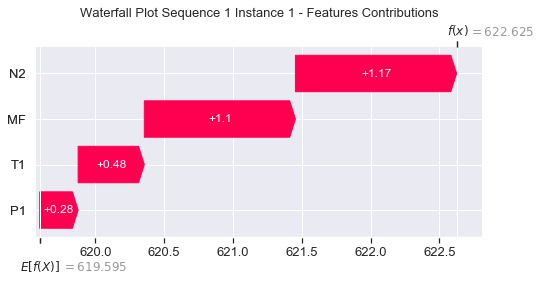

None

Contribution: [0.02245629 0.05144489 0.12512137 0.12567469]


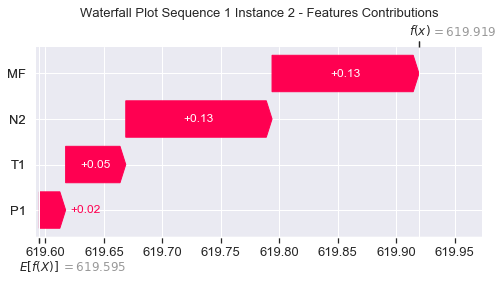

None

Contribution: [0.00174299 0.00662939 0.0460891  0.0542552 ]


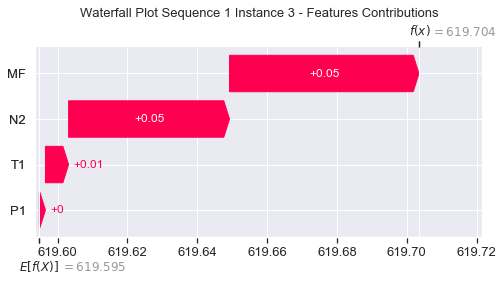

None

Contribution: [0.00531947 0.0065432  0.03185492 0.03281149]


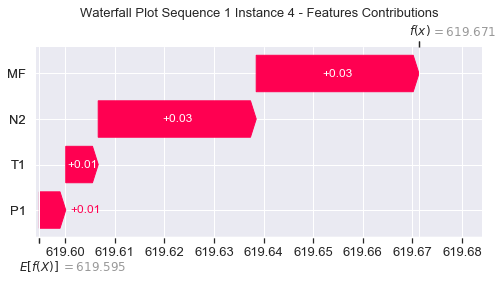

None

Contribution: [0.010703   0.01219476 0.04933869 0.04885816]


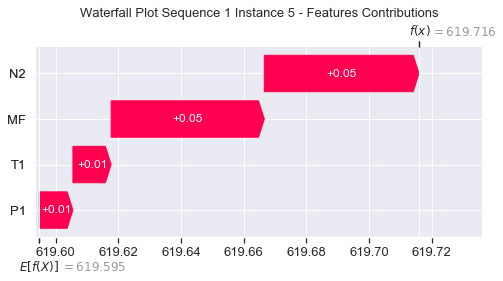

None

Contribution: [0.01255172 0.01348917 0.05451959 0.05373169]


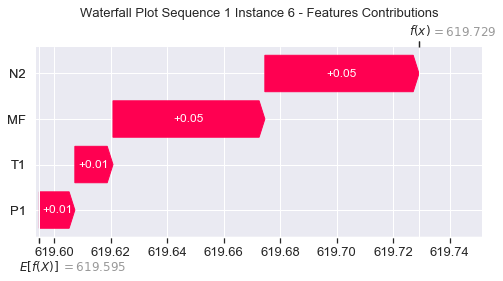

None

Contribution: [0.01352842 0.01445614 0.05734855 0.05636124]


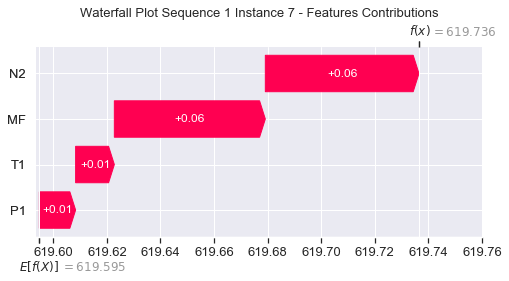

None

Contribution: [0.01423626 0.01504327 0.05899857 0.05770787]


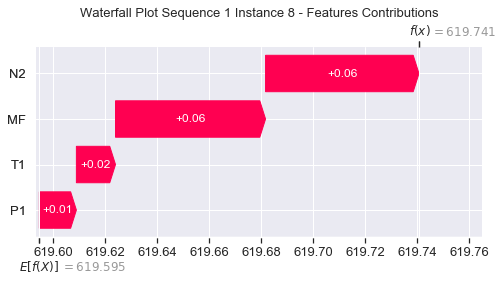

None

Contribution: [0.01468796 0.0170104  0.05980377 0.05889758]


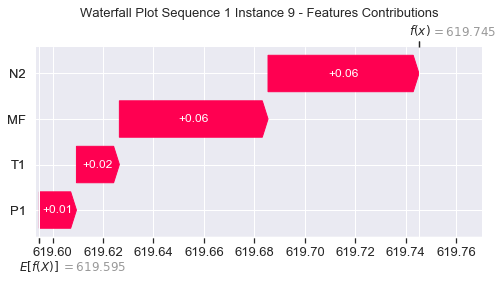

None

Contribution: [0.01490618 0.01671463 0.060758   0.05965107]


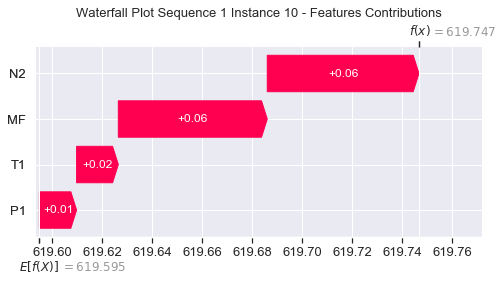

None

Contribution: [0.01596375 0.01763119 0.06282062 0.0610556 ]


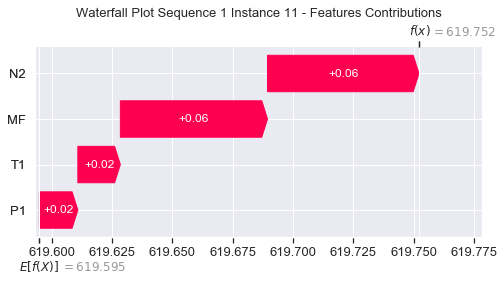

None

Contribution: [0.01660951 0.01771987 0.06619715 0.06389773]


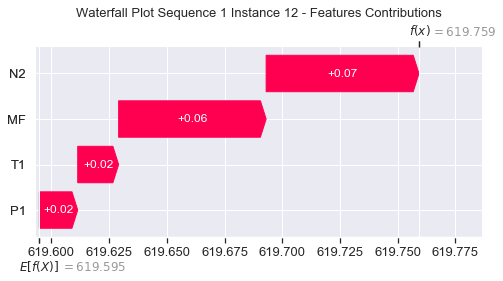

None

Contribution: [0.01834817 0.02015062 0.07198373 0.0692853 ]


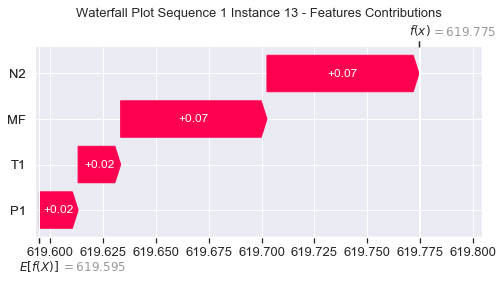

None

Contribution: [0.02156739 0.02285986 0.07984096 0.0765211 ]


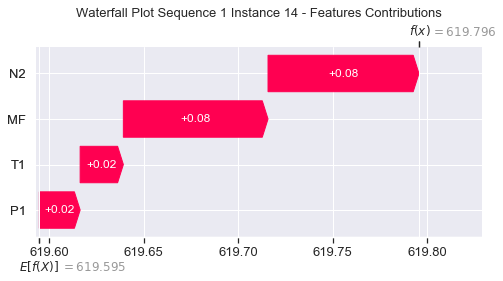

None

Contribution: [0.02405121 0.02665428 0.09044587 0.08690168]


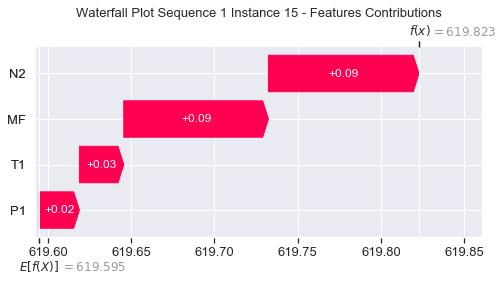

None

Contribution: [0.02772859 0.03161416 0.10400439 0.10202466]


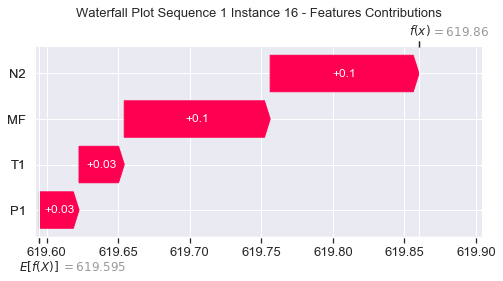

None

Contribution: [0.03334868 0.0382403  0.12122825 0.11655082]


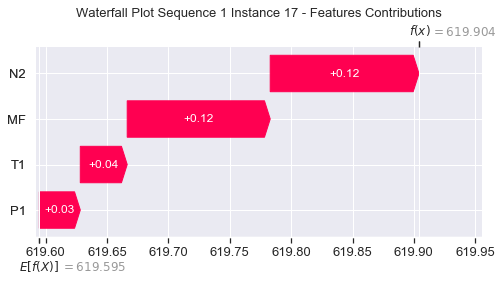

None

Contribution: [0.04014404 0.046109   0.14332195 0.13774322]


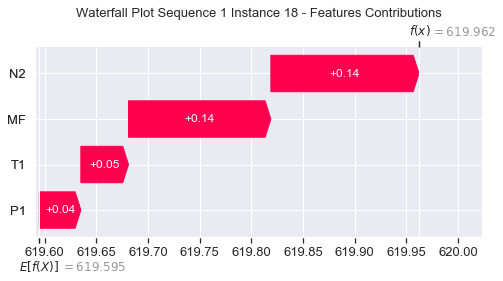

None

Contribution: [0.04764088 0.05643258 0.17243621 0.1667923 ]


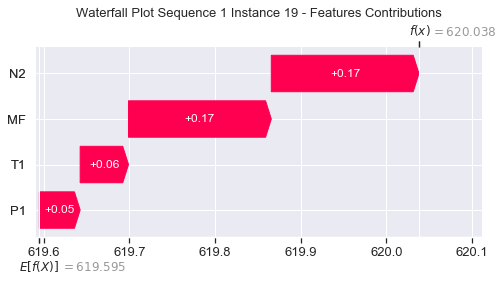

None

Contribution: [0.06003177 0.07116368 0.20937027 0.20166872]


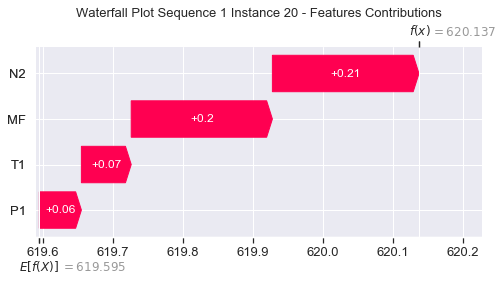

None

Contribution: [0.0751354  0.08859339 0.26018287 0.25108761]


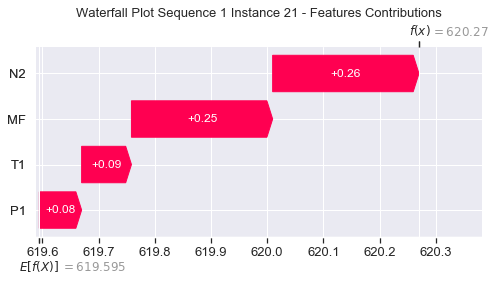

None

Contribution: [0.10133111 0.12471366 0.33368888 0.32027704]


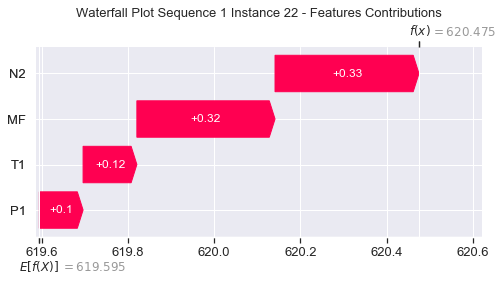

None

Contribution: [0.11707806 0.15121147 0.36935701 0.35474874]


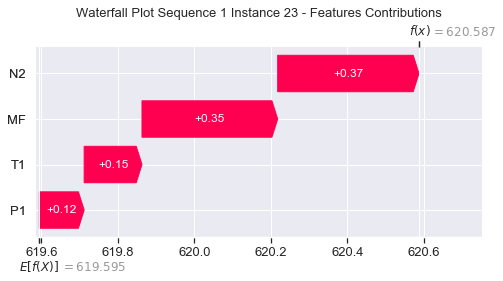

None

Contribution: [ 0.12849295 -0.2202724   1.01324537  1.06270063]


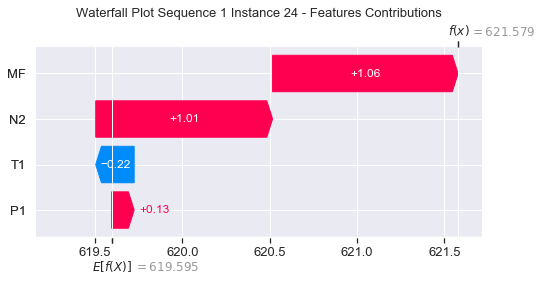

None

Contribution: [0.29766338 0.53639582 1.21255552 1.14735877]


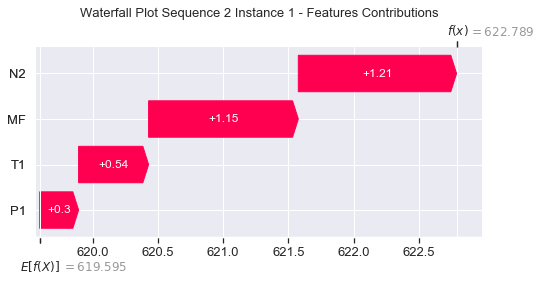

None

Contribution: [0.02160913 0.0618401  0.12781061 0.12724188]


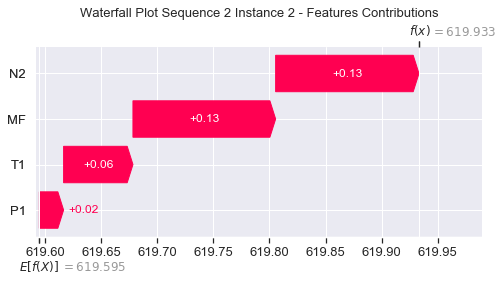

None

Contribution: [0.00196898 0.00721258 0.04757471 0.05683947]


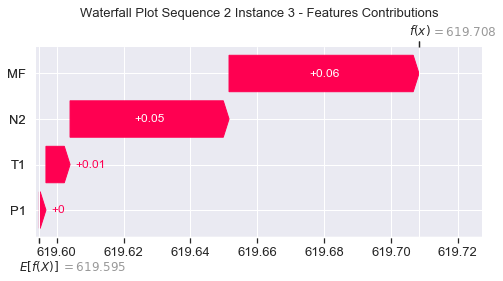

None

Contribution: [0.00540064 0.00688841 0.03272466 0.03315135]


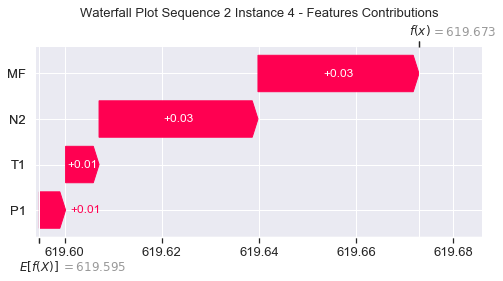

None

Contribution: [0.01095846 0.0096226  0.05118986 0.05154052]


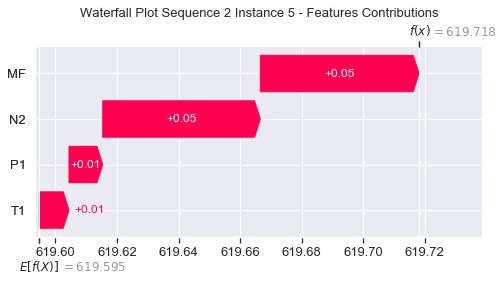

None

Contribution: [0.01269895 0.00987277 0.05647189 0.05620191]


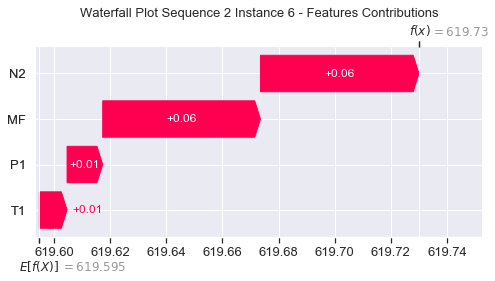

None

Contribution: [0.01373854 0.01007663 0.05935165 0.05868172]


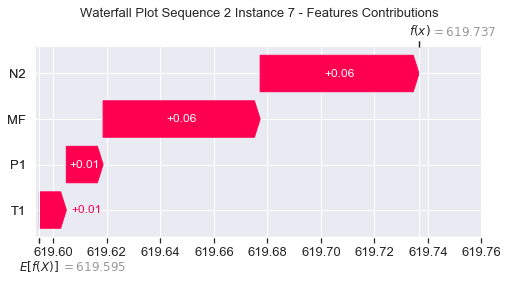

None

Contribution: [0.01436283 0.01035997 0.06091812 0.06000179]


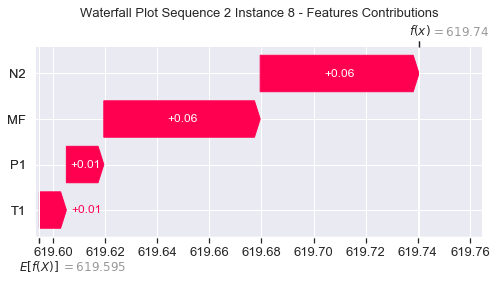

None

Contribution: [0.01478102 0.0101223  0.06204129 0.06065423]


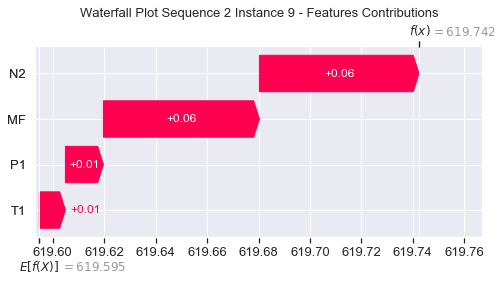

None

Contribution: [0.01498522 0.01023961 0.06295383 0.06133109]


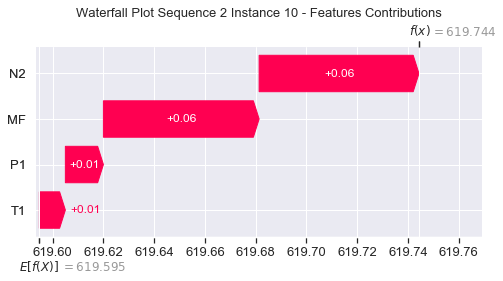

None

Contribution: [0.01566354 0.01075407 0.06449856 0.06251555]


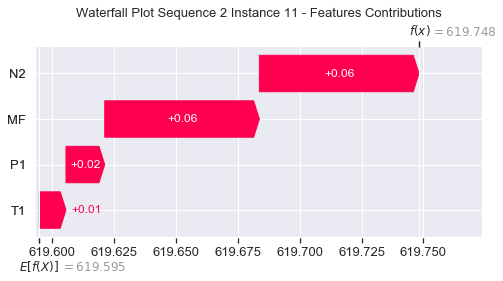

None

Contribution: [0.01665905 0.01069351 0.06756199 0.0649512 ]


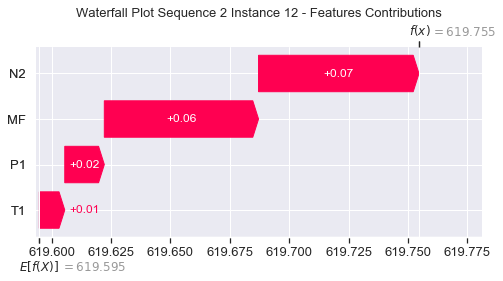

None

Contribution: [0.01840078 0.01226551 0.07334004 0.07033831]


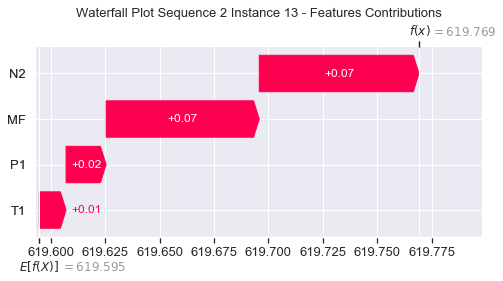

None

Contribution: [0.02084726 0.0134561  0.08117012 0.07770393]


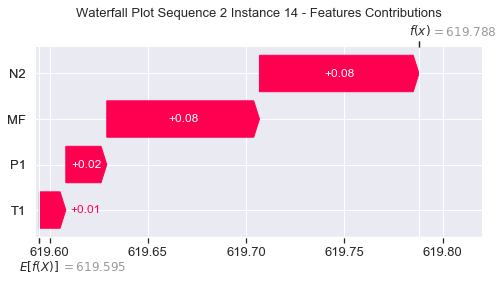

None

Contribution: [0.02386384 0.01637588 0.09172695 0.08770899]


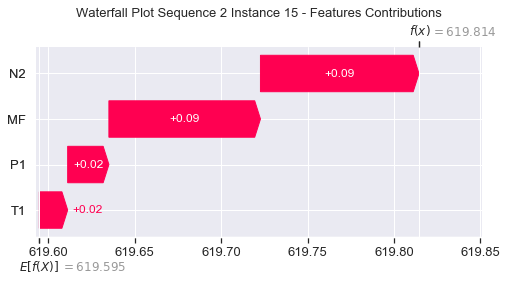

None

Contribution: [0.02754119 0.01983744 0.10538968 0.1014687 ]


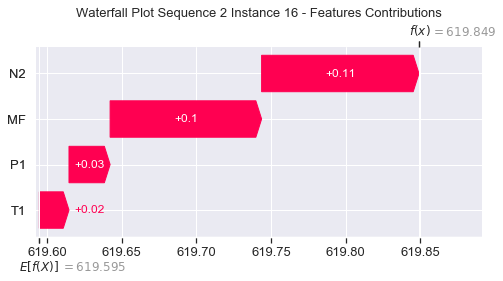

None

Contribution: [0.0331231  0.02315608 0.12271811 0.11728639]


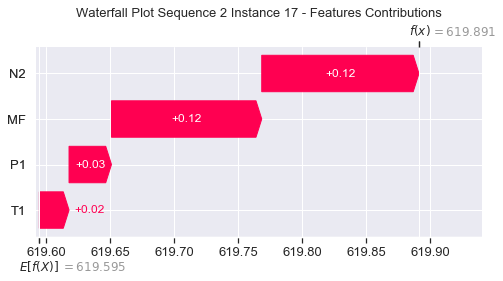

None

Contribution: [0.03971404 0.02825594 0.14486799 0.1386328 ]


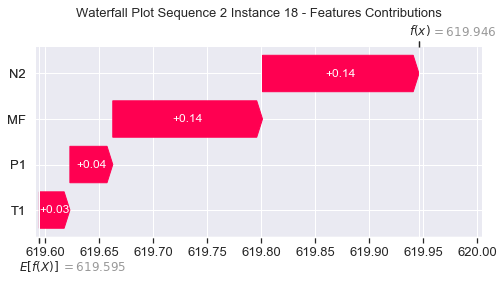

None

Contribution: [0.04848211 0.03620951 0.17398839 0.16649332]


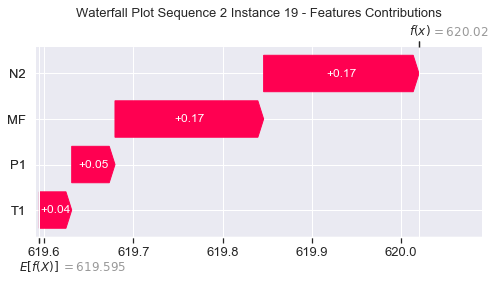

None

Contribution: [0.05959969 0.04401886 0.21166537 0.20377971]


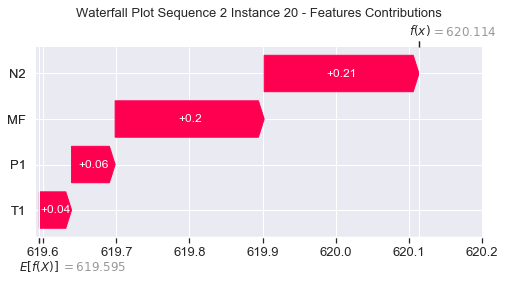

None

Contribution: [0.07450714 0.05300449 0.26291083 0.25364499]


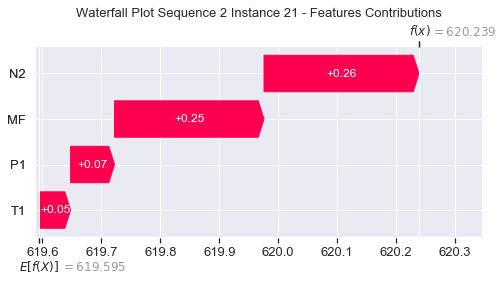

None

Contribution: [0.10138964 0.10731018 0.33697208 0.32372212]


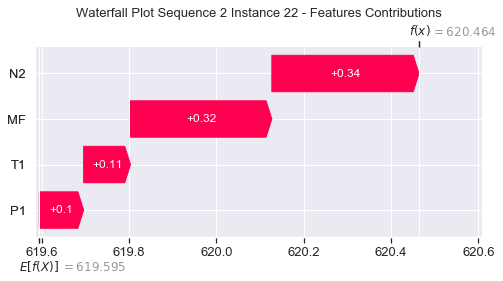

None

Contribution: [0.11760943 0.14232794 0.3735904  0.35905815]


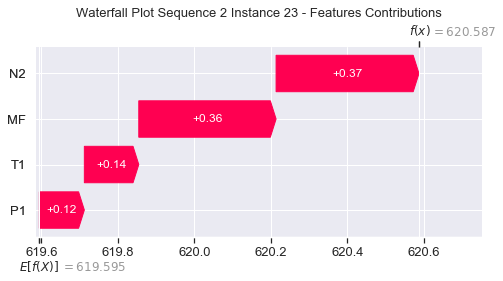

None

Contribution: [ 0.03413685 -1.48088802  1.0232276   1.08965931]


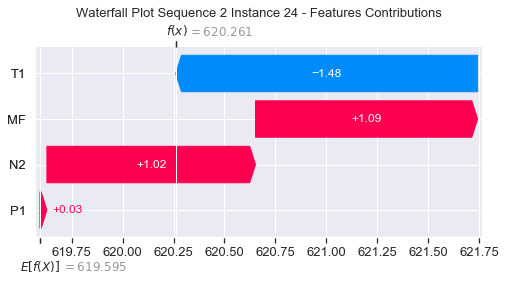

None

Contribution: [0.28368241 0.26181799 1.28748062 1.2022989 ]


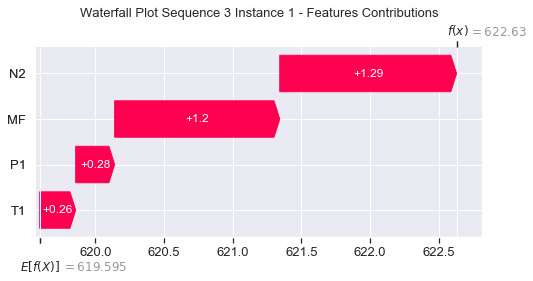

None

Contribution: [0.02170745 0.01339704 0.13558524 0.13406633]


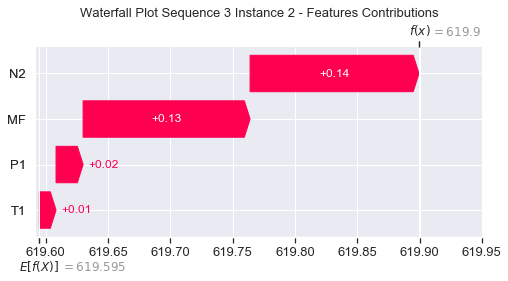

None

Contribution: [ 0.00273799 -0.0003614   0.05258847  0.06056607]


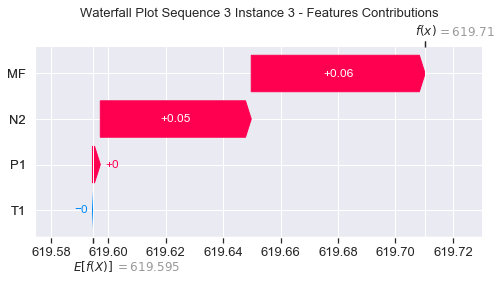

None

Contribution: [0.00493966 0.00301786 0.03146076 0.03221187]


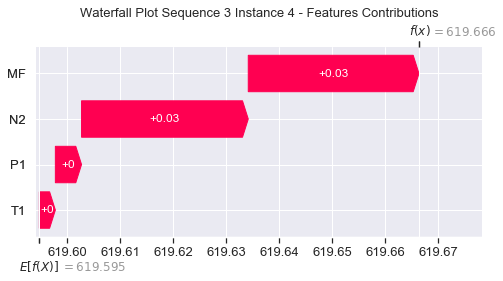

None

Contribution: [0.0106659  0.00688221 0.0505582  0.05004625]


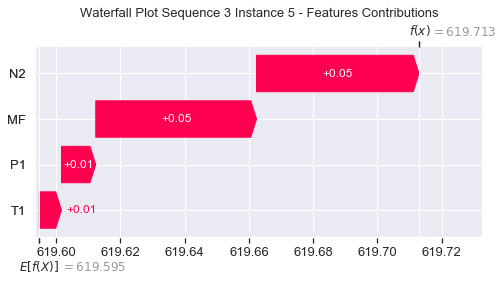

None

Contribution: [0.01236372 0.0079552  0.05575714 0.05477088]


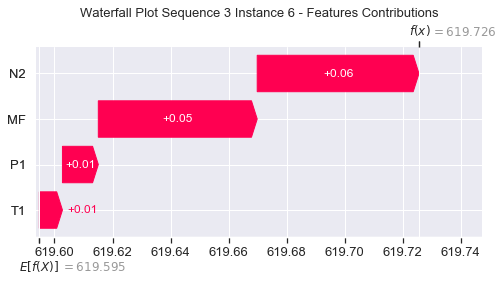

None

Contribution: [0.0133819  0.00826161 0.05857229 0.0572379 ]


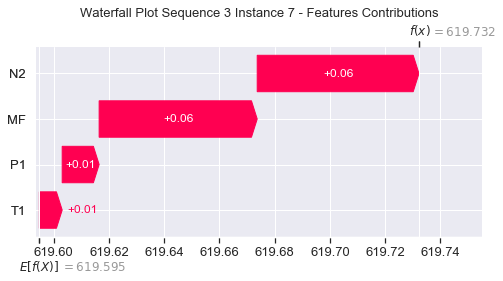

None

Contribution: [0.01403167 0.00855826 0.06007318 0.05844135]


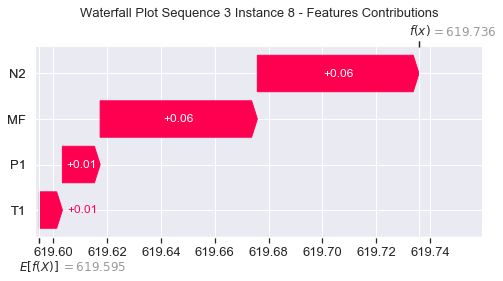

None

Contribution: [0.01429832 0.00974142 0.06090936 0.0586547 ]


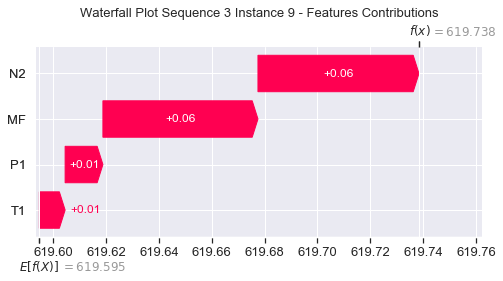

None

Contribution: [0.01480349 0.01133338 0.06194581 0.06000063]


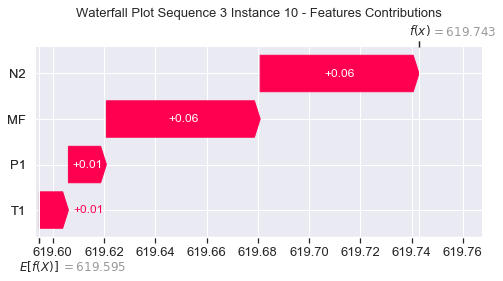

None

Contribution: [0.01551567 0.0109812  0.06379271 0.06102255]


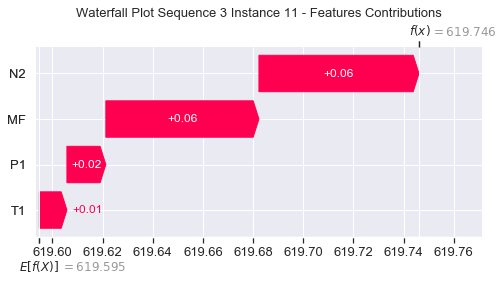

None

Contribution: [0.01666684 0.01021945 0.06714093 0.06430089]


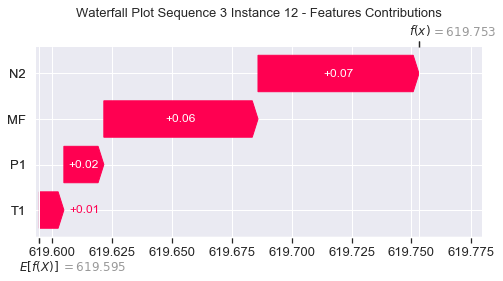

None

Contribution: [0.01837335 0.01151776 0.0728921  0.06958698]


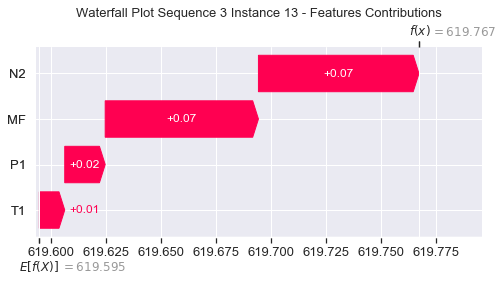

None

Contribution: [0.02019166 0.01410735 0.08092434 0.07702159]


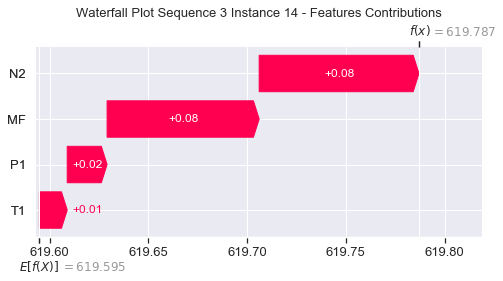

None

Contribution: [0.02380082 0.01563737 0.09141669 0.08712265]


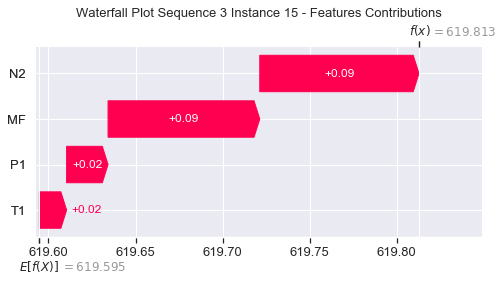

None

Contribution: [0.02836784 0.019218   0.10536417 0.1023568 ]


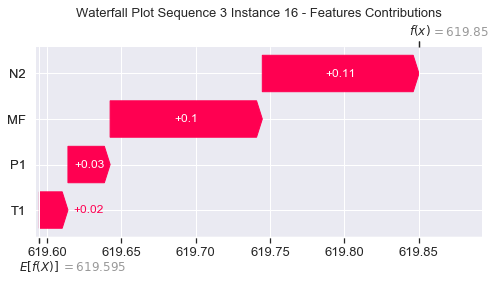

None

Contribution: [0.03305485 0.0226741  0.12252268 0.11686326]


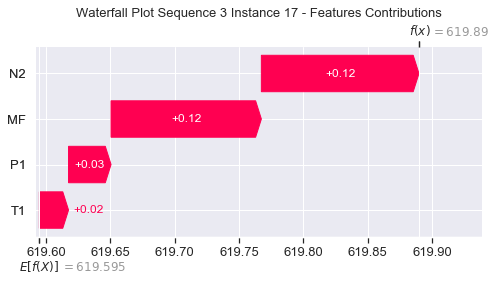

None

Contribution: [0.03973447 0.02770432 0.14491458 0.13842407]


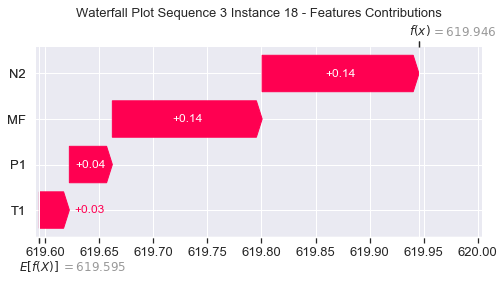

None

Contribution: [0.04918983 0.03271193 0.17458005 0.16694068]


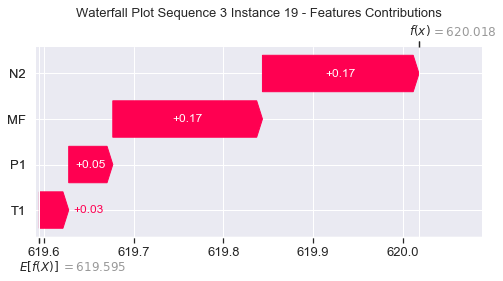

None

Contribution: [0.05953357 0.04095706 0.21193155 0.20331565]


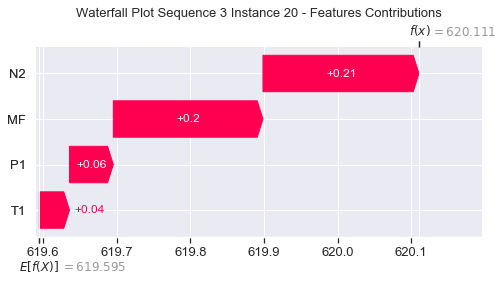

None

Contribution: [0.07476557 0.04936539 0.2636291  0.2535933 ]


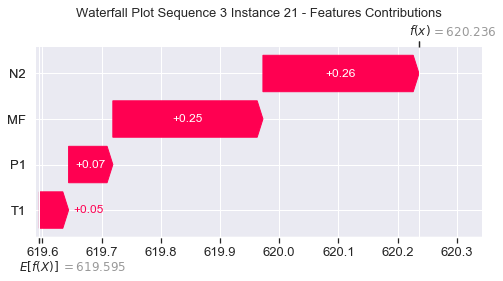

None

Contribution: [0.10182726 0.10510459 0.33785192 0.32431498]


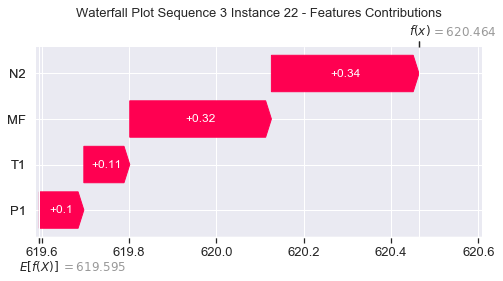

None

Contribution: [0.11806256 0.14023663 0.37506214 0.36060261]


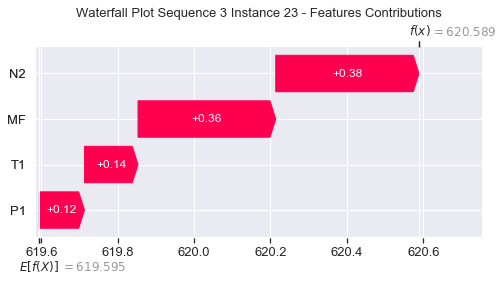

None

Contribution: [ 0.07439423 -1.66193599  1.0500174   1.03850273]


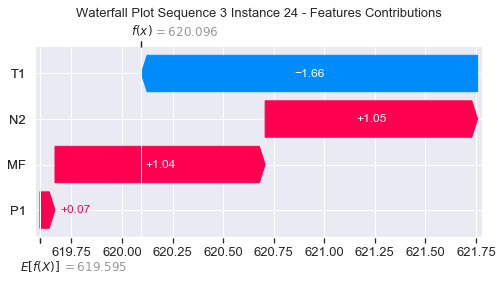

None

Contribution: [0.30591425 0.22368275 1.30001914 1.17667949]


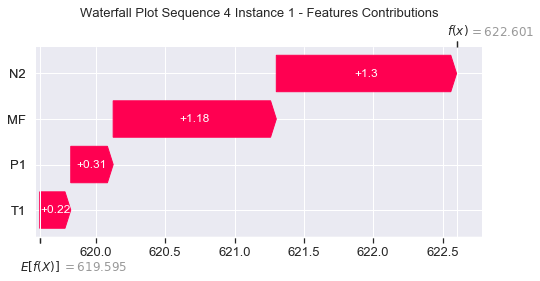

None

Contribution: [0.0235195  0.01014344 0.13862994 0.13782906]


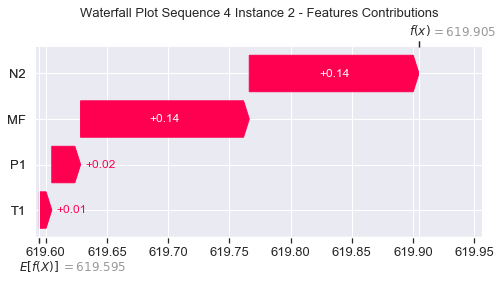

None

Contribution: [2.62852345e-03 9.70465366e-05 5.34768137e-02 6.19112718e-02]


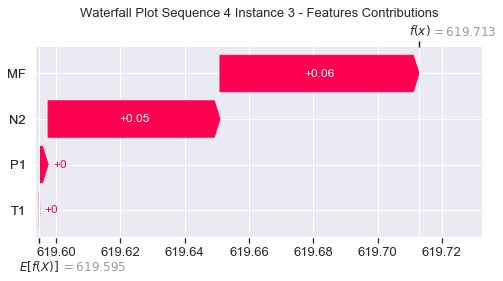

None

Contribution: [0.00491939 0.00325317 0.03131437 0.03205248]


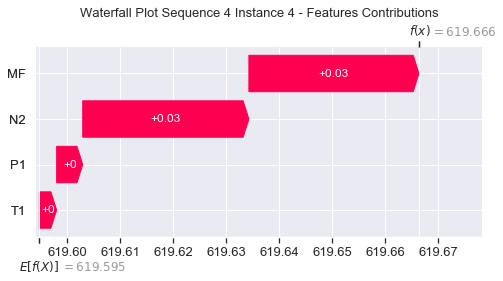

None

Contribution: [0.01069612 0.00644475 0.05057035 0.05024129]


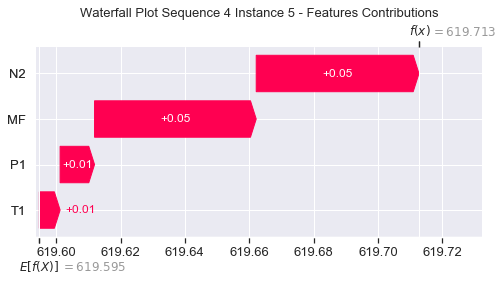

None

Contribution: [0.01248436 0.00692871 0.05578545 0.055321  ]


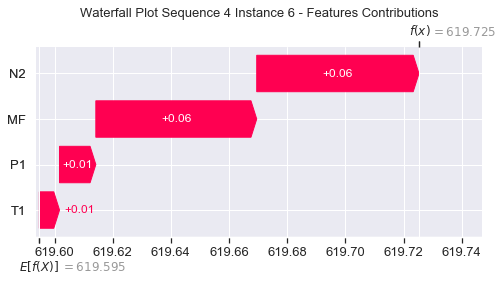

None

Contribution: [0.01355392 0.00725996 0.05860939 0.05775958]


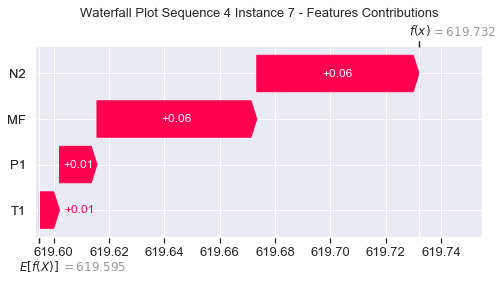

None

Contribution: [0.01415377 0.00746183 0.06019833 0.0591371 ]


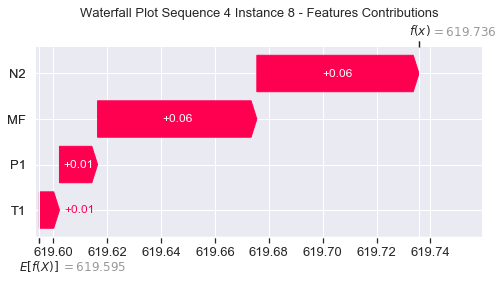

None

Contribution: [0.0141887  0.00827989 0.06108265 0.05999915]


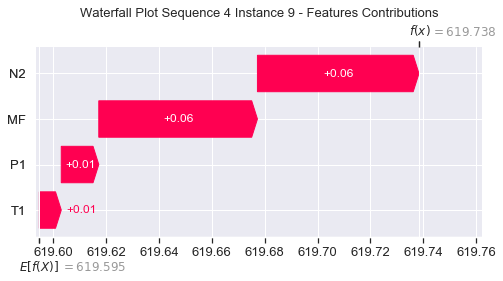

None

Contribution: [0.01495445 0.00784712 0.06202979 0.06086586]


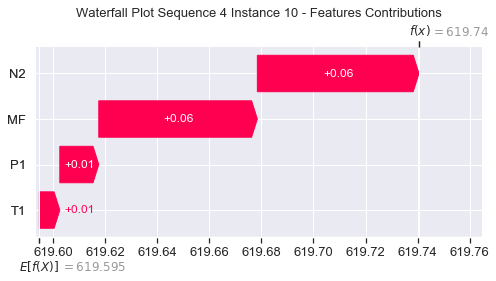

None

Contribution: [0.01516497 0.00881267 0.06390729 0.06243491]


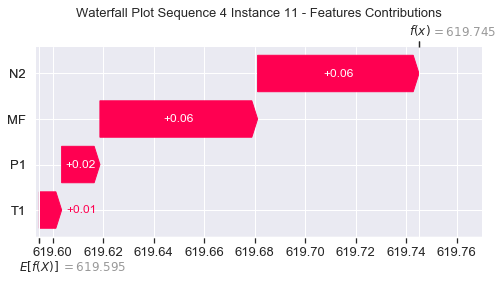

None

Contribution: [0.01661581 0.00906736 0.06715712 0.06463895]


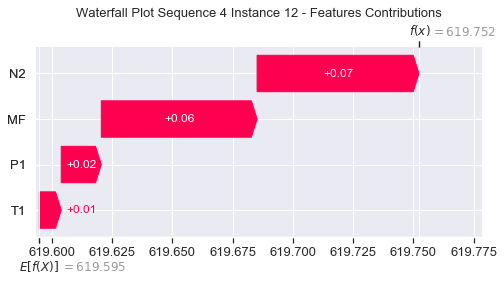

None

Contribution: [0.01837093 0.0103912  0.07291344 0.06996319]


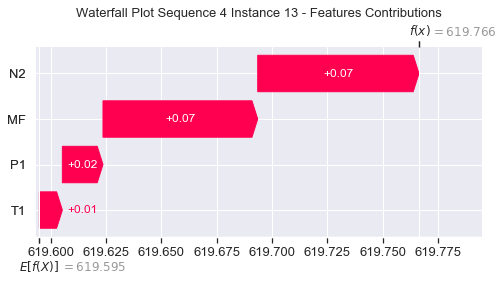

None

Contribution: [0.02056741 0.01266622 0.08111001 0.07900396]


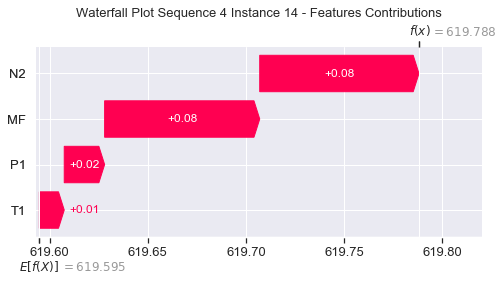

None

Contribution: [0.02390089 0.01406656 0.09149665 0.08783565]


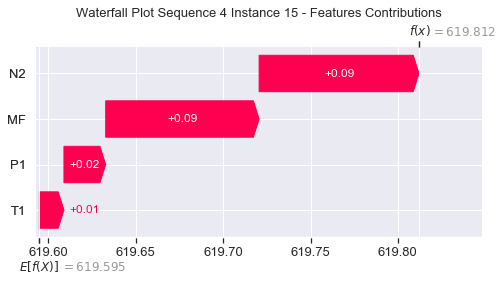

None

Contribution: [0.02756582 0.0174981  0.10517506 0.10110916]


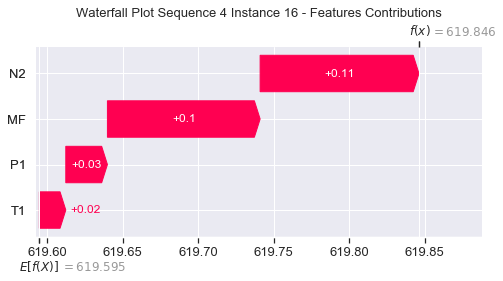

None

Contribution: [0.03328261 0.02066221 0.12266274 0.11796145]


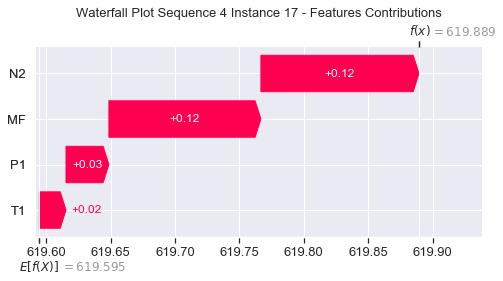

None

Contribution: [0.03999173 0.02519597 0.14505317 0.13983729]


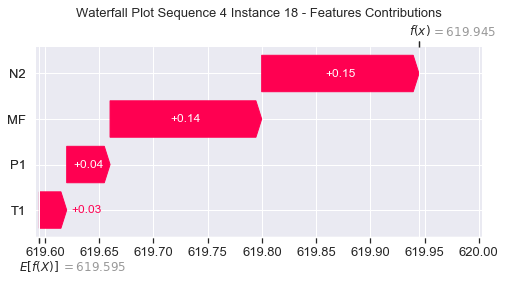

None

Contribution: [0.04946869 0.03258882 0.17432225 0.16551843]


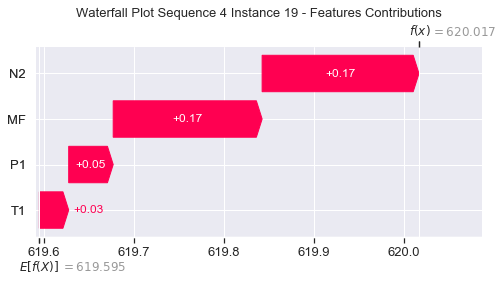

None

Contribution: [0.06000354 0.03802438 0.21218897 0.20538243]


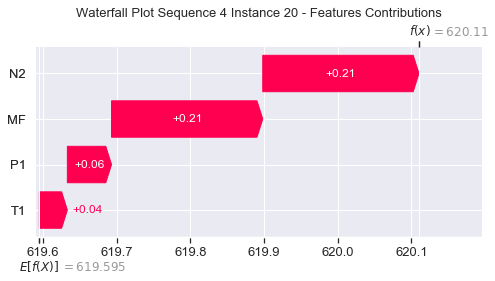

None

Contribution: [0.07503128 0.04588199 0.26391048 0.25604544]


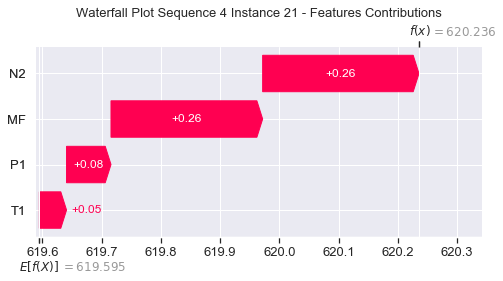

None

Contribution: [0.10179517 0.10333313 0.33804263 0.32548608]


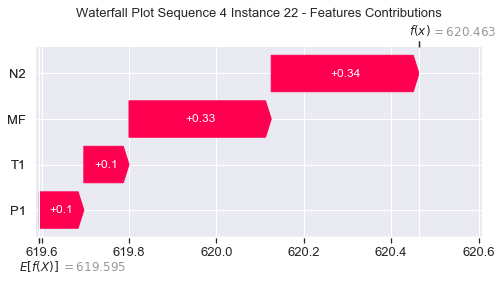

None

Contribution: [0.11806384 0.13865383 0.37537302 0.36146751]


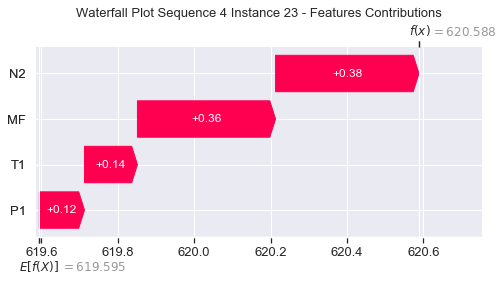

None

Contribution: [ 0.05342678 -1.79271882  1.06505835  1.18927425]


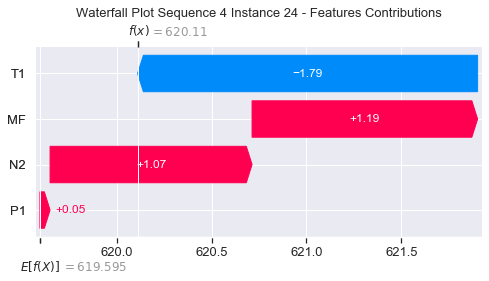

None

Contribution: [0.28569397 0.20551197 1.29191143 1.21664839]


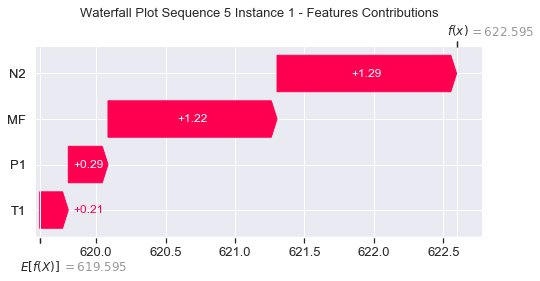

None

Contribution: [0.02184863 0.00756496 0.1364668  0.13625867]


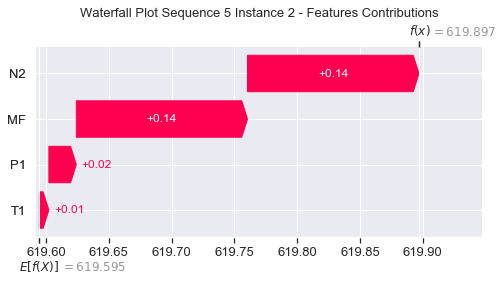

None

Contribution: [ 0.00244373 -0.00048068  0.05258507  0.06155757]


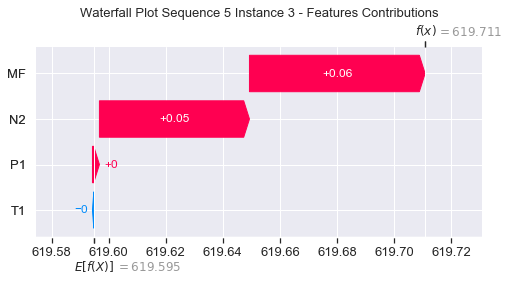

None

Contribution: [0.00479635 0.00325939 0.03124023 0.03213145]


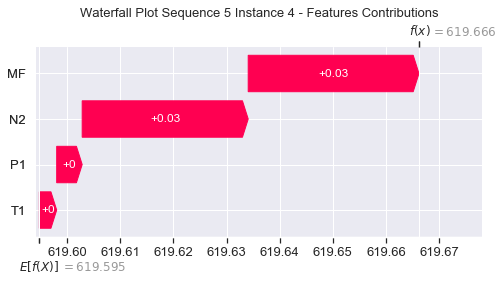

None

Contribution: [0.0104319  0.00659166 0.05034137 0.05038339]


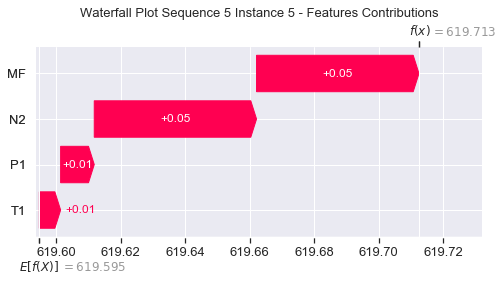

None

Contribution: [0.01220167 0.00760352 0.05550771 0.05530775]


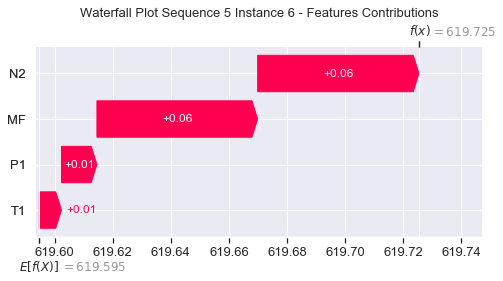

None

Contribution: [0.01322784 0.00788107 0.05831794 0.05776768]


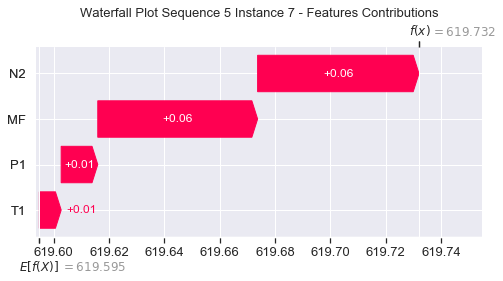

None

Contribution: [0.01388341 0.0082278  0.05990593 0.05905781]


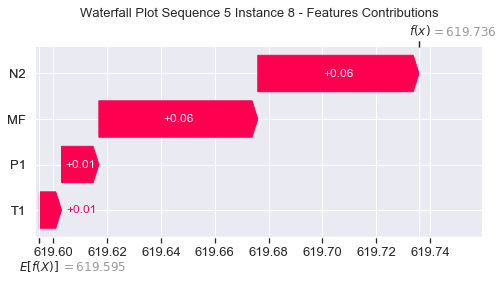

None

Contribution: [0.01417541 0.00904566 0.0606725  0.05942674]


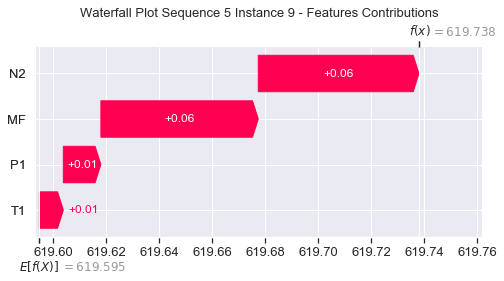

None

Contribution: [0.01419315 0.00934255 0.06162868 0.06006433]


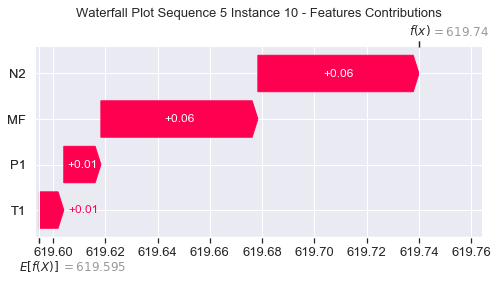

None

Contribution: [0.01519873 0.01051432 0.06353963 0.06163589]


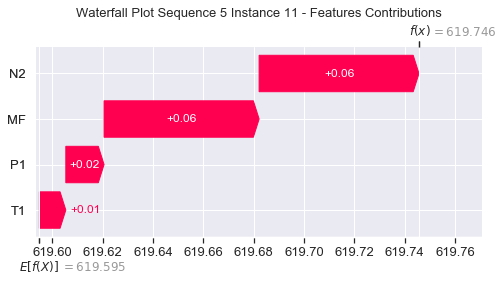

None

Contribution: [0.01630792 0.010176   0.06691317 0.06455205]


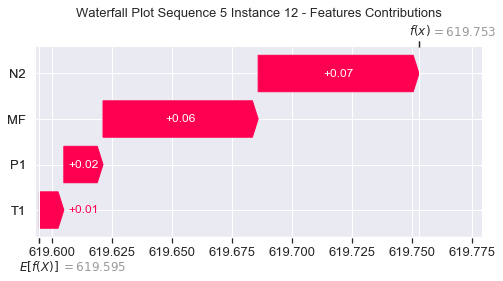

None

Contribution: [0.01805112 0.01146368 0.07266043 0.06990117]


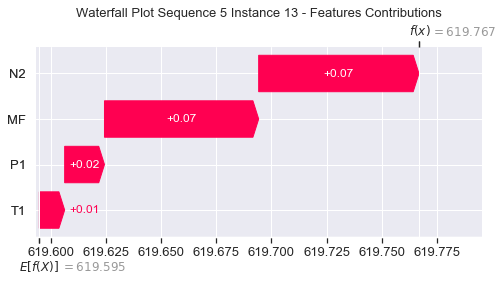

None

Contribution: [0.02078979 0.01352743 0.08097757 0.07840616]


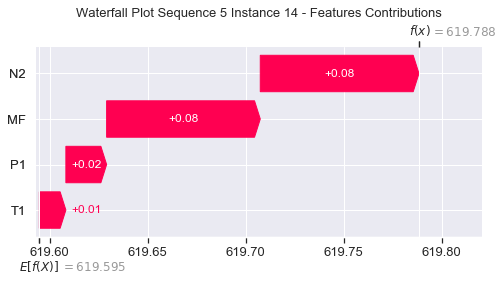

None

Contribution: [0.02363624 0.01588082 0.09122553 0.08770889]


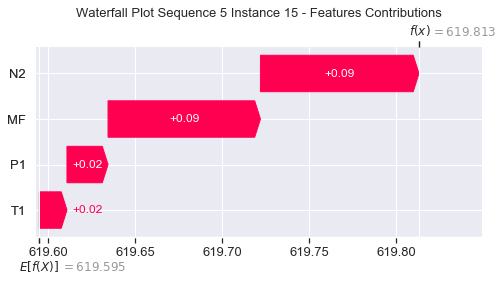

None

Contribution: [0.0283268  0.01872185 0.10545001 0.10521684]


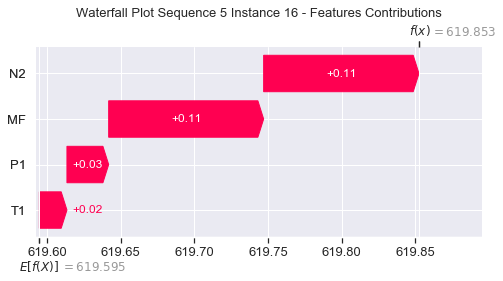

None

Contribution: [0.03307198 0.02315751 0.1223338  0.11764736]


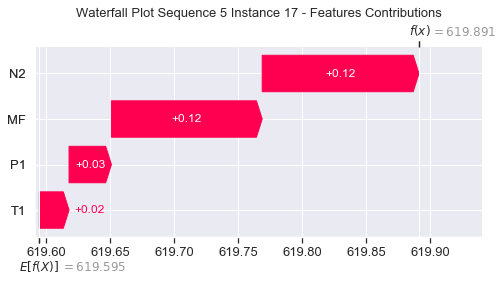

None

Contribution: [0.03988854 0.02852678 0.14474278 0.1393823 ]


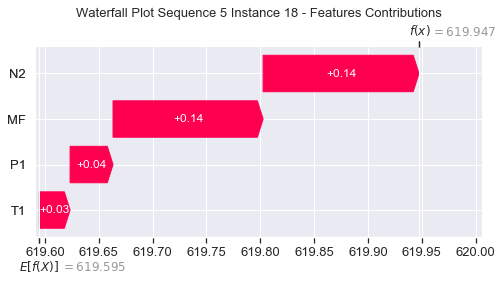

None

Contribution: [0.04883891 0.03368403 0.17354861 0.16718126]


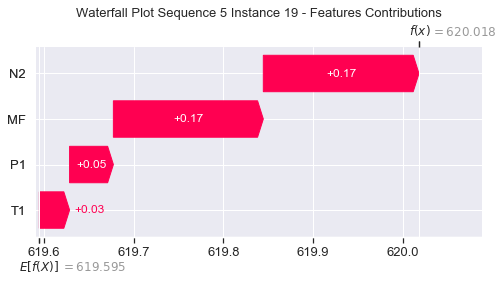

None

Contribution: [0.06010146 0.042758   0.21169265 0.20457424]


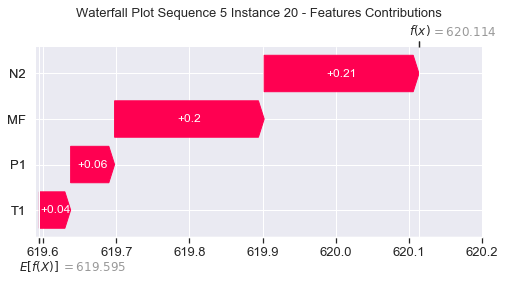

None

Contribution: [0.0753257  0.05223828 0.26335428 0.2548551 ]


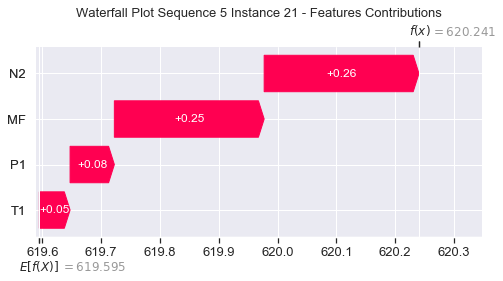

None

Contribution: [0.1019633  0.10683637 0.33741809 0.32441706]


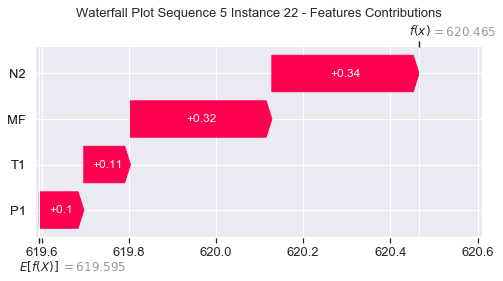

None

Contribution: [0.11815306 0.1410047  0.37441867 0.36024842]


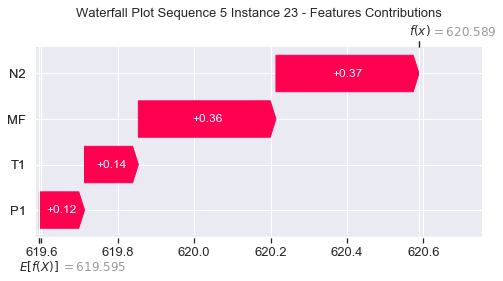

None

Contribution: [ 0.10253625 -1.50741105  1.06244664  1.15478819]


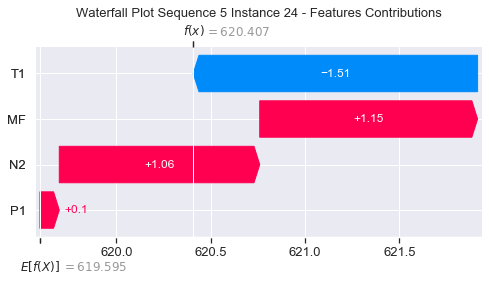

None

Contribution: [0.30937395 0.26249192 1.30332683 1.2279294 ]


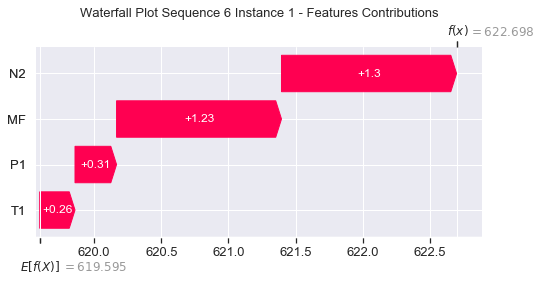

None

Contribution: [0.02323572 0.01778892 0.13826244 0.13668109]


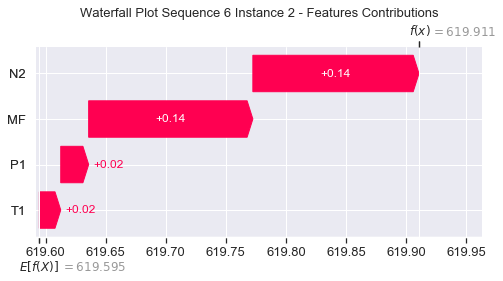

None

Contribution: [0.00262138 0.00195473 0.0529924  0.06156393]


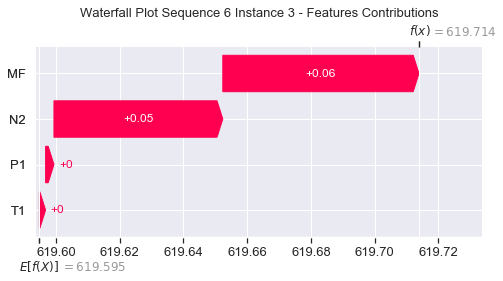

None

Contribution: [0.00501348 0.00380487 0.0319446  0.0324558 ]


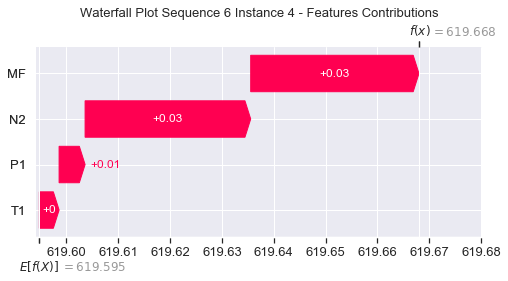

None

Contribution: [0.01077091 0.00799185 0.05112978 0.05077751]


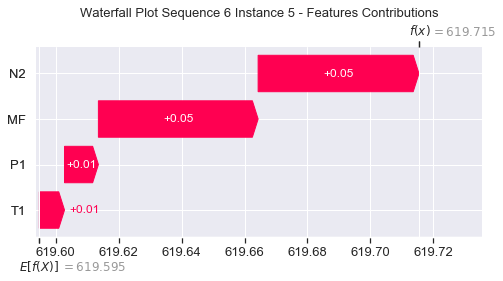

None

Contribution: [0.01259219 0.00824814 0.05643022 0.05573913]


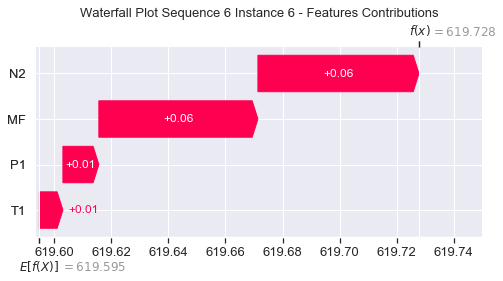

None

Contribution: [0.01366067 0.00839501 0.05923694 0.05824291]


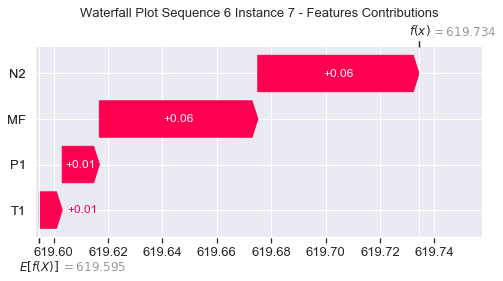

None

Contribution: [0.01428599 0.00846329 0.06086041 0.05944628]


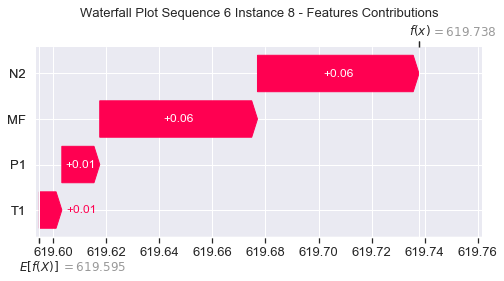

None

Contribution: [0.01459654 0.00843699 0.06163326 0.05953074]


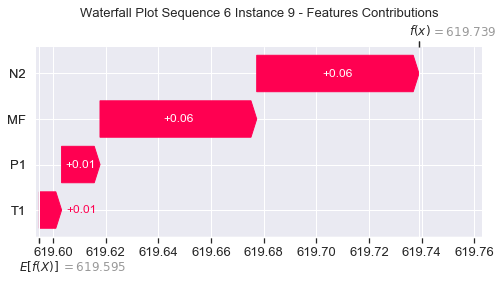

None

Contribution: [0.01468325 0.00918834 0.06256766 0.06110806]


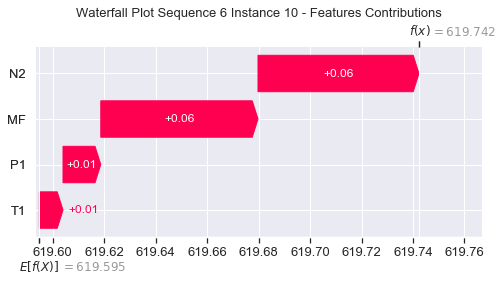

None

Contribution: [0.01553196 0.00902292 0.0644205  0.06151246]


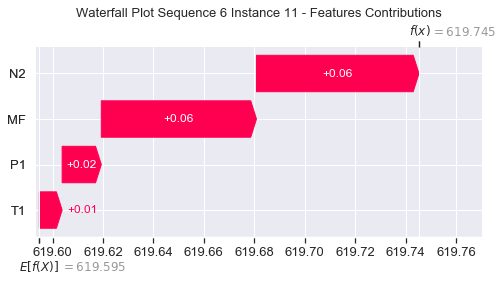

None

Contribution: [0.0166873  0.00901088 0.06745957 0.064706  ]


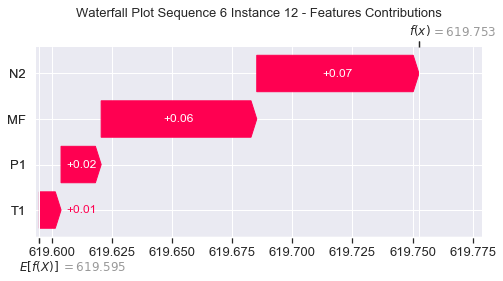

None

Contribution: [0.01842364 0.01018983 0.07321664 0.07002517]


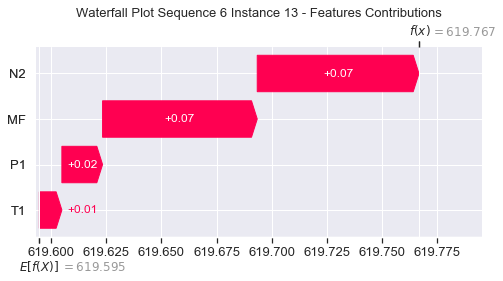

None

Contribution: [0.02081772 0.01267597 0.08107558 0.07783406]


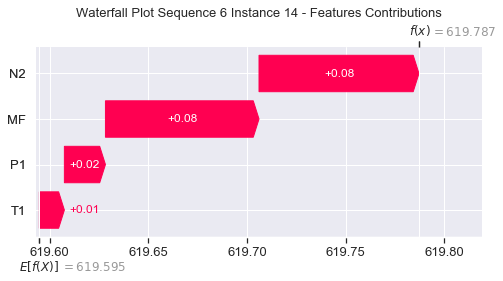

None

Contribution: [0.023937   0.01345445 0.09180071 0.08753275]


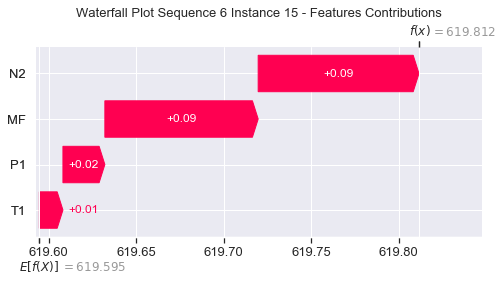

None

Contribution: [0.02799078 0.01459499 0.10536388 0.09990939]


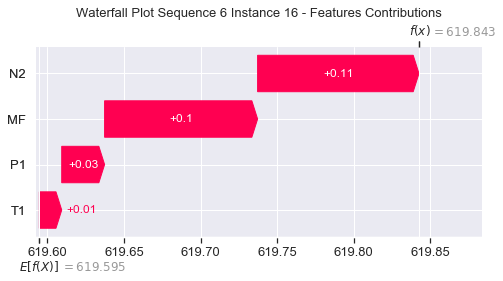

None

Contribution: [0.03324849 0.01845351 0.12294478 0.11733216]


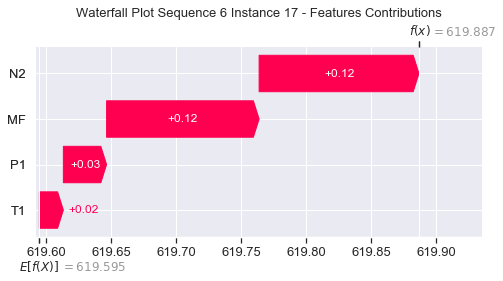

None

Contribution: [0.03988628 0.02204112 0.14540591 0.13884556]


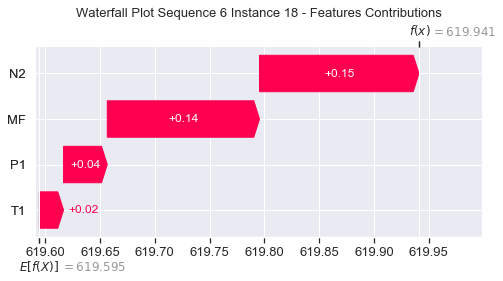

None

Contribution: [0.0489682  0.02605654 0.17537902 0.16693143]


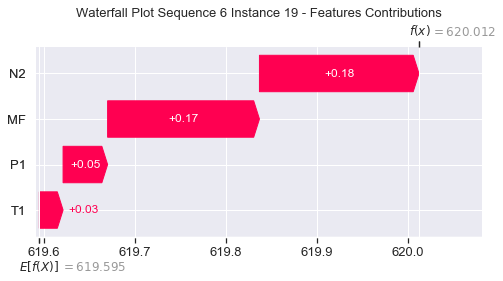

None

Contribution: [0.0597578  0.03207983 0.21303605 0.2039119 ]


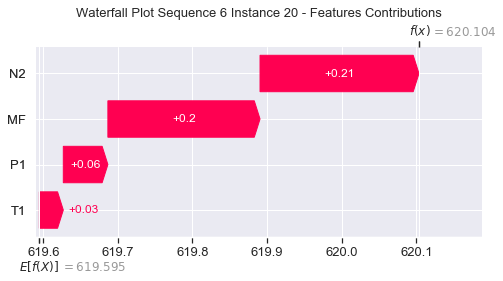

None

Contribution: [0.07472548 0.03750114 0.2648675  0.2538275 ]


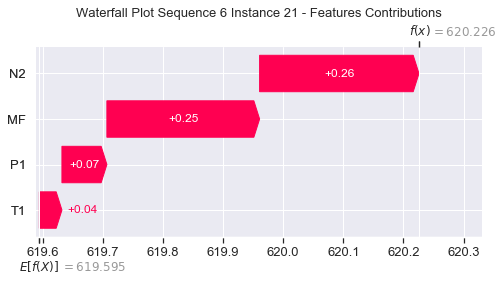

None

Contribution: [0.10176986 0.09925071 0.3392224  0.32493086]


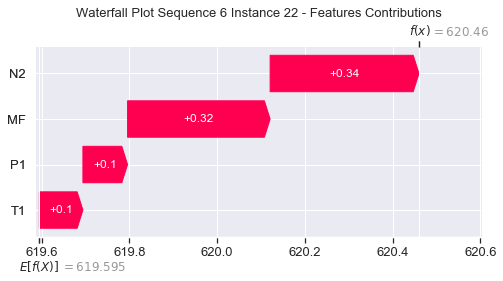

None

Contribution: [0.11825734 0.13670862 0.37670346 0.36193047]


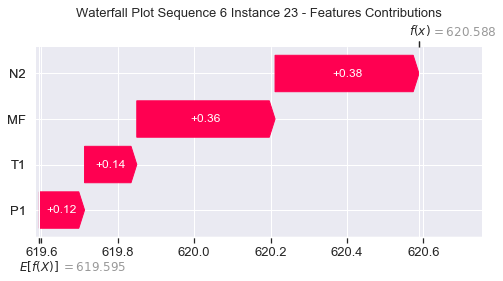

None

Contribution: [ 0.04118245 -2.15981469  1.09530928  1.04108394]


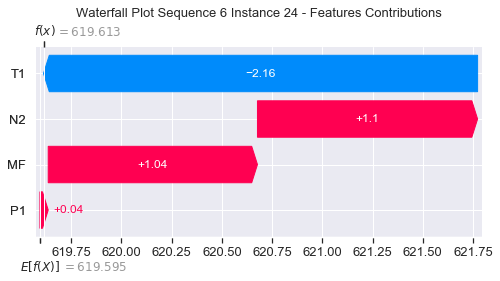

None

Contribution: [0.30486035 0.10516819 1.35512847 1.23728232]


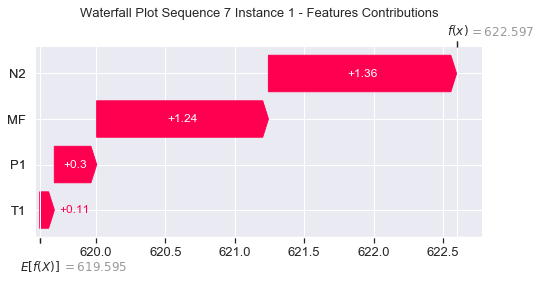

None

Contribution: [ 0.02226565 -0.00835279  0.14279646  0.13872988]


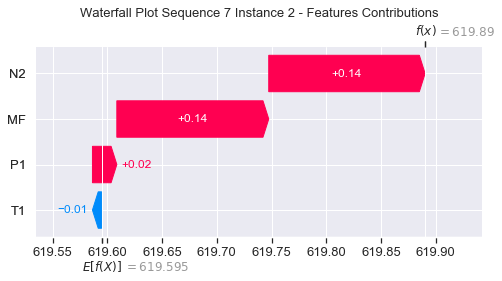

None

Contribution: [ 0.00335968 -0.0009502   0.05578329  0.06422044]


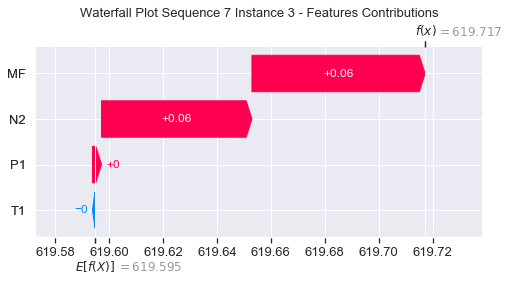

None

Contribution: [0.00471518 0.00199592 0.03124099 0.03214165]


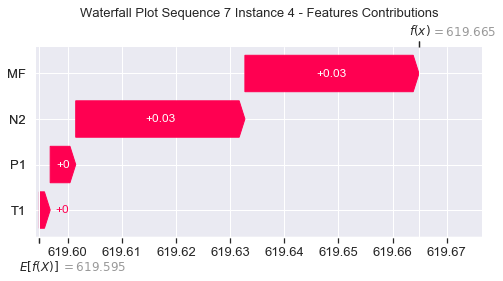

None

Contribution: [0.01064784 0.00488025 0.05096022 0.05108374]


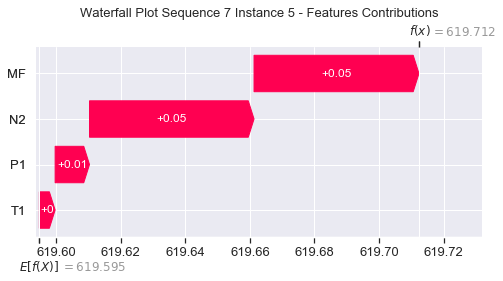

None

Contribution: [0.01231315 0.00499701 0.05607534 0.05568735]


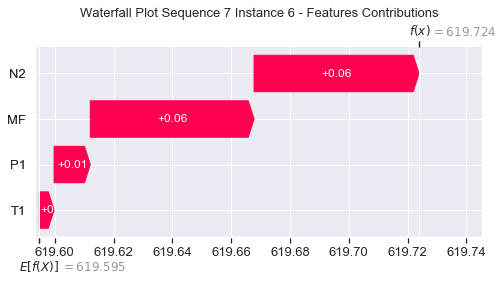

None

Contribution: [0.01328652 0.00528944 0.05884664 0.0582612 ]


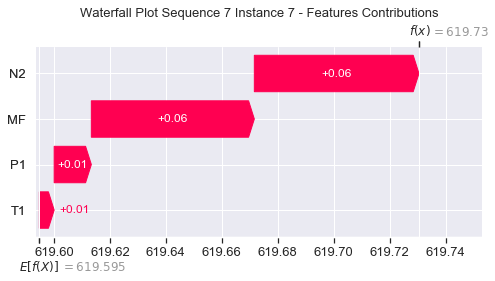

None

Contribution: [0.01396924 0.00546699 0.06040071 0.05937616]


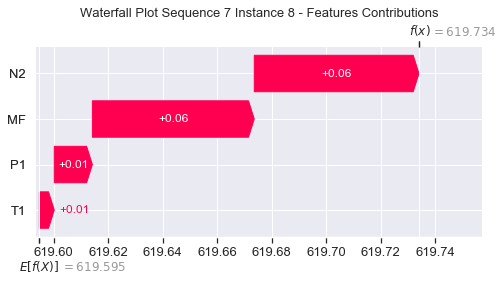

None

Contribution: [0.01415918 0.00672754 0.06105966 0.05997939]


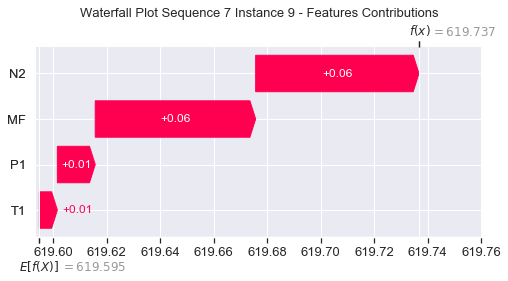

None

Contribution: [0.01472561 0.00742107 0.06212899 0.06090413]


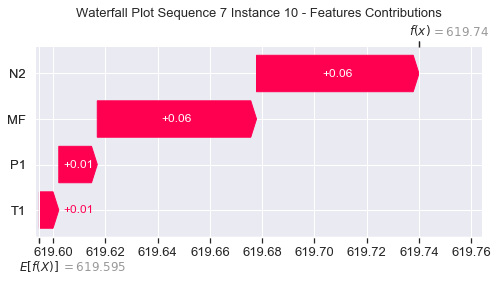

None

Contribution: [0.01533167 0.00684949 0.06381441 0.06140784]


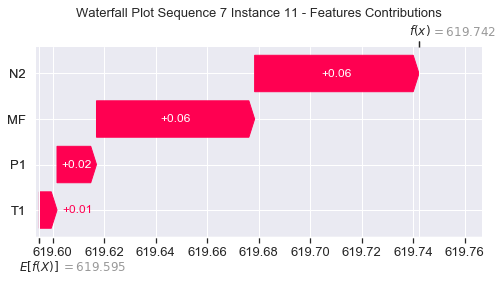

None

Contribution: [0.01628344 0.00678497 0.06727017 0.06475323]


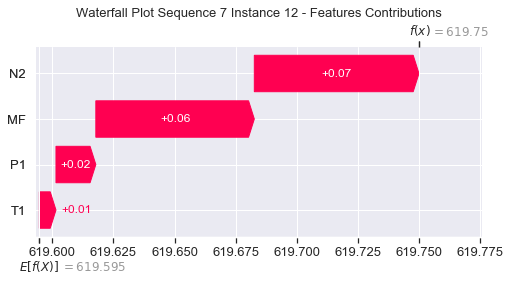

None

Contribution: [0.01798292 0.00800761 0.0730337  0.07016956]


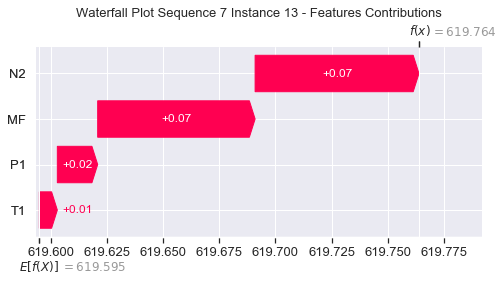

None

Contribution: [0.02024925 0.01104128 0.08104226 0.07780797]


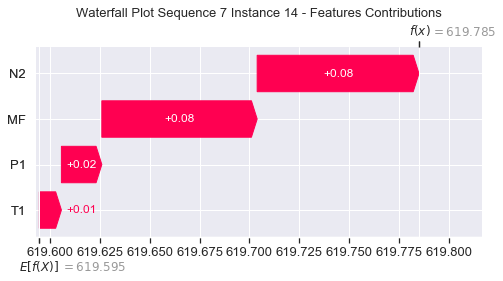

None

Contribution: [0.02343465 0.01103821 0.09162279 0.08760782]


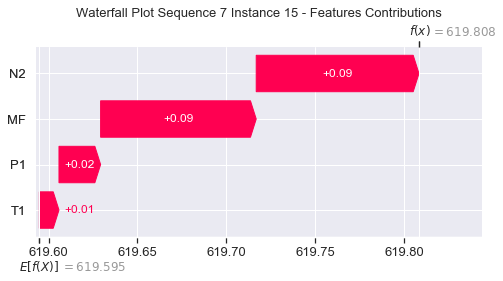

None

Contribution: [0.0282523  0.01293236 0.10563332 0.10218697]


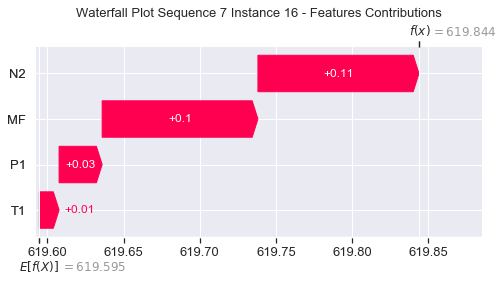

None

Contribution: [0.03247285 0.01683672 0.1228146  0.11749452]


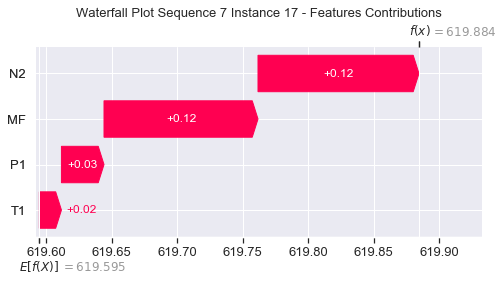

None

Contribution: [0.03908926 0.02063285 0.14527359 0.13879027]


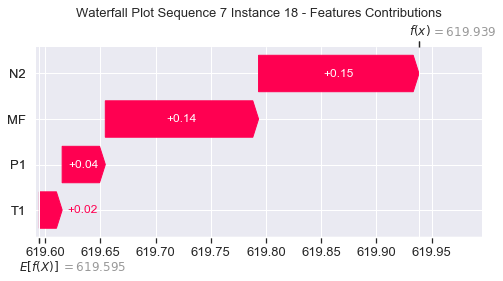

None

Contribution: [0.04943307 0.02413895 0.17540156 0.16806393]


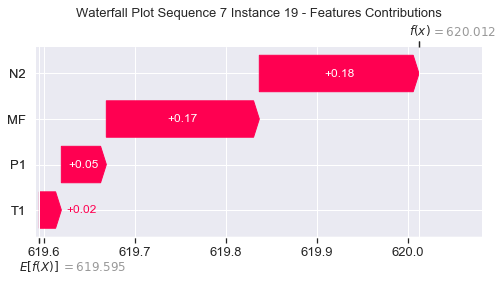

None

Contribution: [0.05881955 0.03163121 0.21279257 0.20397203]


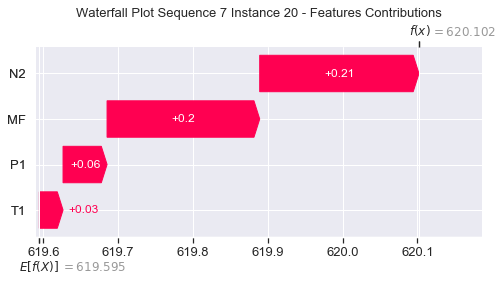

None

Contribution: [0.0737197  0.03778862 0.26483379 0.25401017]


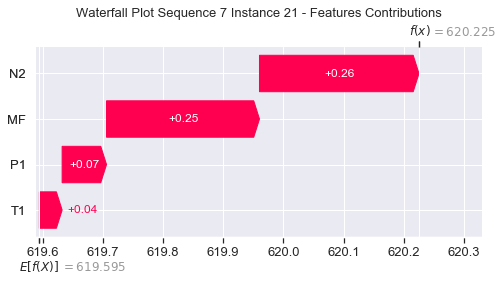

None

Contribution: [0.10147157 0.09936076 0.33945095 0.32508379]


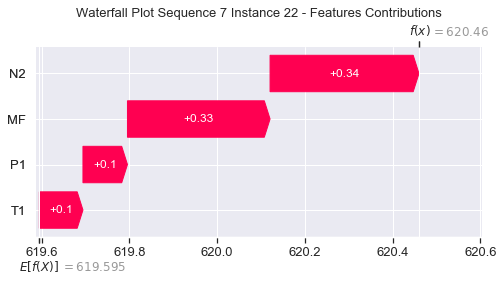

None

Contribution: [0.11802199 0.13590486 0.37755852 0.3625924 ]


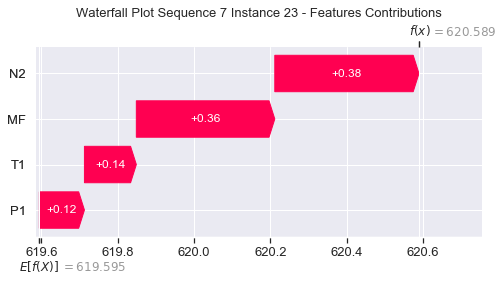

None

Contribution: [ 0.03205292 -2.14845773  1.07355349  1.00542551]


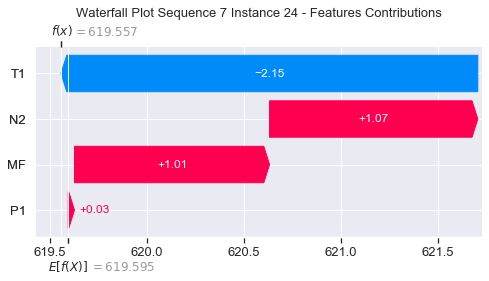

None

Contribution: [0.28925203 0.09580556 1.30677116 1.20476701]


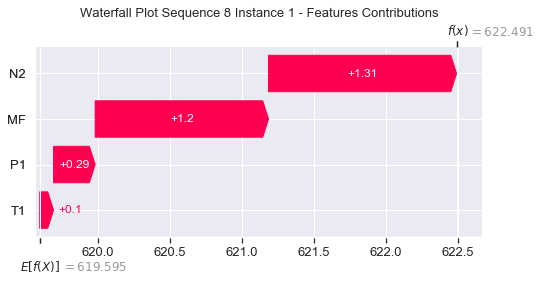

None

Contribution: [ 0.0212386  -0.00300384  0.13880542  0.13465127]


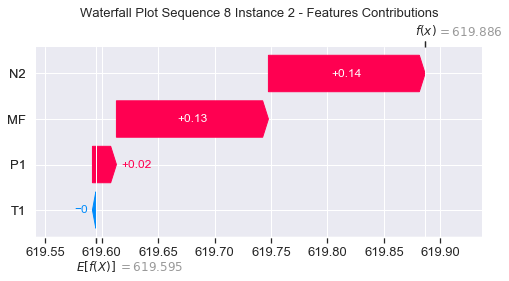

None

Contribution: [ 0.00285999 -0.00305192  0.05450661  0.06309281]


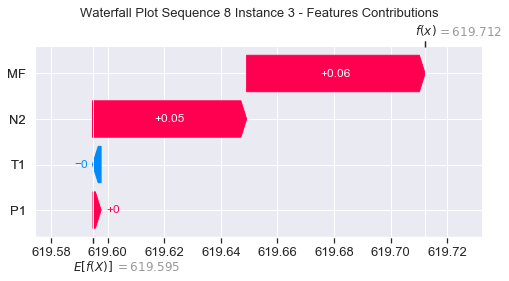

None

Contribution: [0.00466599 0.0019178  0.03101731 0.03200757]


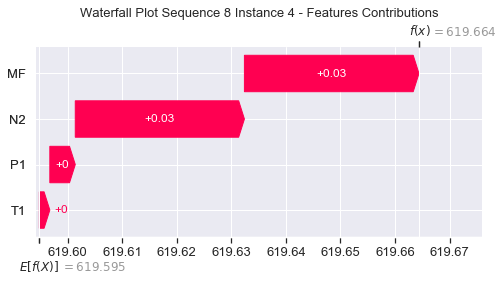

None

Contribution: [0.00974663 0.00457017 0.05000276 0.04700639]


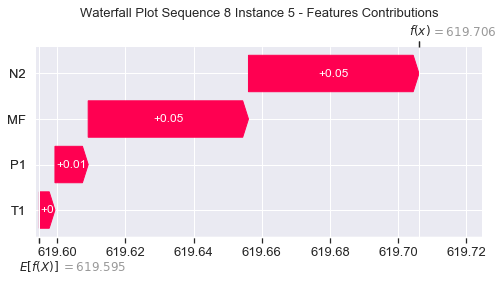

None

Contribution: [0.01191696 0.00607863 0.05512716 0.05337843]


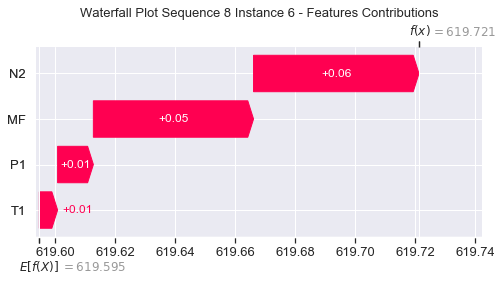

None

Contribution: [0.01291174 0.00628177 0.05799055 0.05604597]


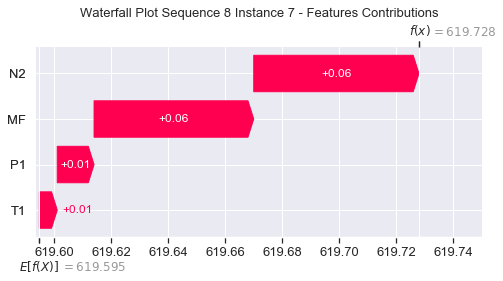

None

Contribution: [0.01352534 0.00677246 0.0595112  0.05730742]


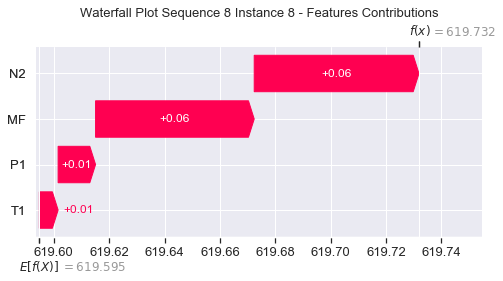

None

Contribution: [0.01341838 0.00641623 0.06058351 0.0594461 ]


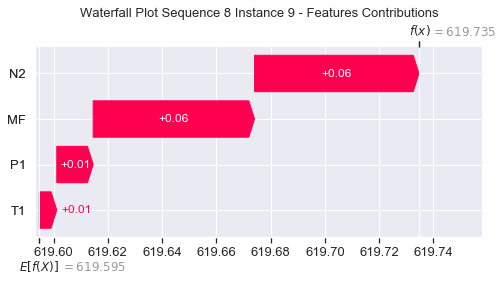

None

Contribution: [0.01273513 0.00597558 0.0614206  0.05815639]


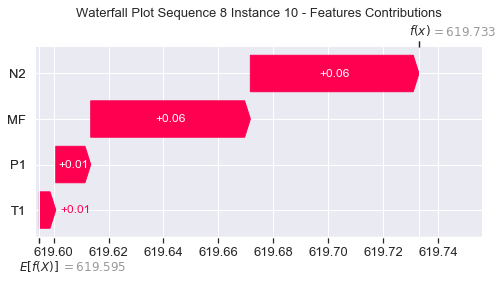

None

Contribution: [0.01511147 0.00969387 0.06339144 0.06238445]


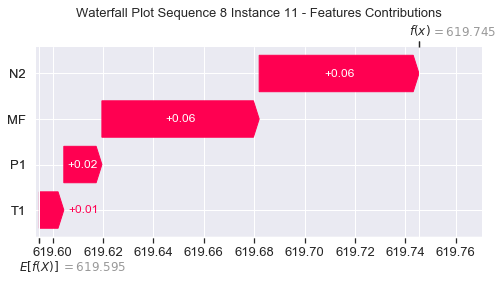

None

Contribution: [0.01657109 0.01131971 0.06660391 0.06427662]


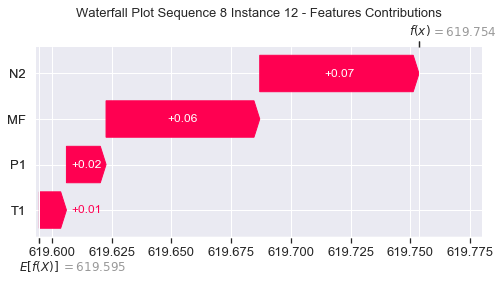

None

Contribution: [0.0181527  0.01231399 0.07238499 0.06933915]


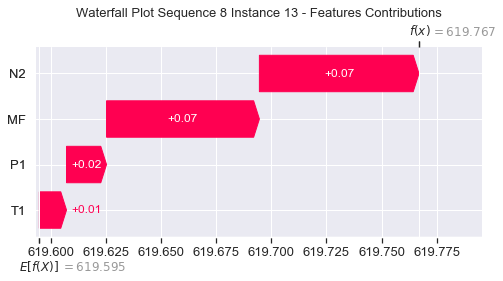

None

Contribution: [0.0207052  0.01419384 0.08058084 0.07835016]


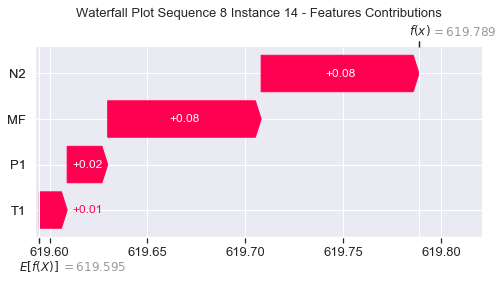

None

Contribution: [0.02409812 0.0168923  0.09115656 0.08759385]


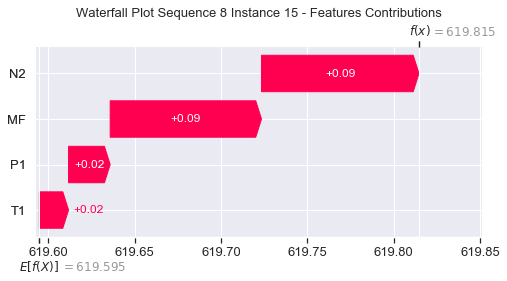

None

Contribution: [0.02819052 0.0195861  0.1050995  0.10262458]


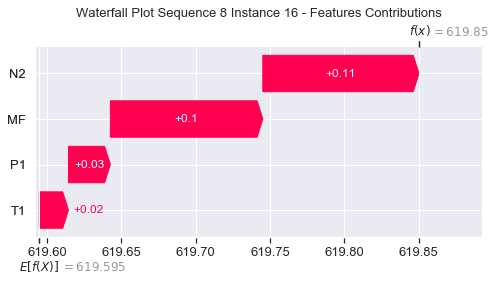

None

Contribution: [0.03377286 0.02522615 0.12249393 0.11845158]


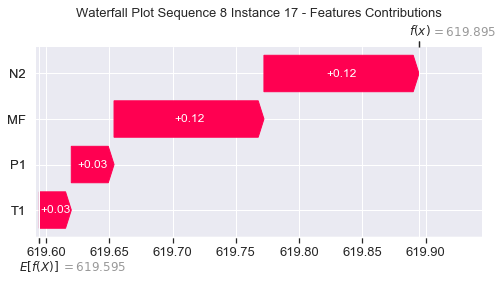

None

Contribution: [0.04098785 0.03170743 0.14499179 0.1406252 ]


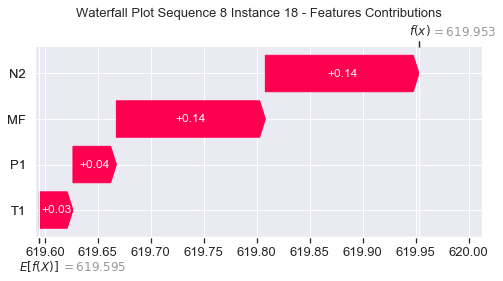

None

Contribution: [0.04983925 0.03504586 0.17461262 0.16724919]


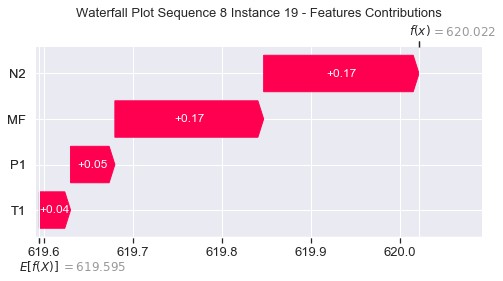

None

Contribution: [0.06056784 0.04593747 0.2121729  0.20426044]


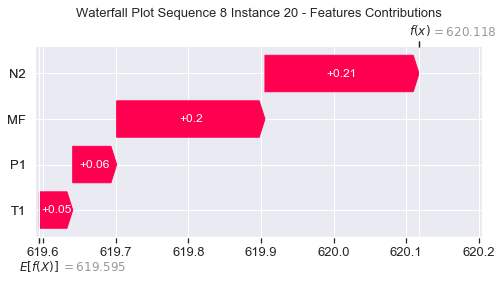

None

Contribution: [0.0760698  0.05835197 0.26393825 0.25430176]


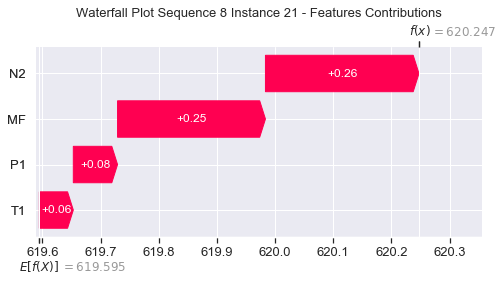

None

Contribution: [0.10240474 0.1104846  0.33716771 0.32321224]


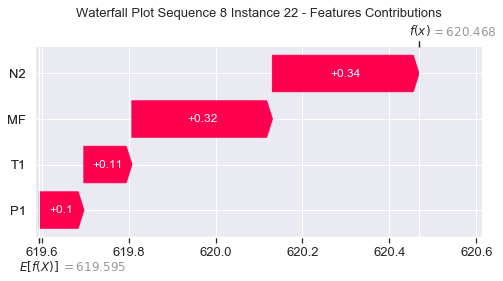

None

Contribution: [0.11898598 0.14336153 0.37369281 0.35977887]


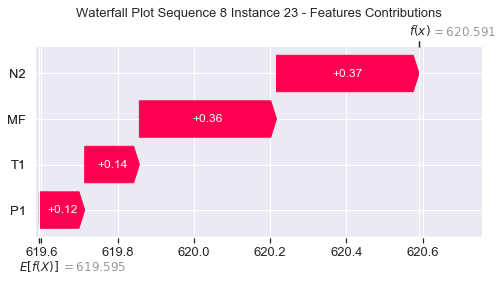

None

Contribution: [ 0.13957315 -1.23042348  1.08507948  1.05300297]


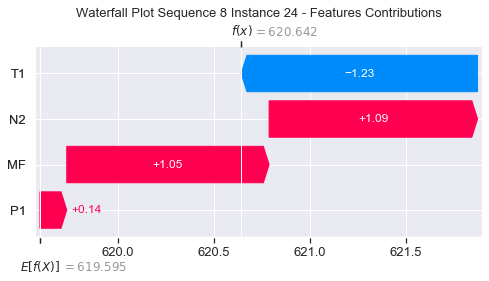

None

Contribution: [0.29654772 0.30400089 1.25841473 1.14816679]


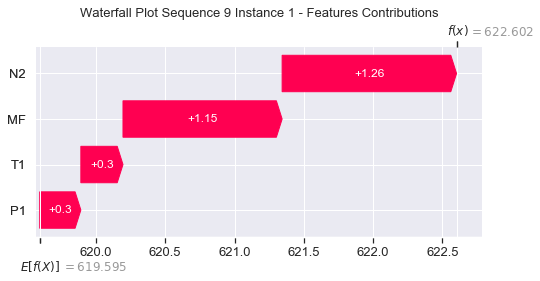

None

Contribution: [0.02357455 0.03451368 0.13471192 0.13124931]


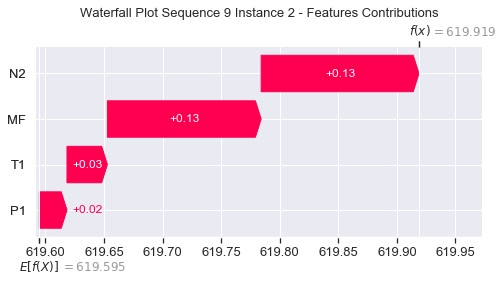

None

Contribution: [0.00272557 0.00076975 0.05108989 0.05864229]


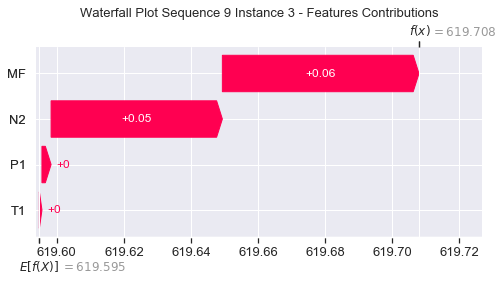

None

Contribution: [0.00490161 0.00485444 0.03125864 0.03170548]


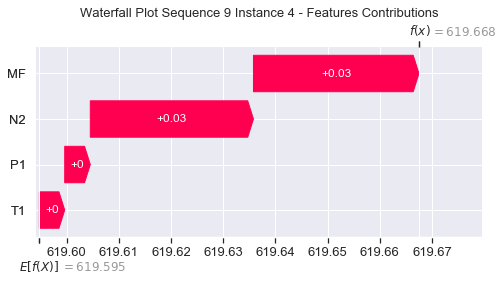

None

Contribution: [0.0106068  0.00874215 0.05010443 0.05014888]


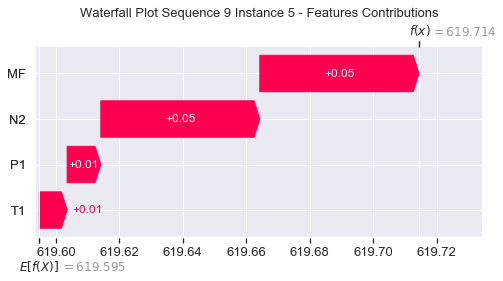

None

Contribution: [0.01233424 0.0093348  0.05531752 0.05472435]


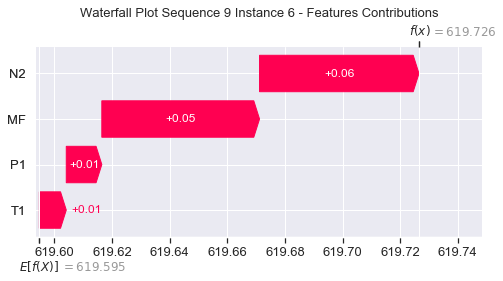

None

Contribution: [0.01338581 0.00973355 0.05812176 0.05707567]


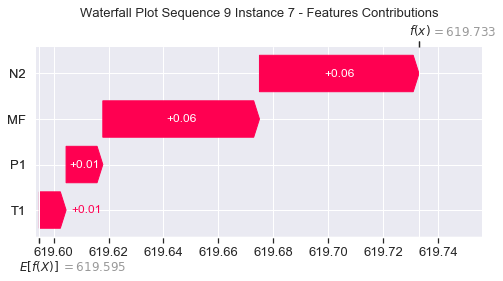

None

Contribution: [0.01411486 0.01004852 0.05974417 0.0585757 ]


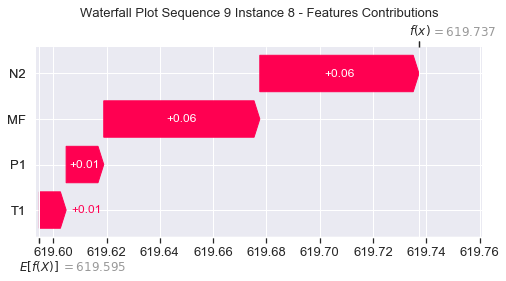

None

Contribution: [0.01479755 0.01109063 0.06057275 0.05901092]


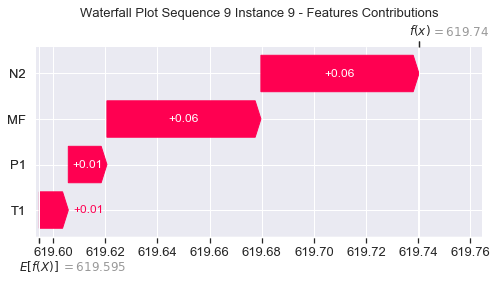

None

Contribution: [0.01486966 0.01149834 0.0616691  0.0614091 ]


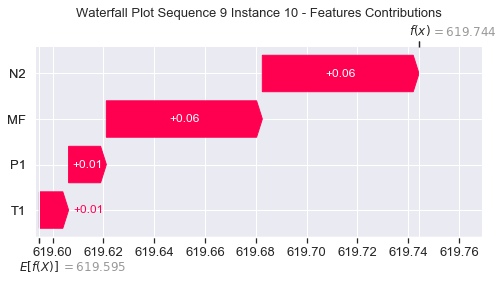

None

Contribution: [0.01586762 0.01197987 0.0635816  0.06175472]


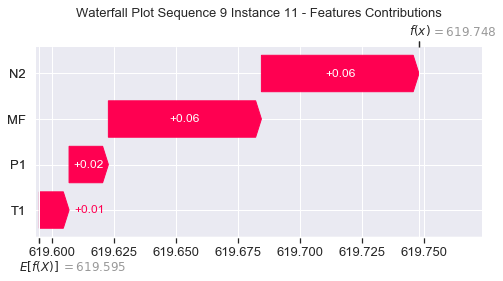

None

Contribution: [0.0167328  0.01151668 0.0669719  0.06443482]


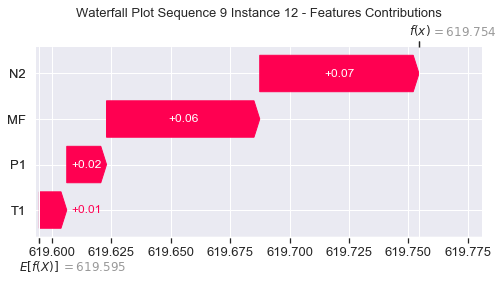

None

Contribution: [0.01855193 0.01303955 0.0727482  0.06982258]


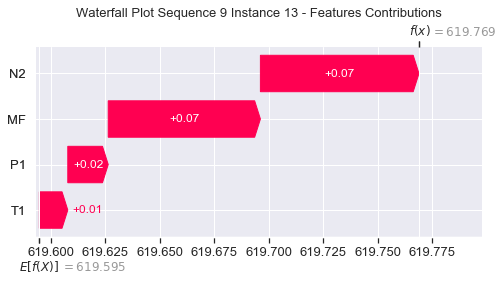

None

Contribution: [0.02148422 0.01443744 0.08105926 0.07931454]


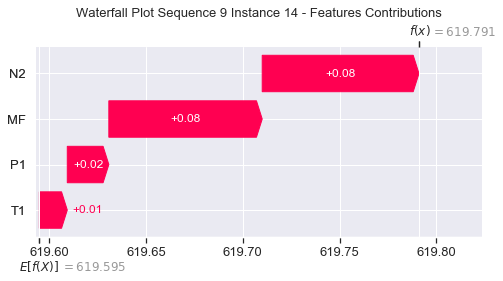

None

Contribution: [0.02425343 0.01723685 0.09137546 0.0876412 ]


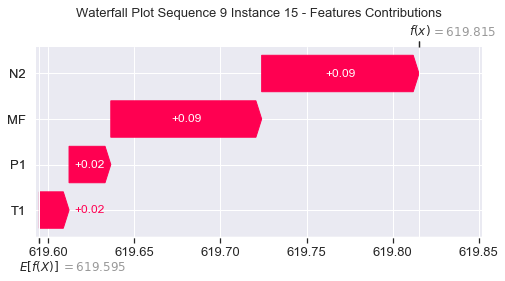

None

Contribution: [0.02874141 0.01829892 0.10536316 0.1030381 ]


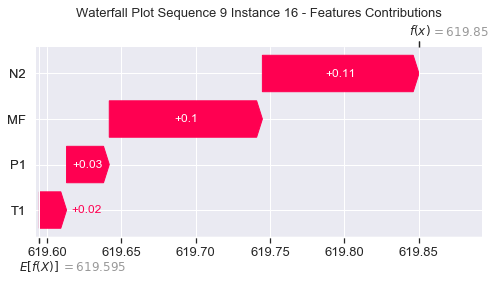

None

Contribution: [0.0339984  0.02446542 0.122556   0.11749512]


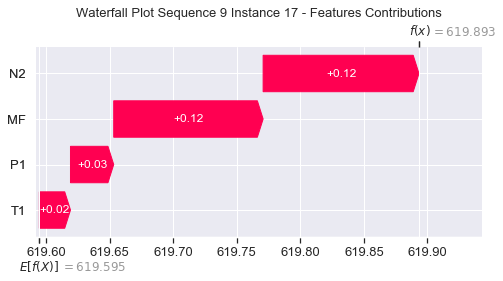

None

Contribution: [0.04097249 0.02952908 0.14495503 0.13934123]


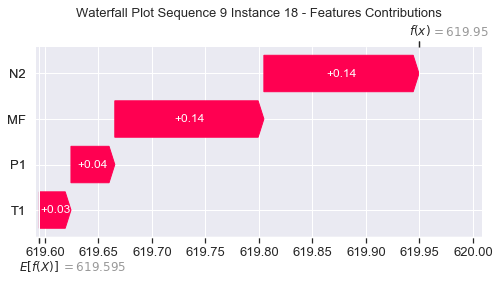

None

Contribution: [0.04989074 0.03845644 0.17458875 0.17027656]


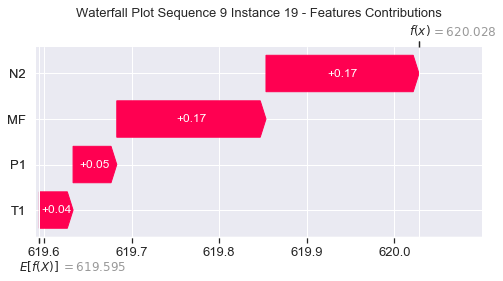

None

Contribution: [0.06200884 0.04456099 0.21200658 0.20505017]


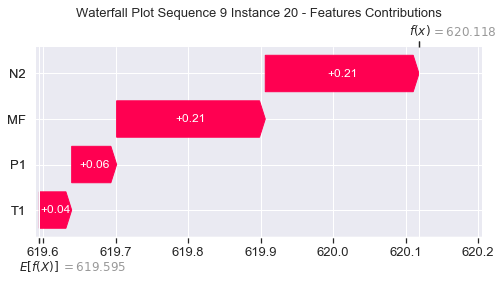

None

Contribution: [0.07806472 0.05406321 0.26388159 0.25618676]


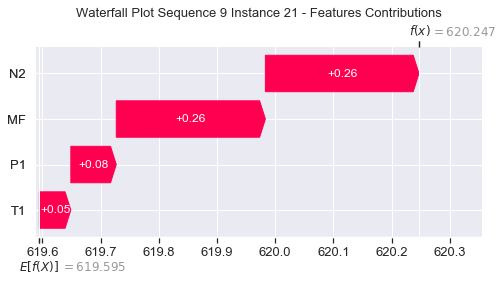

None

Contribution: [0.10362173 0.1073789  0.33707586 0.32499729]


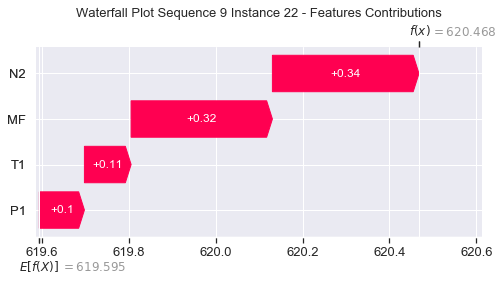

None

Contribution: [0.11924938 0.14102754 0.37331834 0.35951267]


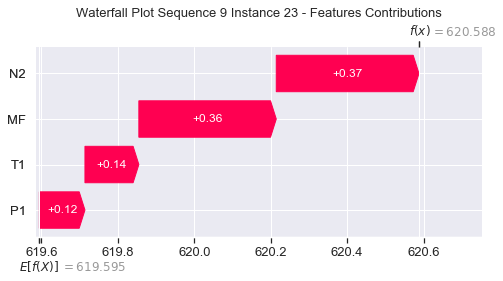

None

Contribution: [ 0.2028482  -1.52371687  1.09923606  1.24384337]


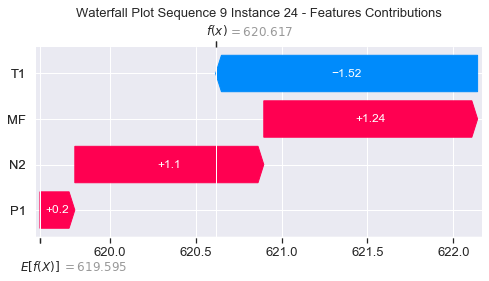

None

Contribution: [0.32300952 0.23321661 1.27921334 1.19869515]


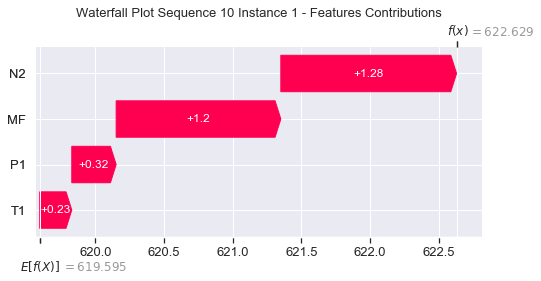

None

Contribution: [0.02697227 0.01694692 0.13747646 0.1405563 ]


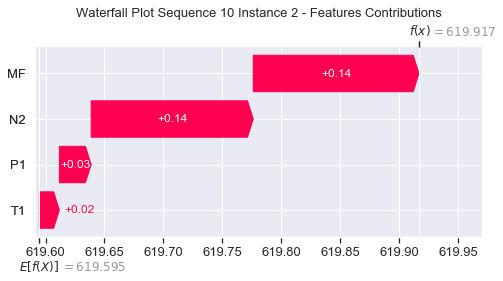

None

Contribution: [0.00304738 0.00127984 0.05193923 0.06093335]


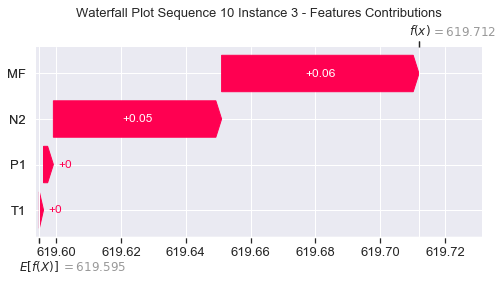

None

Contribution: [0.00508498 0.00381728 0.03135099 0.03184834]


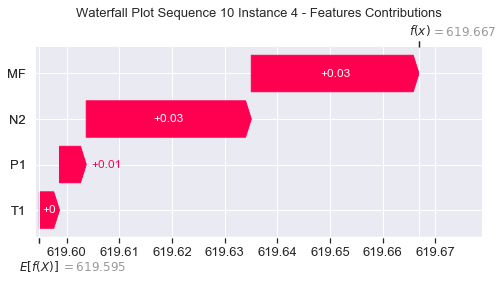

None

Contribution: [0.01100356 0.00930393 0.05008809 0.050171  ]


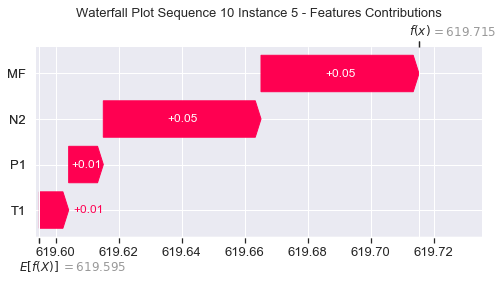

None

Contribution: [0.01315172 0.00805027 0.05557272 0.05606931]


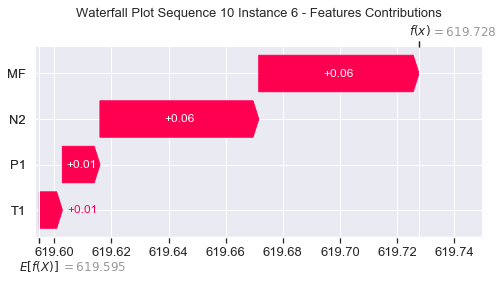

None

Contribution: [0.01413276 0.00759038 0.05837017 0.05841047]


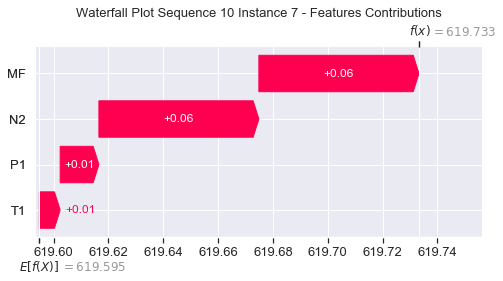

None

Contribution: [0.01507023 0.00862032 0.05995726 0.05999304]


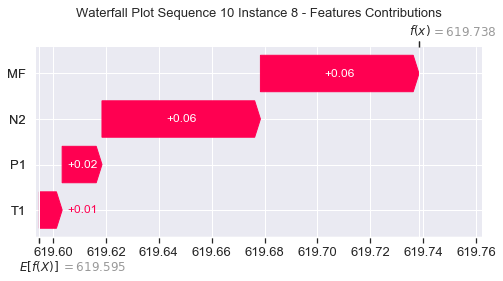

None

Contribution: [0.01610403 0.01091129 0.06067249 0.06139587]


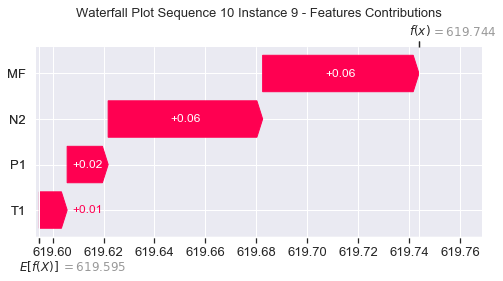

None

Contribution: [0.01642479 0.01218043 0.06187325 0.06203395]


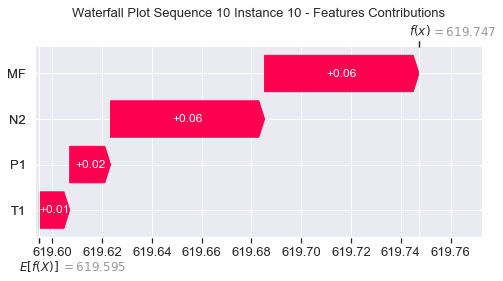

None

Contribution: [0.01842446 0.01393709 0.06420618 0.06600397]


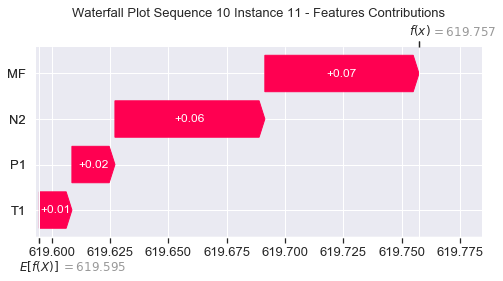

None

Contribution: [0.01812503 0.00970725 0.06773653 0.06714434]


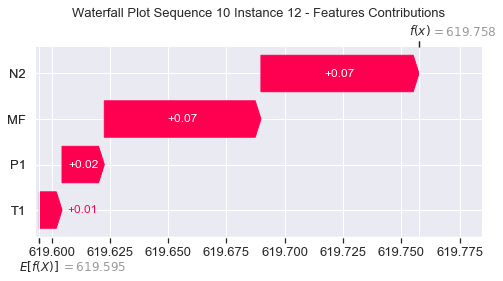

None

Contribution: [0.019846   0.01060464 0.073467   0.07217214]


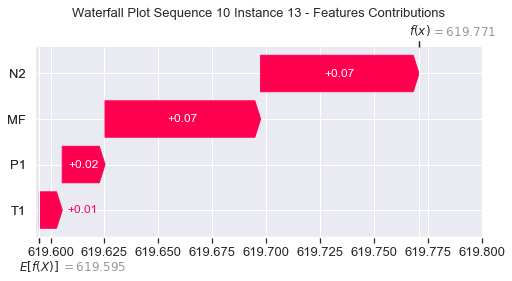

None

Contribution: [0.02271211 0.01541856 0.08141136 0.07928338]


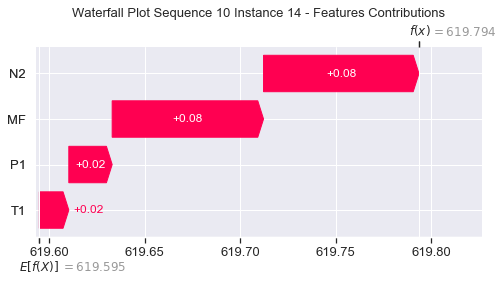

None

Contribution: [0.02599948 0.01298663 0.09227068 0.09053956]


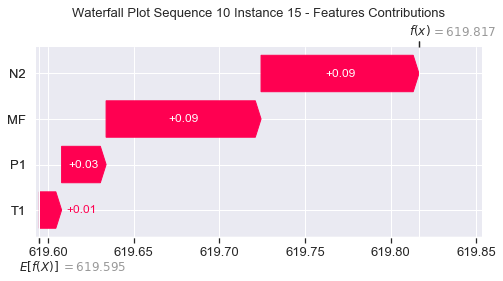

None

Contribution: [0.02859698 0.00367479 0.10605381 0.10427081]


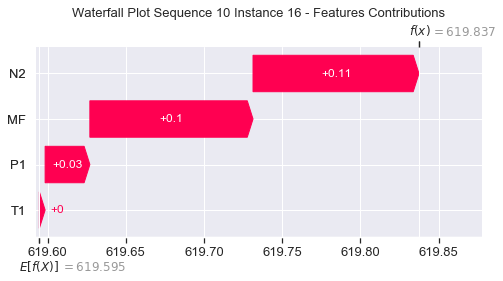

None

Contribution: [0.03595958 0.0164964  0.12343505 0.12055615]


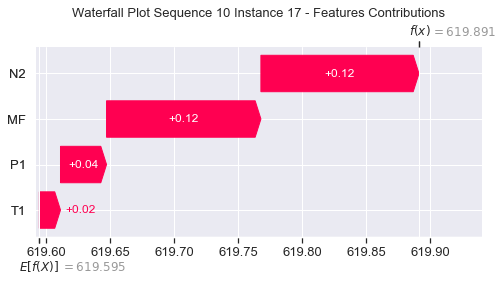

None

Contribution: [0.04344697 0.0196868  0.14583383 0.14266102]


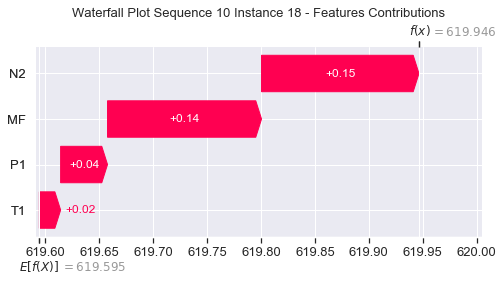

None

Contribution: [0.05203012 0.01083358 0.17665452 0.17383693]


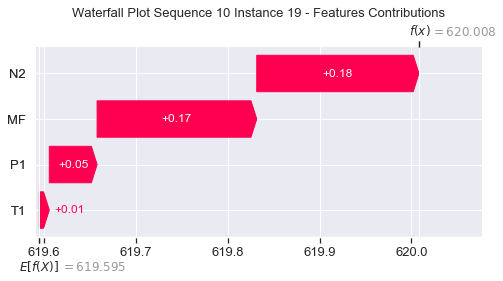

None

Contribution: [0.06490559 0.02887405 0.2129345  0.20714083]


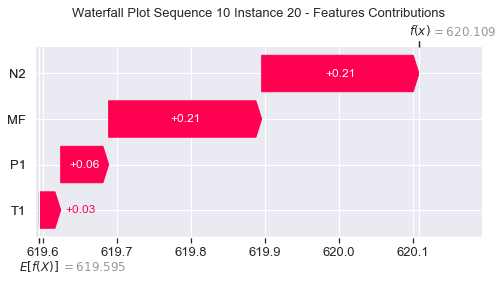

None

Contribution: [0.0819144  0.03695402 0.26456978 0.25819836]


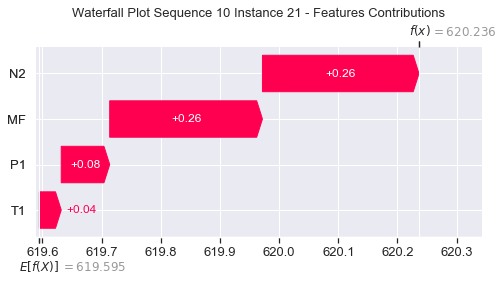

None

Contribution: [0.10651629 0.10054849 0.33786994 0.32635473]


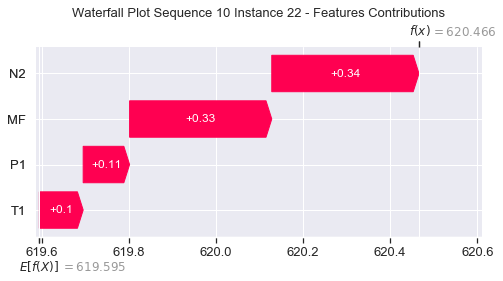

None

Contribution: [0.12198462 0.13611344 0.37436516 0.36110597]


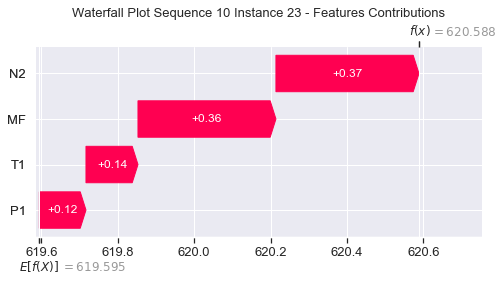

None

Contribution: [ 0.33357082 -1.94760021  1.08925736  1.21740266]


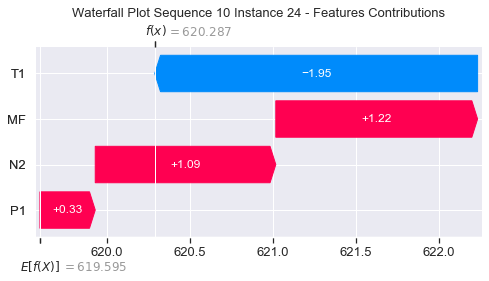

None

Contribution: [0.30613459 0.18966491 1.20970533 1.11036232]


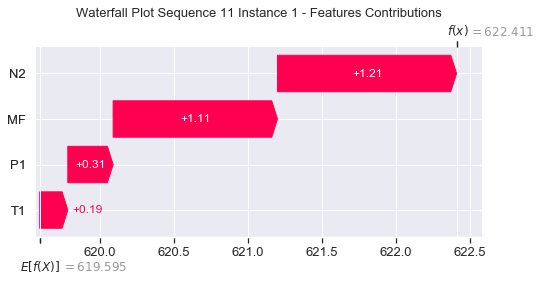

None

Contribution: [0.02921969 0.0035032  0.13034655 0.13307951]


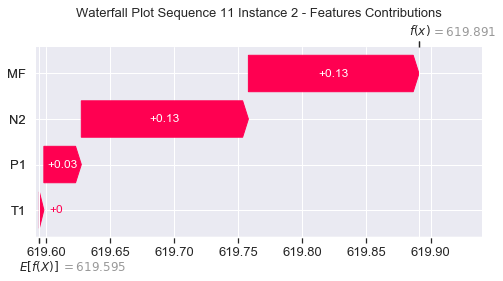

None

Contribution: [0.00371038 0.00072301 0.0500416  0.0600237 ]


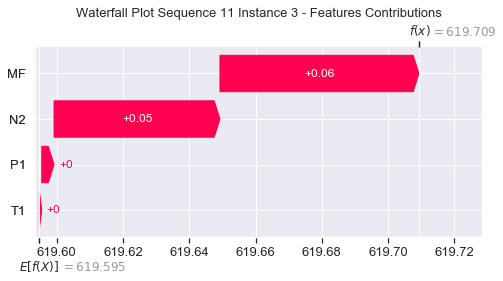

None

Contribution: [0.00522756 0.00462957 0.03018215 0.03150857]


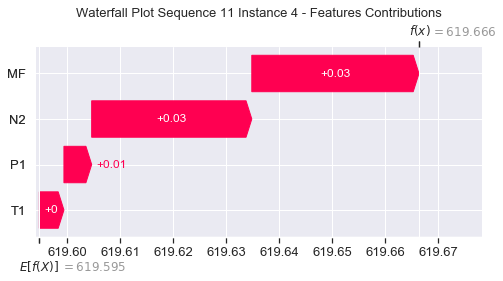

None

Contribution: [0.0111657  0.00929453 0.04840679 0.04919722]


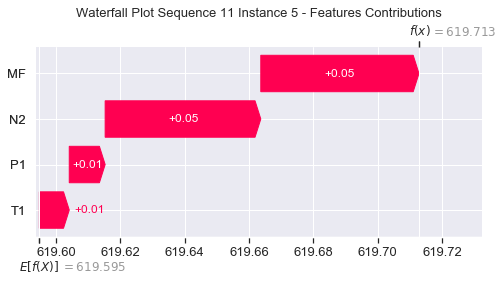

None

Contribution: [0.01325439 0.0105786  0.05353467 0.05418065]


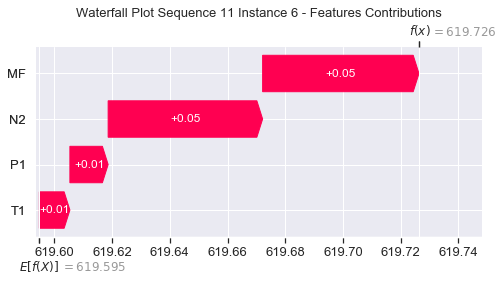

None

Contribution: [0.01432877 0.0113022  0.05646505 0.05663018]


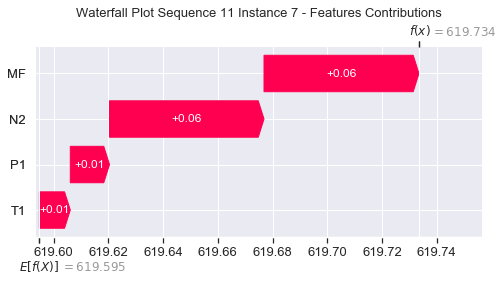

None

Contribution: [0.01517441 0.01175053 0.0582042  0.05819084]


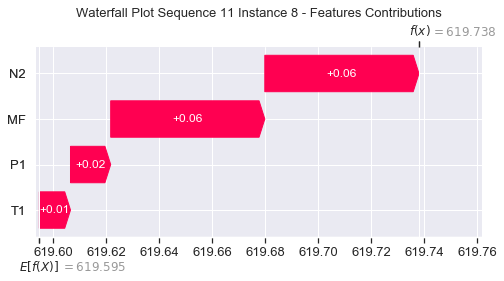

None

Contribution: [0.0150964  0.01256327 0.05910365 0.05738632]


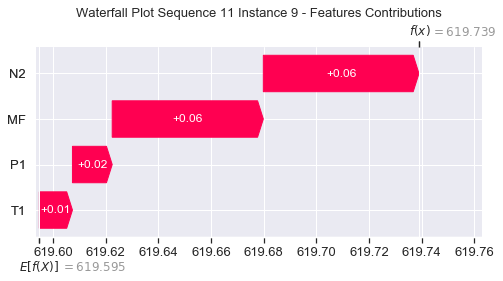

None

Contribution: [0.01535226 0.01297583 0.06029152 0.05922508]


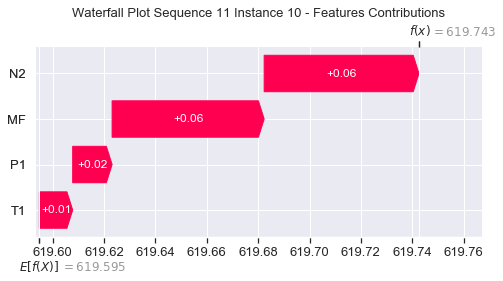

None

Contribution: [0.01707354 0.01349166 0.06235357 0.06101712]


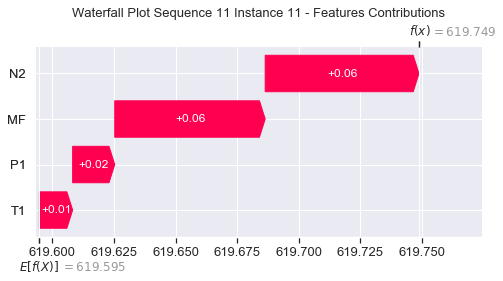

None

Contribution: [0.01840077 0.01428601 0.06584479 0.06492675]


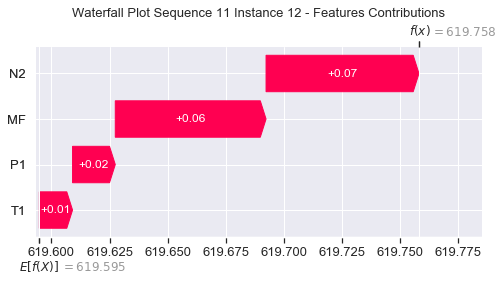

None

Contribution: [0.02024644 0.01634738 0.07167915 0.07035856]


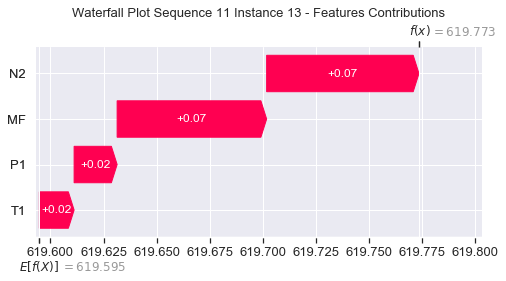

None

Contribution: [0.02296966 0.01935071 0.07976329 0.07862041]


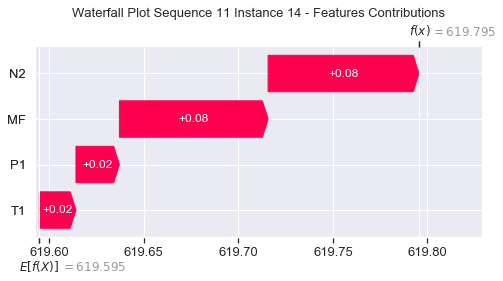

None

Contribution: [0.02654909 0.02217965 0.0902863  0.08871868]


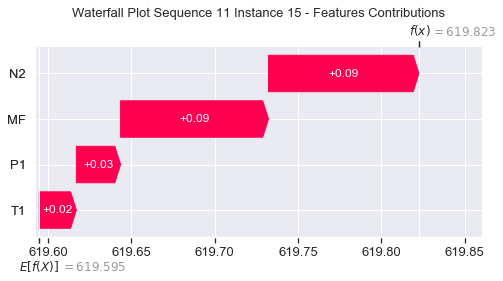

None

Contribution: [0.03307228 0.02460887 0.10396502 0.10502803]


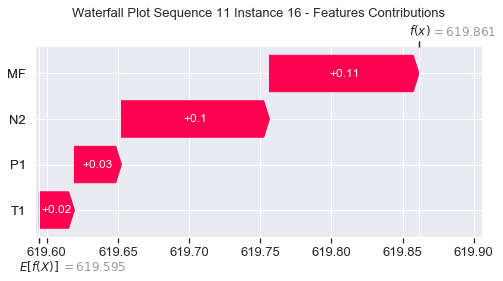

None

Contribution: [0.03671962 0.03258058 0.1212688  0.11900875]


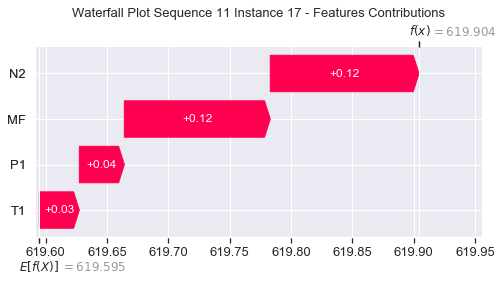

None

Contribution: [0.04436153 0.03989818 0.14349801 0.14144852]


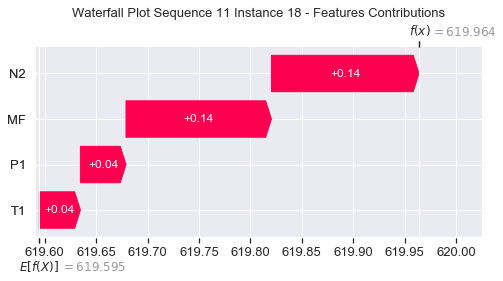

None

Contribution: [0.05564945 0.04992494 0.17293338 0.17668118]


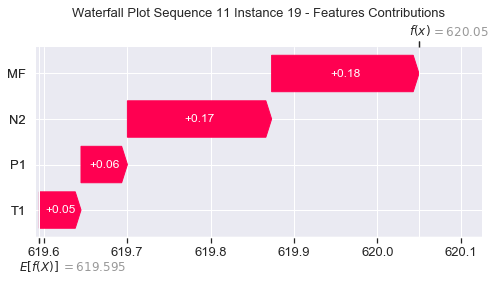

None

Contribution: [0.06602169 0.06165222 0.20963814 0.20744935]


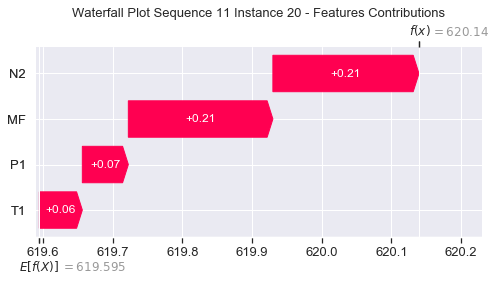

None

Contribution: [0.08340479 0.07659055 0.2610429  0.25934221]


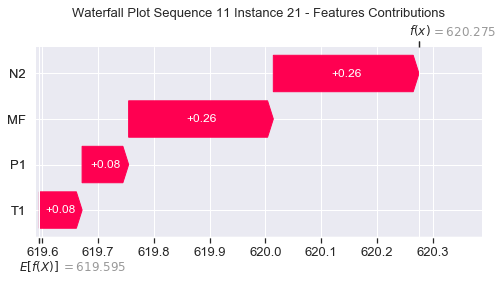

None

Contribution: [0.1067038  0.11832864 0.33375291 0.32468981]


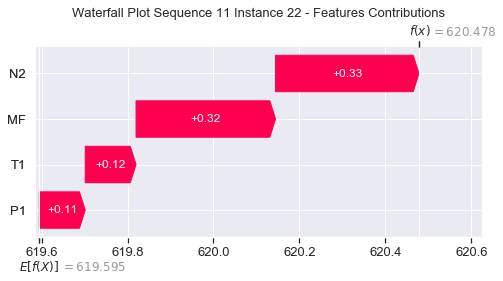

None

Contribution: [0.12146791 0.14692501 0.36928029 0.35706555]


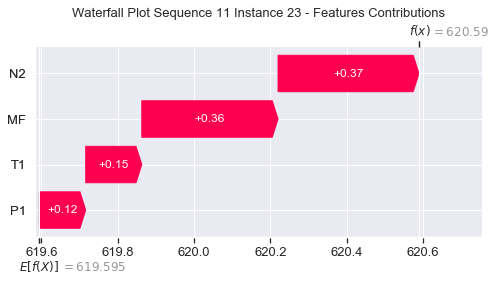

None

Contribution: [ 0.43361852 -0.59403652  1.0560048   1.47043912]


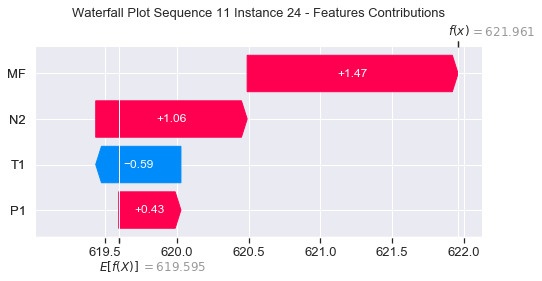

None

Contribution: [0.32952673 0.41885004 1.16127717 1.1305879 ]


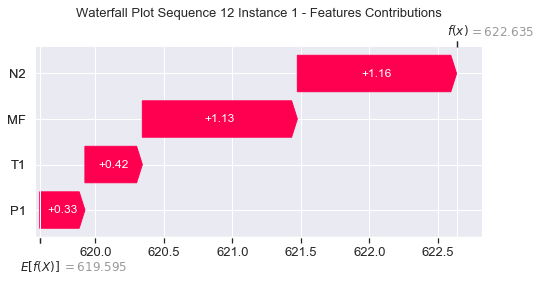

None

Contribution: [0.03041967 0.04465937 0.12394691 0.13287206]


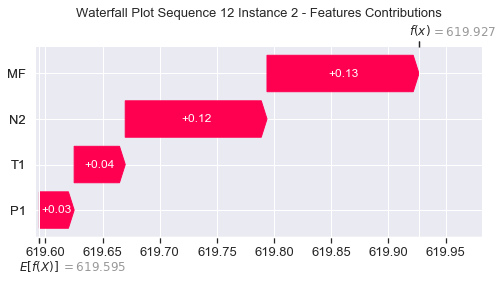

None

Contribution: [0.00280566 0.00439041 0.04547267 0.0556742 ]


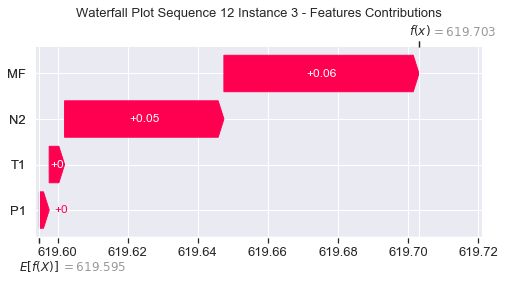

None

Contribution: [0.00575816 0.00607605 0.03164061 0.0330125 ]


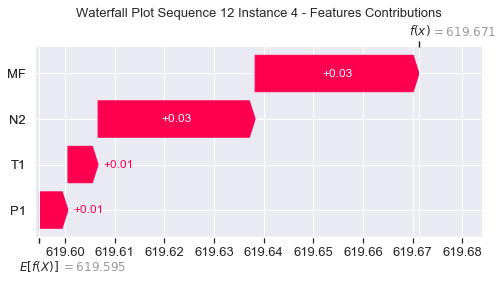

None

Contribution: [0.01150208 0.01106824 0.0492642  0.04977772]


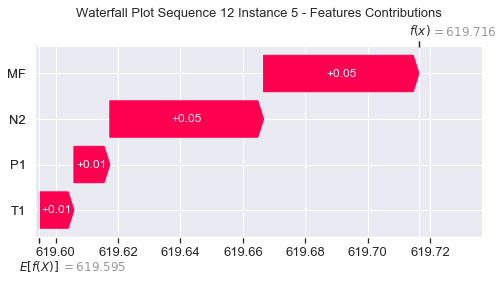

None

Contribution: [0.0134768  0.0117005  0.05456177 0.05539715]


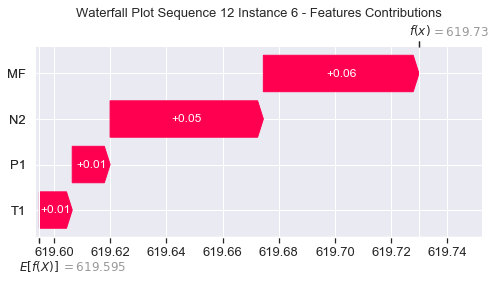

None

Contribution: [0.01465117 0.01206005 0.05747079 0.05807676]


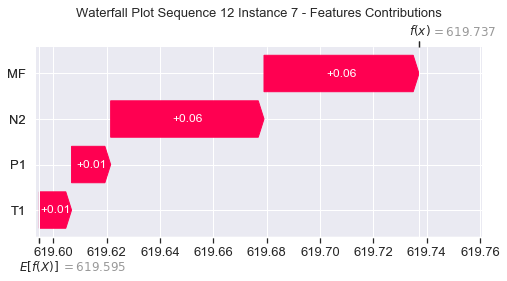

None

Contribution: [0.01539652 0.01258025 0.05915113 0.05943584]


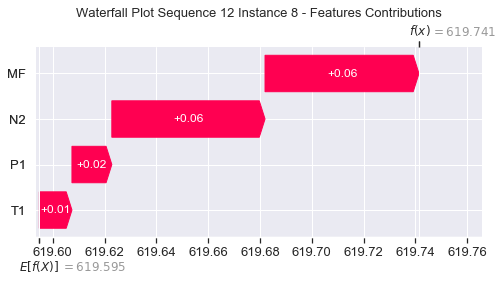

None

Contribution: [0.01580244 0.01283774 0.06001061 0.05966337]


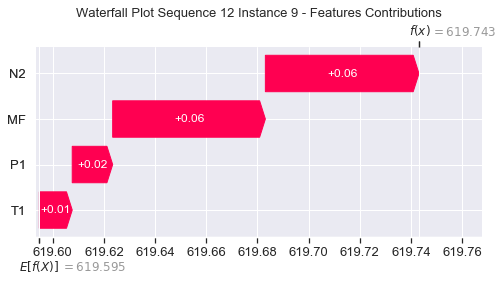

None

Contribution: [0.01675279 0.01341197 0.06126063 0.06196218]


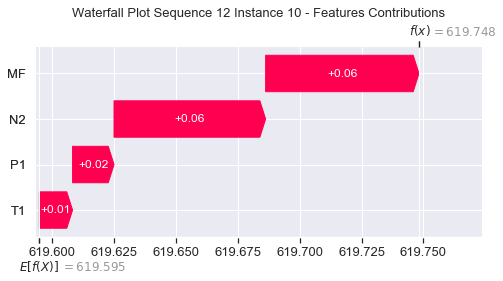

None

Contribution: [0.01698049 0.01427355 0.06307005 0.06214363]


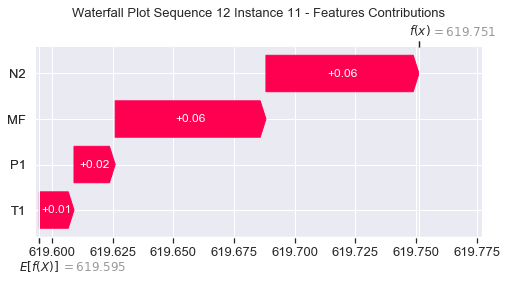

None

Contribution: [0.01817182 0.01394305 0.06650256 0.06555083]


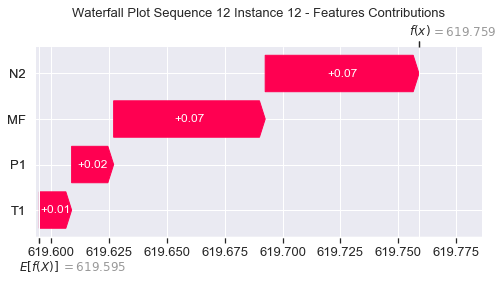

None

Contribution: [0.0201516  0.01575738 0.07233138 0.07113632]


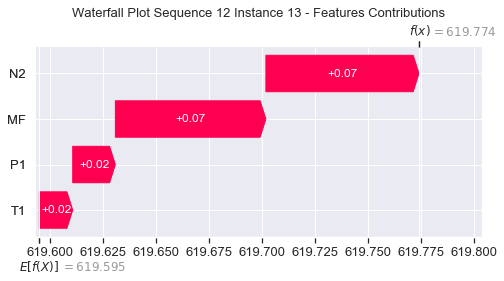

None

Contribution: [0.02308645 0.01703729 0.08037945 0.08015513]


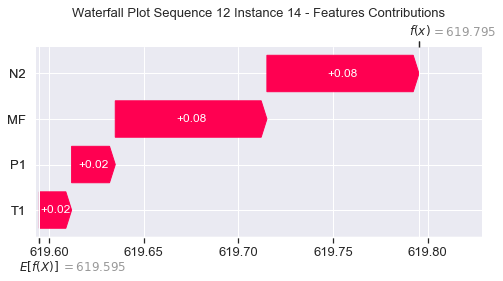

None

Contribution: [0.02629326 0.02090898 0.09096468 0.08942434]


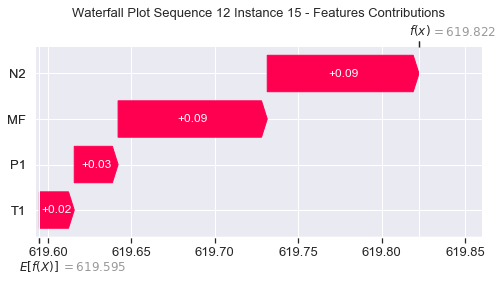

None

Contribution: [0.03111533 0.02282572 0.10474639 0.10440977]


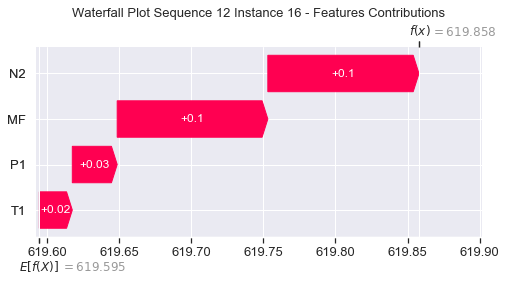

None

Contribution: [0.03667577 0.02934914 0.1220717  0.12053215]


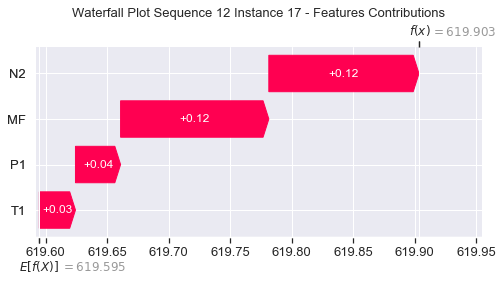

None

Contribution: [0.04410753 0.03567703 0.14440197 0.14296837]


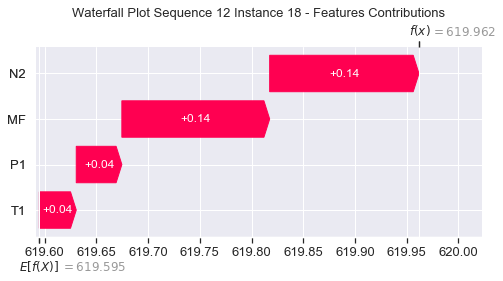

None

Contribution: [0.05297132 0.04220222 0.17372186 0.16969986]


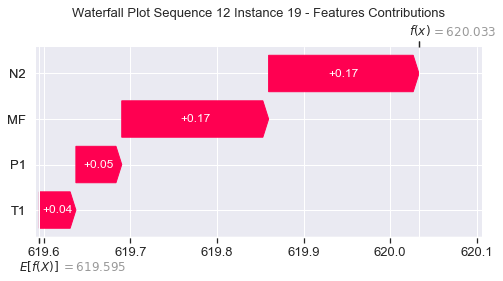

None

Contribution: [0.0664672  0.05500742 0.21111418 0.2096774 ]


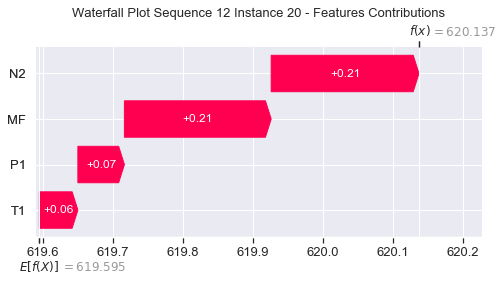

None

Contribution: [0.0834562  0.06796419 0.26232683 0.260848  ]


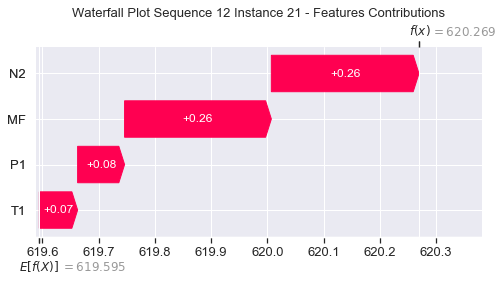

None

Contribution: [0.10636081 0.11449382 0.3345316  0.32468336]


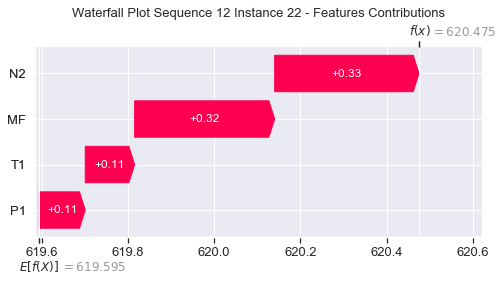

None

Contribution: [0.12071284 0.14497117 0.36919982 0.3563479 ]


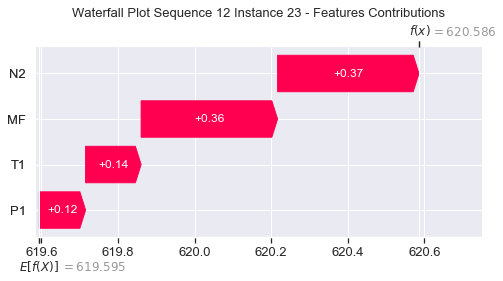

None

Contribution: [ 0.38563019 -0.83139169  1.11730574  1.50219035]


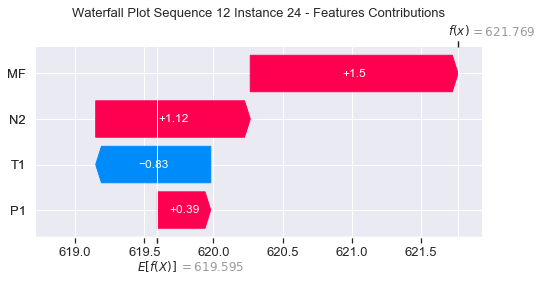

None

Contribution: [0.31537734 0.39106867 1.16964049 1.16266591]


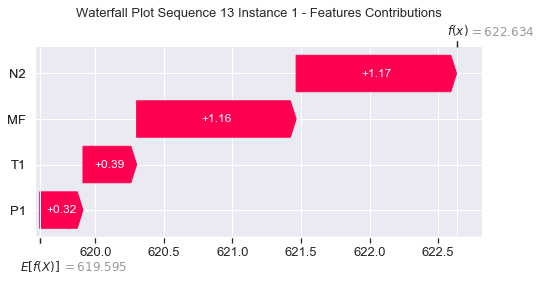

None

Contribution: [0.02872835 0.03249902 0.1235488  0.12767588]


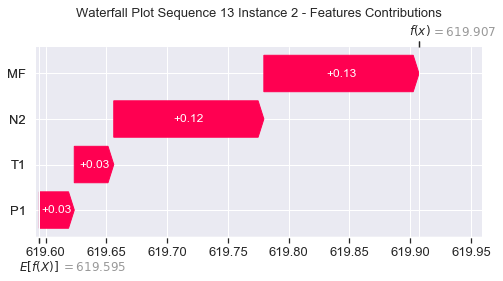

None

Contribution: [0.00222358 0.00389719 0.04539146 0.05376907]


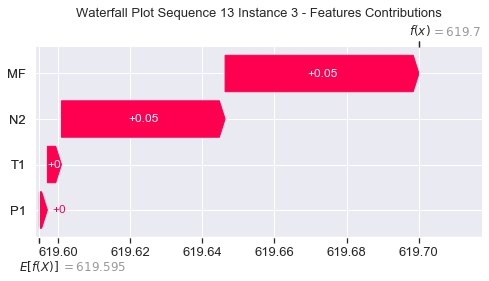

None

Contribution: [0.00557811 0.00611066 0.03174393 0.0330205 ]


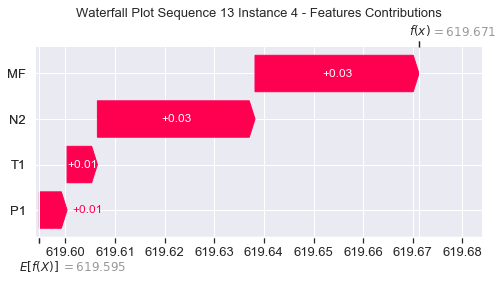

None

Contribution: [0.01126089 0.0102645  0.04940462 0.04967714]


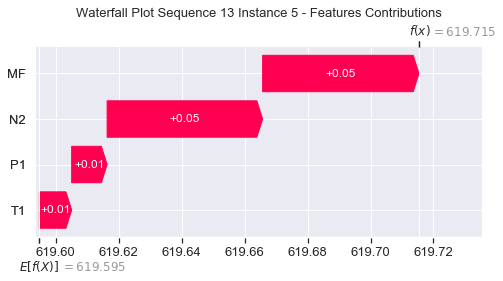

None

Contribution: [0.01311251 0.01135312 0.05459349 0.05420668]


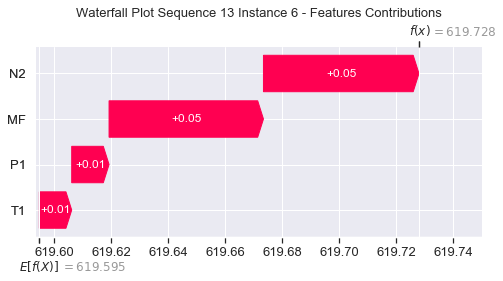

None

Contribution: [0.01421208 0.0118758  0.05743468 0.05680808]


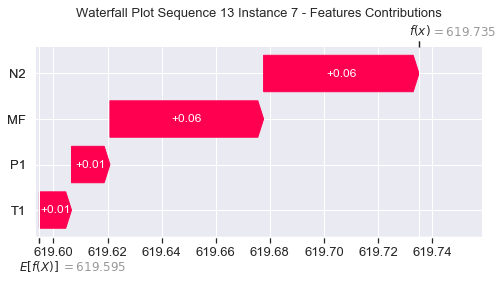

None

Contribution: [0.01494083 0.01242001 0.05909972 0.0584442 ]


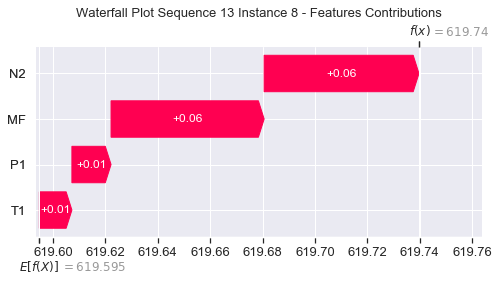

None

Contribution: [0.01552991 0.01289763 0.0600323  0.06007877]


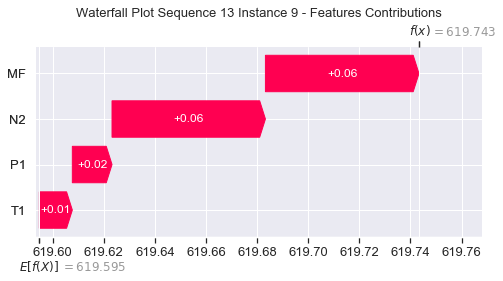

None

Contribution: [0.01573496 0.01108376 0.06109026 0.06040872]


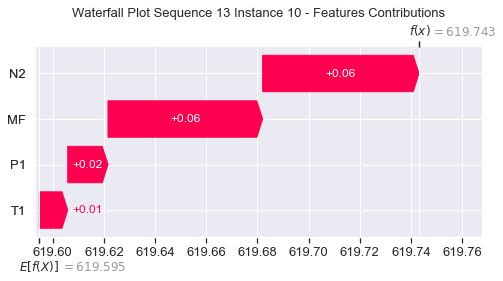

None

Contribution: [0.01671949 0.01463802 0.06306391 0.06256688]


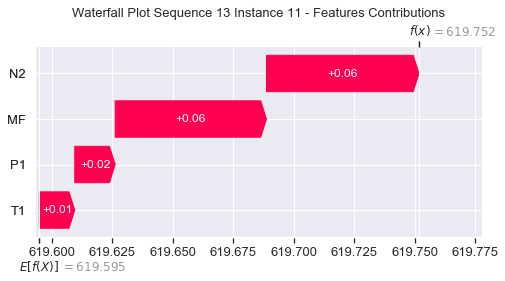

None

Contribution: [0.01772191 0.01565068 0.06648498 0.06489324]


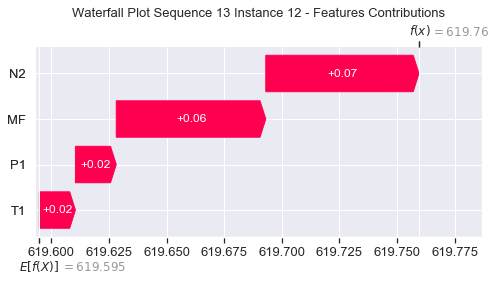

None

Contribution: [0.0195989  0.01750683 0.07230391 0.07047752]


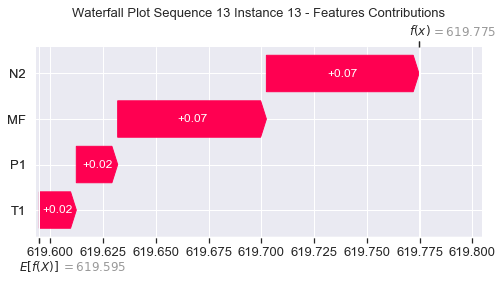

None

Contribution: [0.02239364 0.02102523 0.08038312 0.07932474]


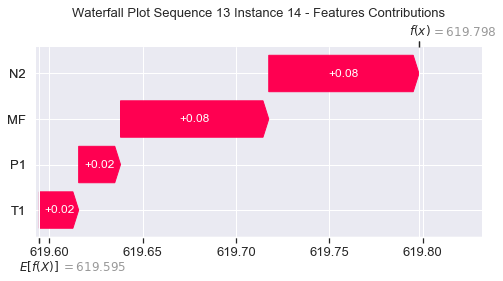

None

Contribution: [0.02547617 0.02347921 0.09092689 0.08843437]


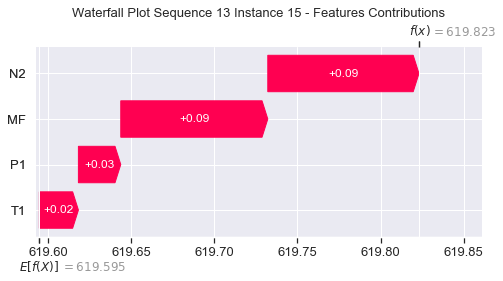

None

Contribution: [0.0296704  0.02694915 0.10458799 0.10196263]


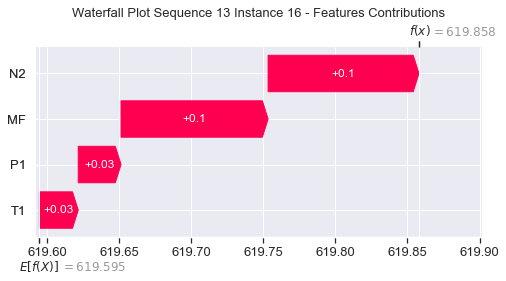

None

Contribution: [0.03544423 0.03330821 0.12200495 0.11909953]


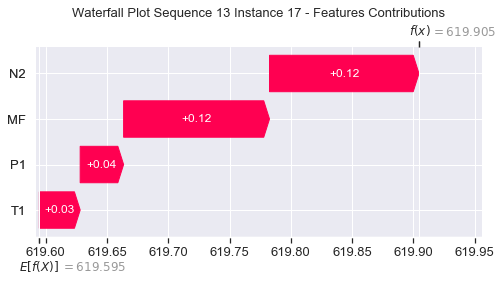

None

Contribution: [0.04253313 0.04051216 0.14426777 0.14111586]


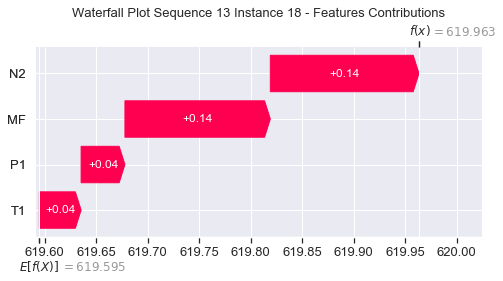

None

Contribution: [0.0506657  0.0477084  0.17374253 0.17032588]


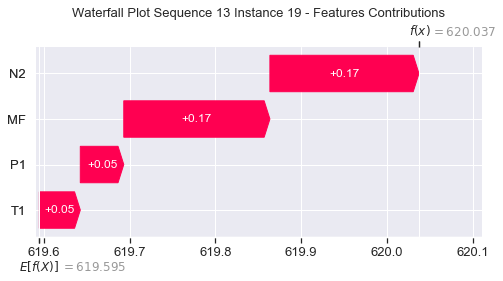

None

Contribution: [0.06373904 0.0611769  0.21079524 0.20815581]


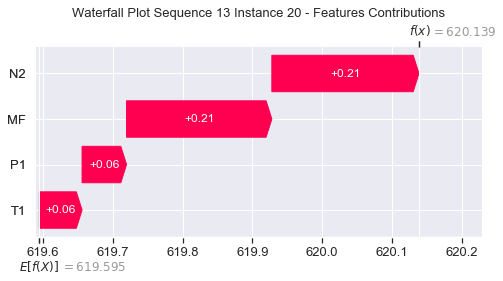

None

Contribution: [0.0801099  0.07700058 0.26210573 0.26027082]


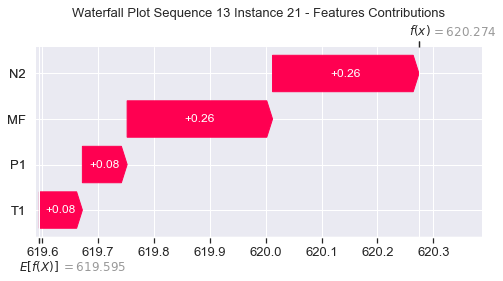

None

Contribution: [0.1042105  0.11927745 0.33404016 0.32472407]


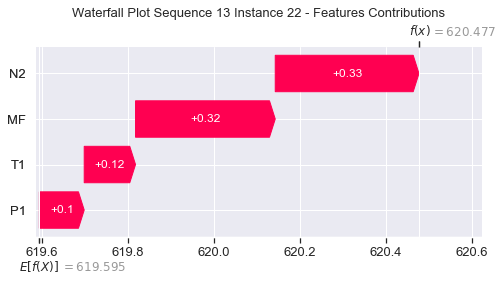

None

Contribution: [0.11895033 0.14791039 0.36854368 0.35565973]


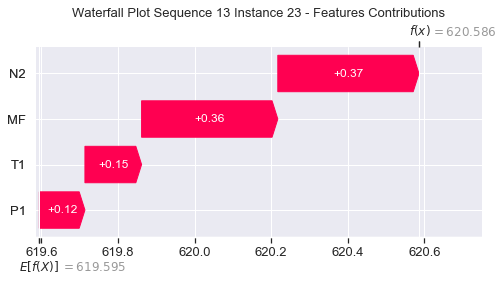

None

Contribution: [ 0.27260102 -0.51444232  1.10714186  1.40225466]


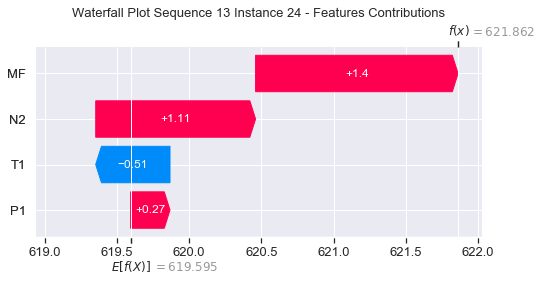

None

Contribution: [0.30283189 0.46916505 1.16091501 1.09889239]


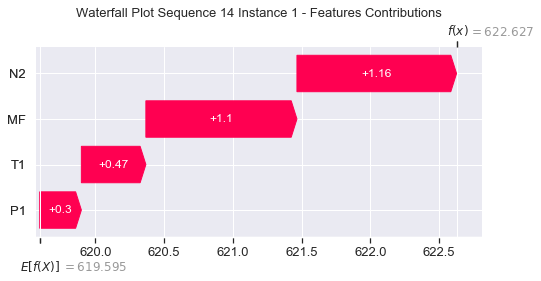

None

Contribution: [0.02629    0.04982871 0.12457945 0.13466254]


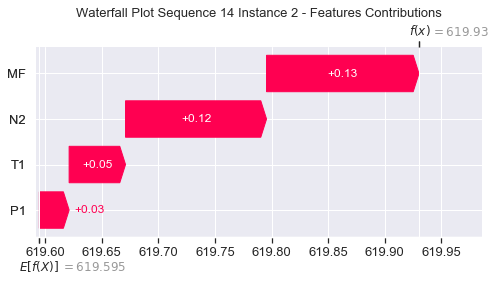

None

Contribution: [0.00200466 0.00747764 0.04518978 0.05469607]


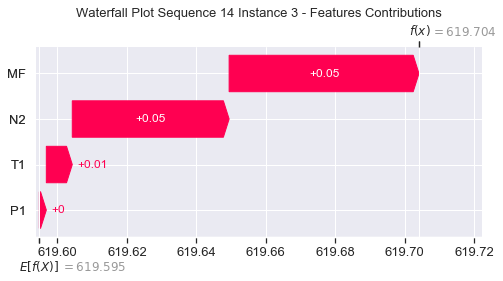

None

Contribution: [0.00574363 0.00716172 0.03190485 0.03377765]


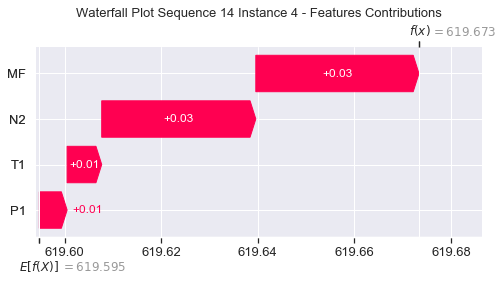

None

Contribution: [0.01128117 0.01260847 0.04909103 0.04952556]


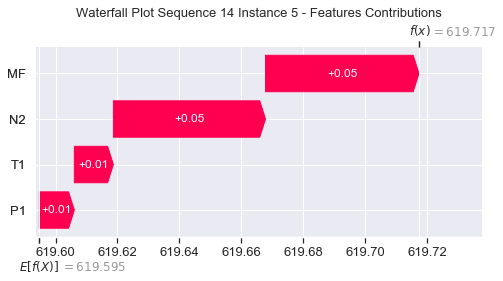

None

Contribution: [0.01307938 0.01351543 0.0543153  0.05428833]


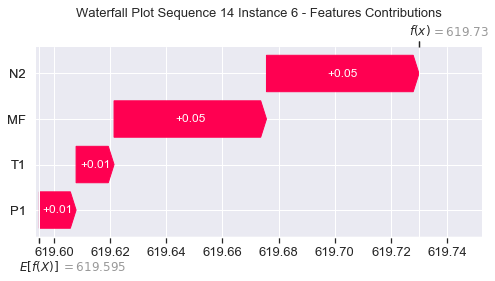

None

Contribution: [0.01421512 0.0141822  0.05721087 0.05702473]


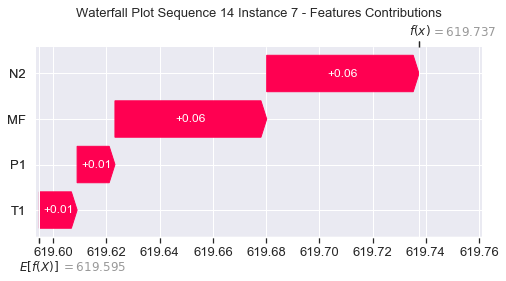

None

Contribution: [0.01494461 0.0147492  0.05892676 0.05845809]


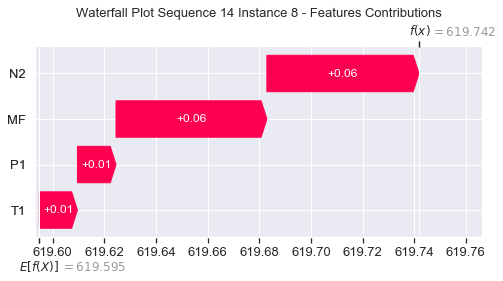

None

Contribution: [0.01550468 0.01609998 0.05986819 0.05911577]


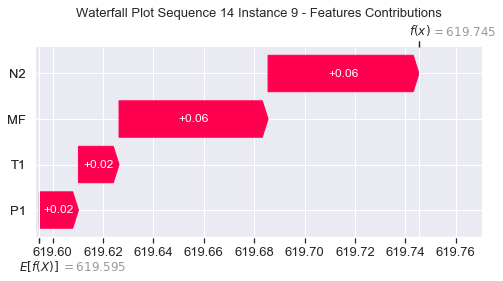

None

Contribution: [0.01591942 0.01651761 0.06100501 0.06067208]


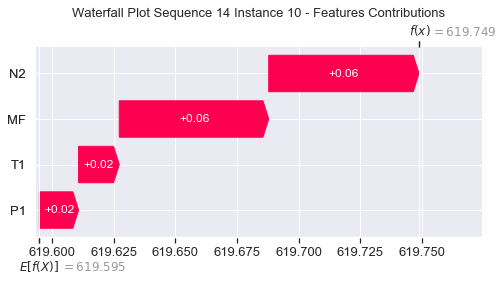

None

Contribution: [0.01659291 0.01730748 0.06302104 0.06140243]


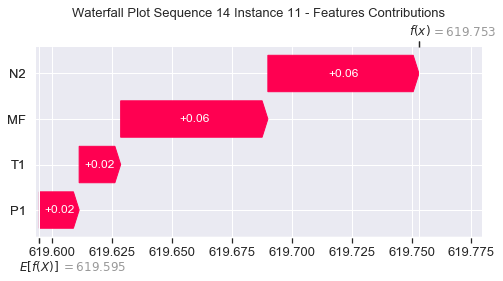

None

Contribution: [0.01768395 0.01688166 0.06645785 0.06495536]


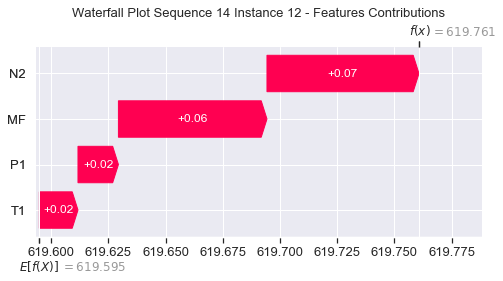

None

Contribution: [0.01960951 0.01897088 0.07229657 0.07056917]


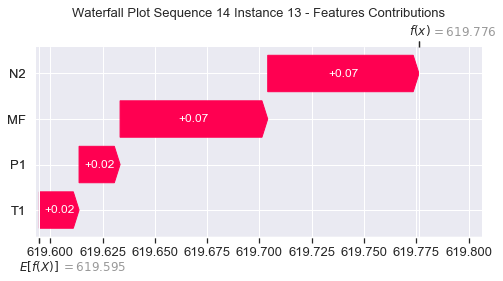

None

Contribution: [0.02226436 0.02158634 0.08016581 0.077862  ]


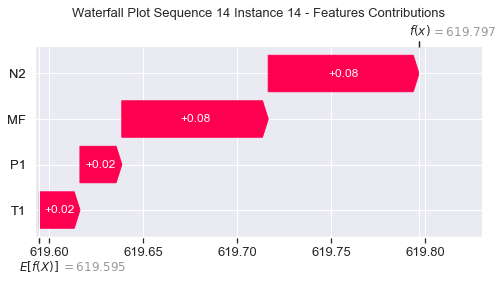

None

Contribution: [0.02553045 0.02465293 0.09091566 0.0884934 ]


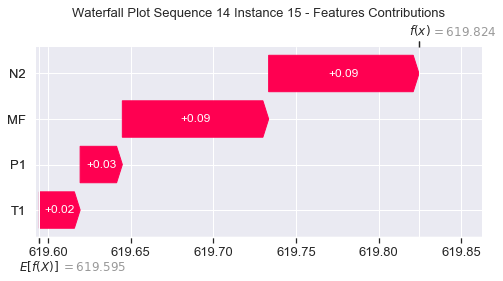

None

Contribution: [0.02968009 0.02638925 0.10466568 0.10289002]


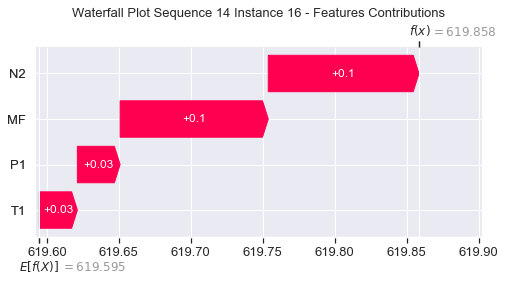

None

Contribution: [0.03549056 0.03415774 0.12197326 0.11908887]


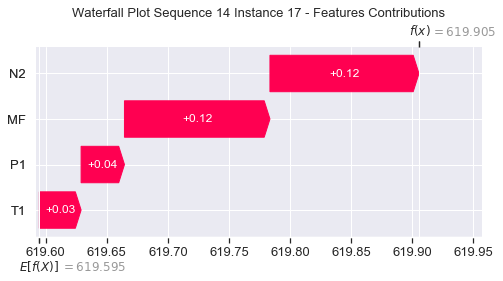

None

Contribution: [0.04256485 0.04082659 0.14422017 0.14095403]


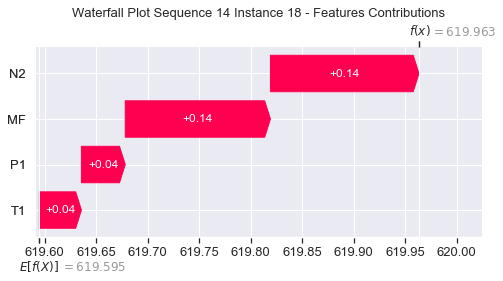

None

Contribution: [0.05232656 0.04729437 0.17407079 0.17123371]


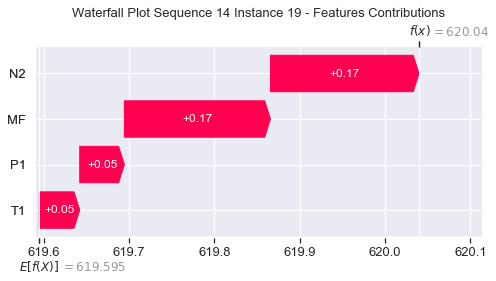

None

Contribution: [0.06407625 0.06158724 0.21077402 0.20749706]


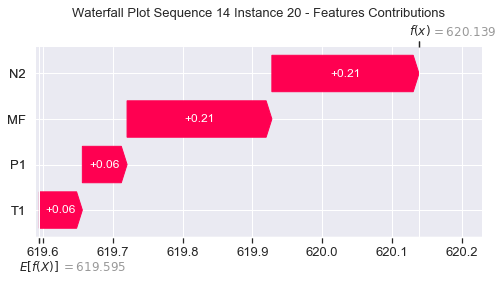

None

Contribution: [0.08044906 0.07634286 0.26205086 0.25876938]


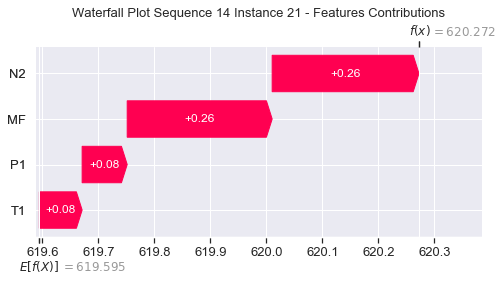

None

Contribution: [0.10451069 0.11844956 0.33424297 0.32386576]


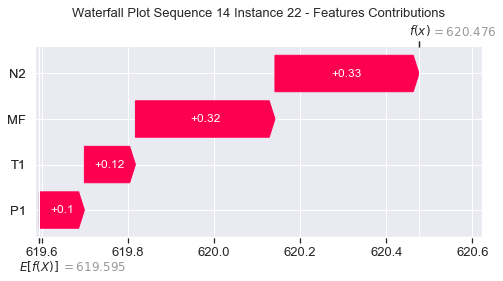

None

Contribution: [0.11917404 0.14723089 0.36895152 0.35558354]


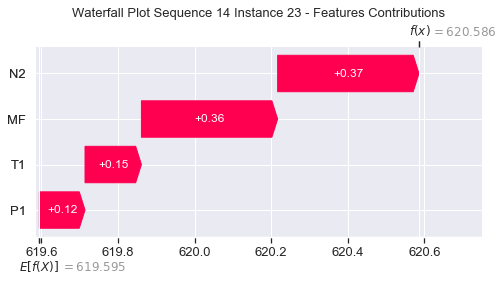

None

Contribution: [ 0.27770978 -0.63176375  1.09167075  1.31350405]


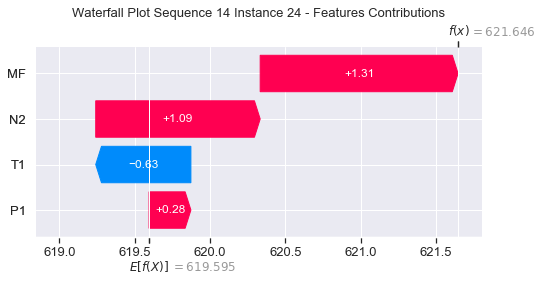

None

Contribution: [0.30292312 0.43686476 1.16447558 1.0928484 ]


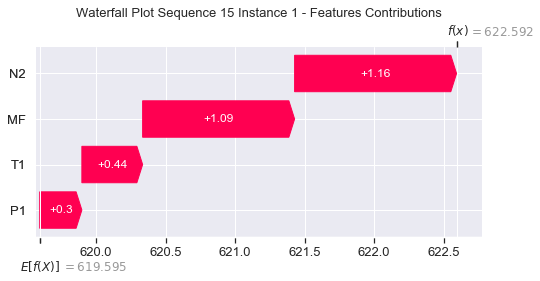

None

Contribution: [0.02674427 0.04268882 0.12535215 0.13164289]


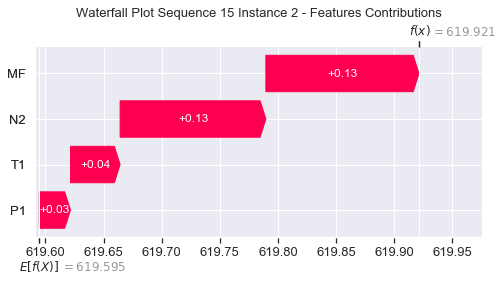

None

Contribution: [0.00246494 0.00546445 0.04608801 0.0548131 ]


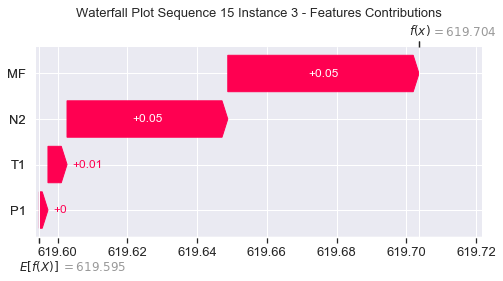

None

Contribution: [0.00542464 0.005826   0.03143444 0.03251519]


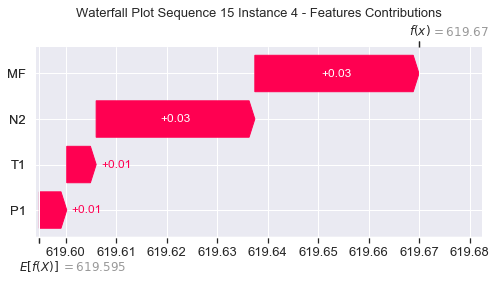

None

Contribution: [0.01117234 0.01124532 0.04907854 0.04948943]


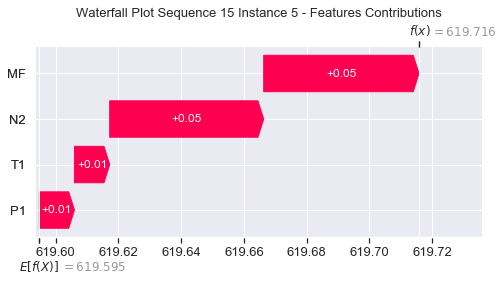

None

Contribution: [0.01312055 0.01203428 0.05440026 0.05472215]


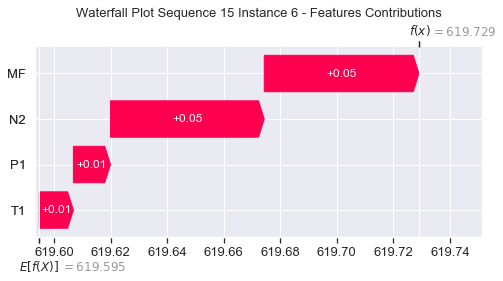

None

Contribution: [0.01424326 0.01283302 0.05728832 0.05741544]


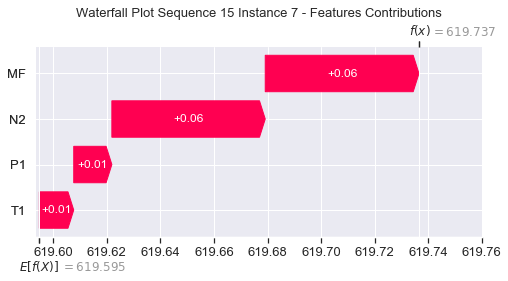

None

Contribution: [0.01493223 0.01328773 0.05897815 0.05875205]


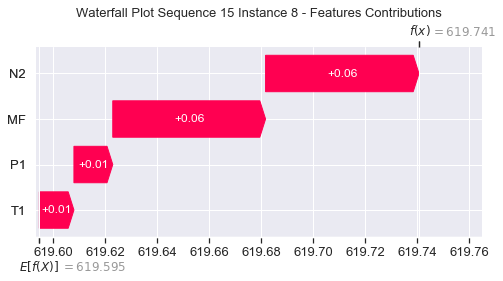

None

Contribution: [0.01520267 0.01429367 0.05987773 0.05939649]


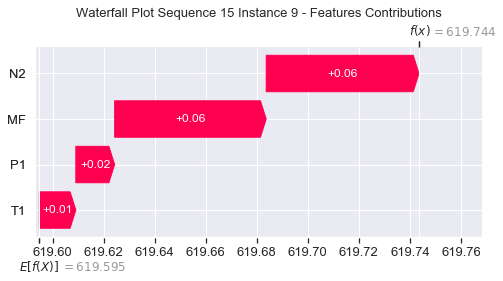

None

Contribution: [0.01585541 0.01466827 0.06101923 0.06092642]


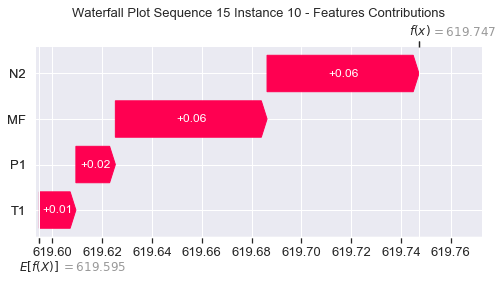

None

Contribution: [0.01626233 0.0151447  0.06291242 0.06129973]


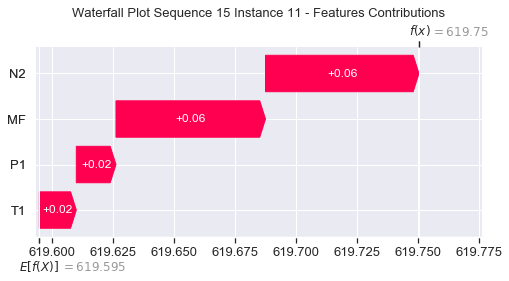

None

Contribution: [0.01759476 0.01631087 0.0663584  0.06462641]


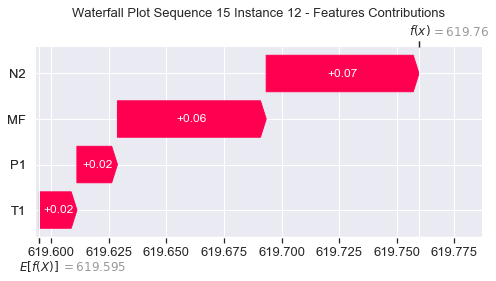

None

Contribution: [0.01951113 0.01841513 0.07220861 0.0702815 ]


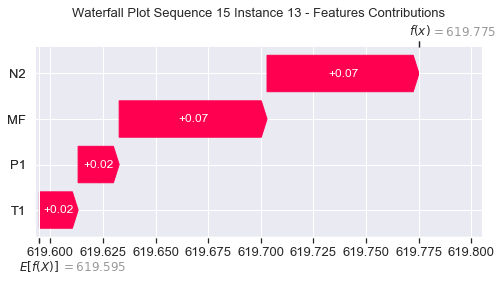

None

Contribution: [0.02256093 0.0197266  0.08043997 0.07952322]


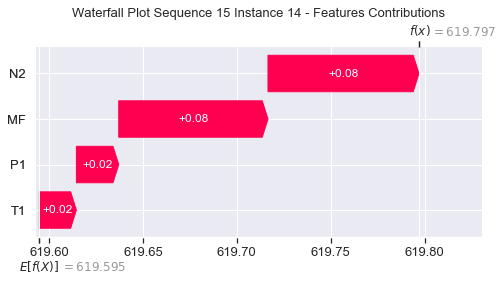

None

Contribution: [0.02542714 0.02407624 0.09087469 0.08845762]


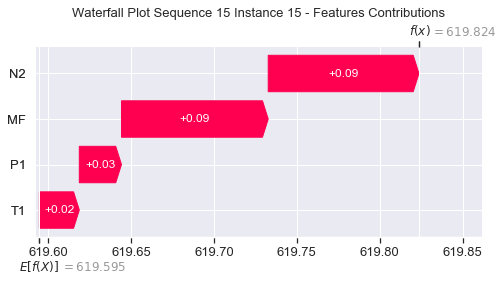

None

Contribution: [0.02991583 0.02876418 0.10456939 0.10309929]


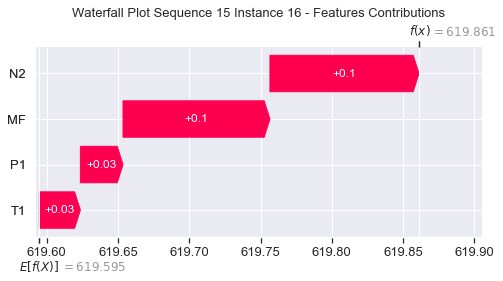

None

Contribution: [0.03545749 0.03408508 0.1219997  0.11918471]


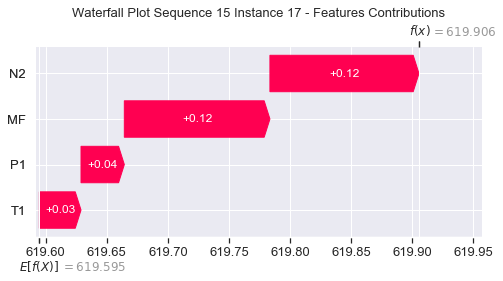

None

Contribution: [0.04261325 0.04088036 0.144309   0.14118586]


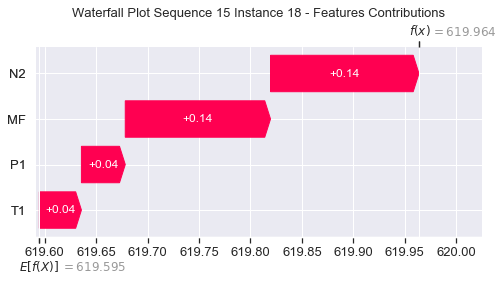

None

Contribution: [0.05235228 0.05089595 0.17361918 0.16971569]


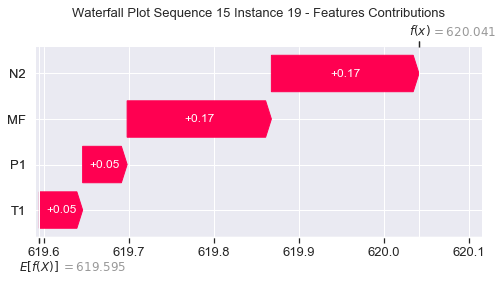

None

Contribution: [0.06393408 0.06224567 0.21089015 0.2075231 ]


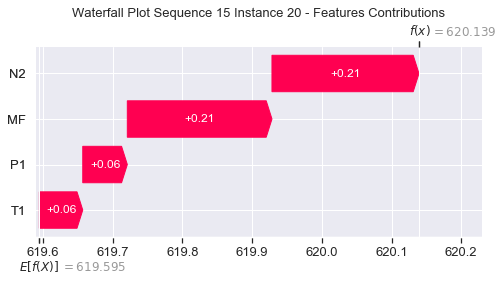

None

Contribution: [0.08008409 0.07778977 0.26218747 0.25822849]


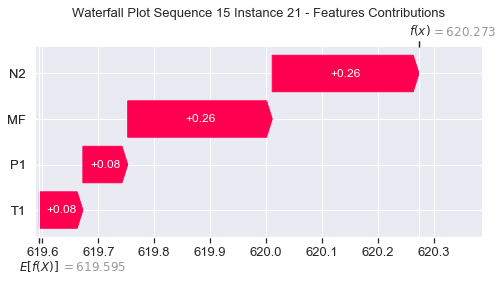

None

Contribution: [0.10411377 0.11932938 0.3342926  0.32327715]


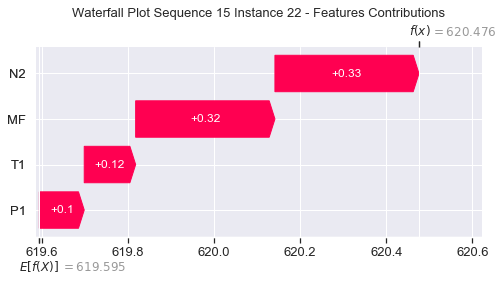

None

Contribution: [0.11904536 0.14765441 0.36911474 0.35564326]


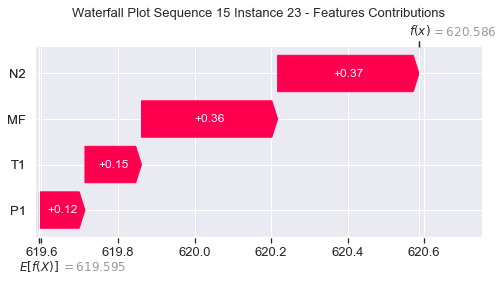

None

Contribution: [ 0.28488325 -0.58771281  1.1086781   1.39665172]


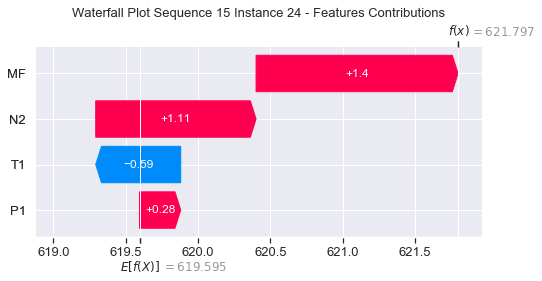

None

Contribution: [0.31183875 0.4473135  1.16983399 1.1552737 ]


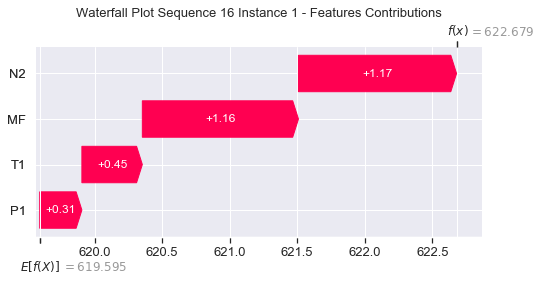

None

Contribution: [0.02509886 0.04945619 0.12369799 0.12586612]


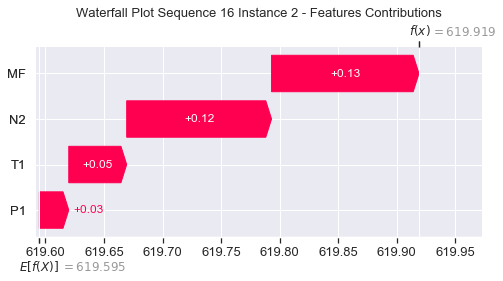

None

Contribution: [0.00187103 0.00626549 0.04530464 0.0545195 ]


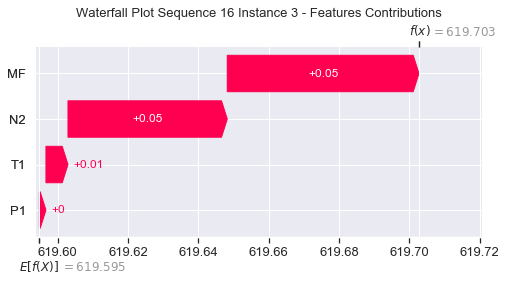

None

Contribution: [0.00571931 0.00680512 0.03204758 0.03300715]


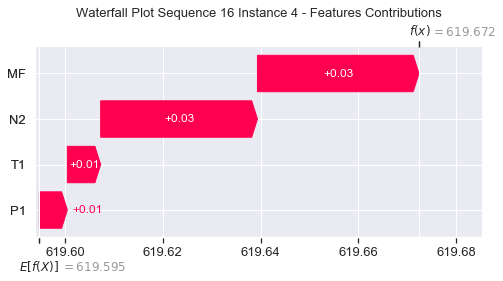

None

Contribution: [0.01141579 0.01110881 0.04956815 0.05027133]


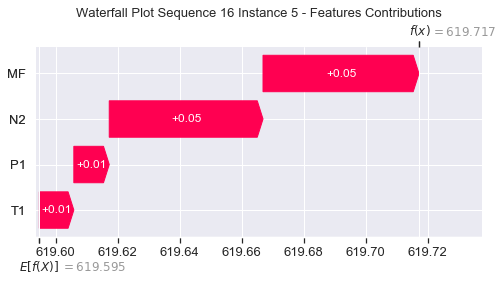

None

Contribution: [0.01332424 0.01193664 0.05489562 0.05534216]


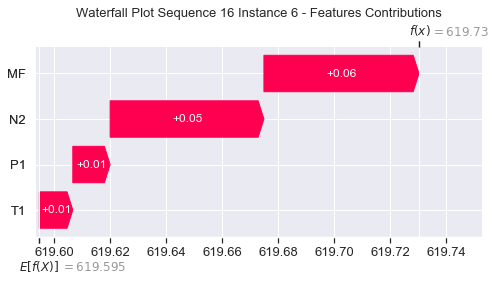

None

Contribution: [0.01441915 0.01268786 0.05778841 0.05798158]


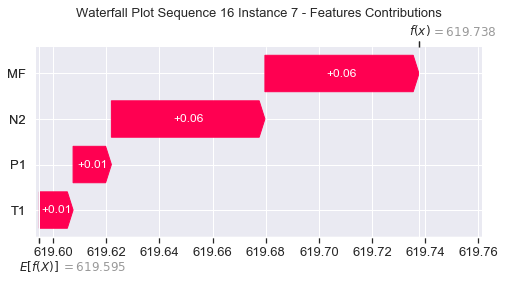

None

Contribution: [0.01513398 0.01289243 0.0594669  0.05942013]


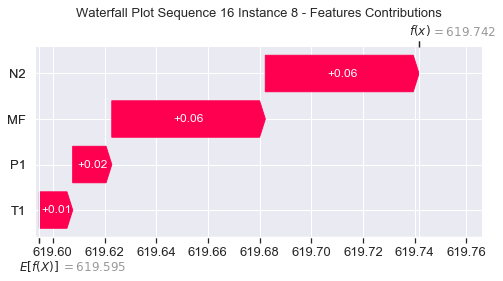

None

Contribution: [0.01546776 0.01279007 0.06040552 0.06030902]


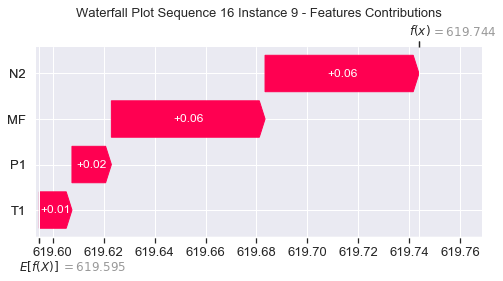

None

Contribution: [0.0158583  0.01432923 0.06142721 0.06116072]


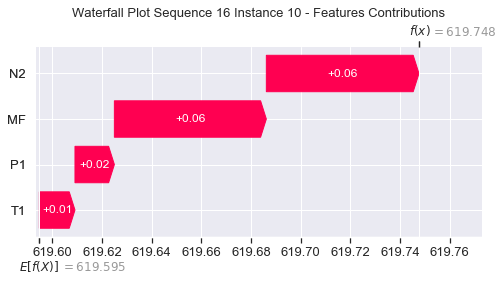

None

Contribution: [0.01667339 0.01305447 0.06346208 0.06289291]


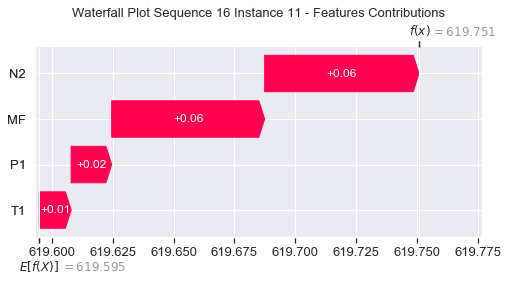

None

Contribution: [0.01772744 0.01522392 0.06684975 0.06577916]


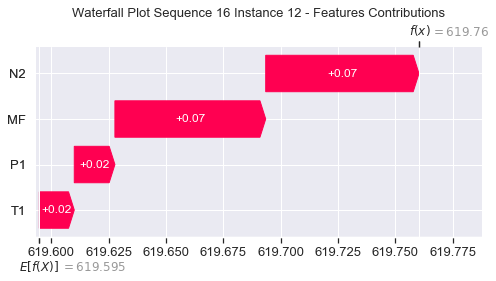

None

Contribution: [0.01960623 0.01731937 0.07266455 0.07125114]


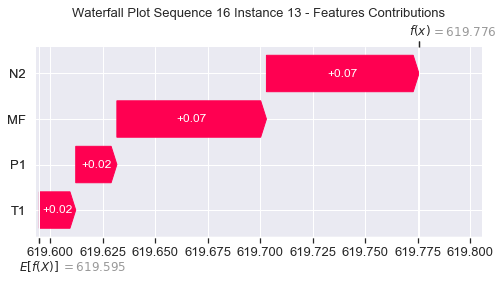

None

Contribution: [0.02204073 0.01951348 0.08055671 0.07848231]


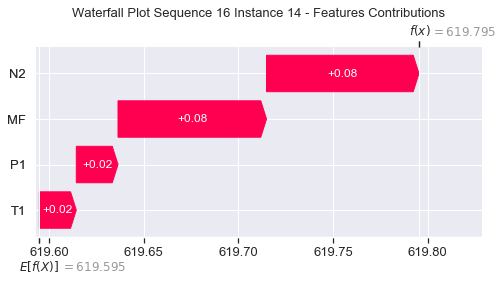

None

Contribution: [0.02555177 0.02261337 0.0912693  0.08900528]


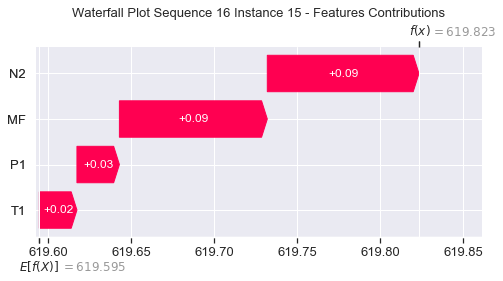

None

Contribution: [0.02936117 0.02494728 0.10465355 0.10046512]


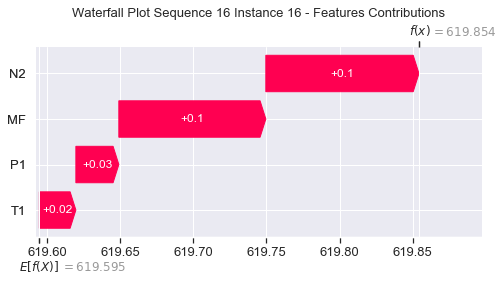

None

Contribution: [0.03541508 0.03218769 0.12227986 0.1192719 ]


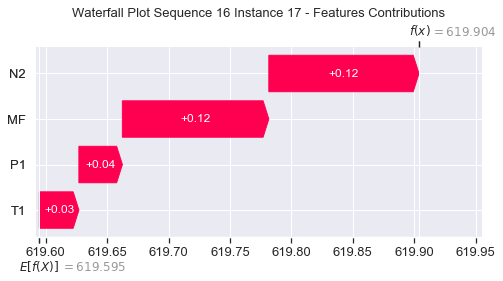

None

Contribution: [0.0425116  0.03862399 0.14444361 0.14096668]


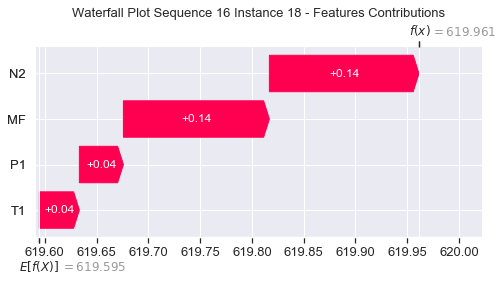

None

Contribution: [0.05234815 0.04604146 0.17368818 0.17268593]


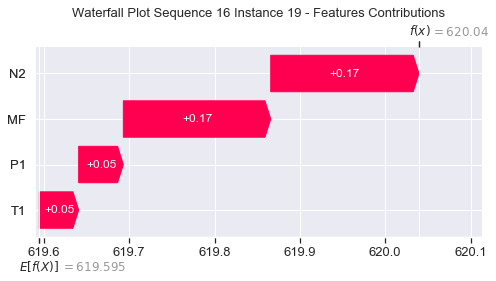

None

Contribution: [0.06380135 0.05877582 0.21079072 0.20622121]


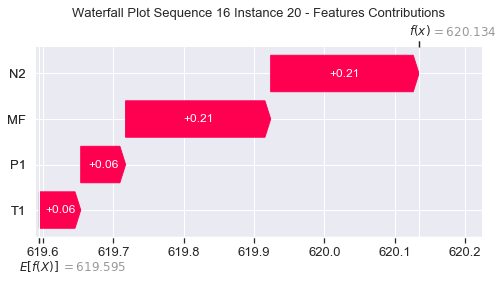

None

Contribution: [0.08000246 0.07262142 0.26208992 0.25700506]


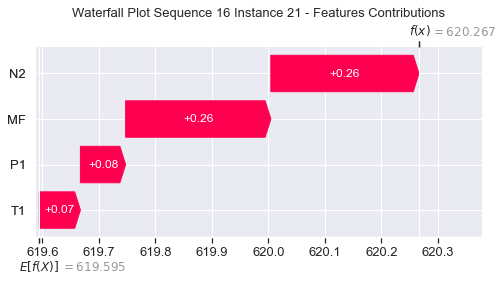

None

Contribution: [0.10435539 0.11636746 0.33464685 0.32331783]


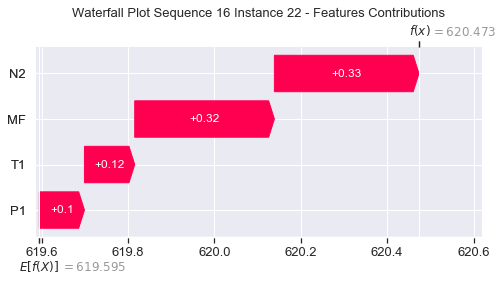

None

Contribution: [0.11922207 0.14635563 0.36961179 0.35591857]


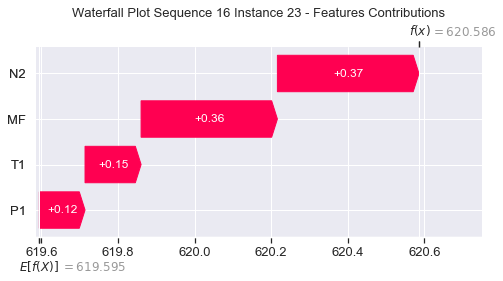

None

Contribution: [ 0.28583763 -0.7510527   1.0867741   1.31271236]


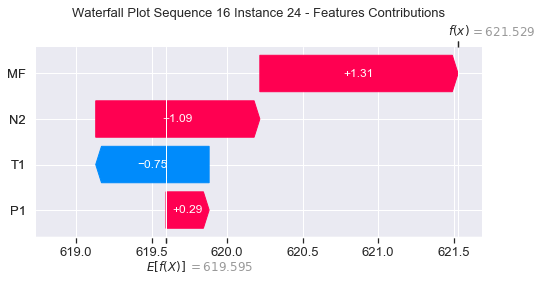

None

Contribution: [0.31381922 0.44327007 1.18461835 1.1546086 ]


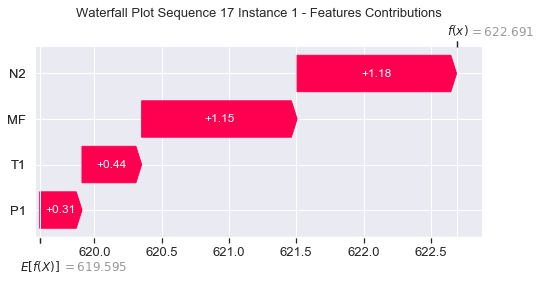

None

Contribution: [0.02553471 0.03961906 0.12508832 0.12829824]


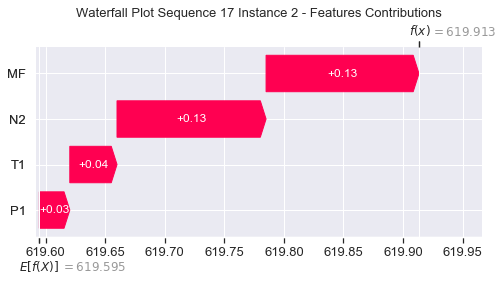

None

Contribution: [0.00261475 0.00436719 0.04620632 0.05505445]


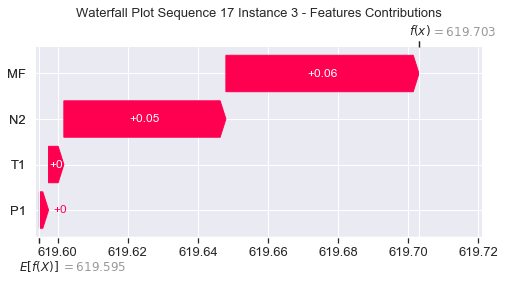

None

Contribution: [0.00584246 0.00596517 0.03233772 0.03406443]


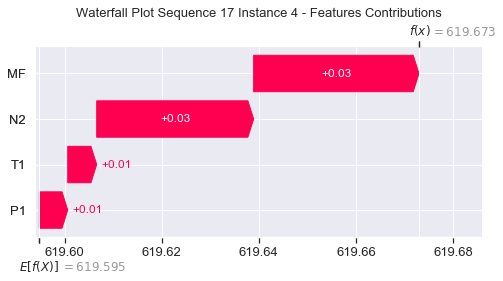

None

Contribution: [0.01149802 0.01006183 0.04993079 0.05032559]


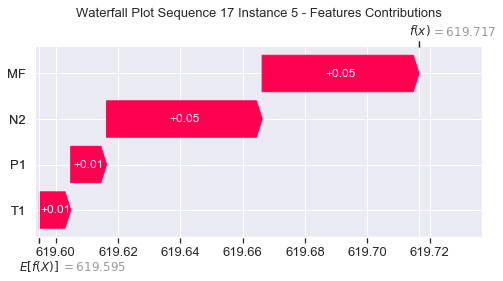

None

Contribution: [0.01328251 0.010894   0.0551513  0.05499259]


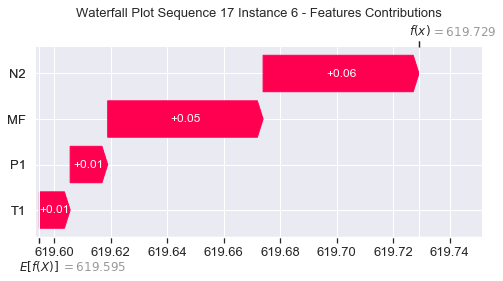

None

Contribution: [0.01440392 0.01138221 0.05802376 0.05758501]


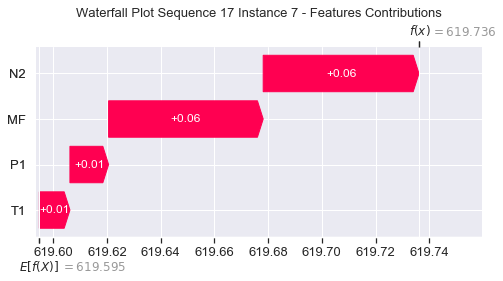

None

Contribution: [0.01510067 0.01178521 0.05965845 0.05894671]


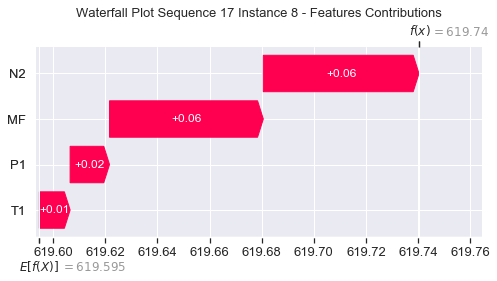

None

Contribution: [0.01550699 0.01204824 0.06045086 0.05973141]


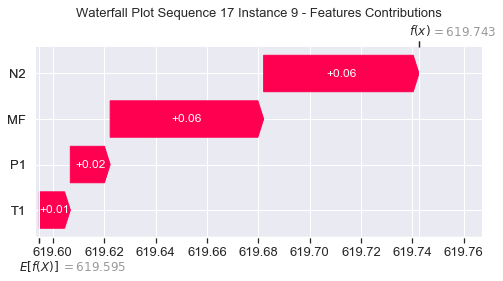

None

Contribution: [0.01577237 0.01323111 0.06175066 0.06079103]


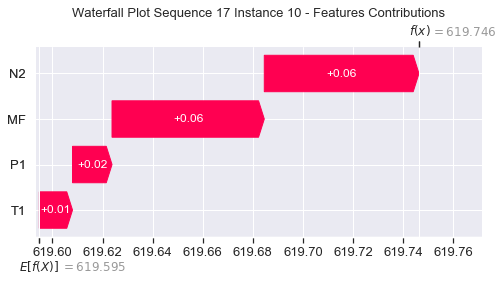

None

Contribution: [0.01655227 0.01329573 0.06340805 0.06185016]


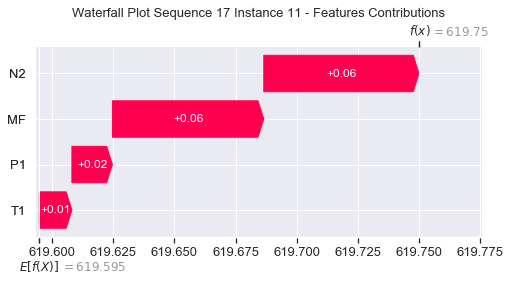

None

Contribution: [0.01777749 0.01398586 0.06692197 0.06489459]


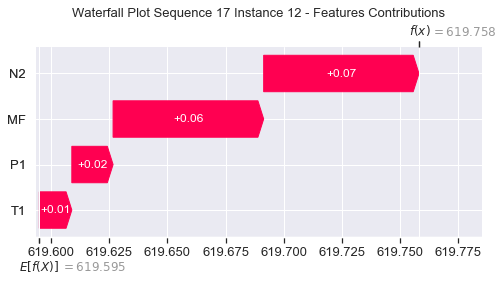

None

Contribution: [0.01968063 0.01577431 0.07274673 0.070372  ]


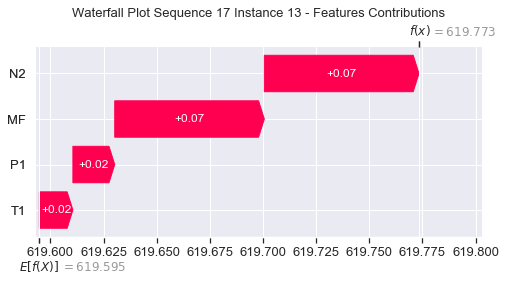

None

Contribution: [0.02174115 0.01710833 0.08065857 0.07756897]


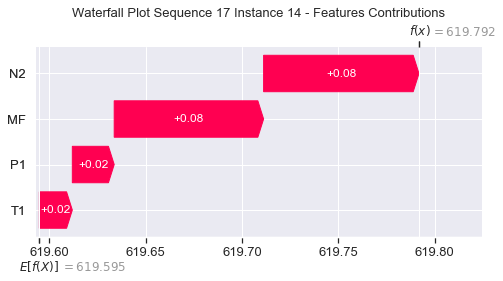

None

Contribution: [0.02559044 0.02100873 0.091325   0.08796097]


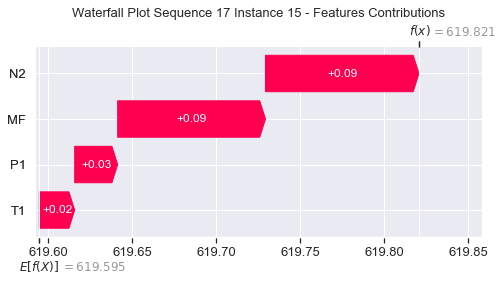

None

Contribution: [0.03056658 0.02559853 0.10515296 0.10200554]


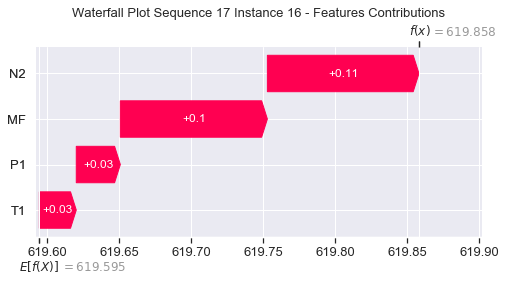

None

Contribution: [0.03547862 0.02975656 0.1224192  0.11787932]


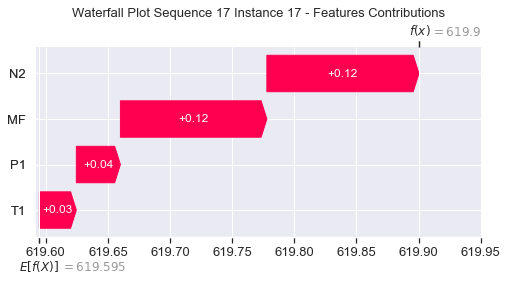

None

Contribution: [0.04254022 0.03612568 0.14474669 0.13935871]


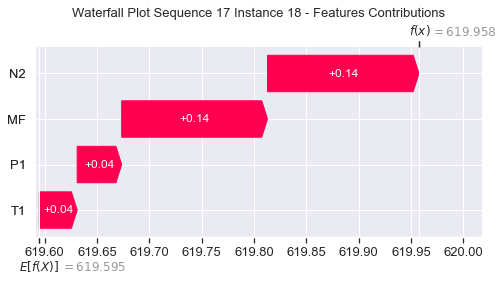

None

Contribution: [0.05242176 0.04704468 0.17427381 0.168079  ]


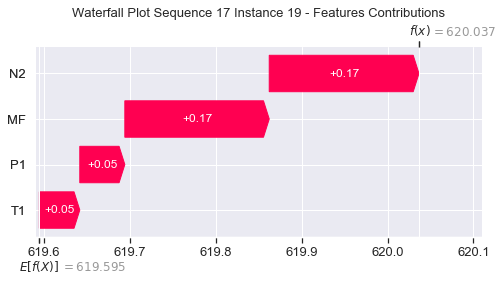

None

Contribution: [0.06399278 0.05494517 0.2114629  0.20445581]


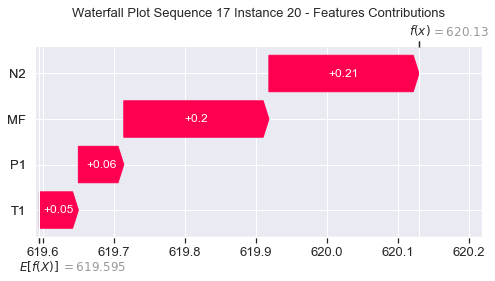

None

Contribution: [0.08041385 0.06794938 0.26303108 0.25493687]


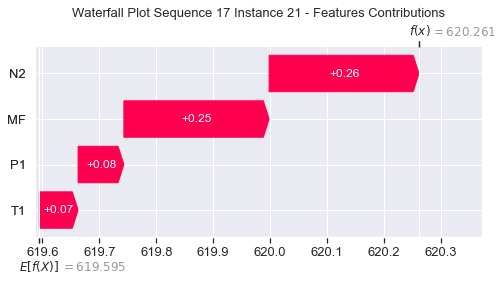

None

Contribution: [0.10473627 0.11463215 0.33545058 0.3227195 ]


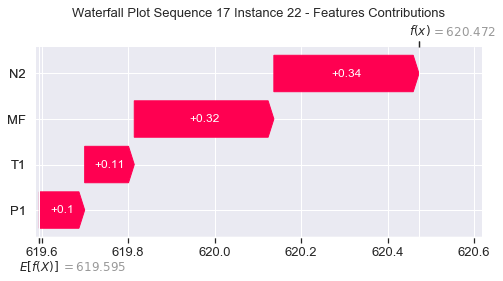

None

Contribution: [0.11950316 0.14561505 0.37042915 0.35616575]


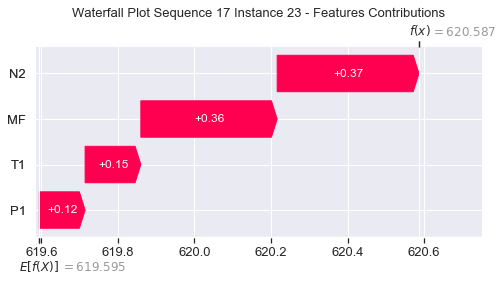

None

Contribution: [ 0.3046065  -0.88774925  1.11435859  1.25882493]


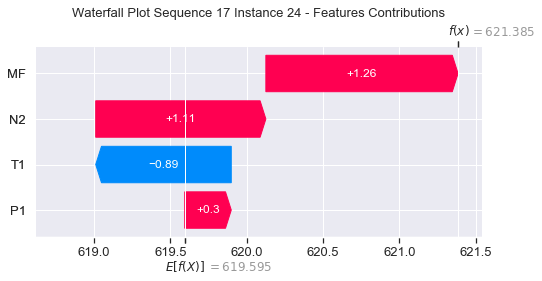

None

Contribution: [0.32507353 0.37955265 1.1783713  1.1538894 ]


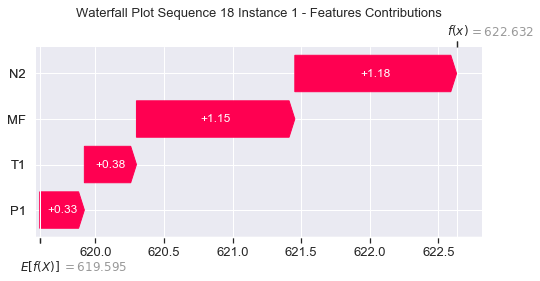

None

Contribution: [0.02658185 0.03516929 0.12537923 0.12572025]


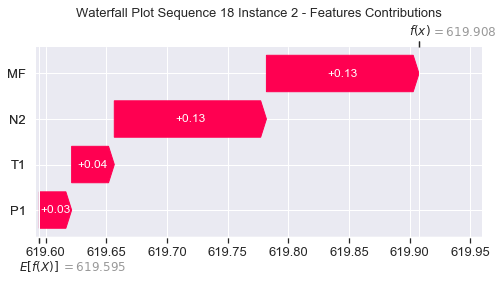

None

Contribution: [0.00277102 0.00410429 0.04630781 0.05514563]


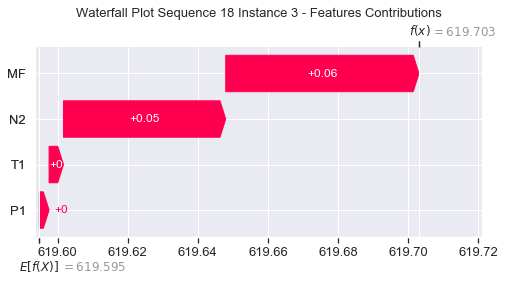

None

Contribution: [0.00553893 0.00531924 0.03166305 0.03276391]


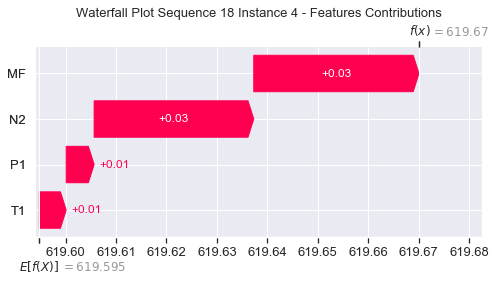

None

Contribution: [0.01133176 0.01011732 0.04933316 0.04997074]


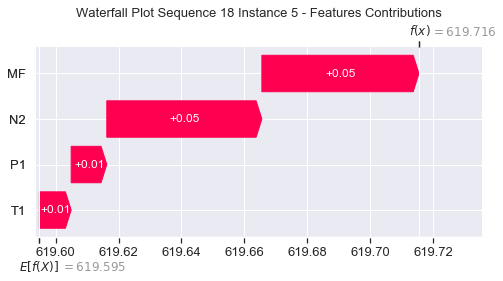

None

Contribution: [0.01334224 0.01132534 0.05466417 0.05539822]


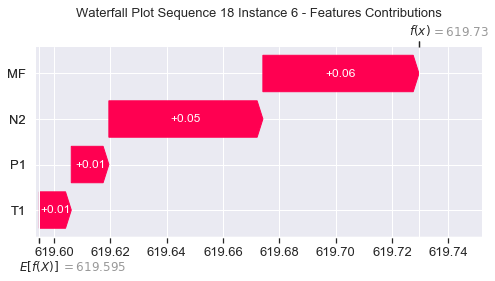

None

Contribution: [0.01456518 0.01199418 0.05758399 0.05814526]


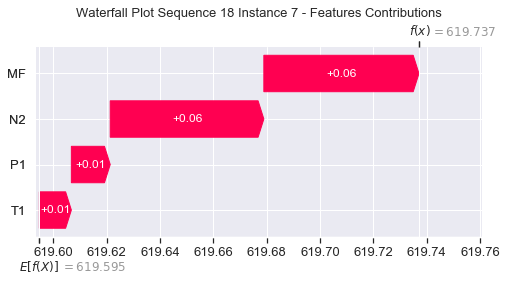

None

Contribution: [0.01523405 0.01241593 0.05926168 0.05944064]


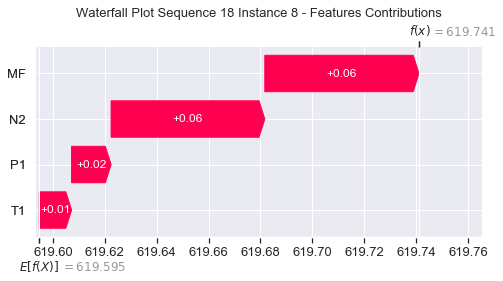

None

Contribution: [0.01556822 0.01337301 0.06012096 0.05985573]


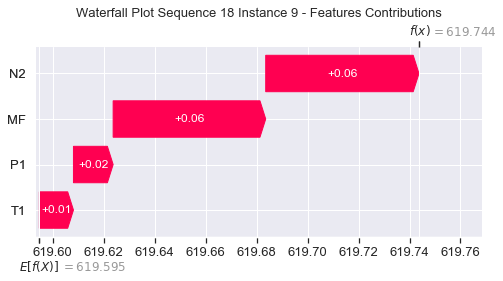

None

Contribution: [0.01628438 0.01351715 0.06117178 0.06076768]


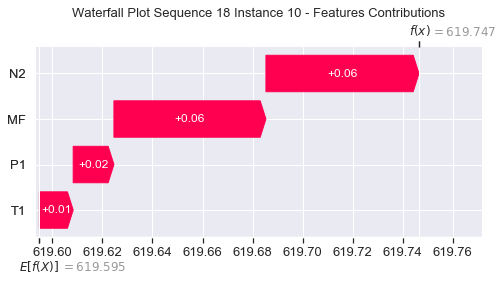

None

Contribution: [0.01671821 0.01453575 0.06319918 0.06265705]


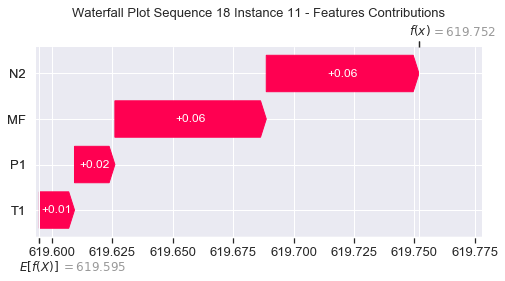

None

Contribution: [0.01848929 0.0154232  0.06680045 0.06660213]


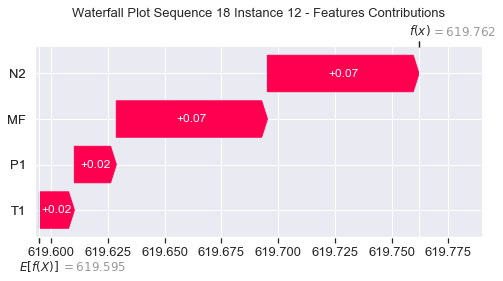

None

Contribution: [0.0204221  0.01730926 0.0726703  0.07201945]


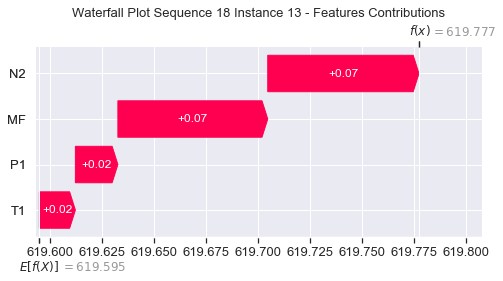

None

Contribution: [0.02242202 0.02072103 0.08049053 0.07839496]


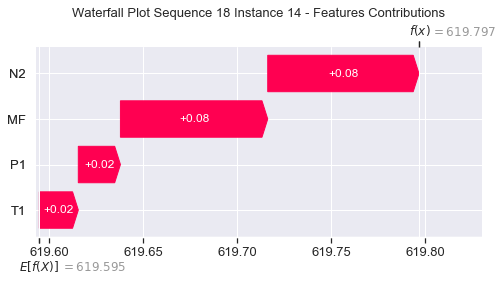

None

Contribution: [0.02635279 0.02279211 0.09132718 0.08977908]


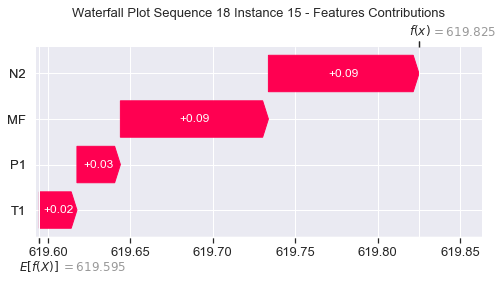

None

Contribution: [0.02998367 0.02784033 0.10458075 0.10128901]


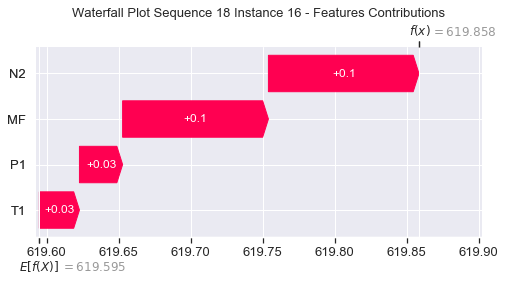

None

Contribution: [0.03663417 0.03226825 0.12247643 0.12018363]


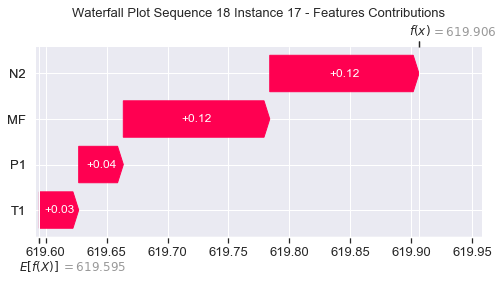

None

Contribution: [0.04380643 0.03883239 0.14474187 0.14185224]


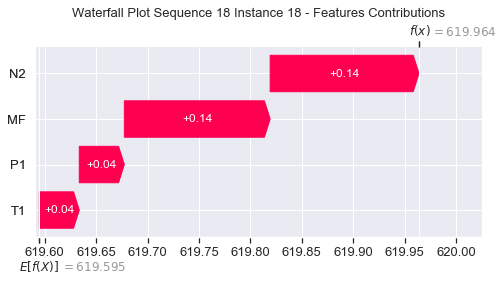

None

Contribution: [0.05331399 0.04719995 0.17418614 0.17138054]


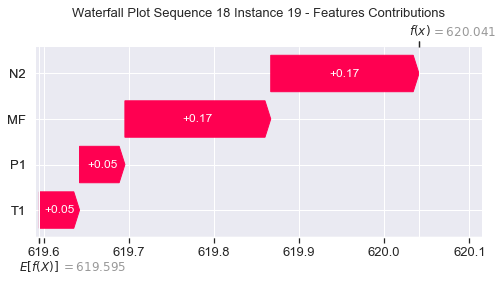

None

Contribution: [0.06509066 0.05778671 0.21135346 0.20610617]


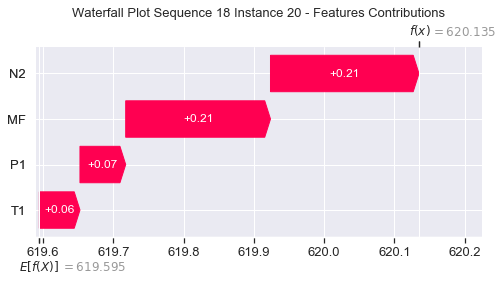

None

Contribution: [0.08181067 0.071756   0.26282229 0.25682643]


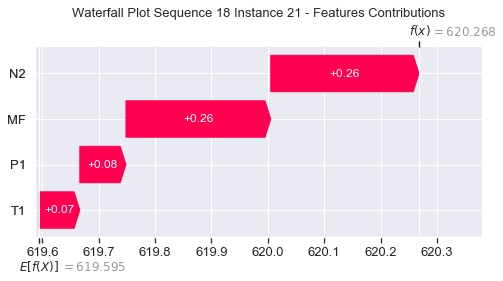

None

Contribution: [0.1052388  0.11607157 0.33491088 0.32294131]


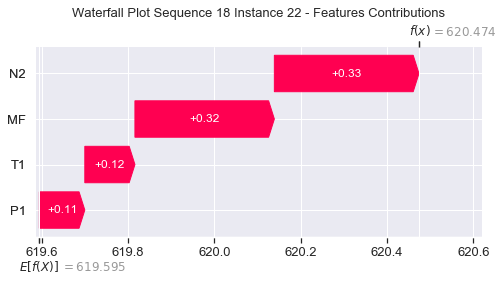

None

Contribution: [0.11995176 0.14632036 0.36971972 0.35589249]


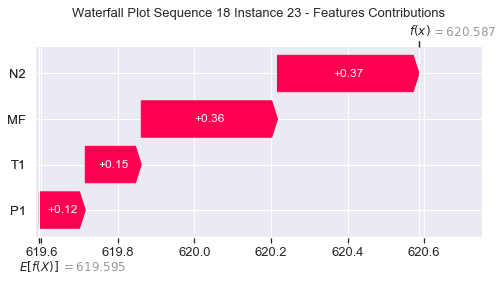

None

Contribution: [ 0.32266797 -0.80101077  1.10821799  1.25155975]


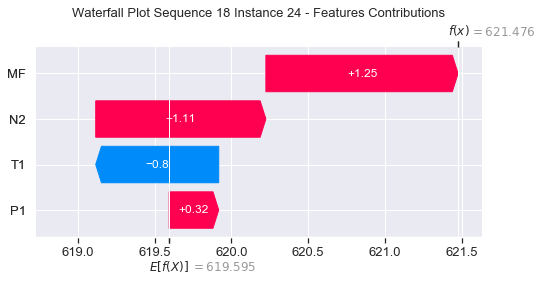

None

Contribution: [0.33075664 0.41466647 1.17946583 1.13890822]


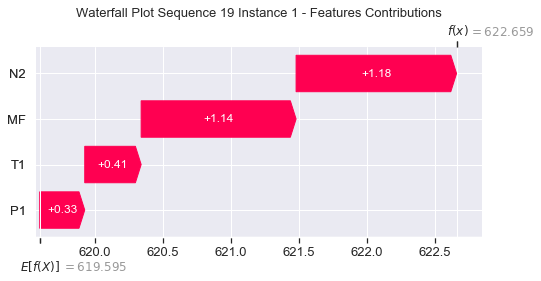

None

Contribution: [0.02810625 0.04026543 0.12539536 0.12726889]


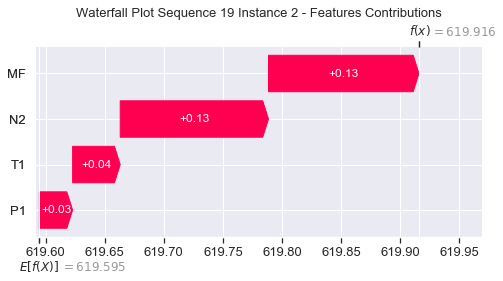

None

Contribution: [0.0021893  0.00452134 0.04590045 0.05410337]


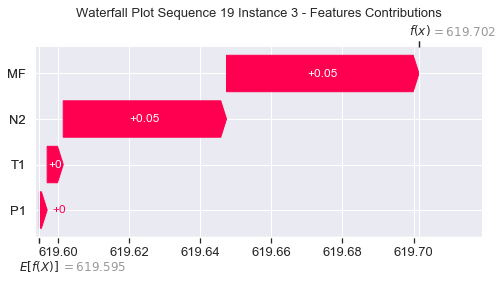

None

Contribution: [0.00570629 0.00573911 0.03197932 0.03321214]


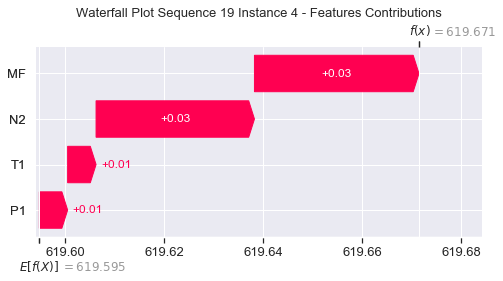

None

Contribution: [0.01152029 0.01035872 0.04969324 0.05039027]


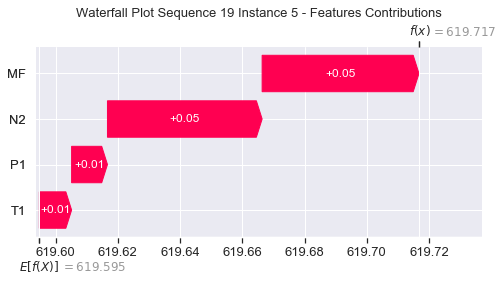

None

Contribution: [0.01336176 0.0112129  0.05491017 0.05489084]


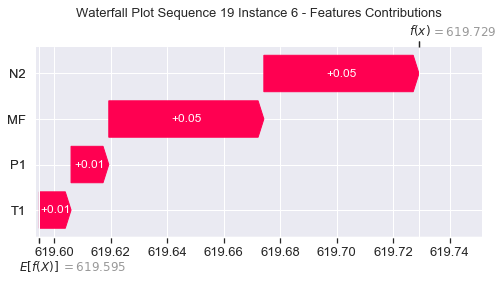

None

Contribution: [0.01454686 0.01190946 0.05777067 0.05752976]


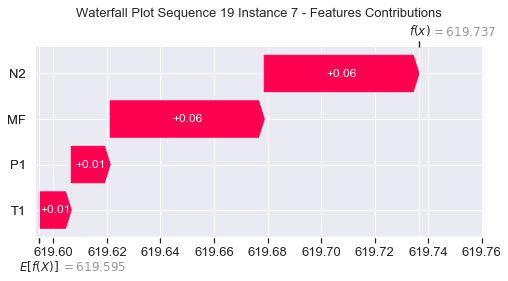

None

Contribution: [0.01524232 0.01223857 0.05944552 0.05899989]


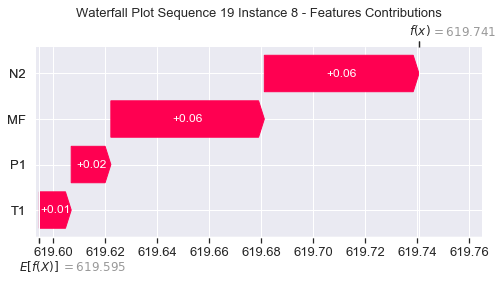

None

Contribution: [0.01565979 0.01300234 0.06044206 0.06005191]


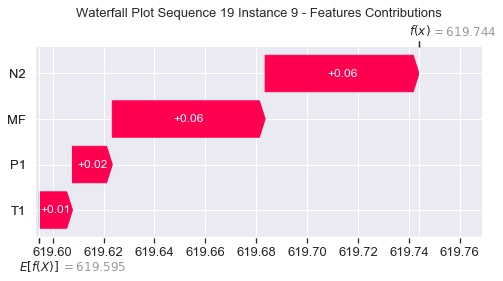

None

Contribution: [0.01617812 0.01352437 0.06144219 0.06063135]


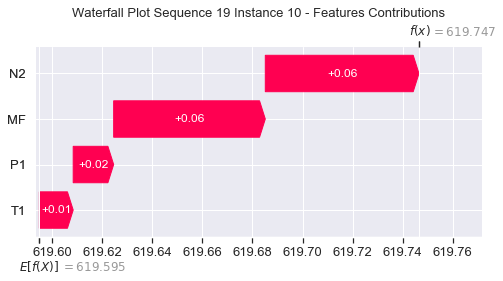

None

Contribution: [0.0165931  0.01343152 0.0633754  0.06203366]


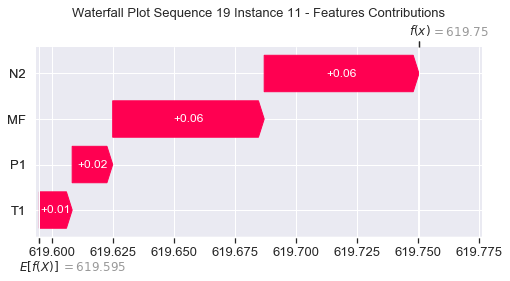

None

Contribution: [0.01803719 0.01449933 0.06670434 0.06493882]


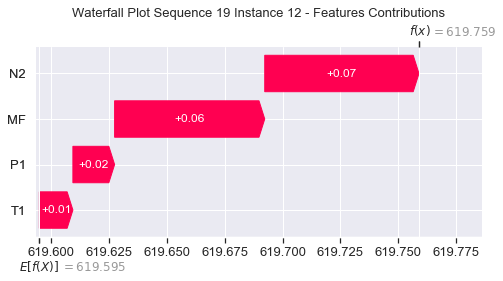

None

Contribution: [0.02002423 0.01650073 0.07252668 0.07055755]


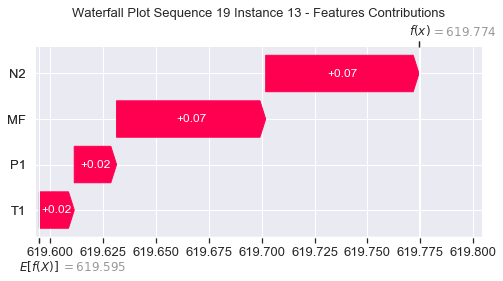

None

Contribution: [0.02283454 0.01923518 0.08080163 0.079598  ]


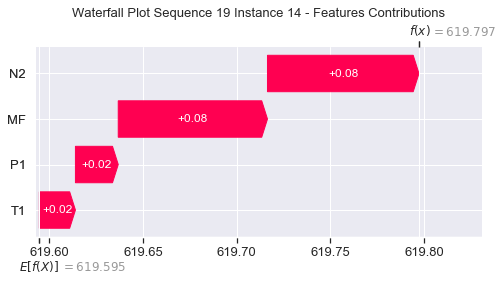

None

Contribution: [0.02609658 0.02180783 0.0910957  0.08836273]


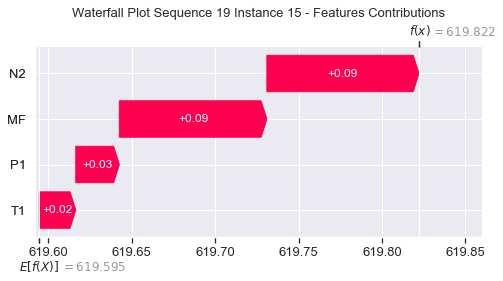

None

Contribution: [0.03026984 0.02684453 0.10469884 0.10203993]


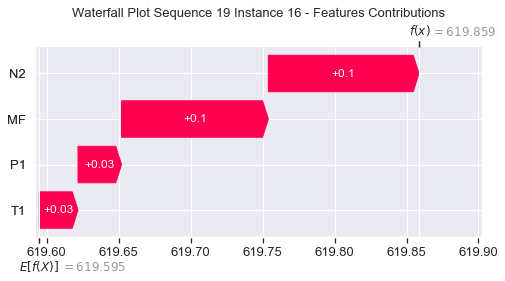

None

Contribution: [0.03637446 0.03122433 0.12209645 0.11862776]


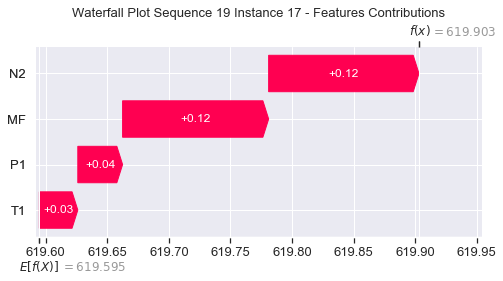

None

Contribution: [0.04361171 0.03759537 0.14428787 0.14027593]


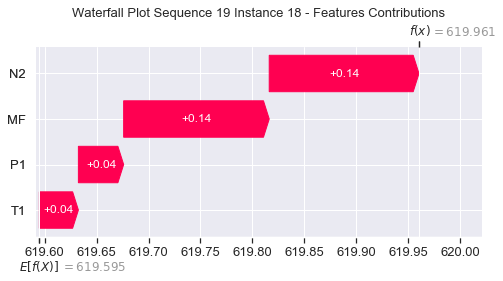

None

Contribution: [0.05231213 0.04633683 0.17353632 0.16763431]


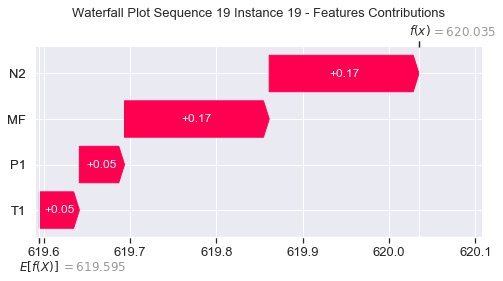

None

Contribution: [0.06581624 0.0573901  0.21074233 0.20657885]


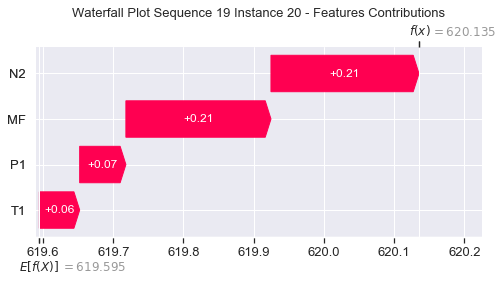

None

Contribution: [0.08273798 0.07085664 0.2619131  0.25770188]


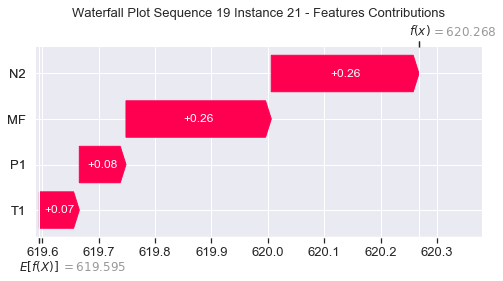

None

Contribution: [0.10598449 0.11553647 0.33450654 0.32373803]


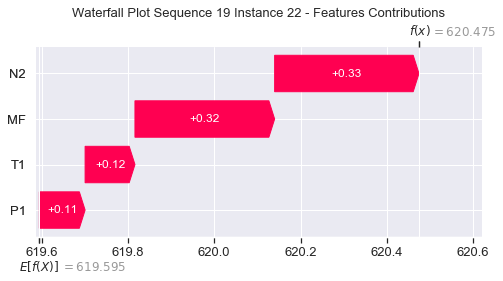

None

Contribution: [0.12035128 0.14591851 0.36970204 0.35607869]


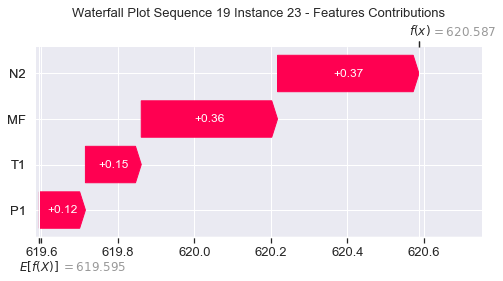

None

Contribution: [ 0.3245352  -0.87103111  1.05265879  1.23866008]


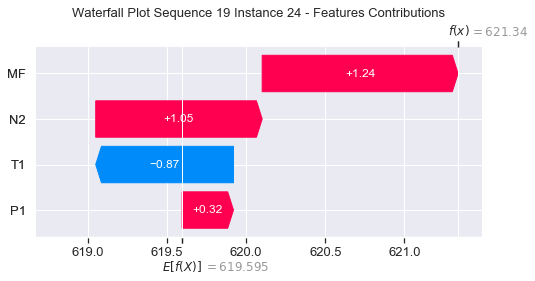

None

Contribution: [0.3045381  0.37742993 1.17654134 1.09726056]


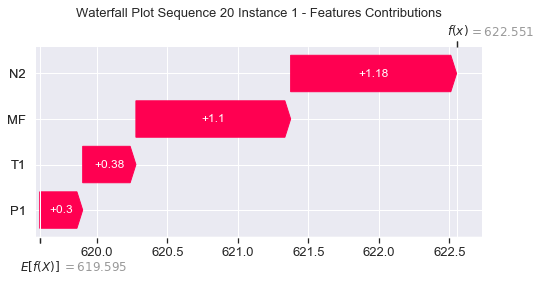

None

Contribution: [0.02953091 0.03776874 0.12700286 0.13273314]


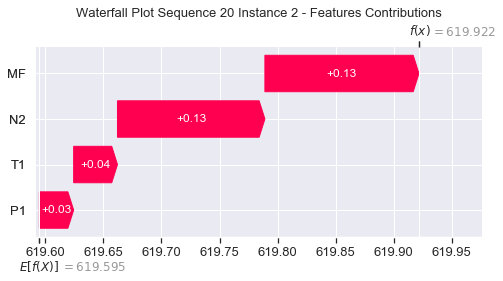

None

Contribution: [0.00325784 0.00473217 0.04742078 0.05603375]


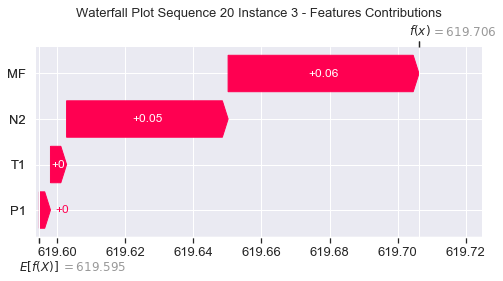

None

Contribution: [0.00538918 0.00573521 0.03109903 0.03178311]


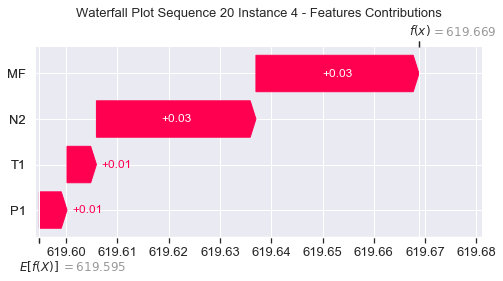

None

Contribution: [0.01145699 0.01076084 0.04908538 0.0497683 ]


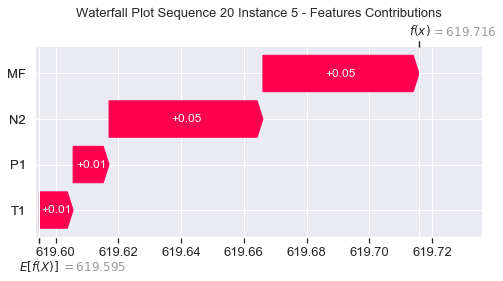

None

Contribution: [0.01321933 0.01149266 0.054341   0.05419367]


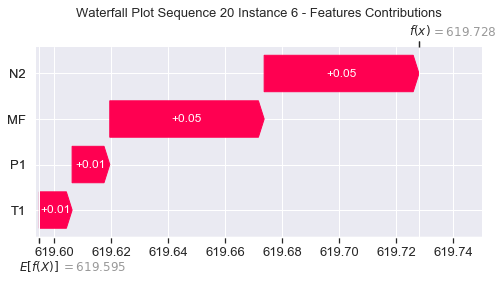

None

Contribution: [0.01440249 0.01216996 0.05725803 0.05695086]


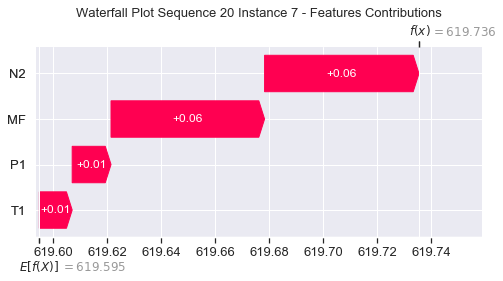

None

Contribution: [0.01511581 0.01251055 0.05893017 0.05839623]


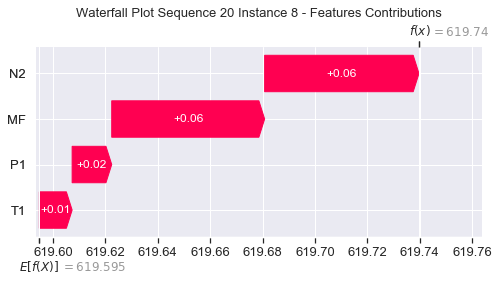

None

Contribution: [0.01534644 0.01278235 0.05993113 0.05937232]


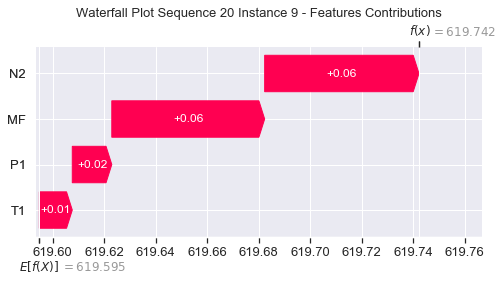

None

Contribution: [0.01626832 0.01197033 0.06085042 0.06063195]


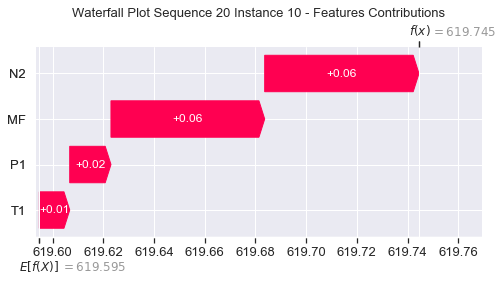

None

Contribution: [0.016299   0.01364271 0.06270639 0.06120244]


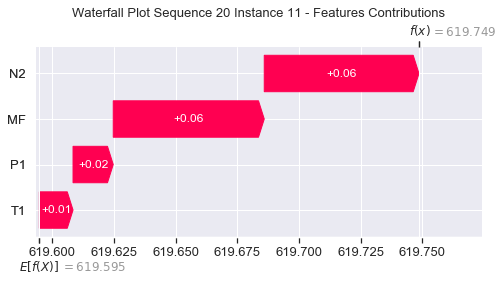

None

Contribution: [0.01804201 0.0155611  0.06628007 0.06506052]


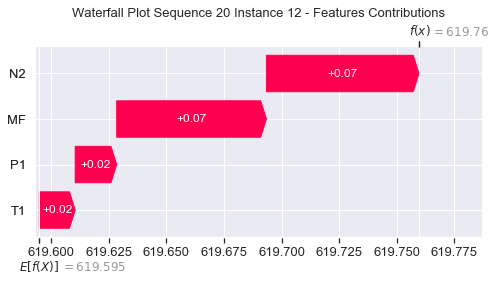

None

Contribution: [0.02005683 0.0175171  0.07218117 0.07076162]


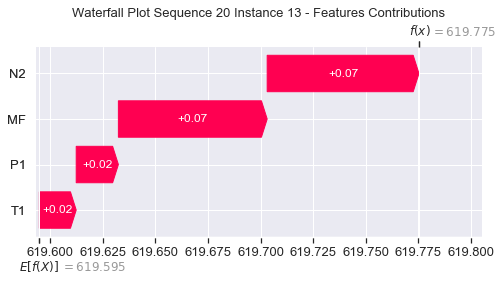

None

Contribution: [0.02257021 0.02044063 0.08019589 0.07851638]


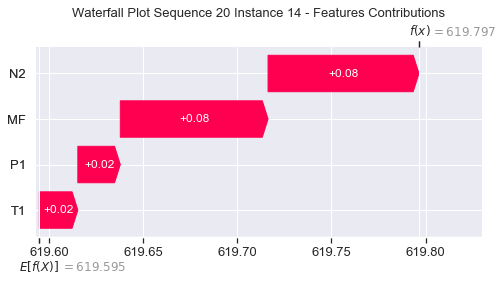

None

Contribution: [0.02605365 0.02293028 0.09080719 0.08859613]


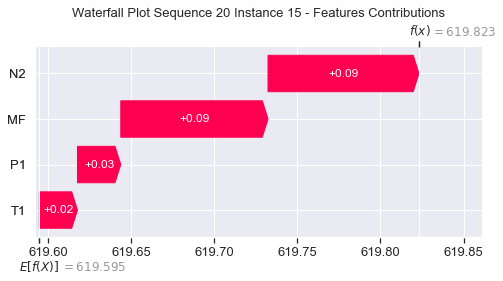

None

Contribution: [0.03031677 0.0259211  0.10460624 0.10251757]


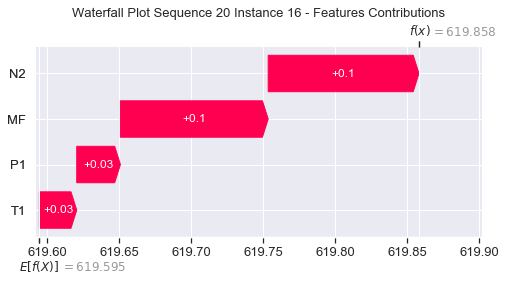

None

Contribution: [0.03630858 0.03224768 0.12196011 0.11915936]


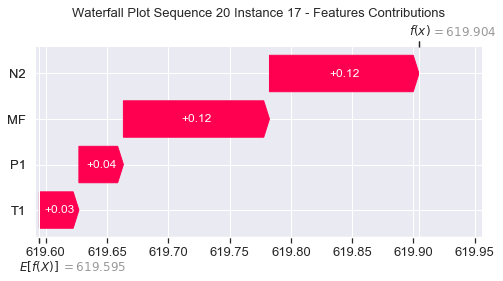

None

Contribution: [0.0435327  0.03865073 0.14416604 0.14082992]


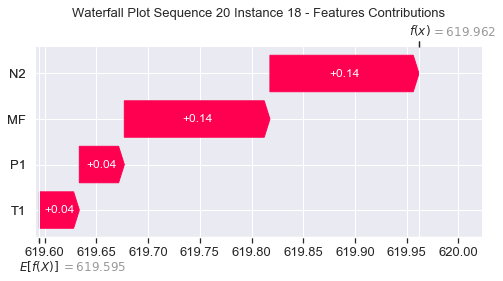

None

Contribution: [0.05345222 0.04756926 0.17376012 0.16969832]


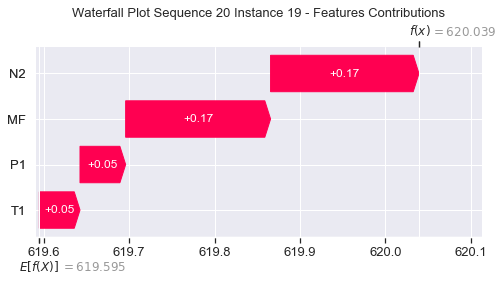

None

Contribution: [0.06579151 0.05810589 0.21087978 0.20747546]


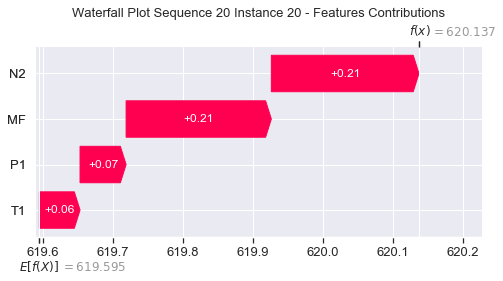

None

Contribution: [0.08290761 0.07262527 0.26215102 0.25934781]


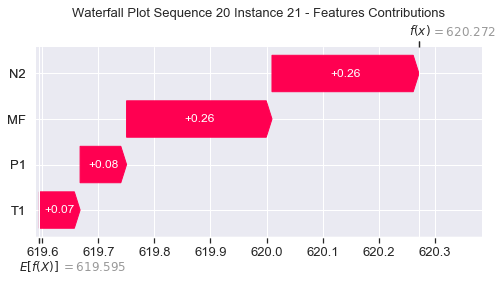

None

Contribution: [0.10614103 0.11670871 0.3343177  0.32442663]


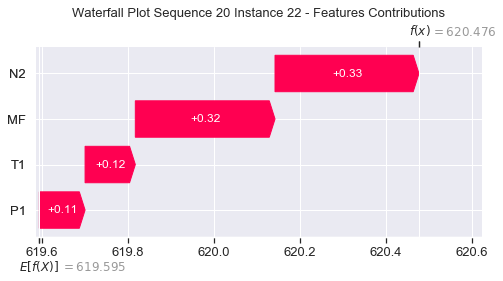

None

Contribution: [0.12042846 0.14600207 0.36958261 0.35641038]


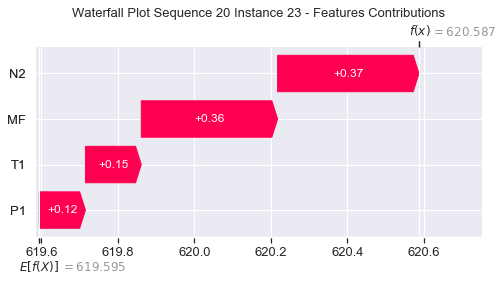

None

Contribution: [ 0.3623658  -0.78129781  1.06597609  1.37483347]


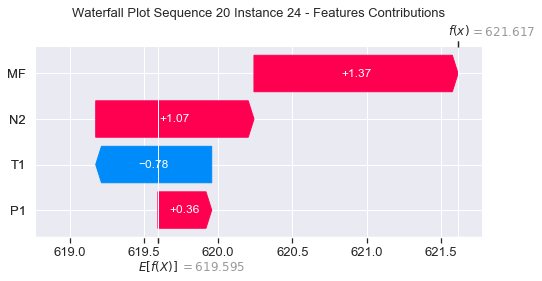

None

Contribution: [0.32060998 0.41046813 1.16179246 1.14774027]


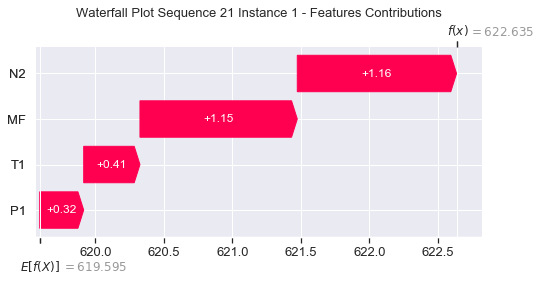

None

Contribution: [0.03025584 0.04373637 0.12506547 0.13482639]


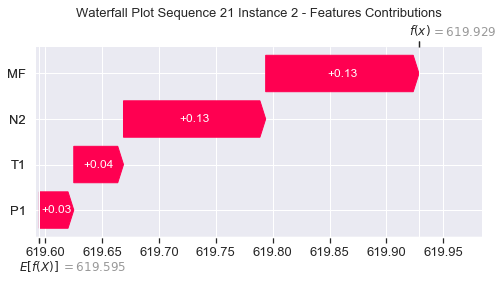

None

Contribution: [0.00290009 0.00650756 0.04583    0.05586416]


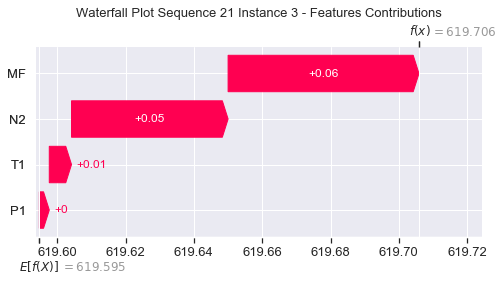

None

Contribution: [0.00580117 0.00665561 0.03177734 0.03306785]


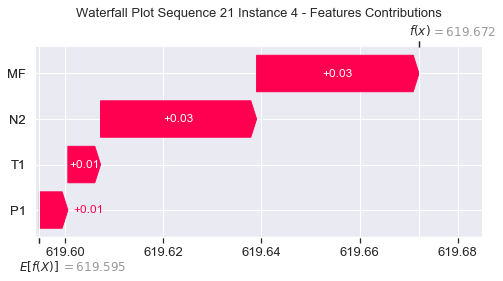

None

Contribution: [0.01151776 0.0107868  0.04932135 0.05030179]


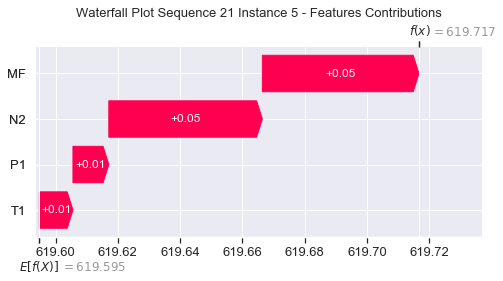

None

Contribution: [0.01356479 0.01201717 0.05462581 0.05542307]


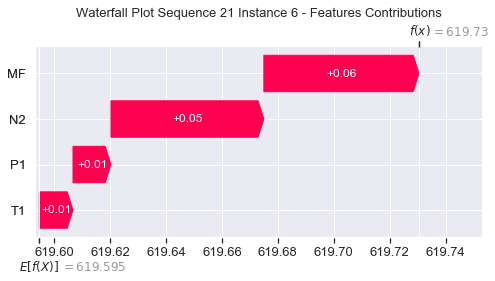

None

Contribution: [0.0147016  0.01260788 0.05756575 0.05811378]


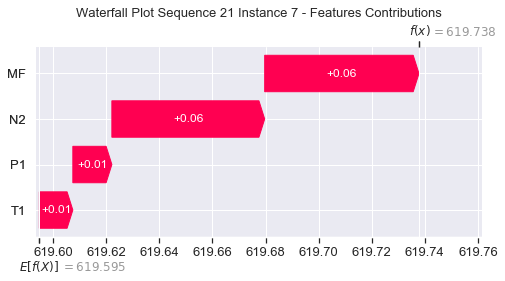

None

Contribution: [0.01546795 0.01289919 0.05929362 0.05959664]


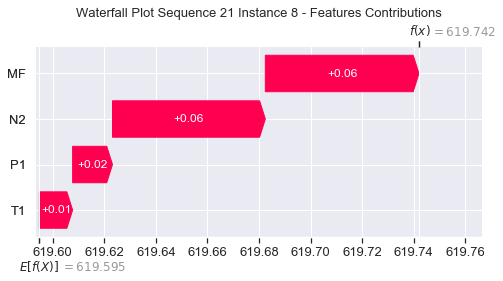

None

Contribution: [0.01587863 0.01305042 0.06022186 0.06045449]


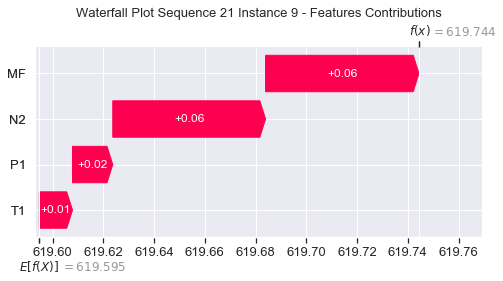

None

Contribution: [0.01549205 0.0135464  0.06123838 0.06056318]


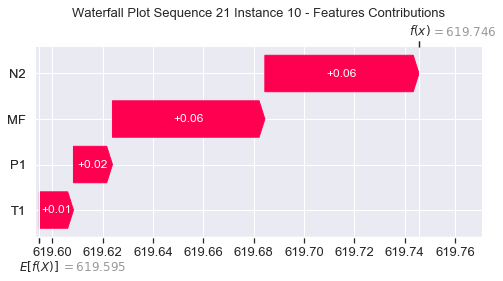

None

Contribution: [0.01720284 0.01405765 0.0633229  0.06314814]


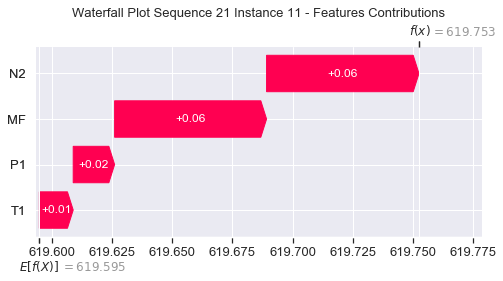

None

Contribution: [0.01809137 0.01481935 0.06676762 0.06596049]


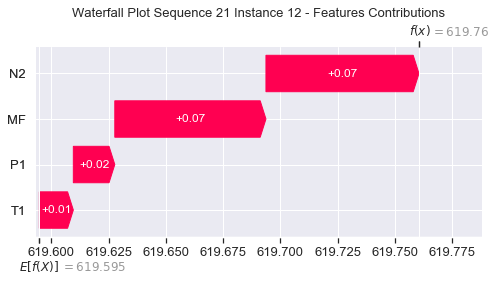

None

Contribution: [0.0200093  0.01665039 0.07260222 0.07144102]


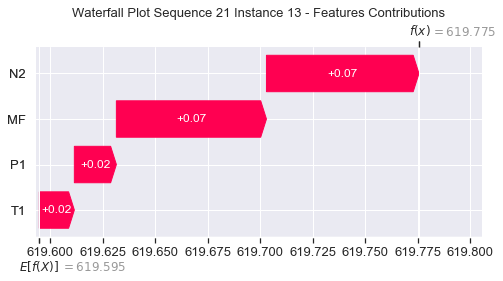

None

Contribution: [0.02318661 0.01910481 0.08077664 0.07946797]


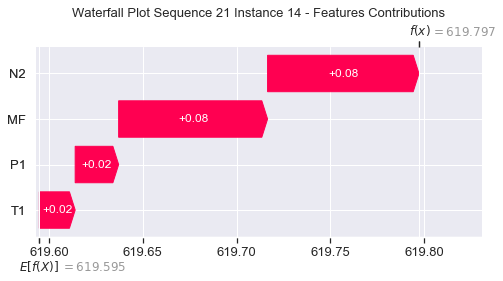

None

Contribution: [0.02623515 0.02193394 0.09130071 0.08955111]


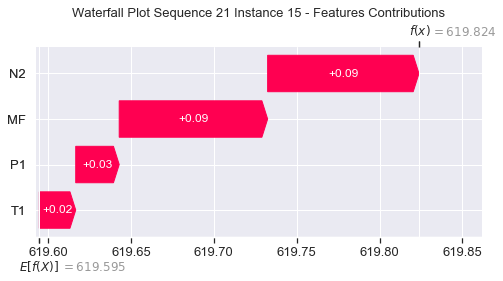

None

Contribution: [0.03062846 0.02641032 0.1049745  0.10390627]


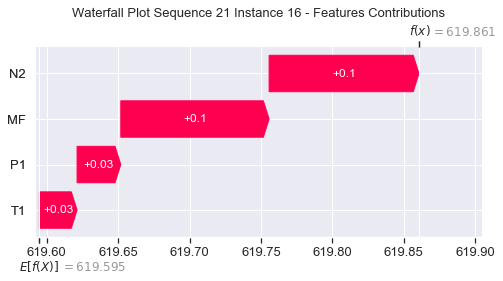

None

Contribution: [0.03642848 0.03074672 0.12245846 0.11989805]


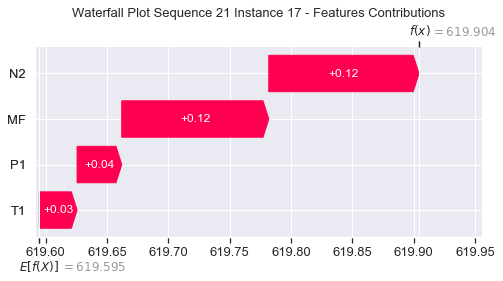

None

Contribution: [0.04383607 0.03697673 0.1448116  0.14177121]


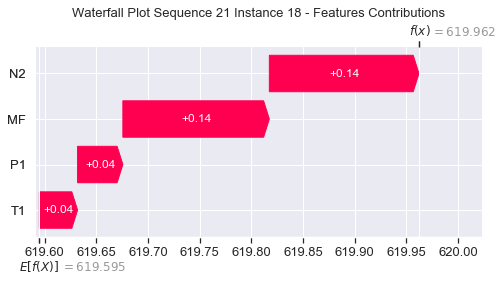

None

Contribution: [0.05384304 0.04451505 0.17439761 0.17254843]


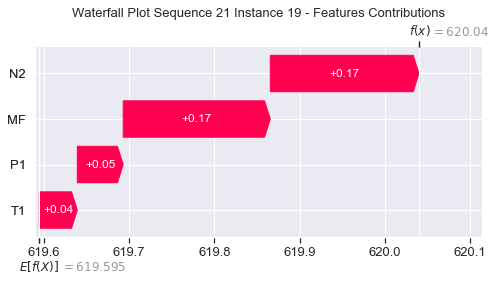

None

Contribution: [0.06585172 0.05507405 0.21150802 0.20737189]


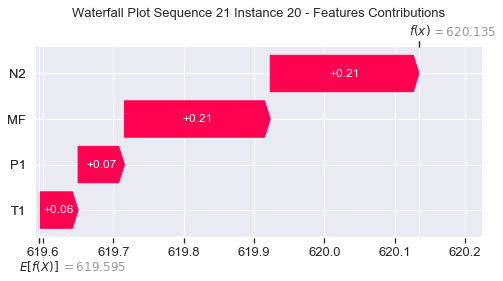

None

Contribution: [0.08257635 0.06729726 0.2630579  0.25845246]


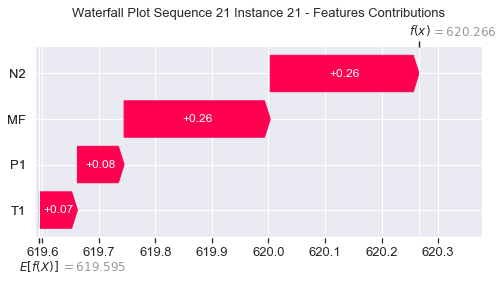

None

Contribution: [0.10591824 0.11354137 0.33515241 0.32410934]


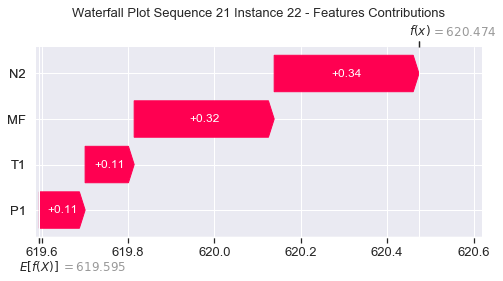

None

Contribution: [0.12051258 0.1449347  0.36987564 0.35630896]


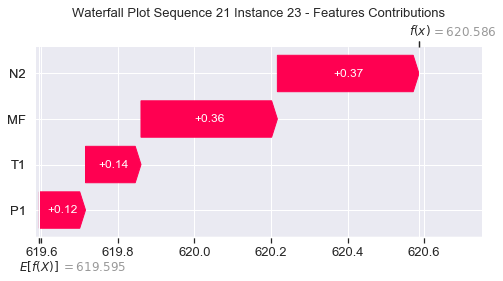

None

Contribution: [ 0.3237691  -1.0069316   1.1061264   1.26182114]


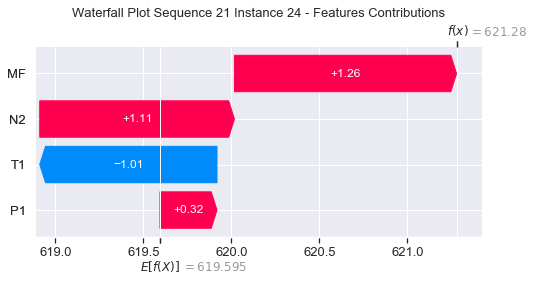

None

Contribution: [0.29264226 0.33503353 1.18827925 1.10166914]


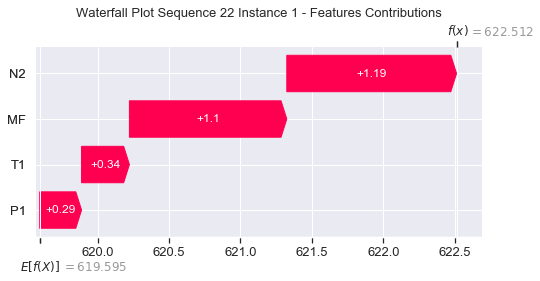

None

Contribution: [0.0277026  0.02855128 0.12858801 0.13193622]


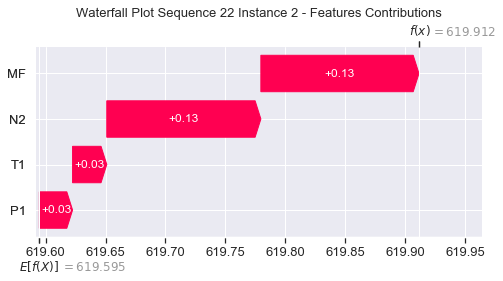

None

Contribution: [0.003508   0.00326974 0.04830194 0.05794273]


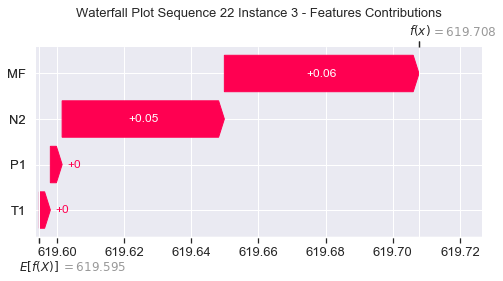

None

Contribution: [0.00553671 0.00482149 0.03114696 0.032556  ]


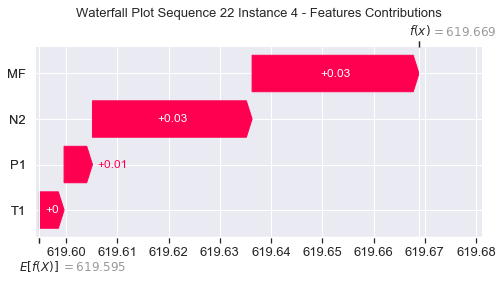

None

Contribution: [0.01133892 0.00885337 0.04889476 0.04996352]


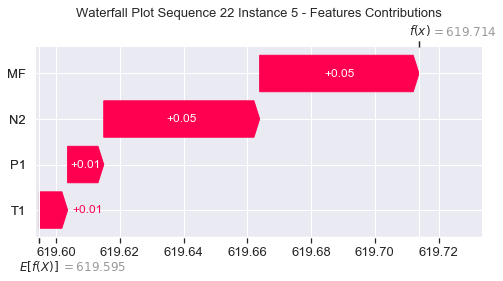

None

Contribution: [0.01319398 0.00998695 0.05397787 0.05499625]


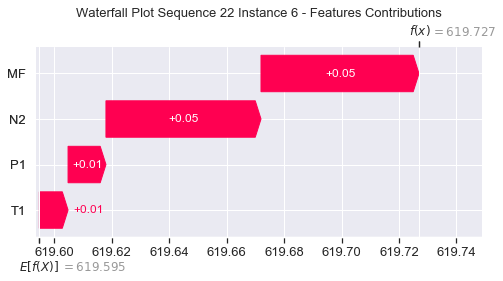

None

Contribution: [0.01442514 0.01054498 0.05688187 0.05792592]


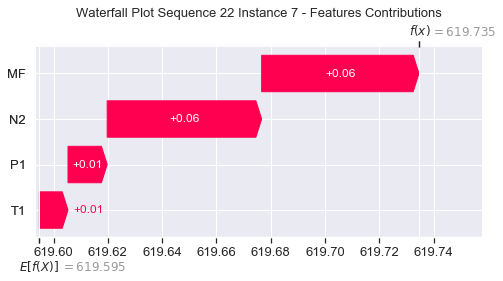

None

Contribution: [0.01511066 0.01110227 0.05856655 0.0591414 ]


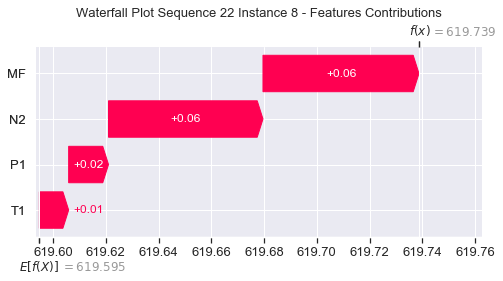

None

Contribution: [0.01541276 0.01163606 0.05933727 0.05955824]


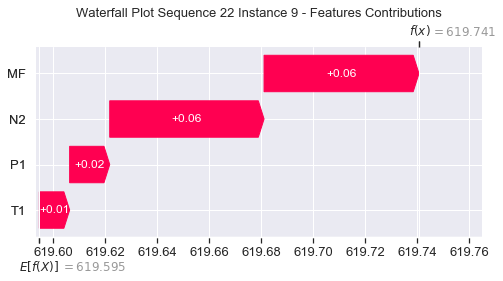

None

Contribution: [0.01602005 0.01280185 0.06050379 0.05985314]


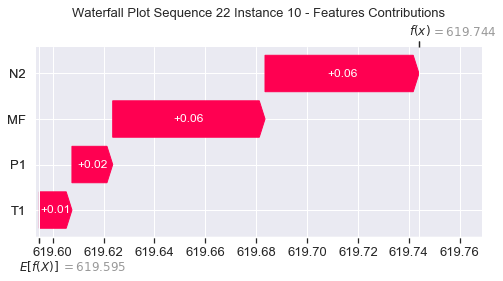

None

Contribution: [0.01626239 0.01347086 0.06225975 0.06117071]


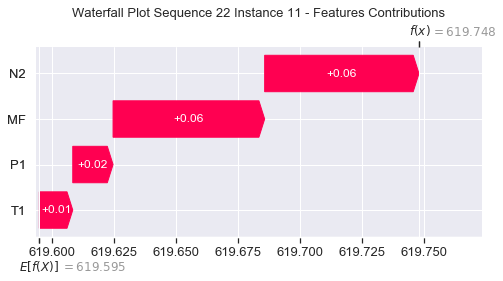

None

Contribution: [0.01786496 0.01453029 0.06598612 0.06577916]


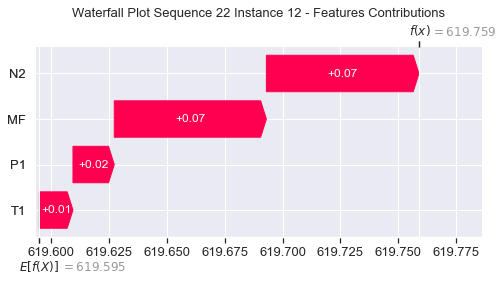

None

Contribution: [0.01989995 0.01633087 0.07187155 0.07153675]


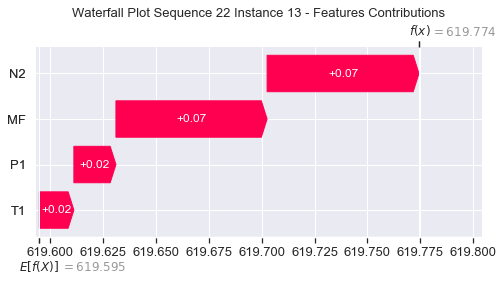

None

Contribution: [0.0224038  0.01910517 0.07997323 0.079754  ]


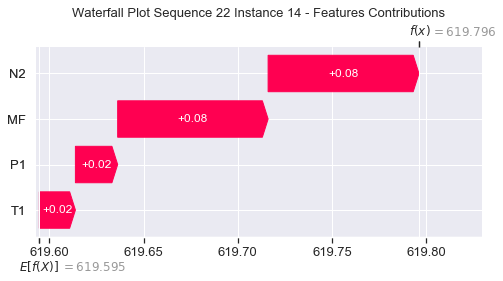

None

Contribution: [0.02600654 0.02178428 0.09053451 0.0898231 ]


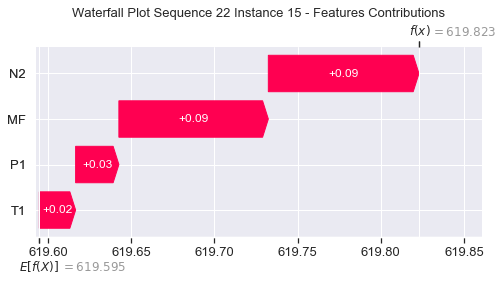

None

Contribution: [0.03064693 0.02597265 0.10443557 0.10364189]


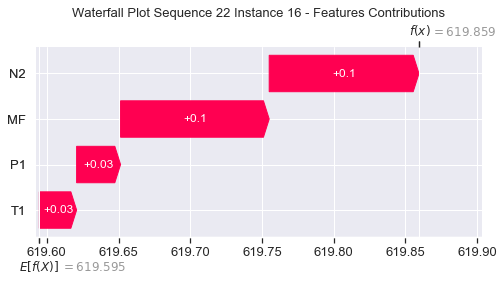

None

Contribution: [0.03643177 0.03152527 0.12167289 0.12107299]


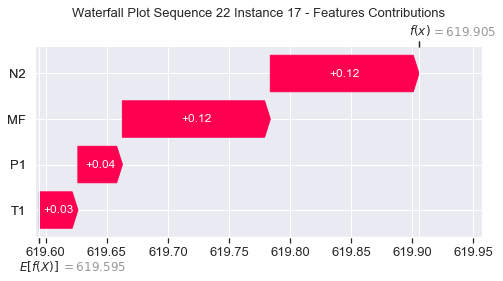

None

Contribution: [0.04374612 0.0385964  0.14397575 0.14312169]


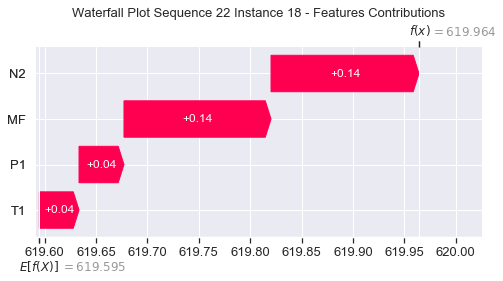

None

Contribution: [0.05232335 0.04691094 0.17350485 0.16986102]


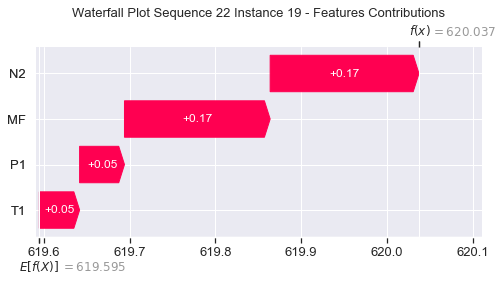

None

Contribution: [0.06628023 0.05831555 0.21080935 0.21024317]


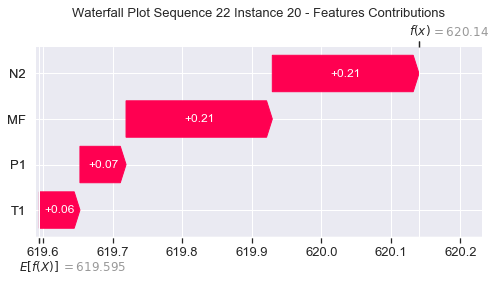

None

Contribution: [0.08320771 0.07317628 0.2621922  0.26204221]


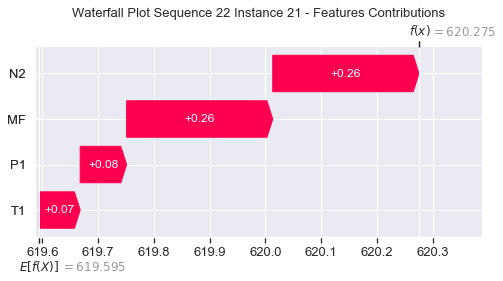

None

Contribution: [0.10605897 0.11710775 0.33427066 0.32503181]


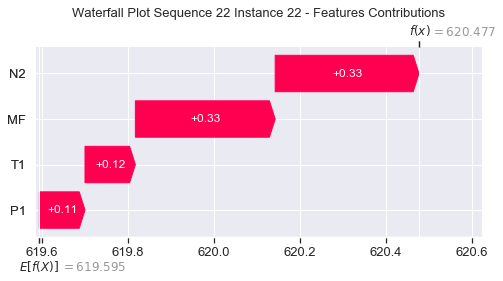

None

Contribution: [0.12039101 0.14670755 0.36922739 0.35650828]


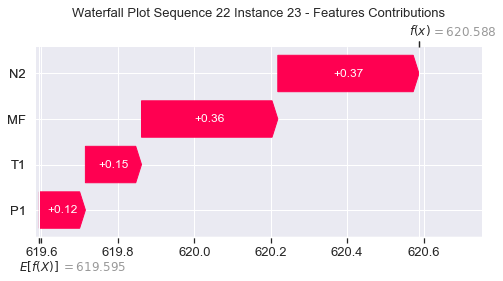

None

Contribution: [ 0.34135259 -0.70639717  1.10784961  1.40226555]


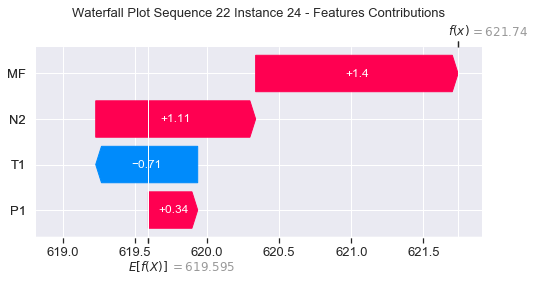

None

Contribution: [0.30189664 0.40140348 1.17855666 1.13224895]


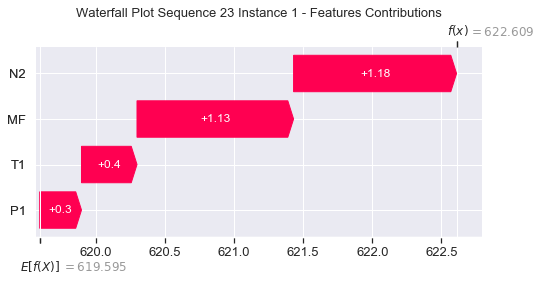

None

Contribution: [0.02921641 0.04640649 0.12708313 0.13442175]


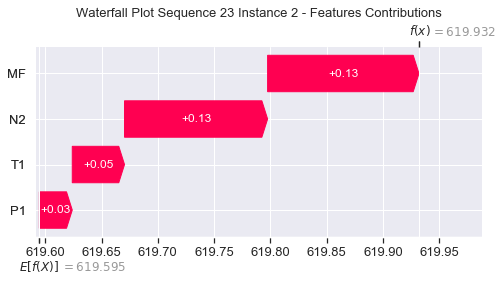

None

Contribution: [0.00246201 0.00302201 0.04652183 0.05621655]


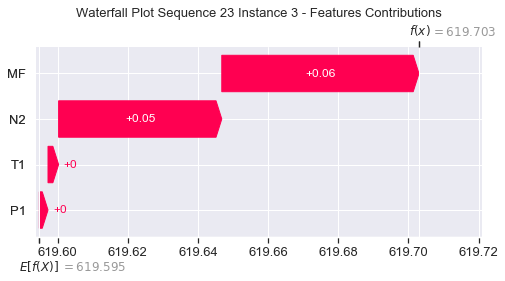

None

Contribution: [0.00541568 0.00519891 0.03150918 0.03257947]


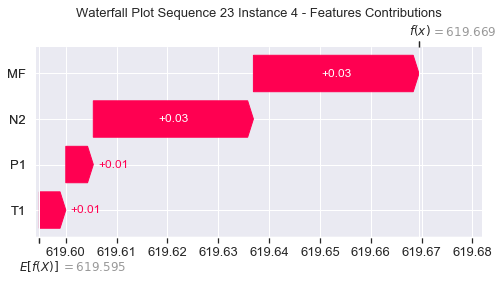

None

Contribution: [0.01145854 0.00984836 0.04938183 0.05030668]


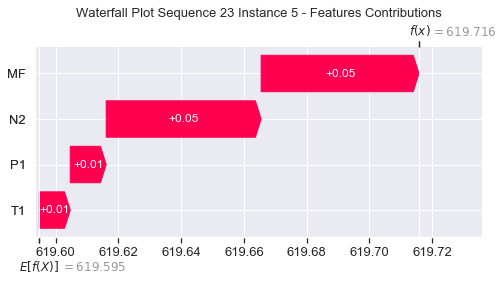

None

Contribution: [0.01347555 0.01108264 0.05468314 0.05519592]


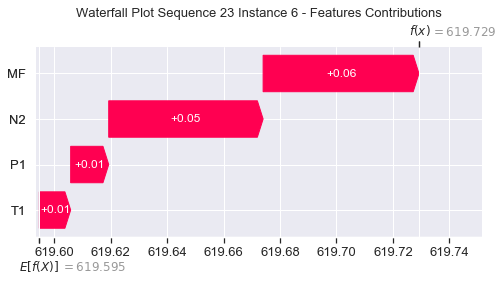

None

Contribution: [0.01466402 0.01175905 0.05758904 0.05789029]


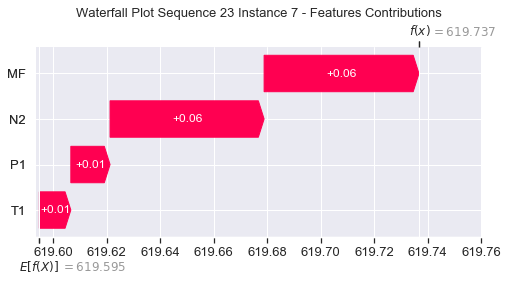

None

Contribution: [0.01536934 0.01211176 0.05927791 0.05923184]


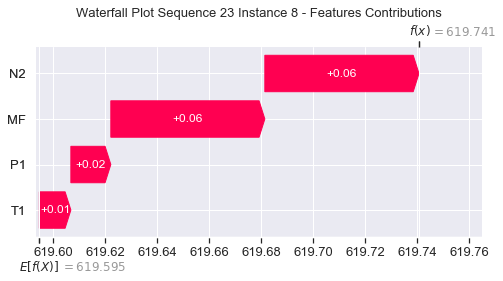

None

Contribution: [0.01581747 0.01273466 0.06025613 0.06008262]


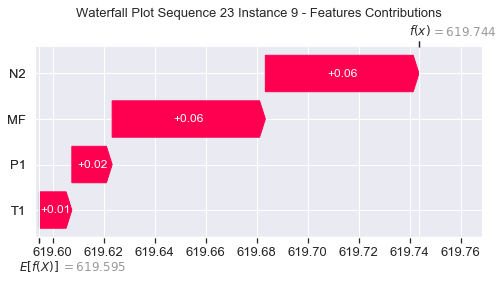

None

Contribution: [0.01643617 0.01328277 0.06132032 0.06085823]


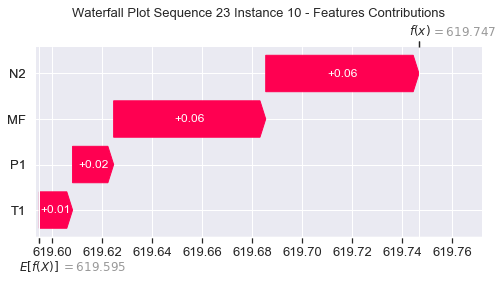

None

Contribution: [0.01689143 0.01374761 0.06323918 0.0618857 ]


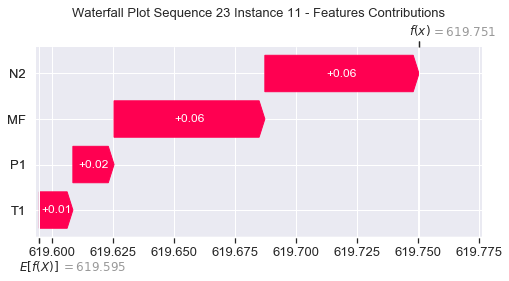

None

Contribution: [0.01822975 0.01492943 0.06669636 0.06515672]


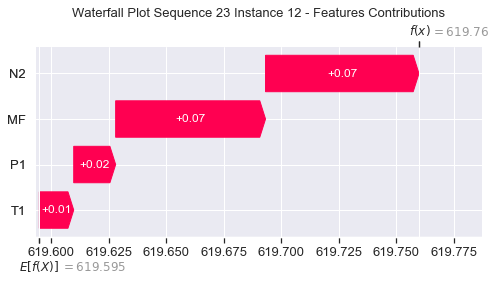

None

Contribution: [0.02019578 0.01682336 0.07254922 0.07078418]


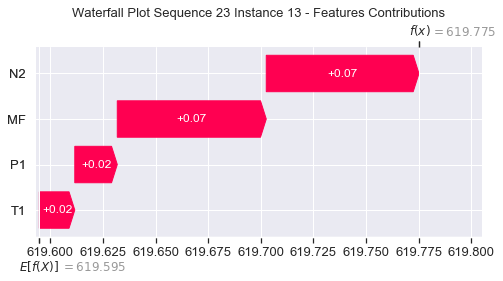

None

Contribution: [0.0228475  0.01964924 0.08071923 0.08022806]


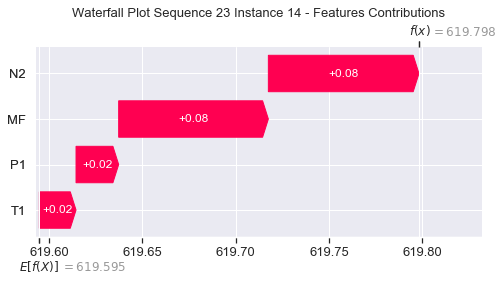

None

Contribution: [0.02628231 0.02235708 0.09123865 0.08865757]


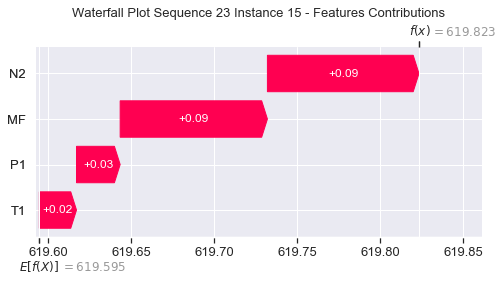

None

Contribution: [0.02993339 0.02618836 0.10476332 0.10171845]


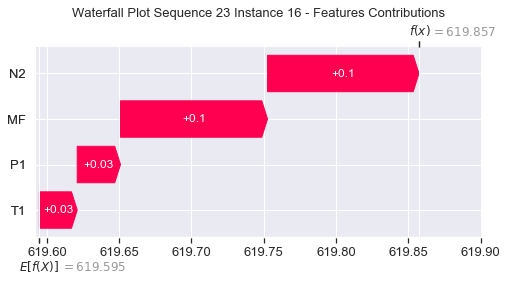

None

Contribution: [0.03662869 0.03190679 0.12241039 0.11904107]


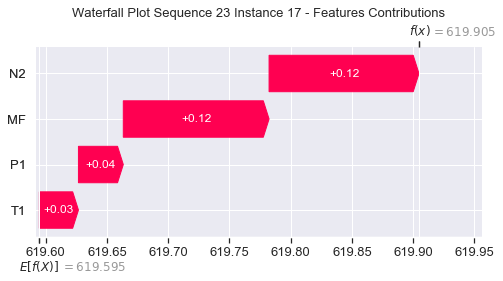

None

Contribution: [0.04393234 0.0385388  0.14469154 0.14062909]


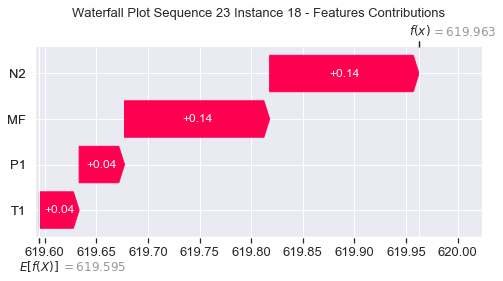

None

Contribution: [0.05344447 0.04633545 0.17382434 0.16669382]


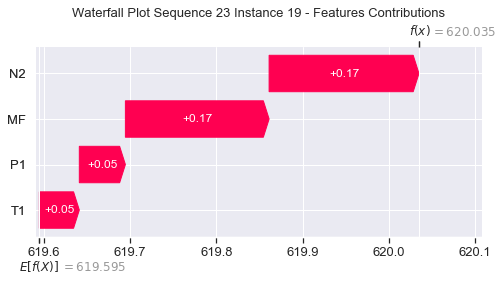

None

Contribution: [0.06590538 0.05785721 0.21148164 0.20639008]


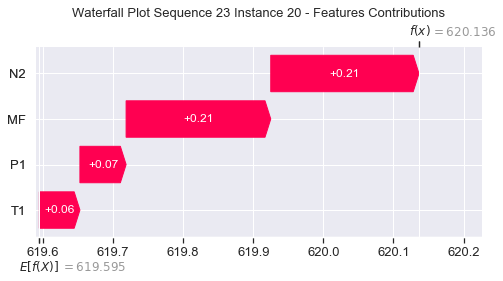

None

Contribution: [0.0826929  0.07167336 0.26290531 0.25701587]


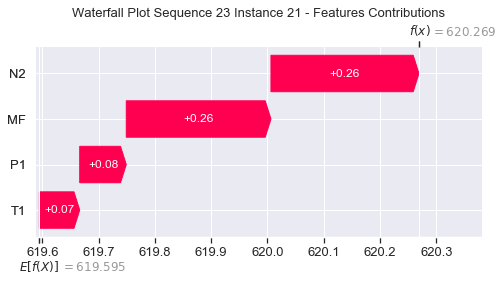

None

Contribution: [0.10582385 0.11599638 0.33493421 0.32301772]


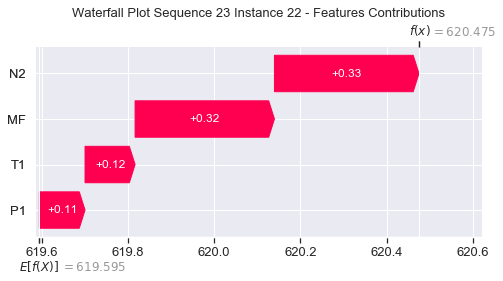

None

Contribution: [0.12035662 0.14623944 0.36973965 0.35576373]


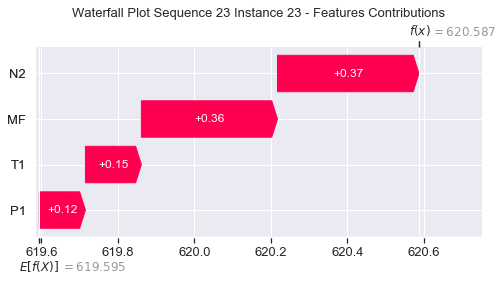

None

Contribution: [ 0.37655807 -0.79851018  1.11764109  1.28021445]


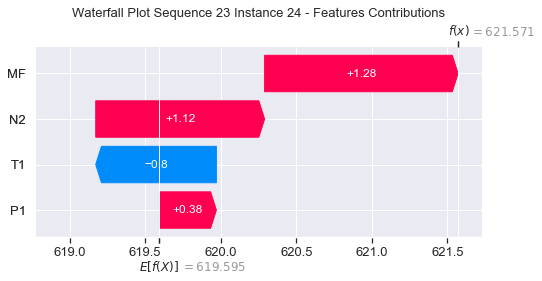

None

Contribution: [0.33402242 0.39880165 1.16653866 1.1238725 ]


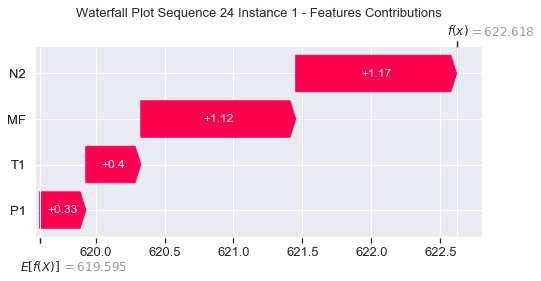

None

Contribution: [0.02773737 0.03871138 0.12400499 0.12482153]


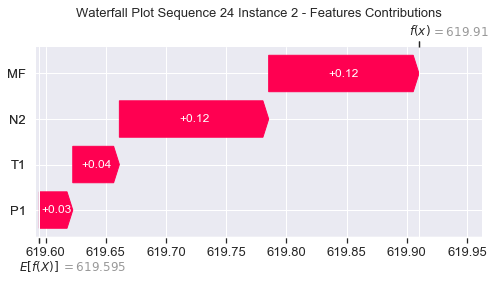

None

Contribution: [0.00276721 0.00426661 0.04567417 0.05471805]


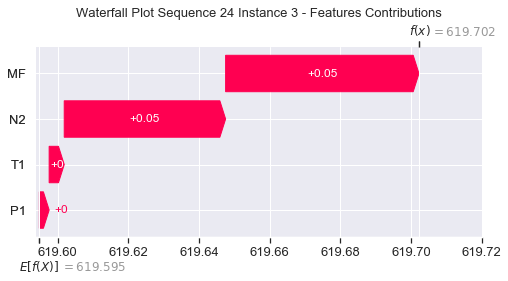

None

Contribution: [0.00591354 0.00543963 0.03186622 0.0332549 ]


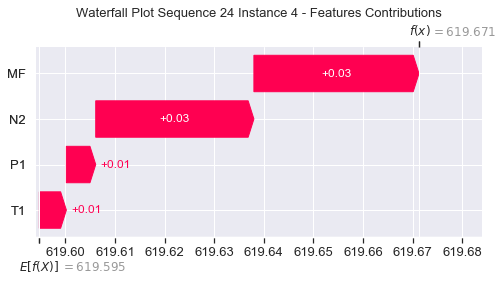

None

Contribution: [0.01161576 0.00961477 0.04938804 0.0497323 ]


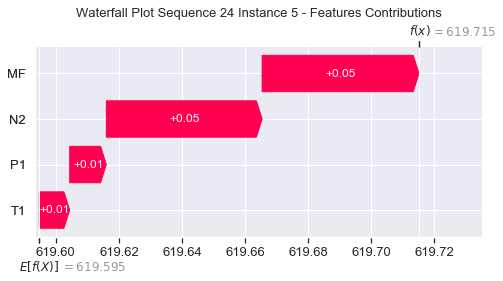

None

Contribution: [0.01350964 0.01057367 0.05465209 0.05479031]


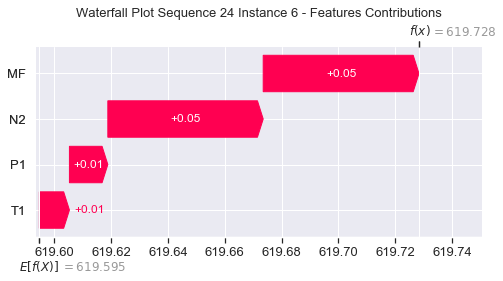

None

Contribution: [0.01470012 0.01122924 0.05756713 0.05756366]


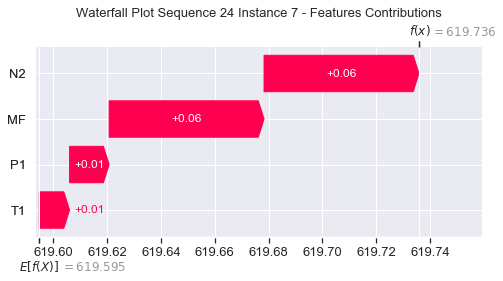

None

Contribution: [0.01539092 0.01168104 0.05921064 0.05882639]


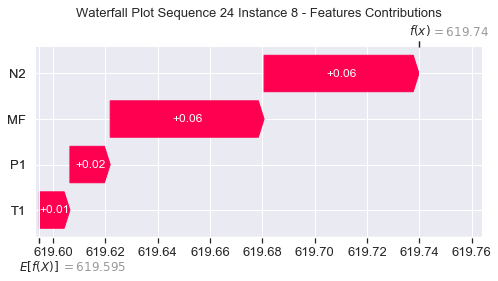

None

Contribution: [0.01560699 0.01221247 0.06007474 0.05890485]


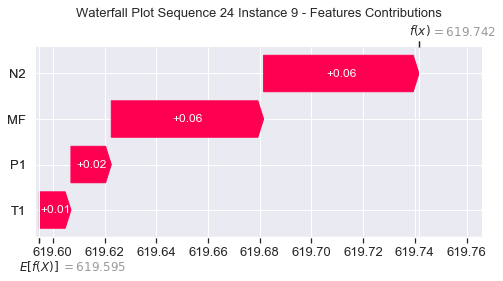

None

Contribution: [0.01623136 0.01218246 0.06114406 0.06091317]


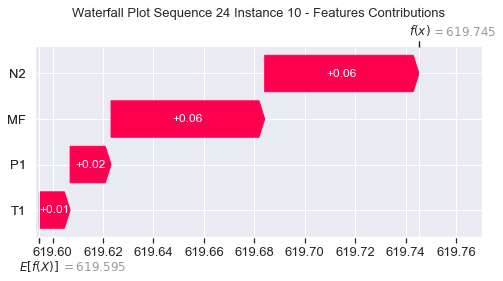

None

Contribution: [0.01672836 0.01301451 0.06301893 0.06128602]


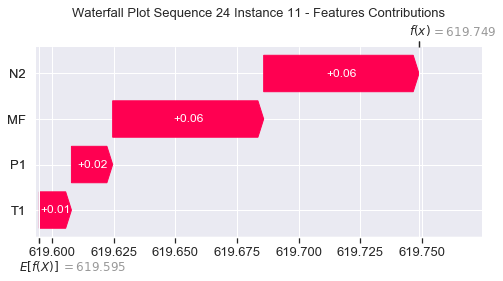

None

Contribution: [0.01837195 0.01404382 0.06660638 0.06565454]


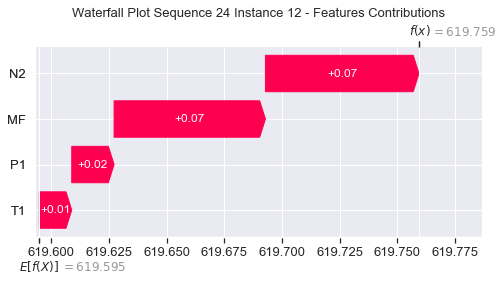

None

Contribution: [0.02034894 0.01612543 0.07247188 0.07120144]


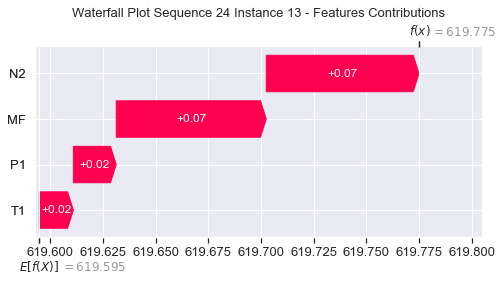

None

Contribution: [0.0226422  0.0182127  0.08033371 0.07775178]


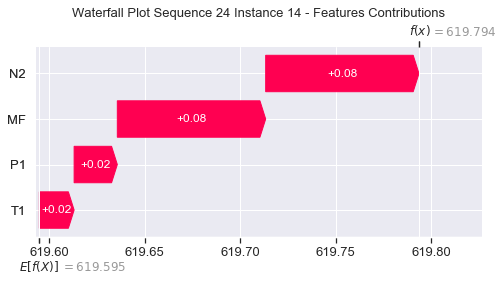

None

Contribution: [0.0264975  0.02202728 0.09114283 0.08934875]


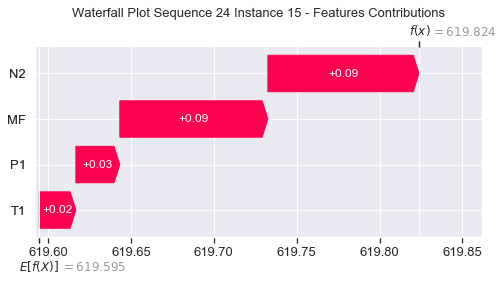

None

Contribution: [0.03005232 0.02458546 0.10443841 0.10154409]


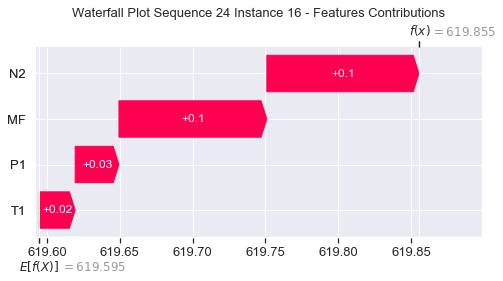

None

Contribution: [0.03679957 0.03225618 0.12228191 0.12000609]


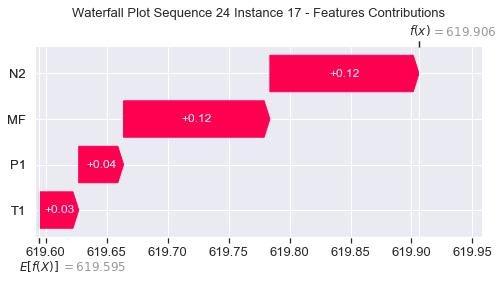

None

Contribution: [0.04410194 0.03955822 0.14450651 0.14188154]


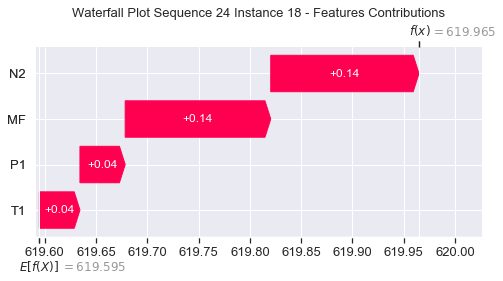

None

Contribution: [0.05325905 0.04950254 0.17459814 0.1705463 ]


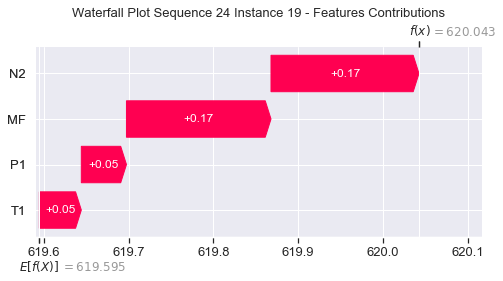

None

Contribution: [0.06619979 0.0620081  0.21106875 0.20783654]


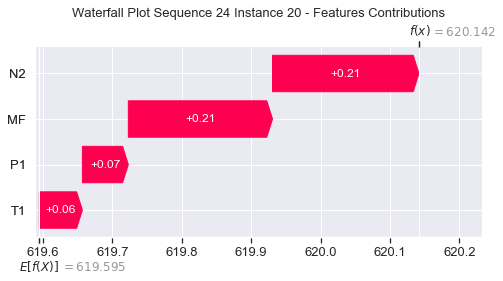

None

Contribution: [0.08333036 0.07728609 0.26241194 0.25931511]


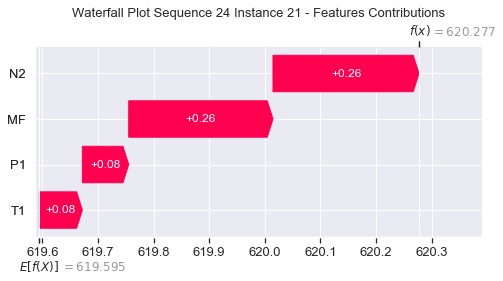

None

Contribution: [0.10625812 0.1190856  0.33398598 0.32382489]


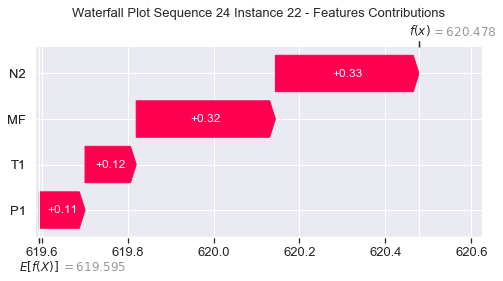

None

Contribution: [0.12037259 0.1477579  0.36833155 0.35517472]


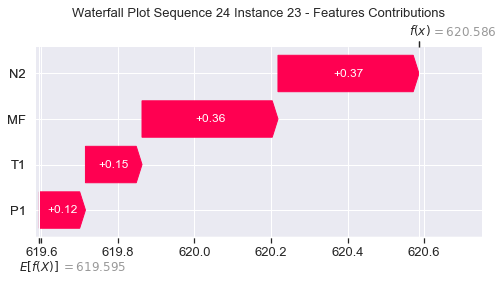

None

Contribution: [ 0.37871692 -0.51385204  1.10835242  1.35200361]


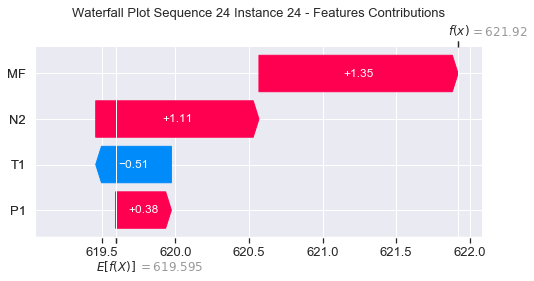

None

Contribution: [0.31690026 0.4459324  1.15550151 1.09783668]


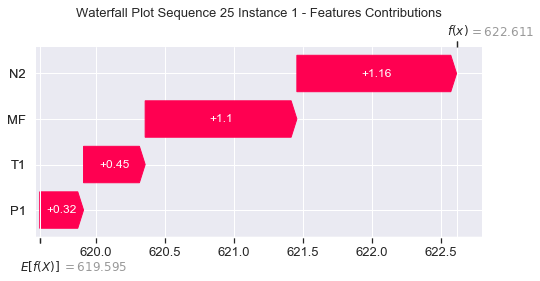

None

Contribution: [0.02984784 0.04755773 0.1244724  0.13136333]


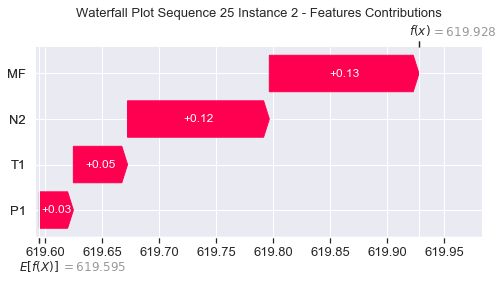

None

Contribution: [0.0029591  0.00511405 0.04556623 0.05562078]


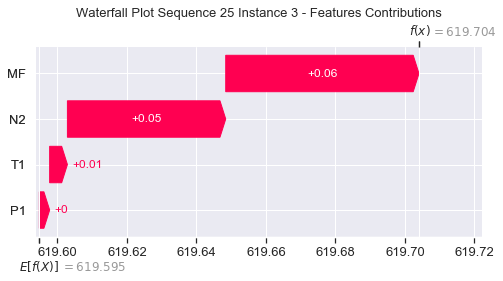

None

Contribution: [0.00564515 0.00563921 0.0317739  0.03273999]


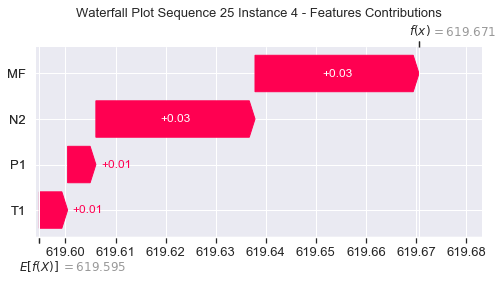

None

Contribution: [0.01142605 0.01068052 0.04923834 0.04914845]


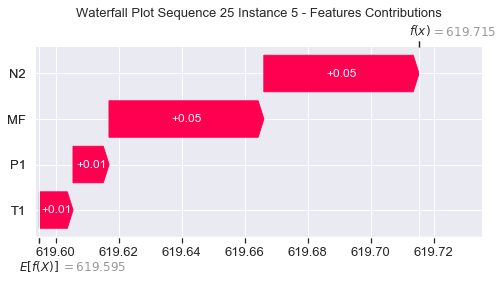

None

Contribution: [0.01328406 0.01152785 0.05455729 0.05419939]


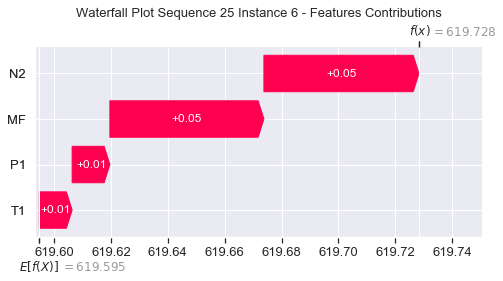

None

Contribution: [0.01440932 0.01205732 0.05742864 0.05691036]


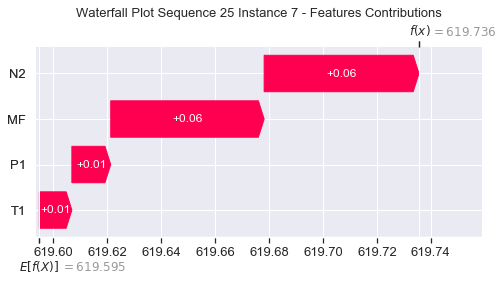

None

Contribution: [0.01516029 0.01267932 0.05910168 0.05838979]


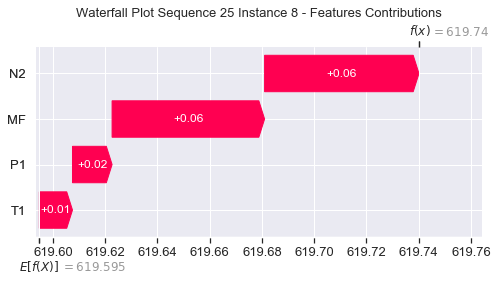

None

Contribution: [0.01574038 0.01323523 0.06010593 0.06025626]


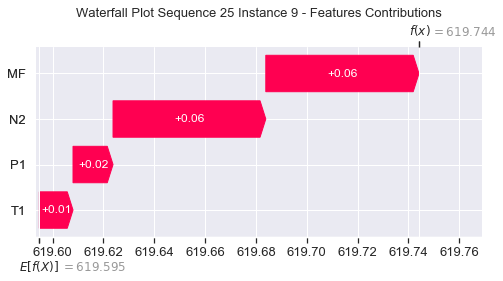

None

Contribution: [0.01542613 0.01283335 0.06104052 0.05910992]


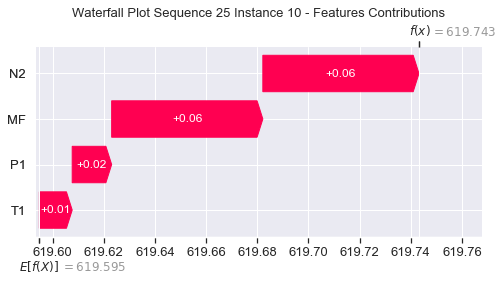

None

Contribution: [0.01694901 0.01484685 0.06312815 0.06257373]


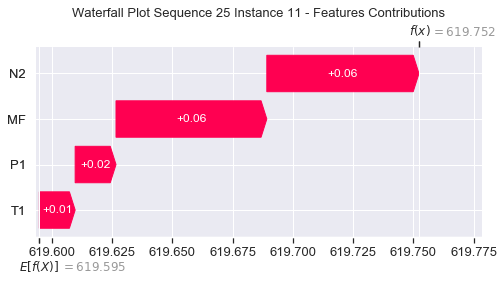

None

Contribution: [0.01805908 0.01539687 0.06656467 0.06504562]


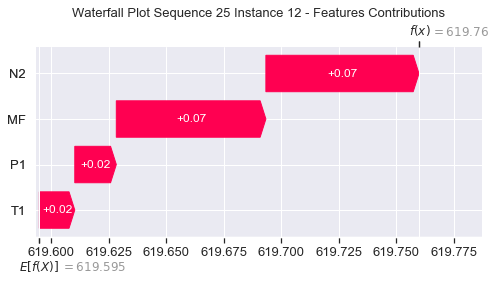

None

Contribution: [0.01998939 0.01738643 0.07241401 0.07056023]


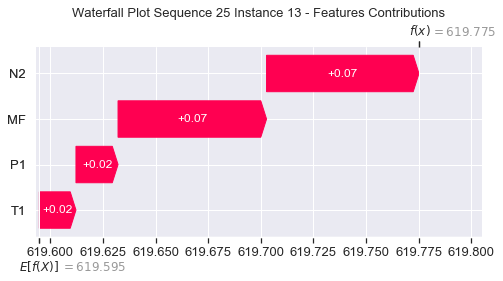

None

Contribution: [0.02280538 0.01954409 0.08031769 0.07760021]


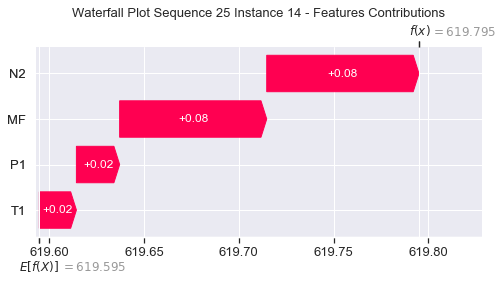

None

Contribution: [0.02604258 0.0233488  0.09108349 0.08860746]


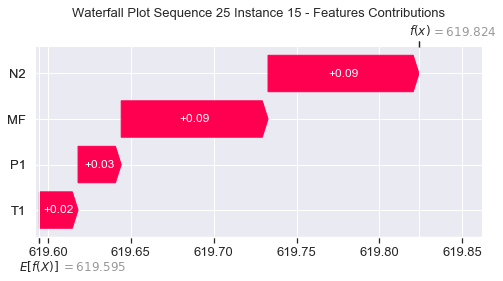

None

Contribution: [0.02933651 0.02568486 0.10443707 0.10007365]


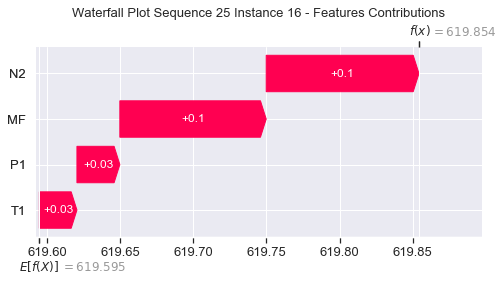

None

Contribution: [0.03616872 0.03327655 0.12222952 0.11915864]


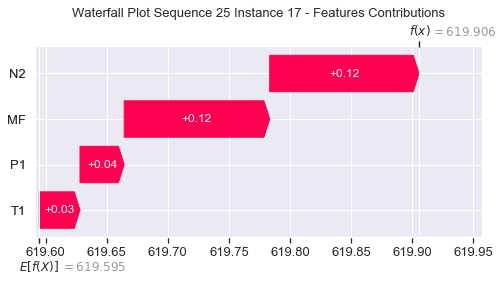

None

Contribution: [0.04339373 0.04060517 0.14444726 0.14089114]


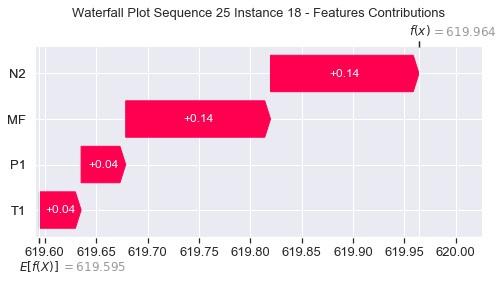

None

Contribution: [0.05400316 0.04999261 0.17408926 0.17108674]


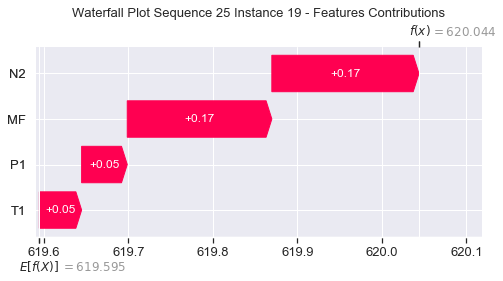

None

Contribution: [0.06520147 0.06271544 0.21099285 0.20674681]


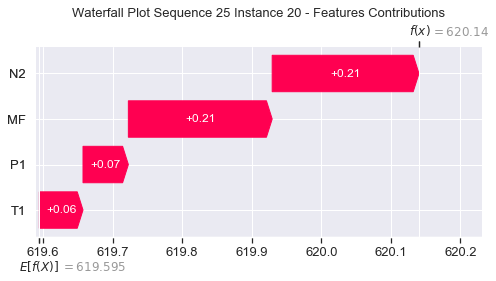

None

Contribution: [0.08210996 0.0788317  0.26242331 0.25804228]


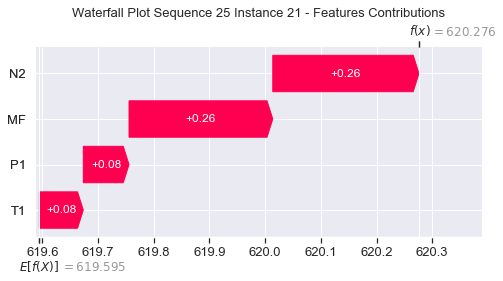

None

Contribution: [0.1055611  0.12032927 0.33401646 0.32318224]


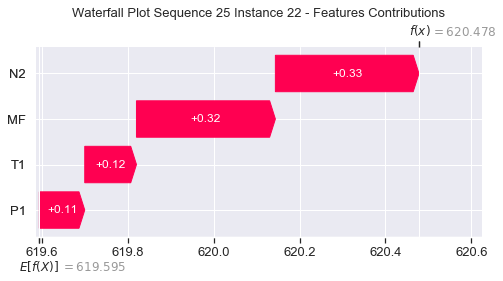

None

Contribution: [0.11987263 0.14836075 0.36830925 0.35487641]


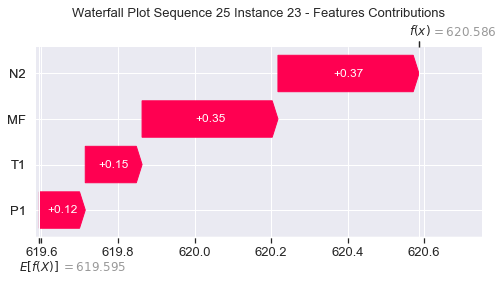

None

Contribution: [ 0.34303696 -0.43611538  1.12372112  1.37511387]


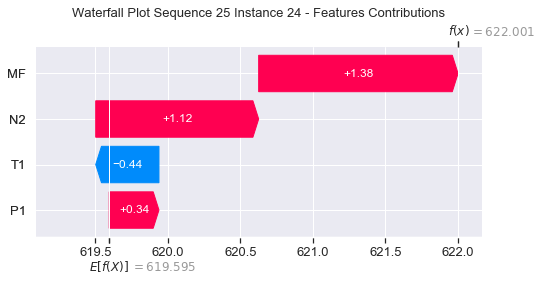

None

Contribution: [0.30831562 0.46054526 1.14871534 1.13071312]


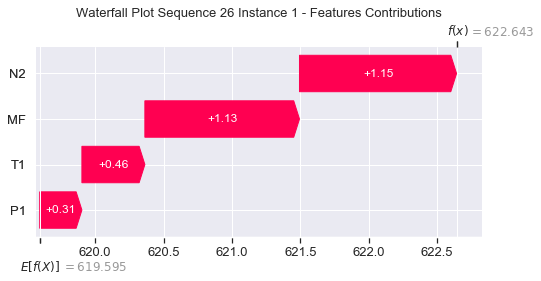

None

Contribution: [0.0284166  0.05113422 0.12256294 0.1278732 ]


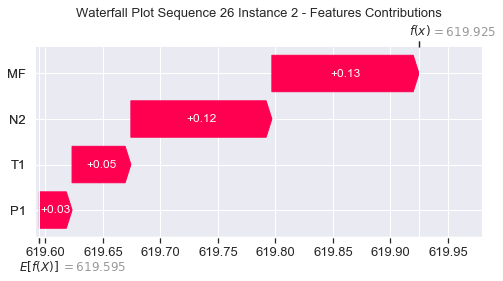

None

Contribution: [0.00257094 0.0061683  0.04448192 0.05453924]


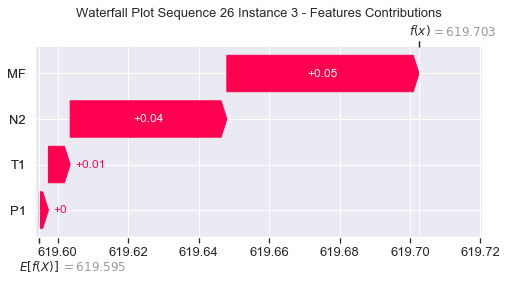

None

Contribution: [0.00587767 0.00650781 0.03207629 0.03333018]


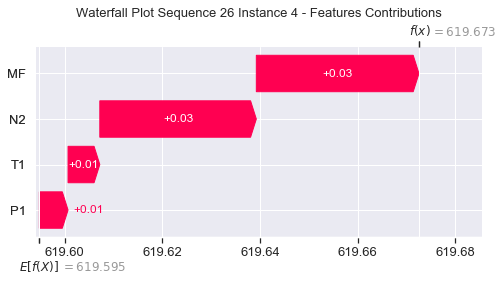

None

Contribution: [0.01153699 0.01133918 0.04927774 0.04975052]


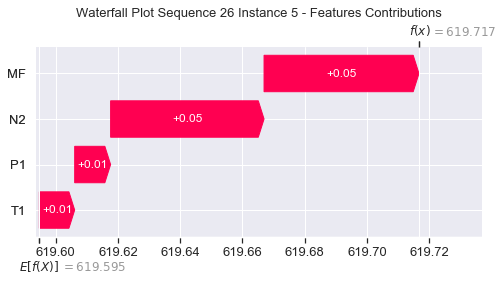

None

Contribution: [0.01329127 0.01228247 0.05455875 0.05462001]


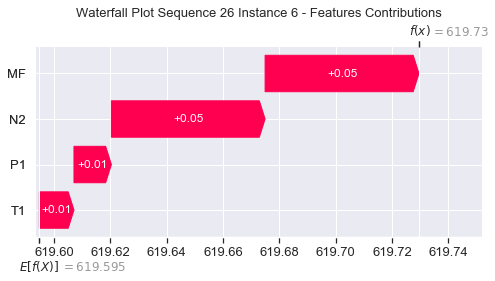

None

Contribution: [0.0144419  0.01295403 0.05745181 0.05739562]


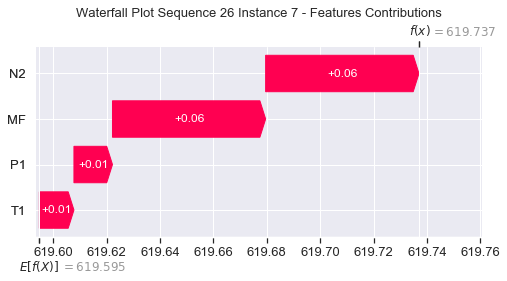

None

Contribution: [0.01518501 0.01345534 0.05912586 0.05876092]


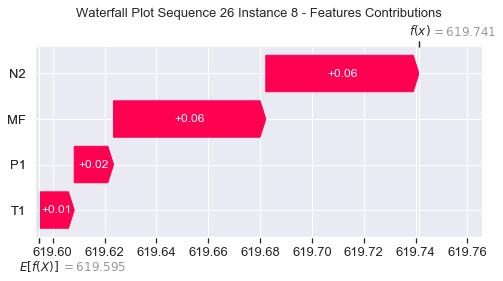

None

Contribution: [0.01561402 0.01401408 0.06003523 0.05942826]


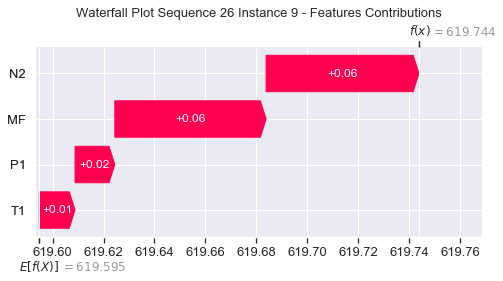

None

Contribution: [0.01602266 0.01444168 0.06114665 0.06073992]


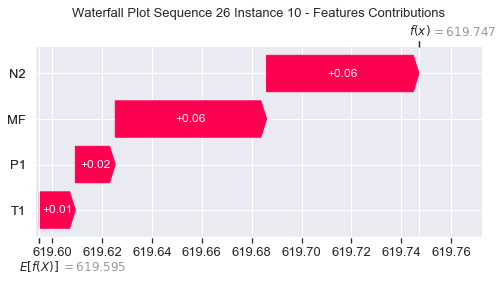

None

Contribution: [0.01691154 0.01509133 0.06309161 0.06184722]


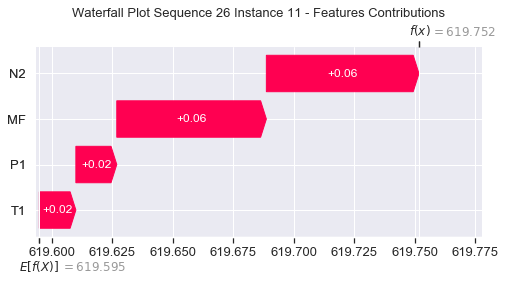

None

Contribution: [0.01845715 0.01605702 0.06665821 0.06601314]


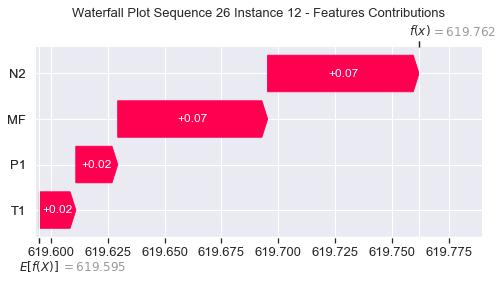

None

Contribution: [0.02037905 0.01816235 0.07251744 0.07157287]


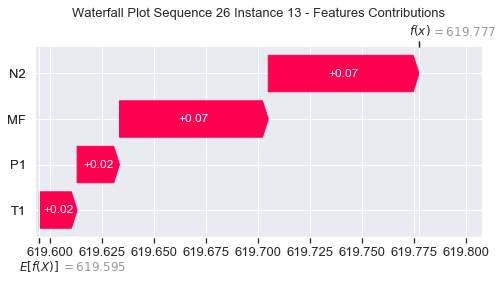

None

Contribution: [0.02278318 0.02071329 0.08044729 0.07898197]


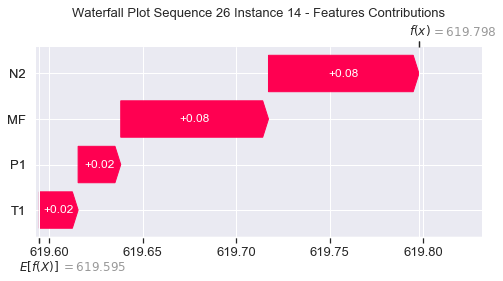

None

Contribution: [0.02631788 0.02391356 0.0911635  0.08964219]


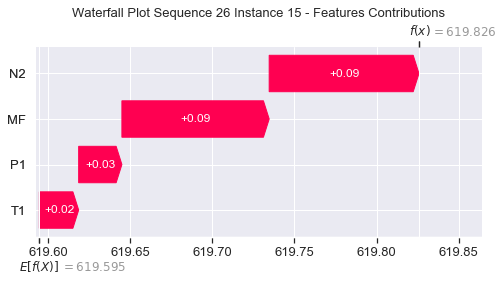

None

Contribution: [0.03035168 0.02903213 0.1047831  0.10300076]


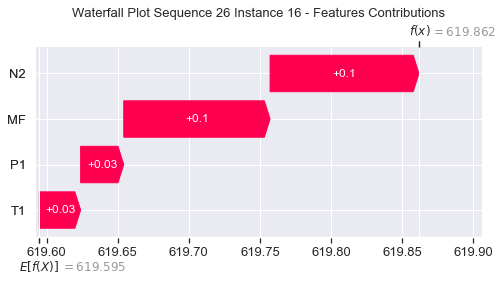

None

Contribution: [0.03638285 0.03395896 0.12225464 0.12021569]


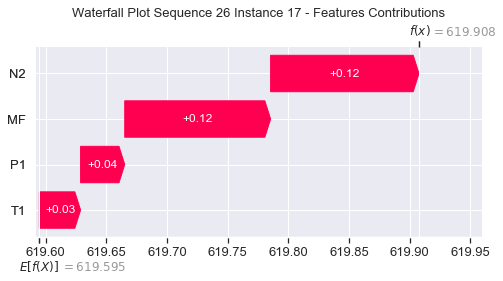

None

Contribution: [0.04350736 0.04105852 0.14449097 0.14197645]


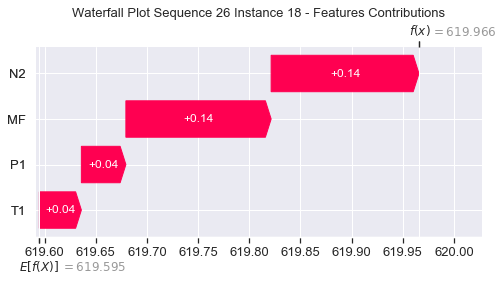

None

Contribution: [0.05314604 0.05142731 0.17379806 0.17102295]


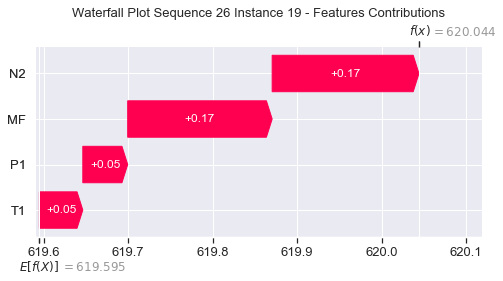

None

Contribution: [0.06493933 0.06272979 0.21090596 0.20766808]


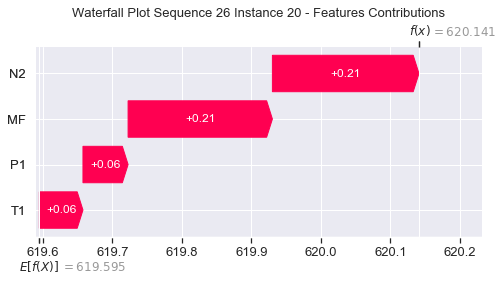

None

Contribution: [0.08207333 0.07812776 0.2622676  0.25952433]


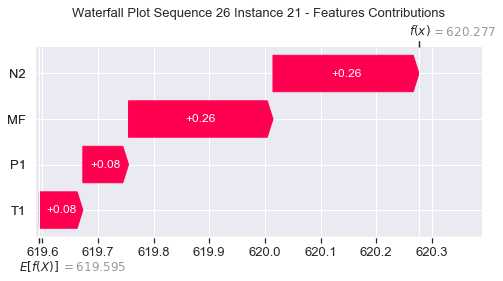

None

Contribution: [0.10562948 0.11934629 0.3338872  0.32396422]


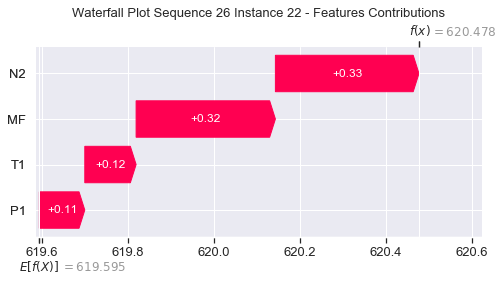

None

Contribution: [0.11979328 0.14787244 0.36809379 0.35485176]


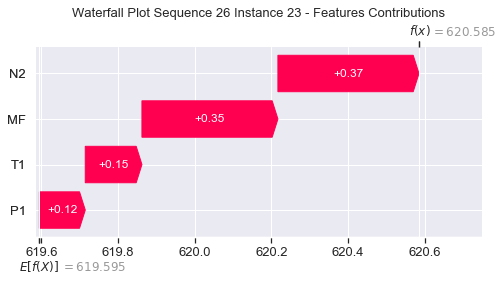

None

Contribution: [ 0.32189196 -0.54338318  1.10088373  1.36083566]


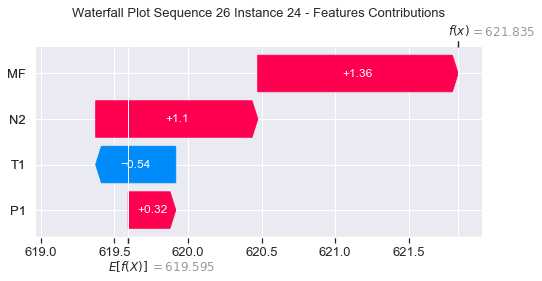

None

Contribution: [0.30722852 0.43964434 1.15349708 1.11352397]


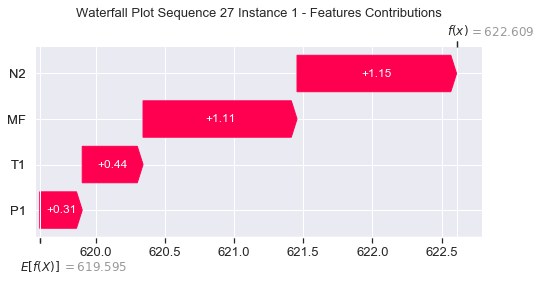

None

Contribution: [0.03048228 0.04777604 0.12485034 0.13401235]


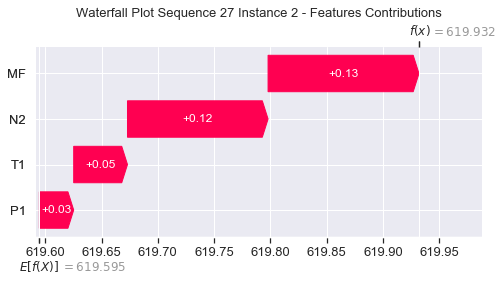

None

Contribution: [0.00283034 0.00483389 0.04558882 0.0567387 ]


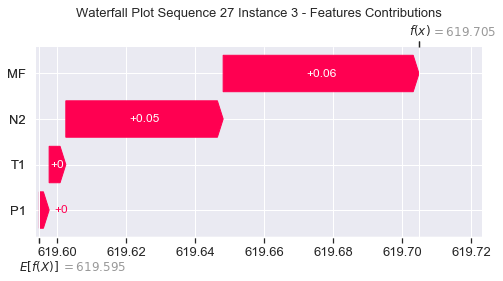

None

Contribution: [0.00584395 0.00628898 0.03197215 0.03359478]


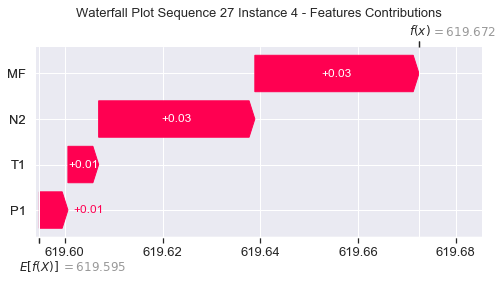

None

Contribution: [0.01129193 0.01016374 0.04929499 0.04939483]


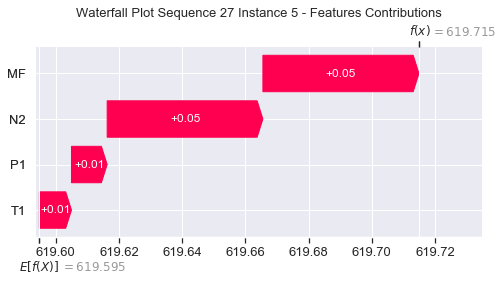

None

Contribution: [0.01332873 0.01156099 0.05452065 0.05480355]


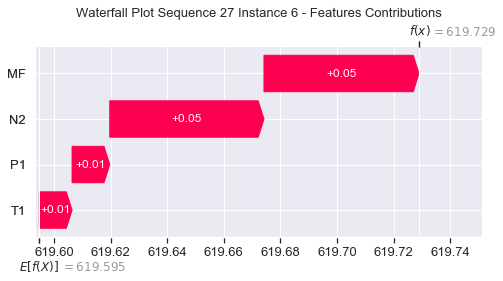

None

Contribution: [0.01448173 0.01231184 0.05745269 0.05743833]


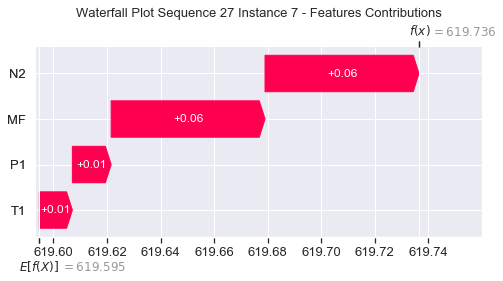

None

Contribution: [0.01517476 0.0127273  0.0591261  0.05881211]


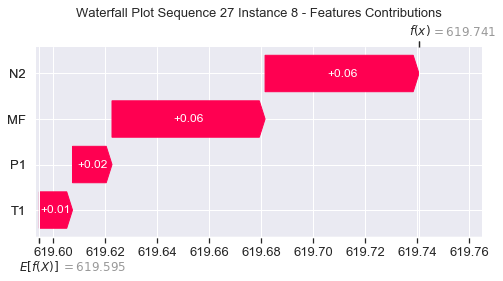

None

Contribution: [0.01543652 0.01345223 0.06002932 0.05908179]


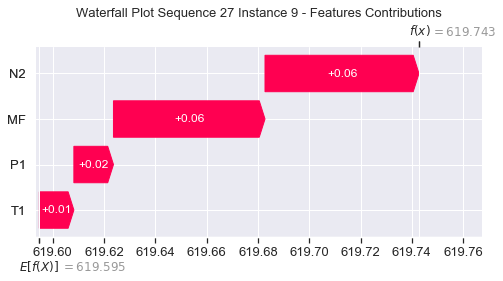

None

Contribution: [0.01586271 0.01374423 0.06108584 0.05995674]


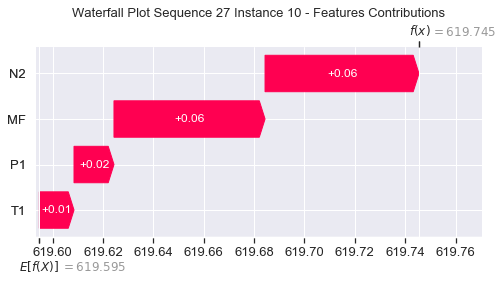

None

Contribution: [0.01659899 0.01405412 0.0630142  0.06153106]


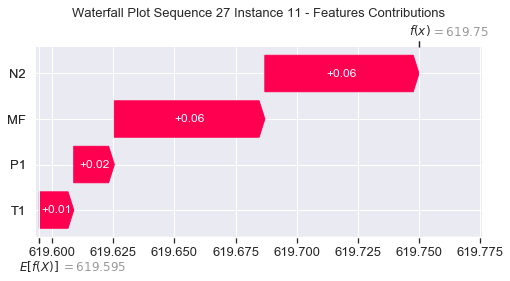

None

Contribution: [0.01782122 0.01489532 0.06639481 0.06450618]


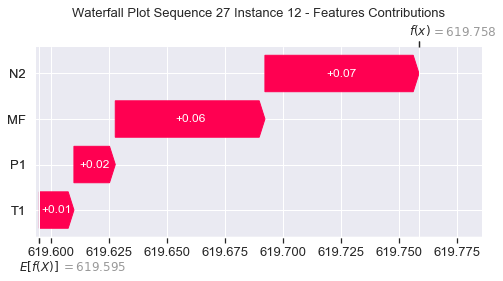

None

Contribution: [0.01972903 0.01706798 0.07221084 0.07001419]


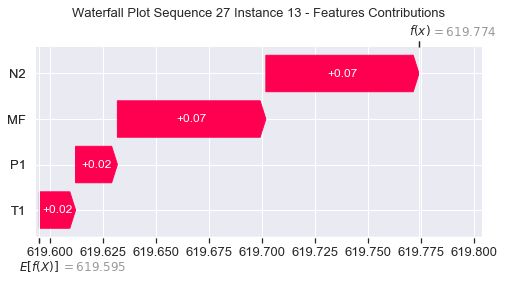

None

Contribution: [0.02229742 0.02016602 0.08025049 0.0782923 ]


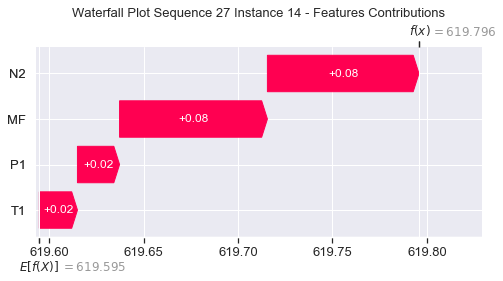

None

Contribution: [0.02575155 0.02323997 0.09083576 0.08816579]


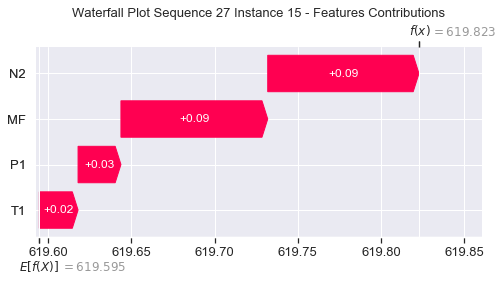

None

Contribution: [0.03035068 0.02870586 0.10456201 0.10216054]


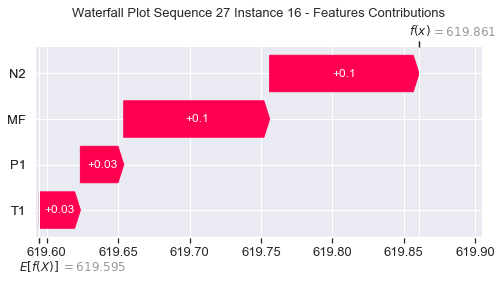

None

Contribution: [0.03601512 0.03403453 0.12192208 0.11893642]


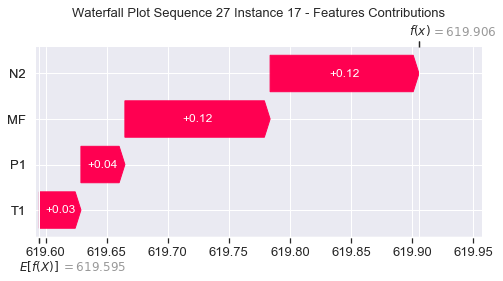

None

Contribution: [0.04336089 0.04162242 0.14420195 0.14118689]


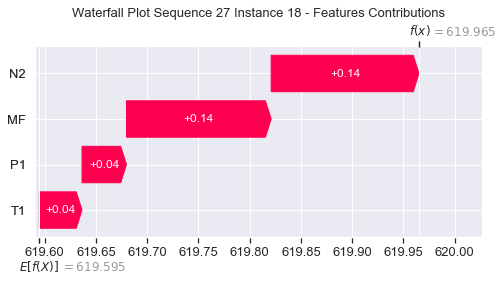

None

Contribution: [0.05289107 0.05098167 0.17336942 0.16840399]


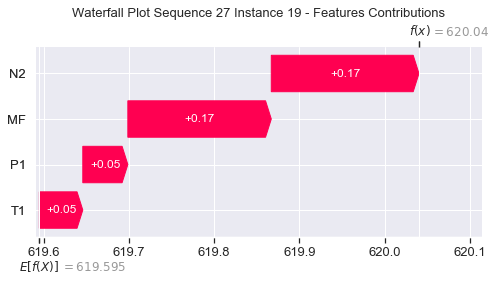

None

Contribution: [0.06510056 0.06459813 0.21067638 0.20750304]


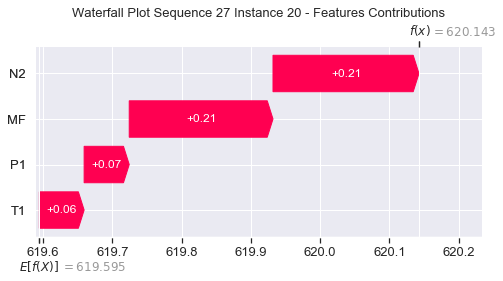

None

Contribution: [0.08145891 0.07991501 0.26182953 0.25808339]


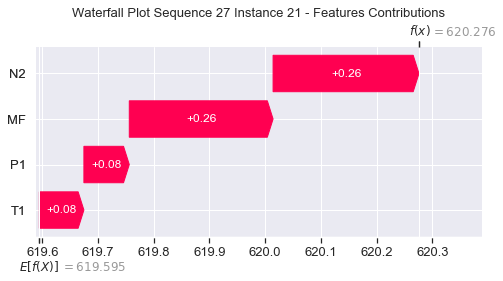

None

Contribution: [0.10485558 0.1199788  0.33390224 0.32304229]


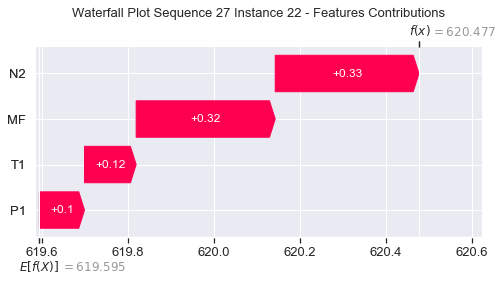

None

Contribution: [0.11959766 0.14848077 0.36838327 0.3550765 ]


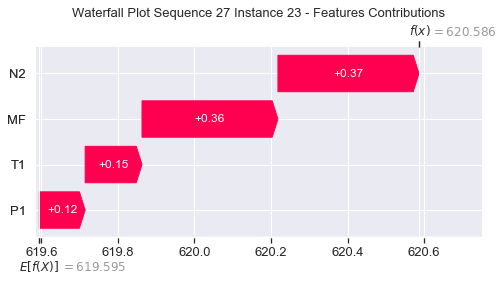

None

Contribution: [ 0.31191966 -0.42508778  1.09101982  1.37169618]


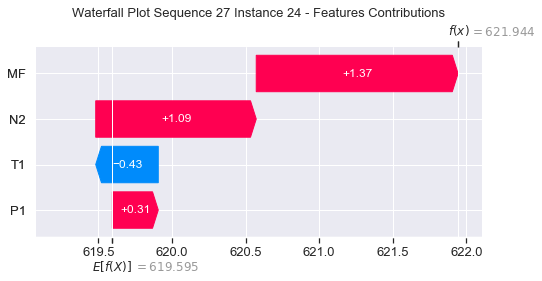

None

Contribution: [0.30123329 0.48300405 1.16310455 1.11556646]


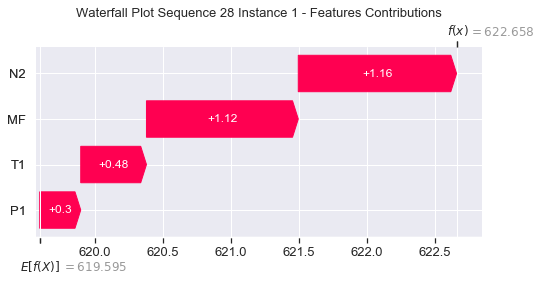

None

Contribution: [0.02586725 0.04678927 0.12382521 0.12521561]


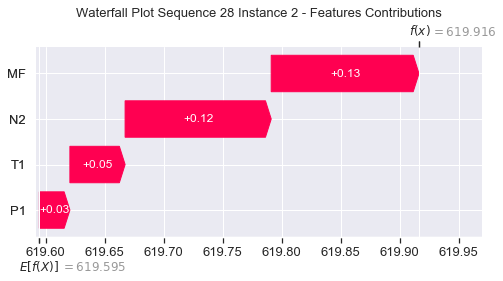

None

Contribution: [0.00184068 0.00531557 0.04538057 0.05347386]


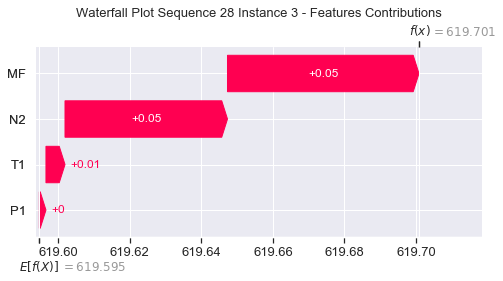

None

Contribution: [0.00575139 0.00626147 0.03171324 0.03324965]


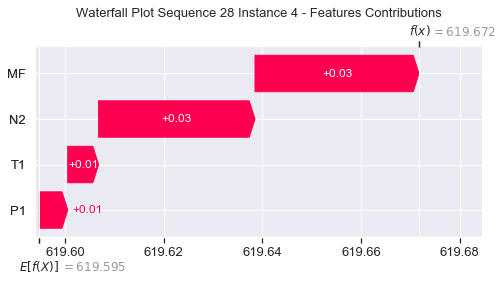

None

Contribution: [0.01170786 0.01092616 0.0492611  0.05055285]


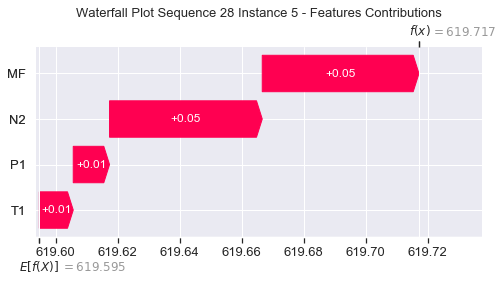

None

Contribution: [0.01344712 0.01296556 0.05444353 0.05516497]


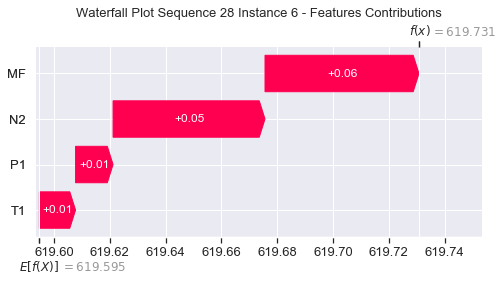

None

Contribution: [0.01444844 0.01418471 0.05737613 0.05788021]


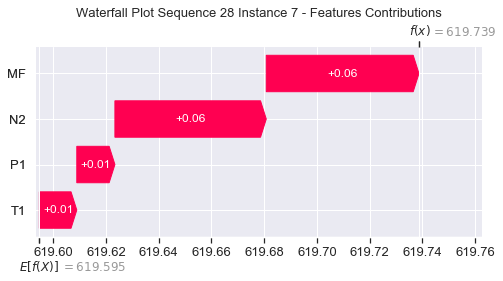

None

Contribution: [0.01540014 0.01402094 0.05915091 0.05938162]


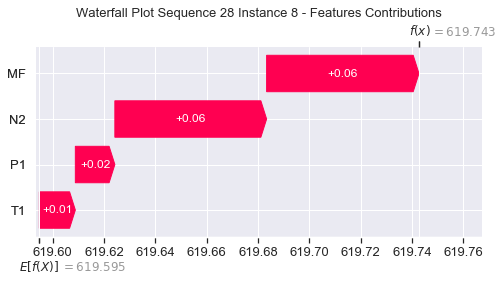

None

Contribution: [0.01565531 0.01607334 0.06034492 0.0602944 ]


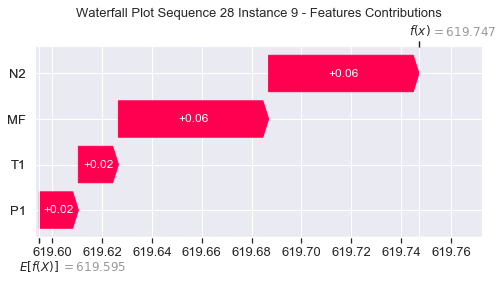

None

Contribution: [0.01669073 0.0162532  0.06148646 0.06217721]


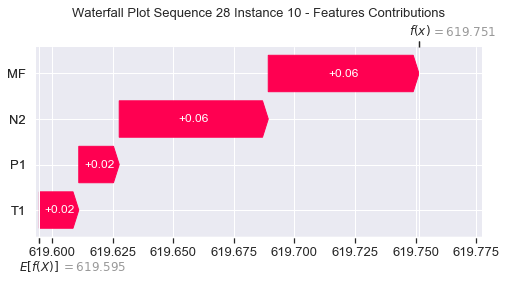

None

Contribution: [0.01751391 0.01529903 0.06346349 0.0625342 ]


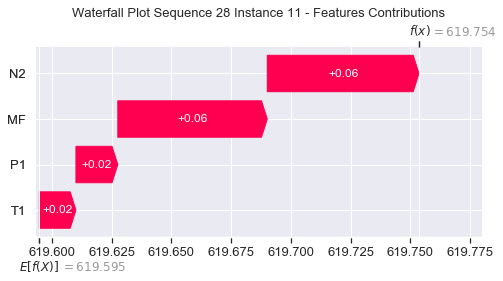

None

Contribution: [0.01851075 0.01557063 0.06684238 0.06618805]


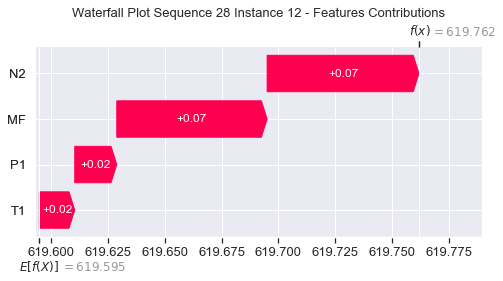

None

Contribution: [0.02046918 0.01755311 0.07275806 0.07188338]


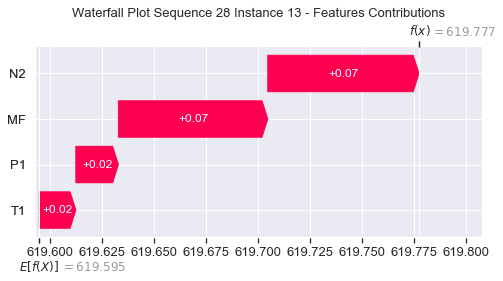

None

Contribution: [0.02244619 0.01922126 0.08061586 0.07767504]


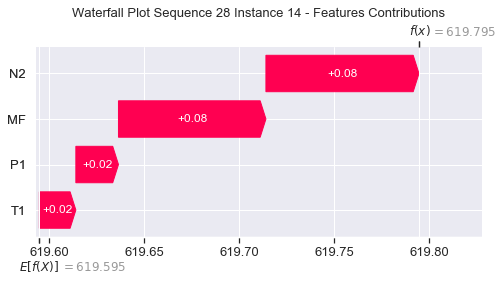

None

Contribution: [0.02675497 0.02208764 0.09135825 0.08962621]


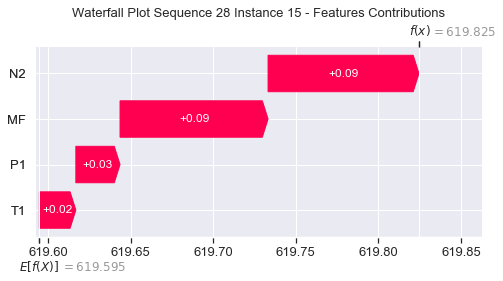

None

Contribution: [0.03179083 0.02756354 0.1051432  0.10454879]


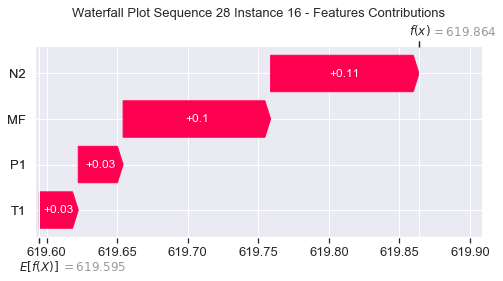

None

Contribution: [0.03715747 0.03105429 0.1225549  0.12031626]


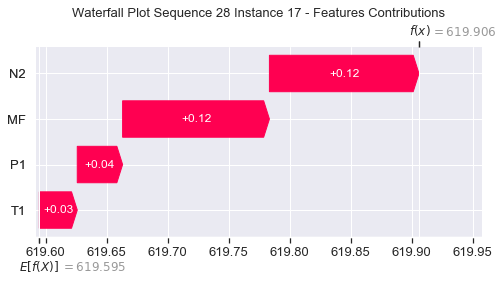

None

Contribution: [0.04498109 0.03601763 0.14490481 0.14221773]


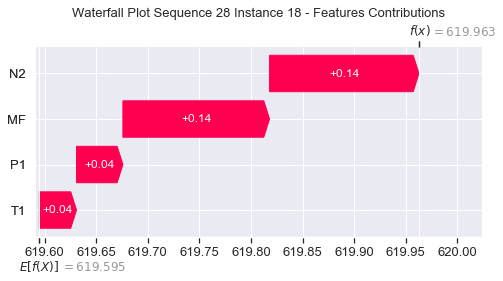

None

Contribution: [0.0534012  0.04270097 0.17442307 0.17161657]


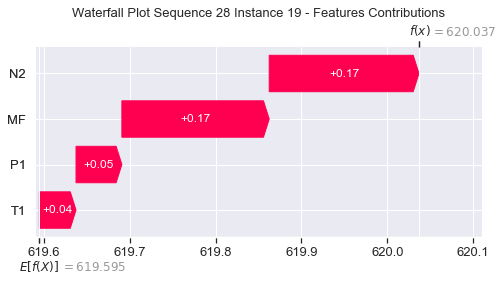

None

Contribution: [0.06839945 0.05111069 0.21189162 0.2090167 ]


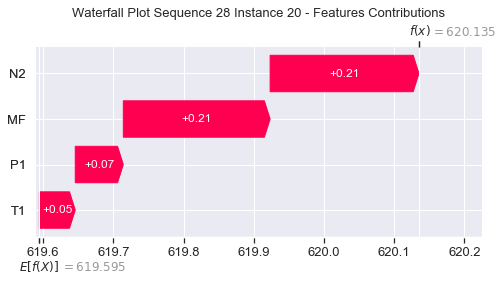

None

Contribution: [0.0871     0.05930173 0.26356894 0.26109294]


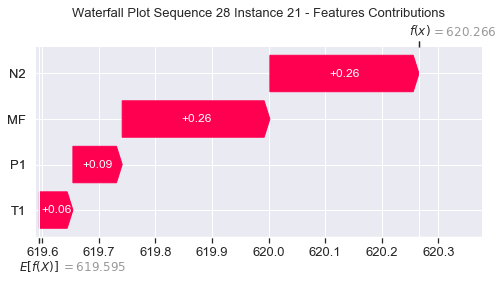

None

Contribution: [0.10966991 0.10696702 0.33554713 0.32564905]


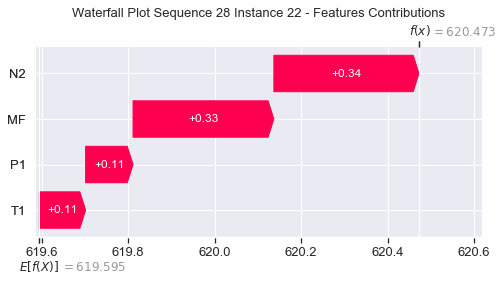

None

Contribution: [0.12325205 0.14124403 0.37017714 0.35694998]


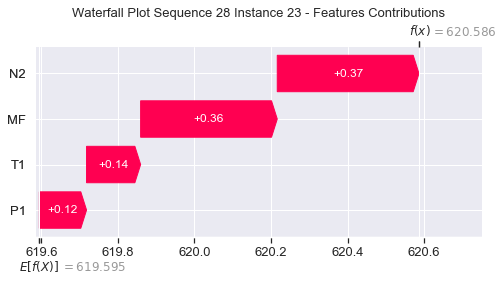

None

Contribution: [ 0.74028544 -1.78738443  1.17012029  1.6885199 ]


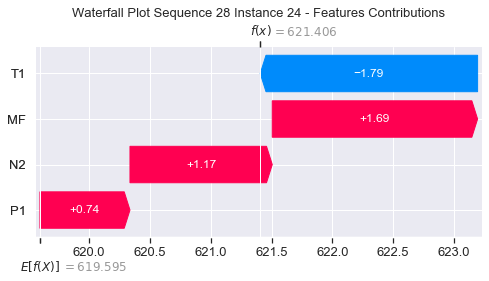

None

Contribution: [0.46373506 0.04988151 1.22660475 1.34794392]


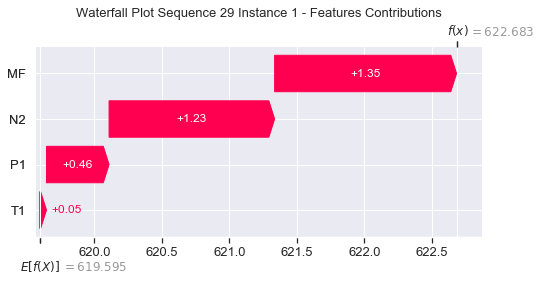

None

Contribution: [0.0369667  0.00521143 0.1281186  0.13606132]


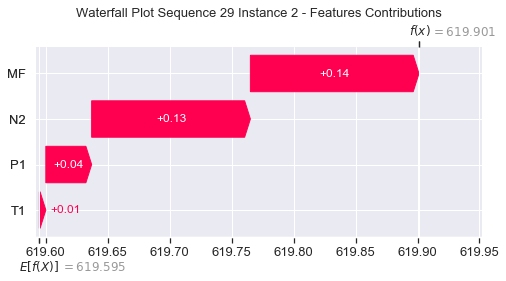

None

Contribution: [ 0.00516143 -0.00504034  0.04744758  0.05797986]


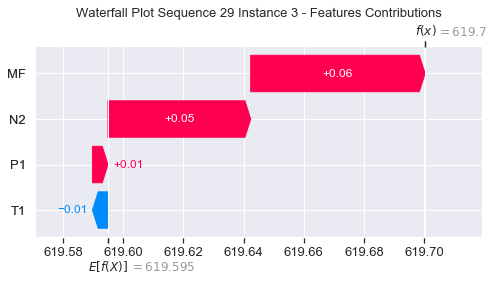

None

Contribution: [0.00676917 0.0020395  0.03253285 0.03513808]


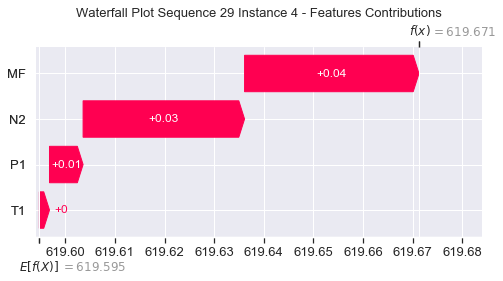

None

Contribution: [0.01282554 0.00428462 0.05035275 0.05064049]


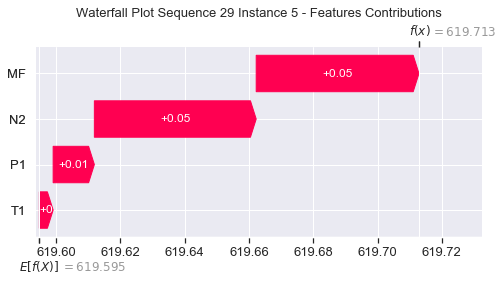

None

Contribution: [0.01600705 0.0034034  0.05583026 0.05765289]


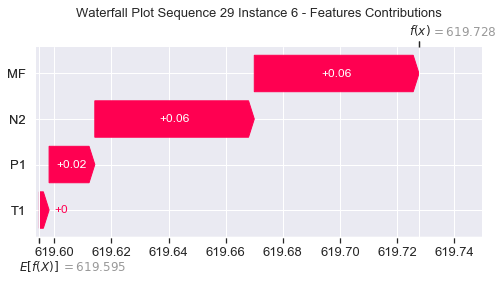

None

Contribution: [0.01745866 0.00319312 0.05880173 0.06049063]


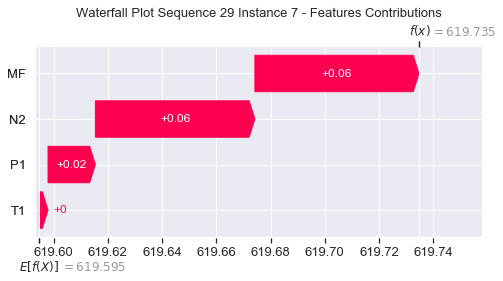

None

Contribution: [0.01803066 0.00389145 0.06040194 0.06156616]


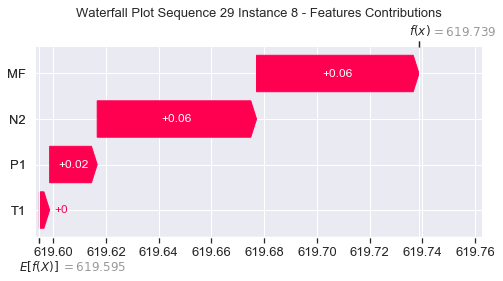

None

Contribution: [0.01828944 0.00324791 0.06118505 0.06151374]


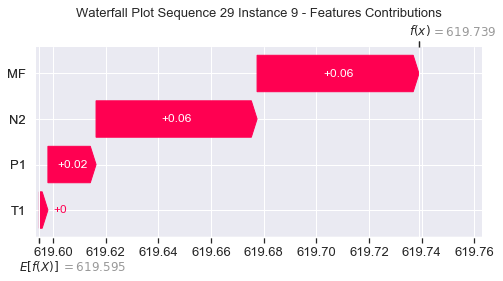

None

Contribution: [0.01712673 0.00371477 0.06189432 0.06050713]


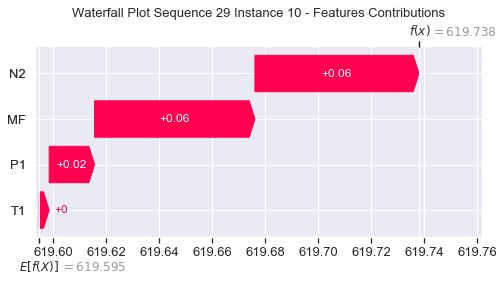

None

Contribution: [0.01988061 0.00406454 0.06415044 0.06497025]


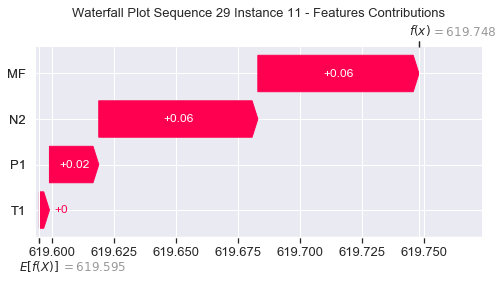

None

Contribution: [0.02181044 0.00410791 0.0676654  0.0694489 ]


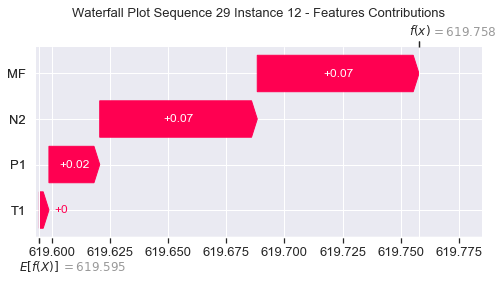

None

Contribution: [0.02371736 0.00571837 0.07344449 0.07456298]


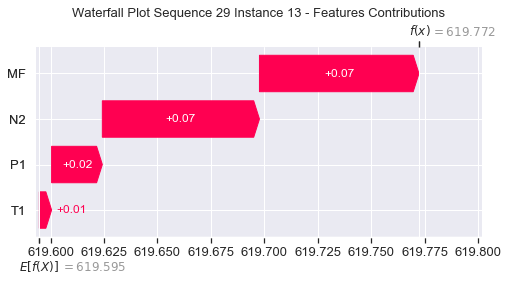

None

Contribution: [0.02847037 0.00786162 0.08177226 0.08399489]


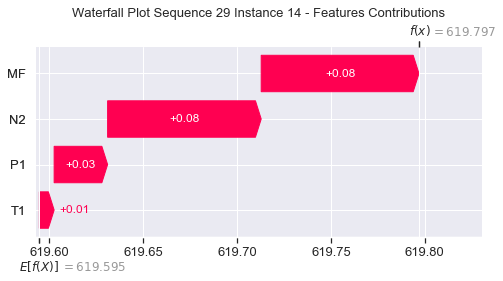

None

Contribution: [0.03051212 0.01017375 0.09228212 0.09314912]


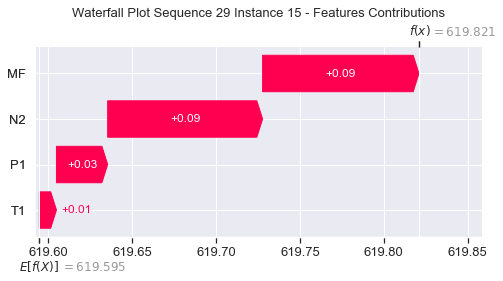

None

Contribution: [0.03637294 0.00911444 0.1063163  0.10832105]


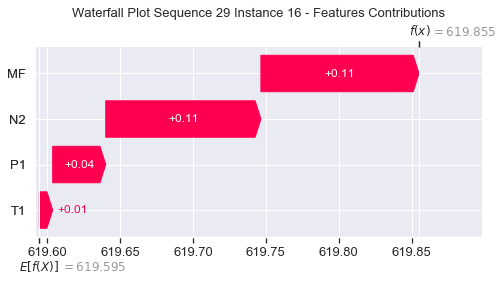

None

Contribution: [0.04150096 0.01761974 0.12357678 0.12422121]


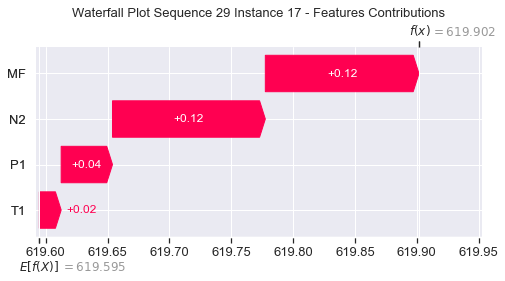

None

Contribution: [0.04911075 0.02412235 0.14596846 0.14647177]


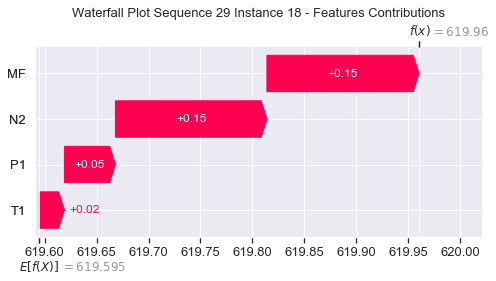

None

Contribution: [0.0558714  0.03916547 0.1744623  0.1706497 ]


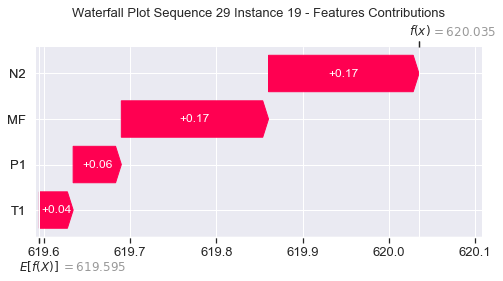

None

Contribution: [0.06911694 0.04496676 0.21242394 0.20880046]


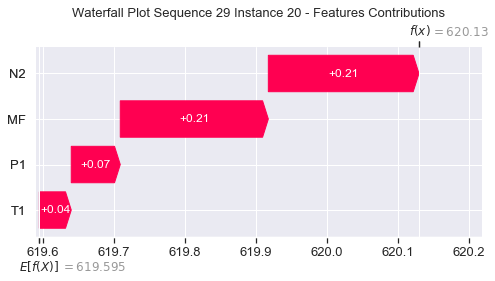

None

Contribution: [0.08589272 0.05685228 0.26399514 0.2596916 ]


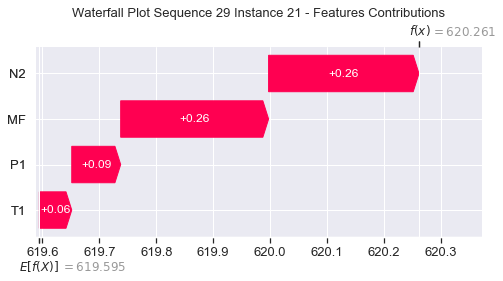

None

Contribution: [0.10669071 0.11066479 0.33564191 0.32400387]


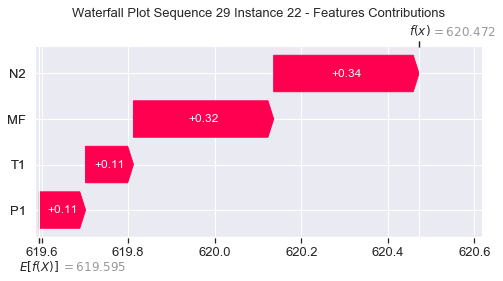

None

Contribution: [0.12150668 0.1433178  0.37010844 0.35690606]


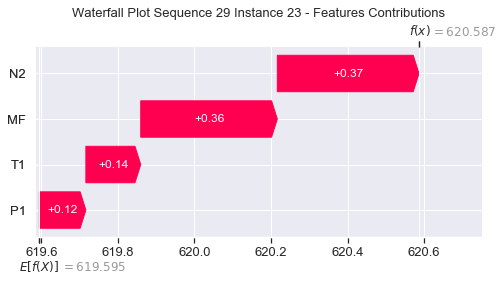

None

Contribution: [ 0.31371086 -0.86734967  1.13491808  1.29207534]


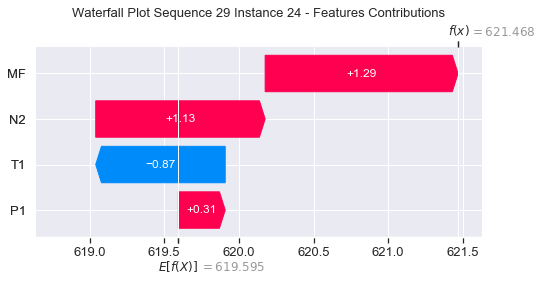

None

Contribution: [0.30566615 0.4181224  1.18347782 1.14839247]


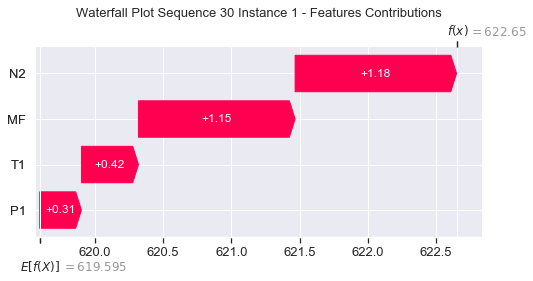

None

Contribution: [0.02526151 0.03256125 0.12477097 0.12505122]


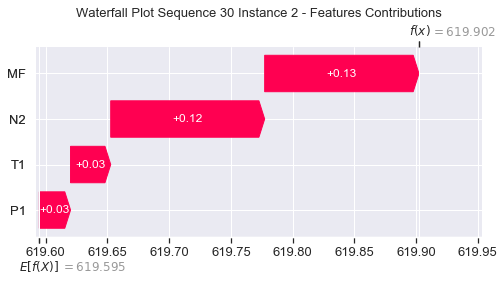

None

Contribution: [0.00239752 0.00243601 0.04615575 0.05447716]


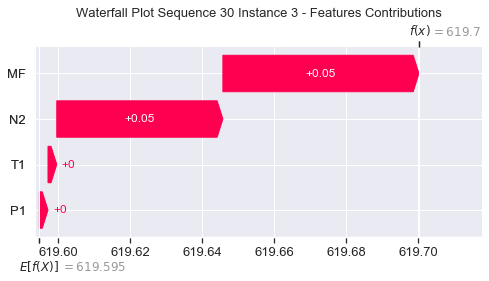

None

Contribution: [0.00521431 0.00449955 0.03155633 0.03209378]


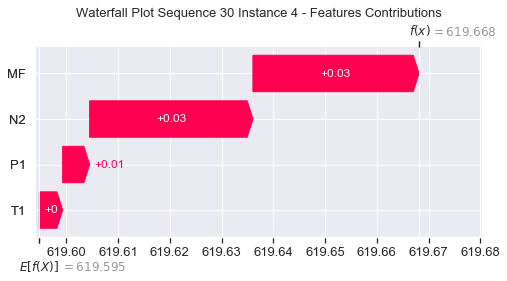

None

Contribution: [0.01145393 0.01079634 0.04942234 0.04986319]


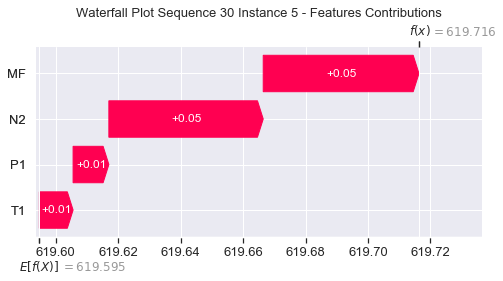

None

Contribution: [0.01333949 0.0117003  0.05482591 0.05477294]


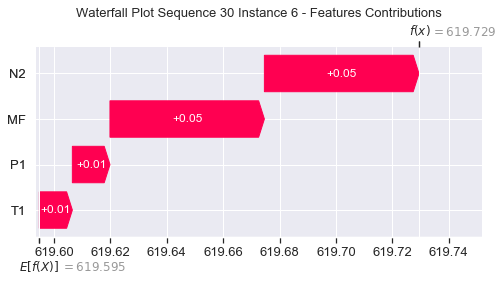

None

Contribution: [0.01445387 0.01232277 0.05765226 0.0573055 ]


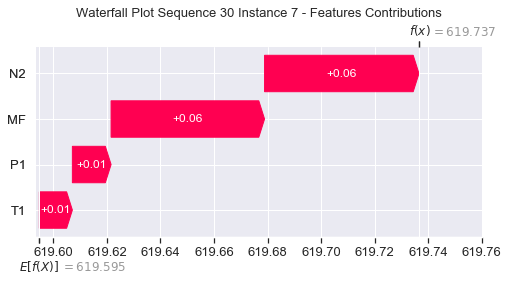

None

Contribution: [0.01517487 0.01283284 0.05932491 0.0587173 ]


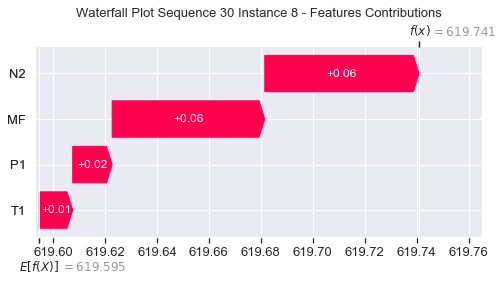

None

Contribution: [0.01559551 0.01391653 0.06014522 0.05951764]


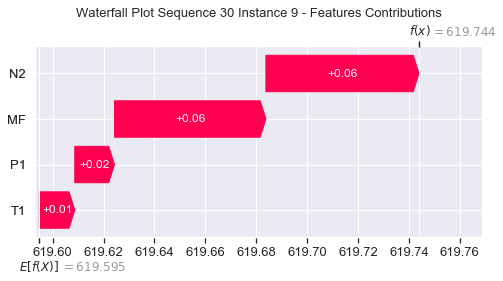

None

Contribution: [0.01615717 0.01384743 0.06135121 0.06008772]


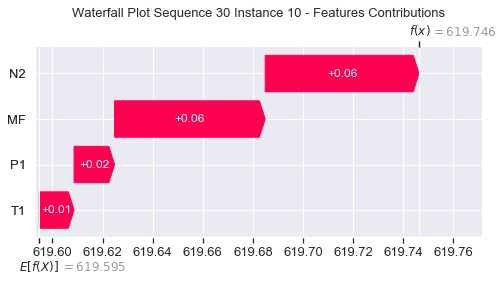

None

Contribution: [0.01661773 0.01477612 0.0632862  0.06182336]


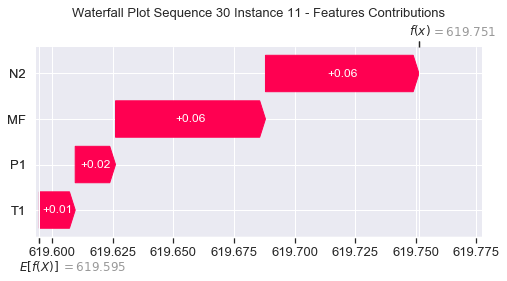

None

Contribution: [0.0177723  0.01491296 0.06674843 0.06460814]


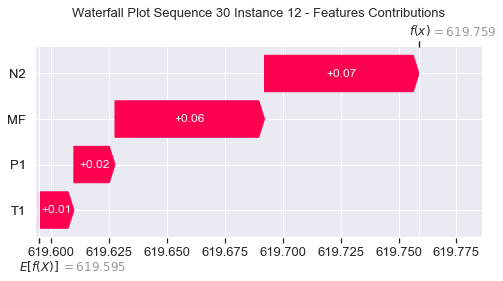

None

Contribution: [0.0197255  0.01697433 0.07256841 0.07009148]


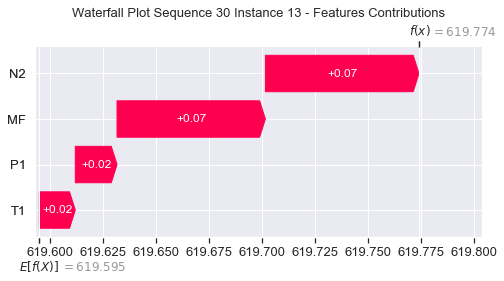

None

Contribution: [0.02243003 0.01847035 0.08036827 0.07631143]


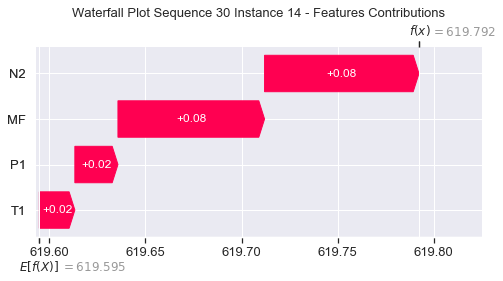

None

Contribution: [0.02565187 0.02265855 0.0911815  0.08777107]


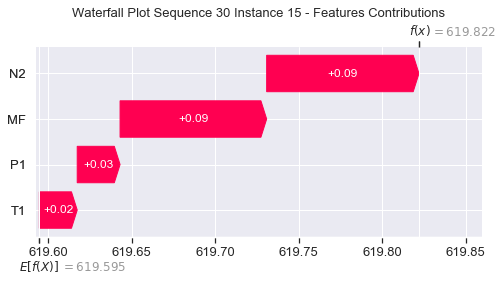

None

Contribution: [0.03056547 0.02721844 0.10500696 0.10282991]


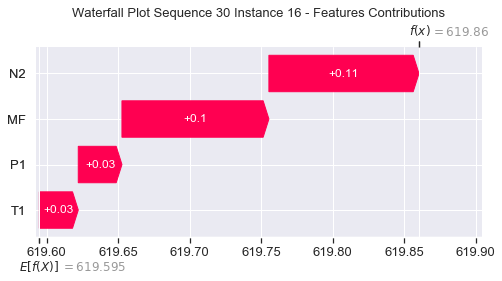

None

Contribution: [0.03566298 0.03239509 0.12219537 0.11767133]


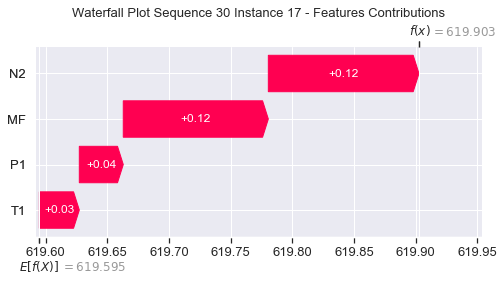

None

Contribution: [0.04281936 0.03929676 0.1444922  0.13922484]


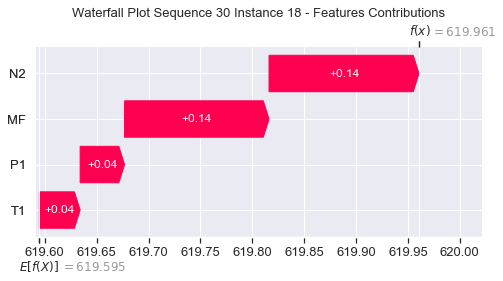

None

Contribution: [0.05299443 0.05062386 0.17391186 0.16917359]


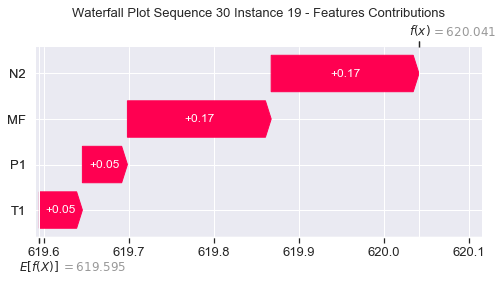

None

Contribution: [0.06452649 0.0608689  0.21092531 0.20443312]


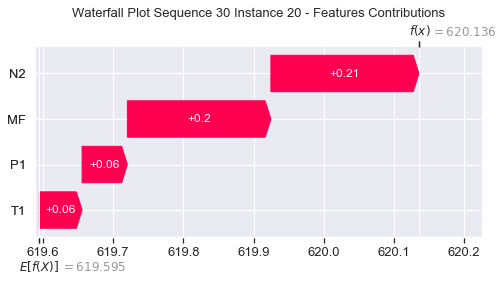

None

Contribution: [0.08097678 0.07555299 0.26240918 0.25474673]


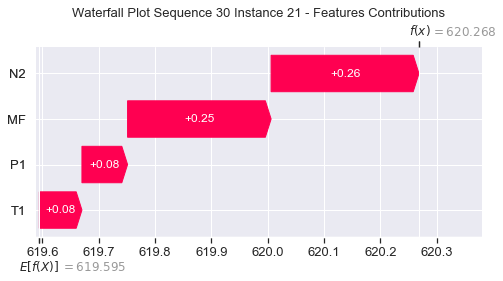

None

Contribution: [0.1048526  0.11826674 0.33473564 0.32217322]


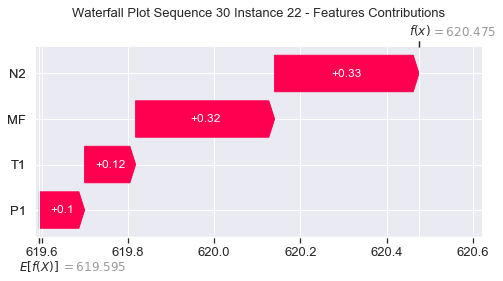

None

Contribution: [0.11951551 0.14732803 0.36957379 0.3554024 ]


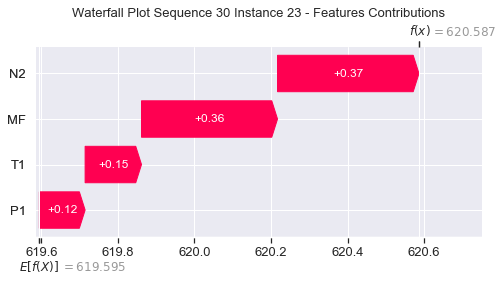

None

Contribution: [ 0.33045865 -0.58258733  1.11581527  1.2972235 ]


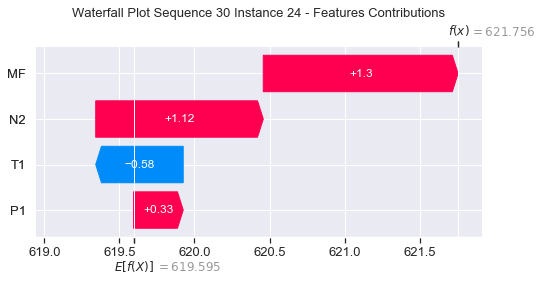

None

Contribution: [0.32319727 0.45585578 1.15979237 1.14371489]


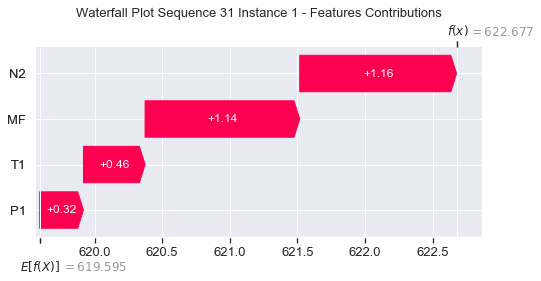

None

Contribution: [0.02603641 0.04324742 0.12242516 0.12226259]


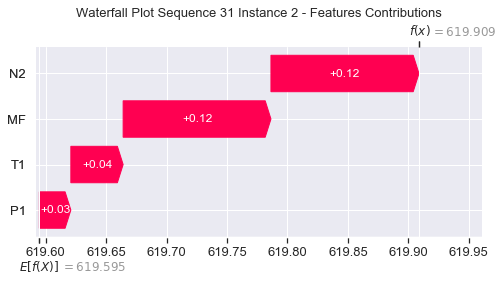

None

Contribution: [0.00197454 0.00528038 0.04502967 0.05327681]


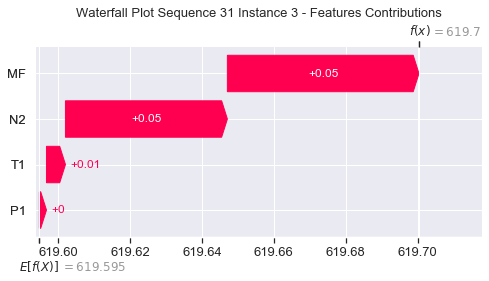

None

Contribution: [0.00568627 0.00638008 0.03209531 0.03294795]


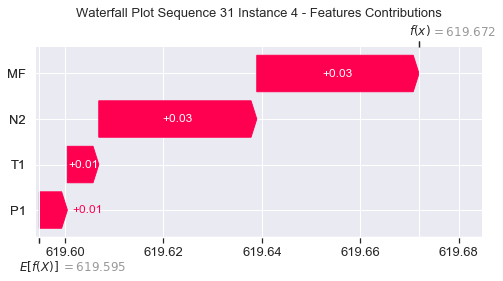

None

Contribution: [0.01154833 0.01087862 0.04981128 0.0501156 ]


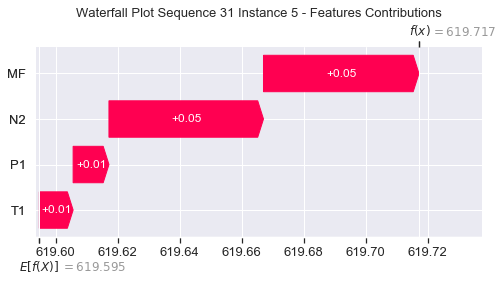

None

Contribution: [0.0132165  0.01195778 0.05503397 0.05446071]


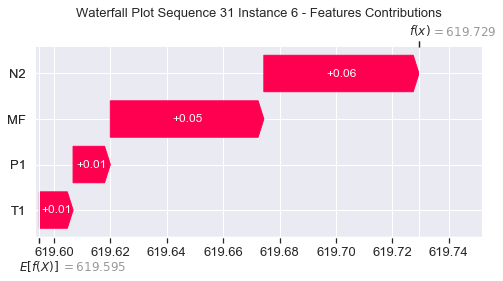

None

Contribution: [0.01436469 0.01258835 0.05786627 0.05698002]


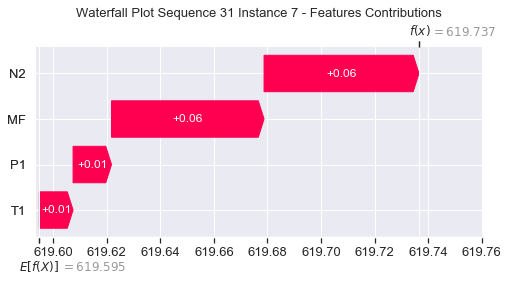

None

Contribution: [0.01515884 0.01304844 0.05954272 0.05865377]


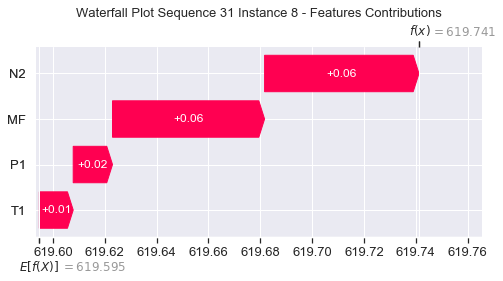

None

Contribution: [0.01612221 0.0135689  0.06043676 0.06052604]


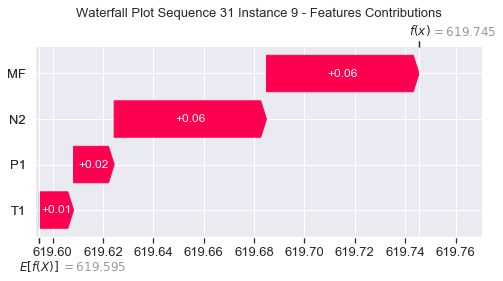

None

Contribution: [0.01624591 0.01456363 0.06143994 0.06044747]


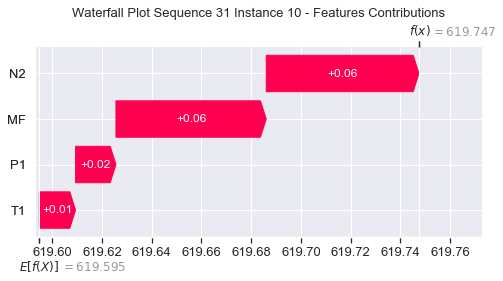

None

Contribution: [0.01705077 0.01479223 0.06348055 0.06278298]


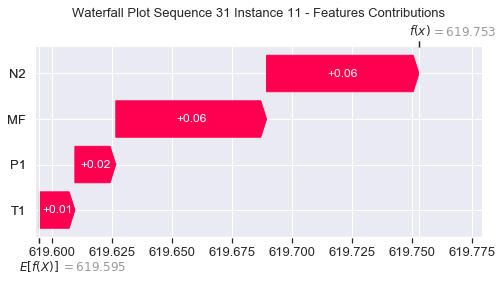

None

Contribution: [0.01773135 0.01541109 0.06681508 0.06425357]


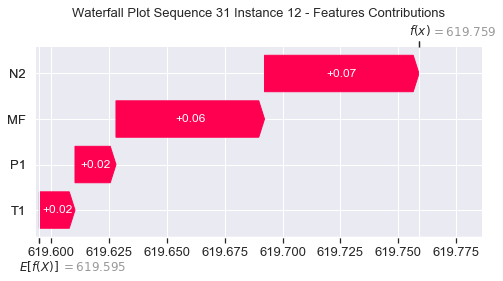

None

Contribution: [0.01974602 0.01740169 0.0726708  0.06987349]


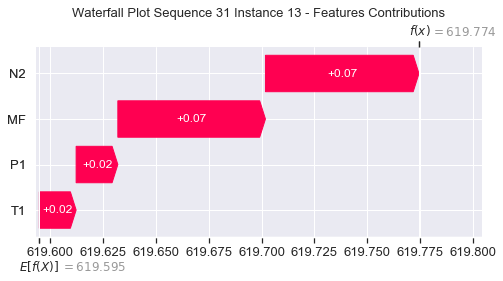

None

Contribution: [0.02222501 0.01882409 0.08069412 0.07835912]


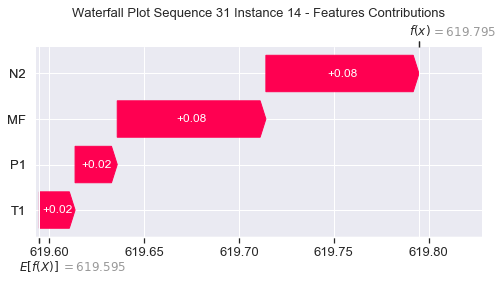

None

Contribution: [0.02562669 0.02316408 0.09125428 0.08764677]


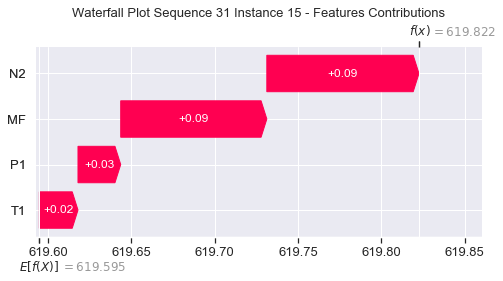

None

Contribution: [0.03040903 0.02909932 0.10521466 0.10275835]


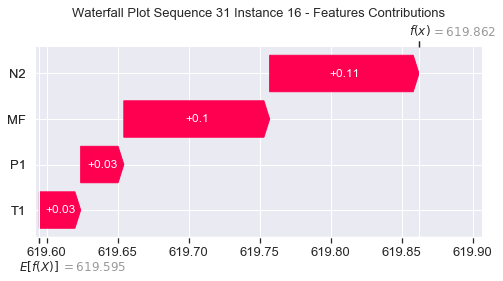

None

Contribution: [0.03587753 0.0329611  0.12232805 0.11782319]


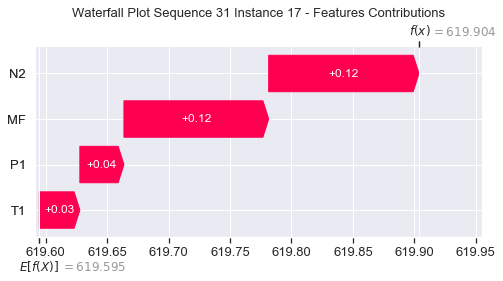

None

Contribution: [0.04309174 0.03995787 0.14465963 0.13958962]


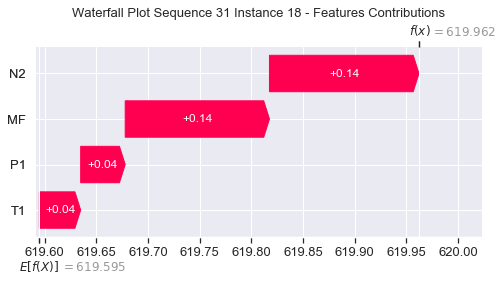

None

Contribution: [0.05214569 0.04908536 0.17462915 0.16626037]


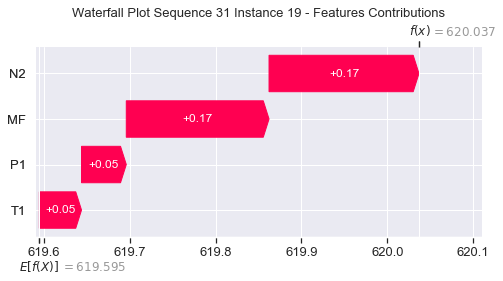

None

Contribution: [0.06575504 0.06113383 0.21143206 0.20651482]


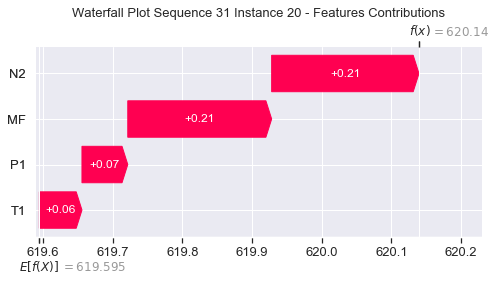

None

Contribution: [0.08272731 0.07578793 0.26275989 0.25778664]


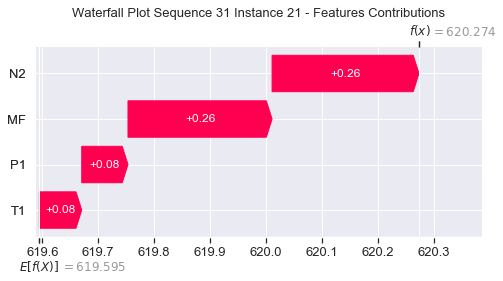

None

Contribution: [0.10589373 0.11824463 0.33438227 0.32348655]


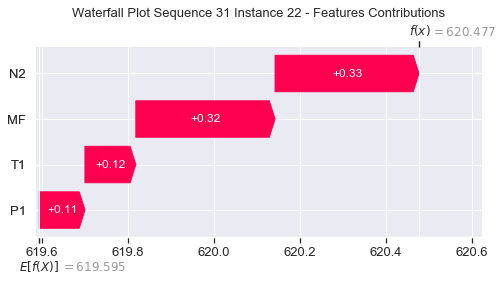

None

Contribution: [0.12000792 0.14744152 0.36867406 0.35503363]


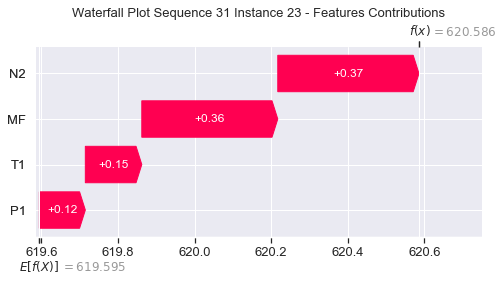

None

Contribution: [ 0.33581171 -0.66967318  1.12353785  1.32787986]


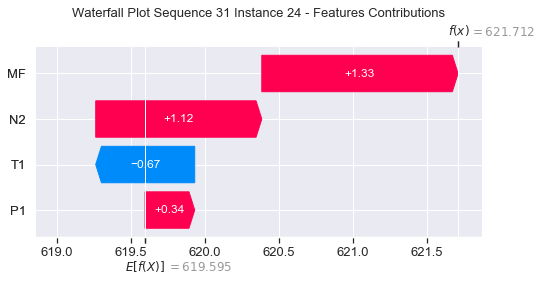

None

Contribution: [0.30325833 0.38157797 1.18074132 1.11099771]


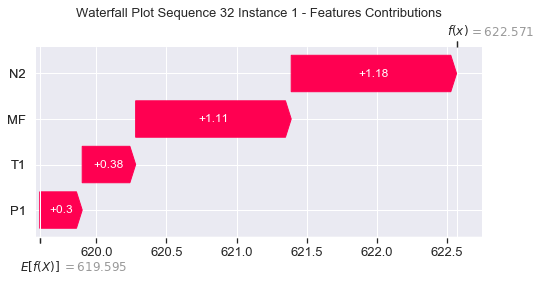

None

Contribution: [0.02974204 0.04407781 0.1272276  0.13256921]


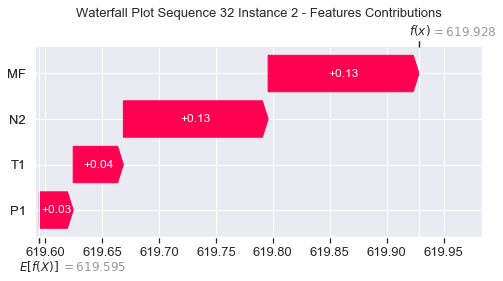

None

Contribution: [0.00224289 0.00516931 0.04697631 0.0553111 ]


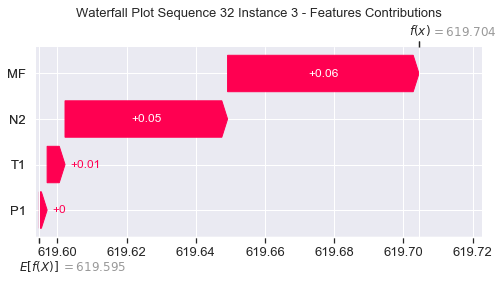

None

Contribution: [0.00554525 0.00586481 0.03156507 0.03238288]


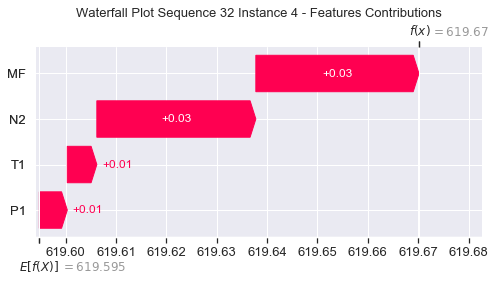

None

Contribution: [0.01157554 0.01045155 0.0496227  0.05062211]


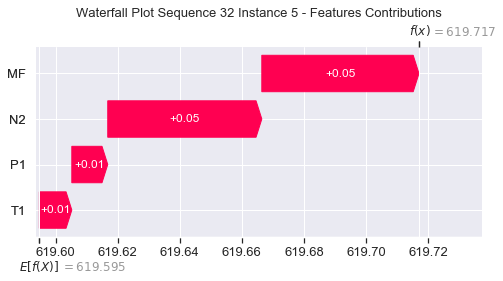

None

Contribution: [0.01348805 0.01138691 0.05495075 0.05551263]


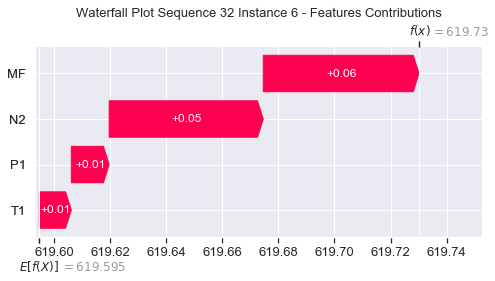

None

Contribution: [0.01464753 0.01205005 0.05791602 0.0582967 ]


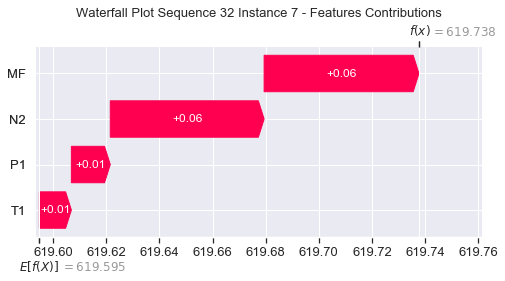

None

Contribution: [0.01535404 0.01248869 0.05964156 0.0596106 ]


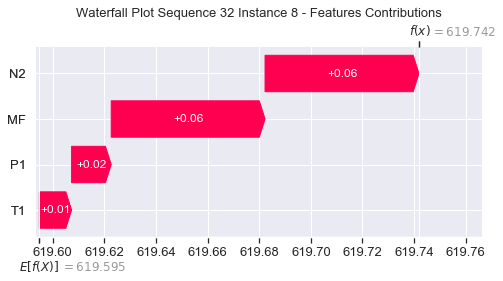

None

Contribution: [0.01515884 0.01334567 0.06018208 0.05916421]


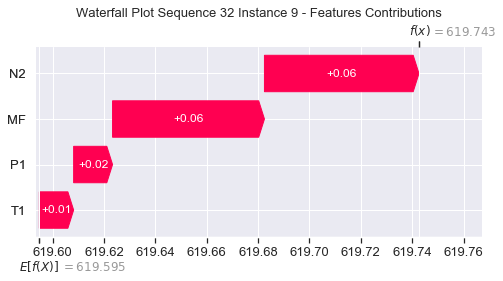

None

Contribution: [0.01523125 0.01385252 0.06091233 0.05912097]


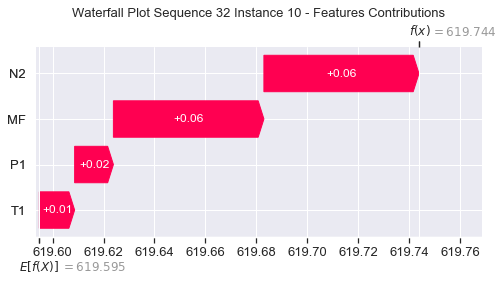

None

Contribution: [0.01639661 0.01429217 0.0632058  0.06157825]


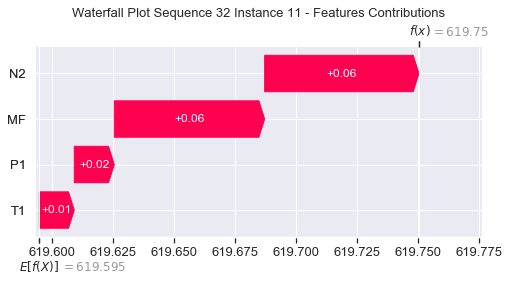

None

Contribution: [0.01832507 0.01526825 0.06718663 0.0666051 ]


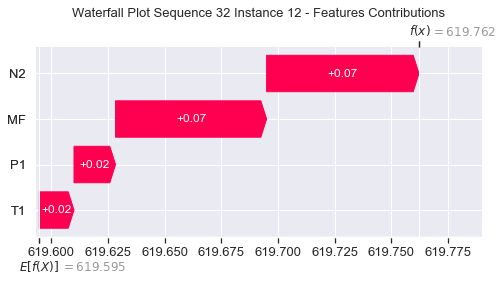

None

Contribution: [0.0202578  0.017208   0.07312884 0.072178  ]


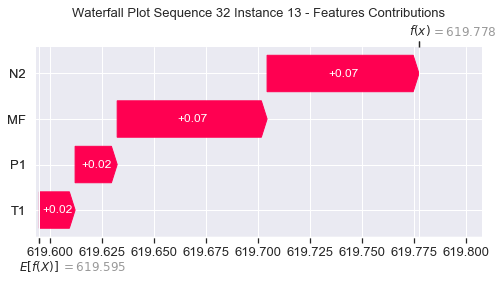

None

Contribution: [0.02245901 0.02095602 0.08113701 0.07874288]


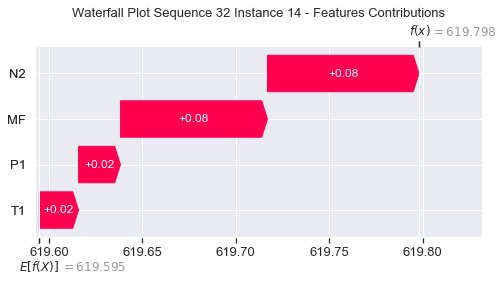

None

Contribution: [0.02618578 0.0223312  0.09199494 0.08996702]


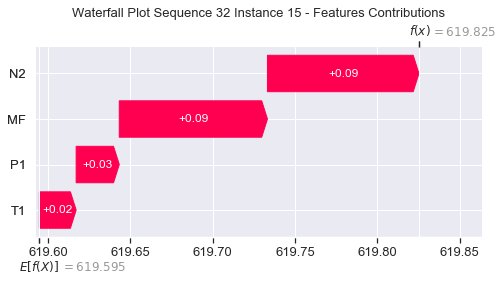

None

Contribution: [0.02987106 0.02595321 0.10561202 0.10156589]


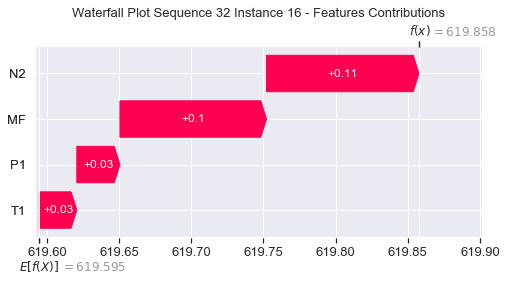

None

Contribution: [0.03630395 0.03168845 0.12333569 0.12046301]


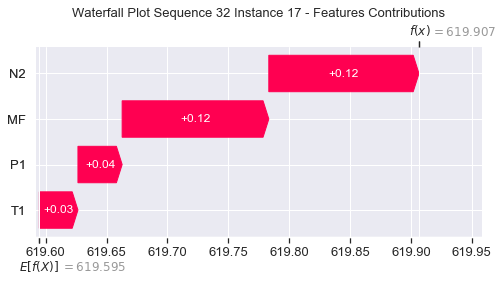

None

Contribution: [0.04353301 0.03805192 0.1458185  0.14222835]


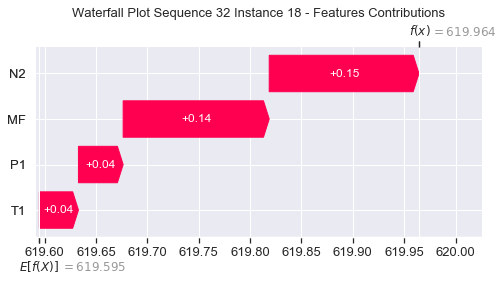

None

Contribution: [0.04993542 0.04292622 0.17455457 0.16847942]


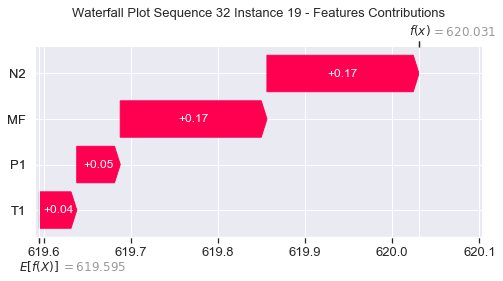

None

Contribution: [0.06514307 0.05697343 0.21320531 0.20788865]


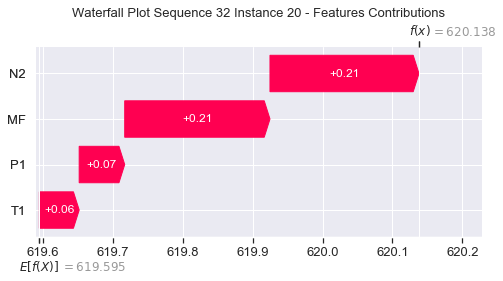

None

Contribution: [0.08198535 0.07082199 0.26508511 0.25938422]


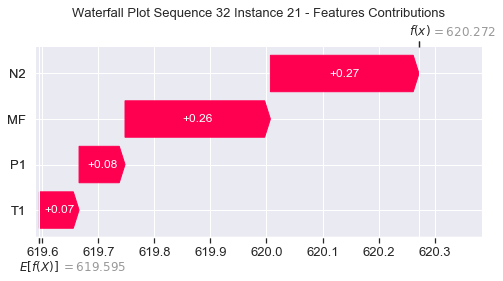

None

Contribution: [0.10547281 0.11540368 0.33574371 0.32419367]


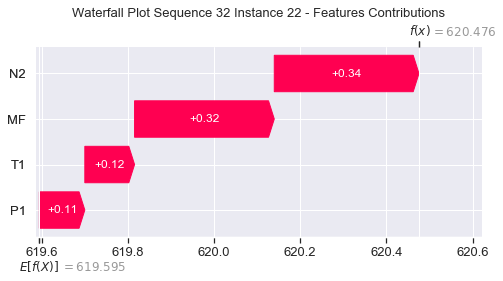

None

Contribution: [0.11997693 0.14553996 0.36976037 0.35608292]


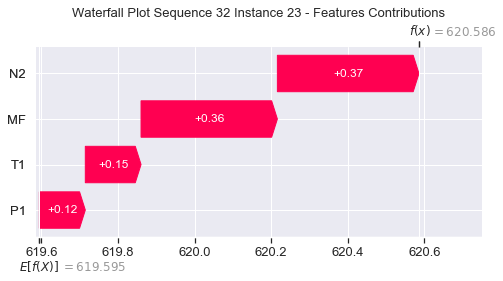

None

Contribution: [ 0.33061378 -0.84694206  1.21412348  1.33401279]


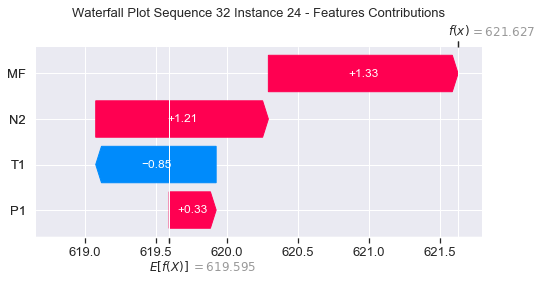

None

Contribution: [0.31912779 0.40859838 1.21346132 1.14792234]


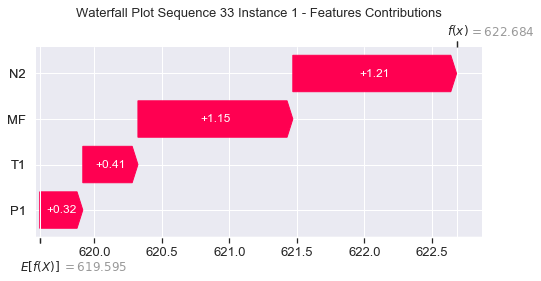

None

Contribution: [0.02860735 0.03988827 0.13070358 0.13419159]


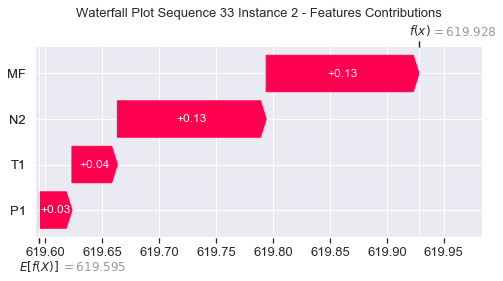

None

Contribution: [0.00201823 0.00366314 0.04732598 0.05504282]


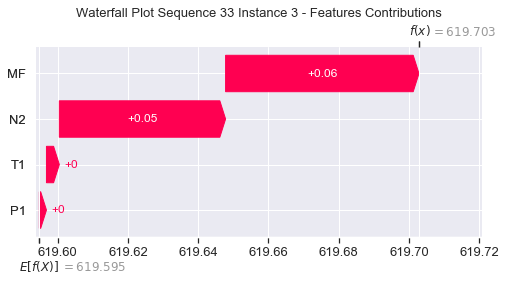

None

Contribution: [0.00577981 0.00630673 0.03243729 0.03359151]


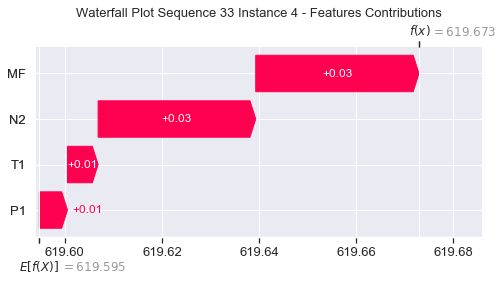

None

Contribution: [0.01131949 0.01006565 0.05042283 0.05016053]


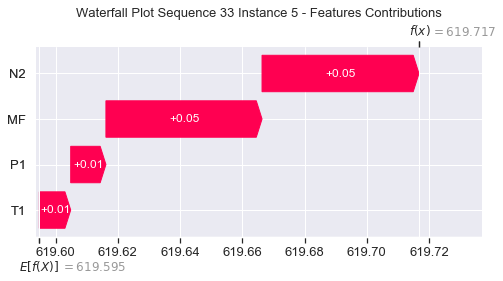

None

Contribution: [0.01346777 0.01119306 0.05566994 0.05567968]


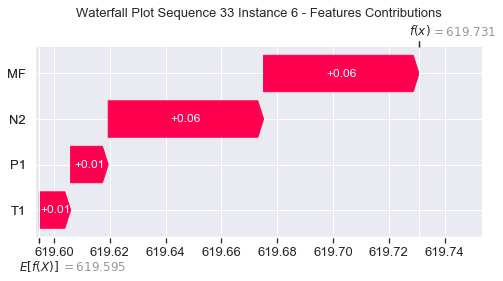

None

Contribution: [0.01452795 0.01159022 0.05860773 0.05806769]


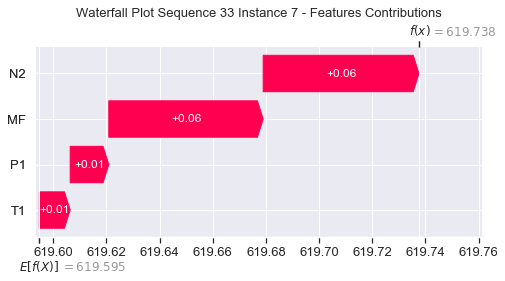

None

Contribution: [0.01518905 0.01197923 0.06026108 0.05958362]


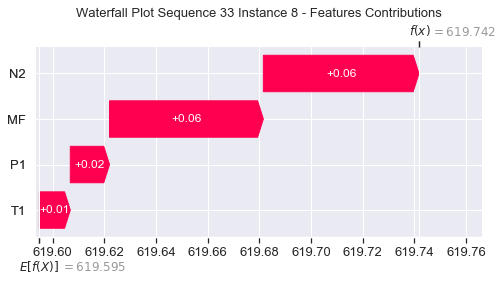

None

Contribution: [0.01476506 0.01221663 0.06098275 0.059587  ]


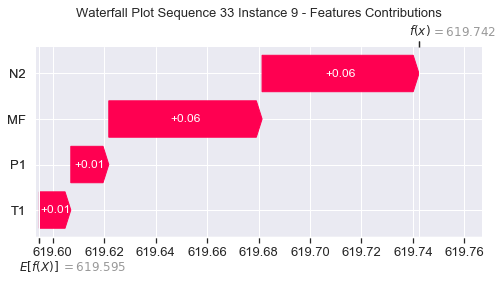

None

Contribution: [0.015474   0.01328782 0.0616687  0.05982665]


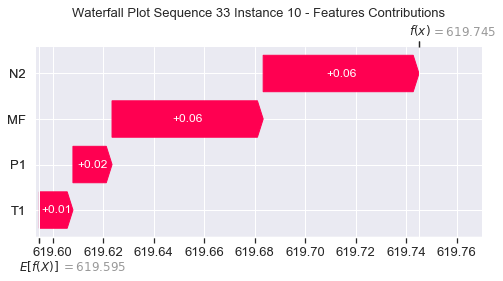

None

Contribution: [0.01643452 0.01359063 0.0640316  0.06360925]


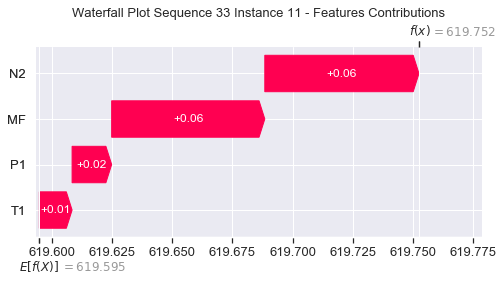

None

Contribution: [0.01812214 0.01347162 0.06741625 0.06610798]


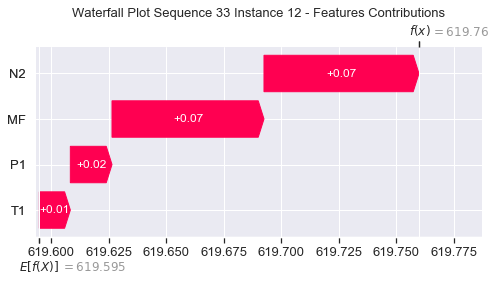

None

Contribution: [0.01986303 0.01514271 0.07323028 0.07120151]


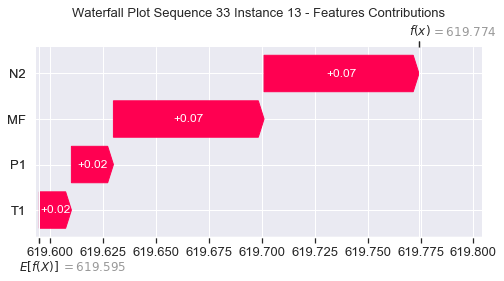

None

Contribution: [0.02235694 0.01710692 0.08095695 0.07764104]


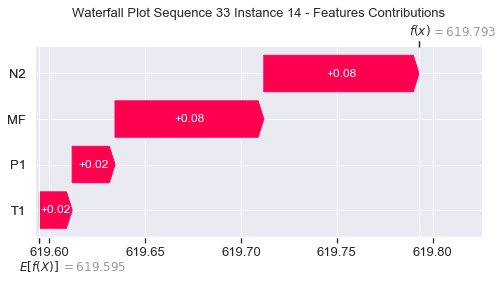

None

Contribution: [0.02582411 0.02006346 0.09183249 0.08918416]


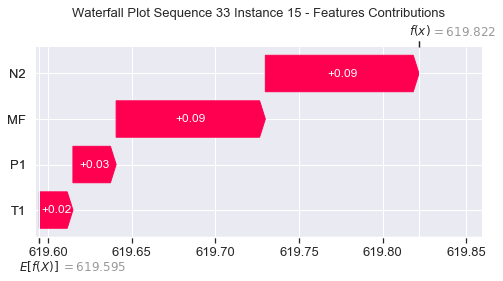

None

Contribution: [0.02969041 0.02476303 0.10510212 0.10118251]


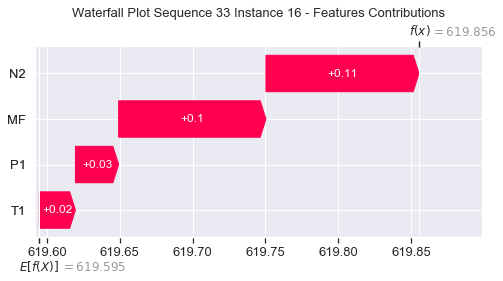

None

Contribution: [0.03555964 0.02831007 0.12278878 0.1188788 ]


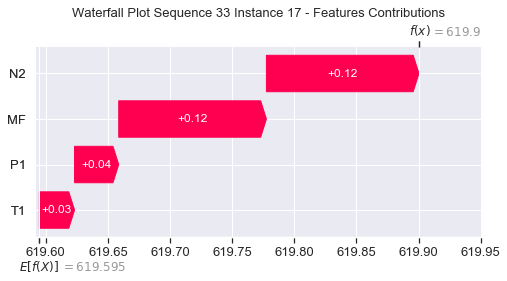

None

Contribution: [0.04277648 0.0344123  0.14507141 0.14087882]


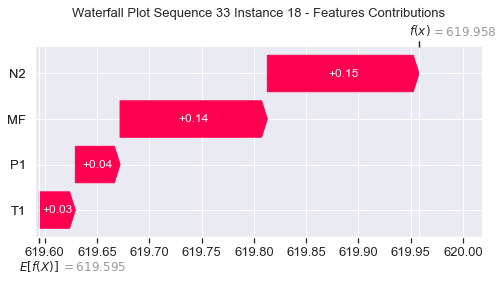

None

Contribution: [0.05061899 0.0421539  0.17407388 0.16621487]


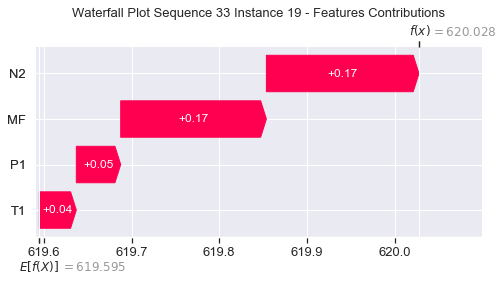

None

Contribution: [0.06301278 0.05167873 0.21175517 0.20476046]


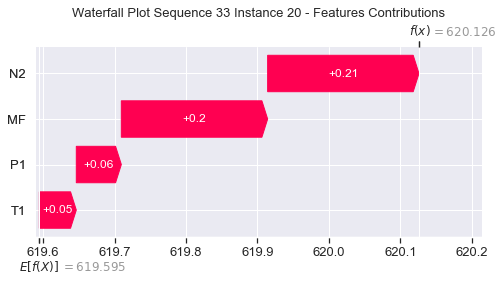

None

Contribution: [0.07902641 0.06295848 0.26312727 0.25547672]


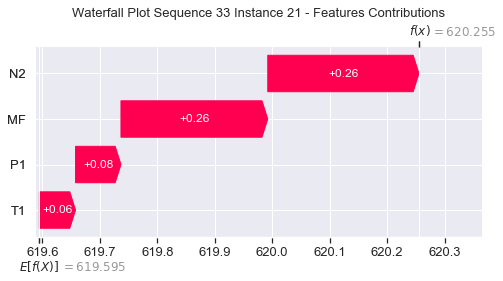

None

Contribution: [0.1039452  0.11166353 0.33585283 0.32373832]


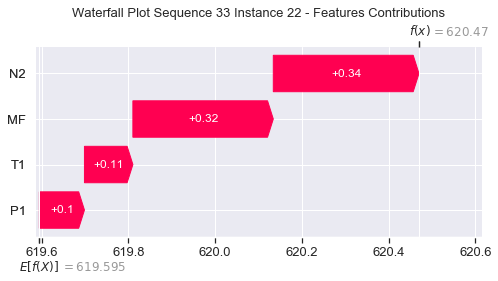

None

Contribution: [0.11941016 0.14420174 0.37092453 0.35722629]


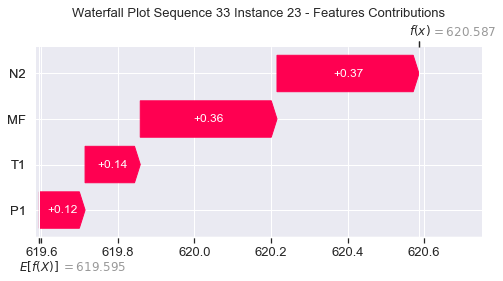

None

Contribution: [ 0.26802126 -1.0708243   1.11000215  1.34496721]


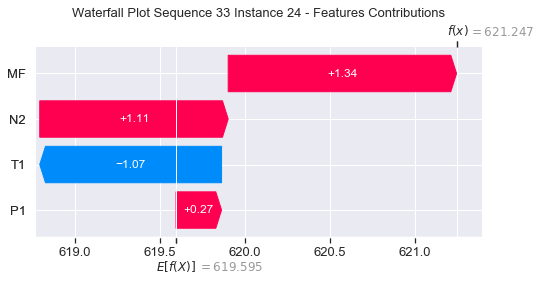

None

Contribution: [0.32439813 0.35891661 1.22402028 1.20488611]


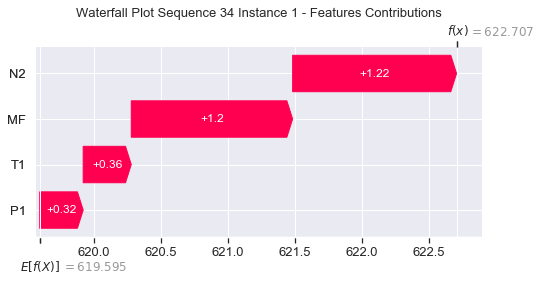

None

Contribution: [0.02466797 0.02475722 0.12791237 0.12921868]


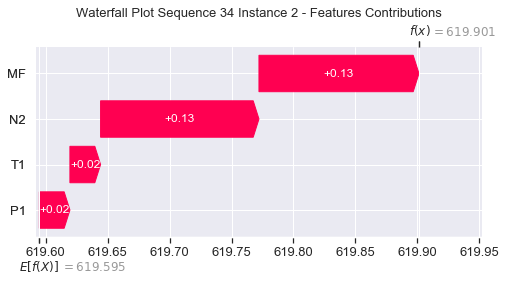

None

Contribution: [0.00244113 0.00131278 0.04798672 0.05746959]


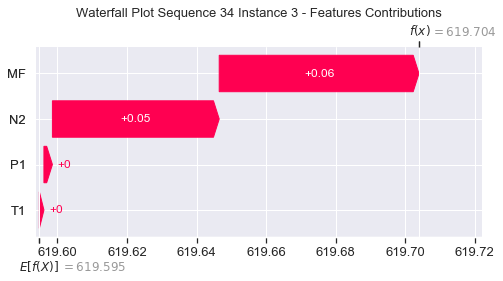

None

Contribution: [0.00553877 0.00477931 0.0322345  0.03368761]


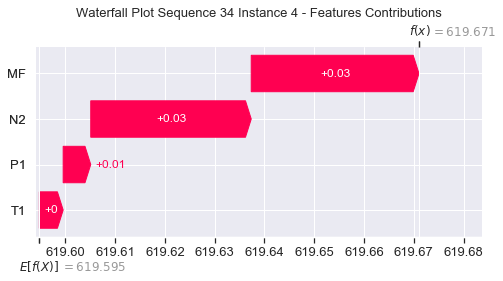

None

Contribution: [0.01121977 0.00882773 0.05035927 0.05014821]


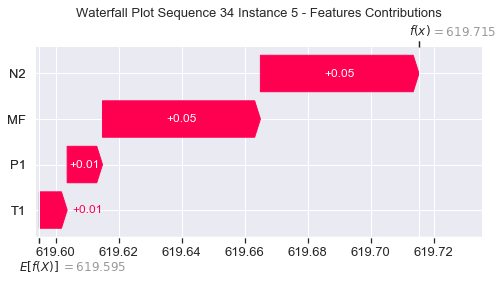

None

Contribution: [0.01305355 0.00978346 0.05568309 0.05543435]


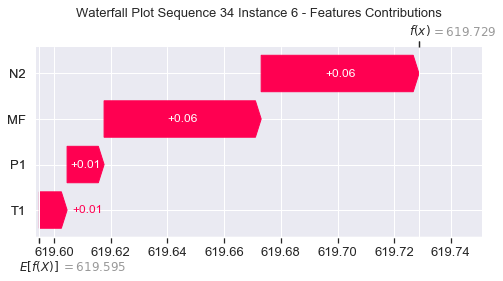

None

Contribution: [0.0141426  0.01027361 0.05858314 0.05800956]


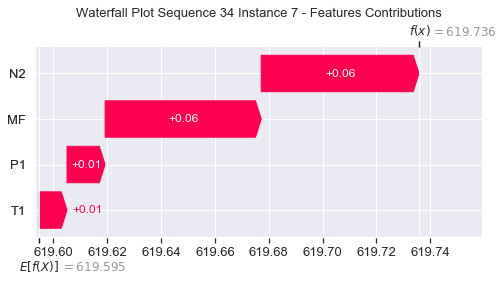

None

Contribution: [0.01472503 0.01049281 0.06020984 0.05933672]


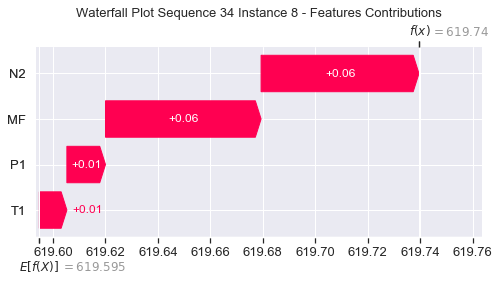

None

Contribution: [0.0145858  0.01064461 0.06113891 0.05994054]


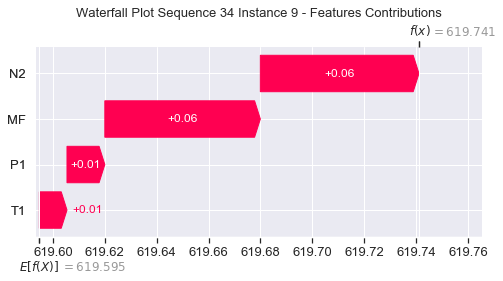

None

Contribution: [0.01478349 0.01070399 0.06212391 0.06088786]


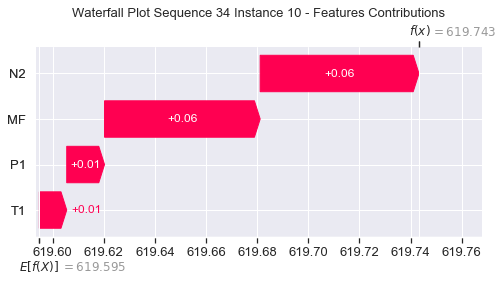

None

Contribution: [0.01535757 0.01154999 0.06401318 0.06243656]


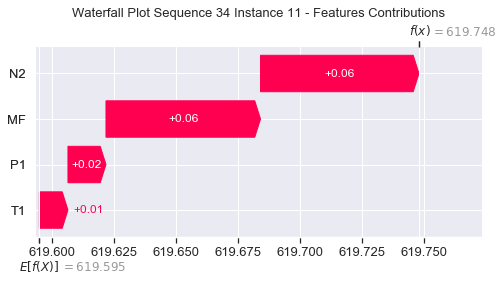

None

Contribution: [0.01681356 0.01254334 0.06737229 0.06518913]


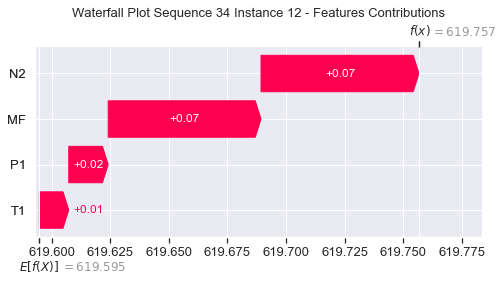

None

Contribution: [0.01867244 0.01415404 0.07318138 0.07053271]


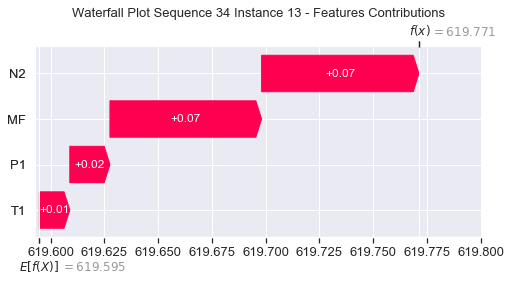

None

Contribution: [0.02005657 0.01563656 0.08114421 0.07656206]


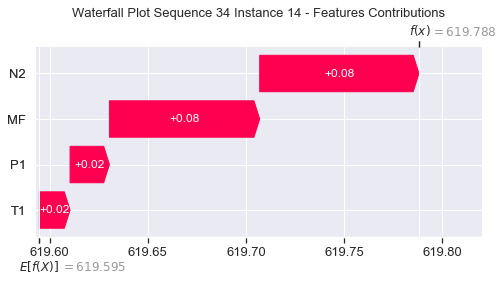

None

Contribution: [0.02449145 0.01893323 0.09176529 0.08833809]


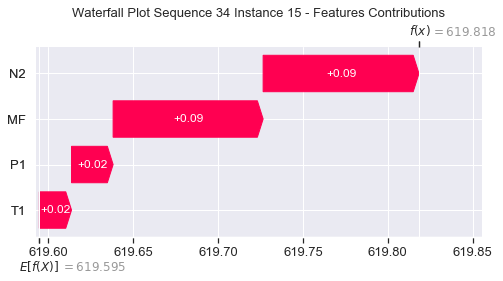

None

Contribution: [0.02956562 0.02112005 0.10587077 0.10298548]


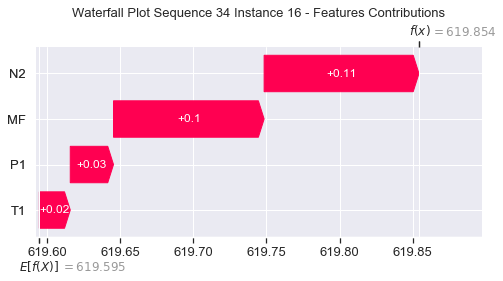

None

Contribution: [0.0341794  0.02709032 0.12293436 0.1185178 ]


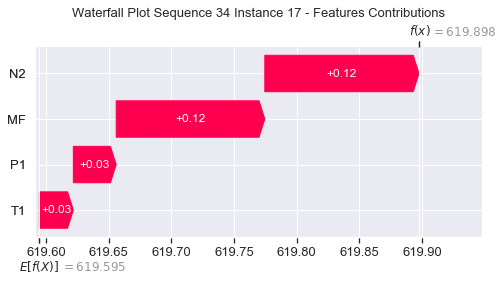

None

Contribution: [0.04114373 0.03285699 0.14532794 0.14034585]


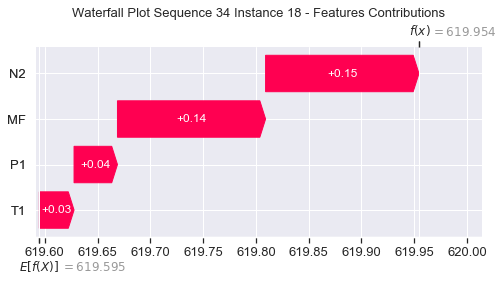

None

Contribution: [0.0486774  0.03845197 0.17475181 0.16666823]


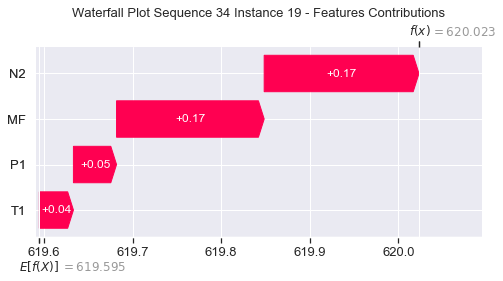

None

Contribution: [0.06246904 0.04941414 0.21219955 0.20554143]


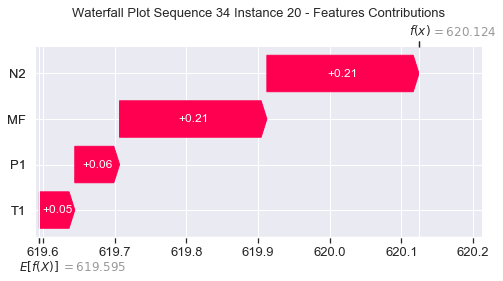

None

Contribution: [0.07795469 0.06053508 0.26375453 0.25588901]


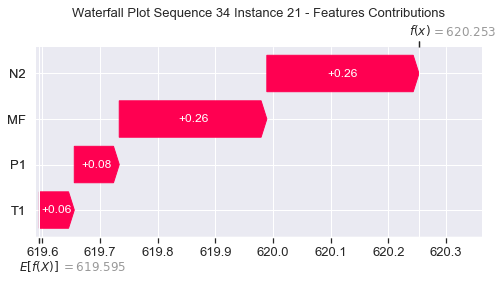

None

Contribution: [0.10320899 0.11065144 0.33644643 0.32380223]


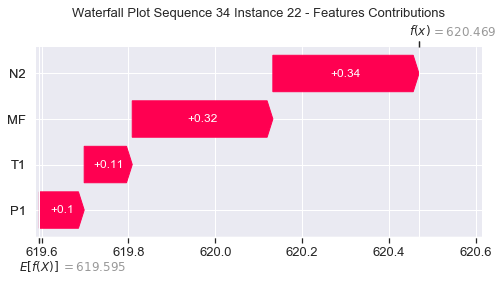

None

Contribution: [0.11861507 0.14352235 0.37192479 0.35792473]


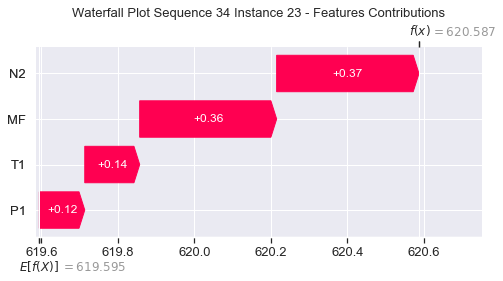

None

Contribution: [ 0.21705979 -1.21517395  1.11083882  1.27286483]


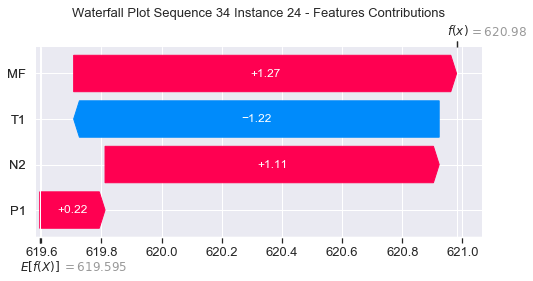

None

In [32]:
#Waterfall Plot for Local Accuracy & Consistency metrics

import seaborn as sns
sns.set()
instance = x_train
explainer = shap.DeepExplainer(model2,instance)
for s in range(0,34):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("Waterfall Plot Sequence %s " %(s+1)+"Instance %i - Features Contributions" %(j+1),fontsize=13)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)

In [33]:
#Define f''x

inputs = tf.keras.Input(shape=(24,3),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model3 = tf.keras.Model(inputs=inputs, outputs=layer4)
model3.summary()

Model: "functional_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 24, 3)]           0         
_________________________________________________________________
lstm_2 (LSTM)                (None, 24, 386)           602160    
_________________________________________________________________
dense_4 (Dense)              (None, 24, 486)           188082    
_________________________________________________________________
dense_5 (Dense)              (None, 24, 1)             487       
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 790,729
Trainable params: 790,729
Non-trainable params: 0
_________________________________________________________________


In [34]:
#Extract only weights for 3 variables excluding mf

a = model2.layers[1].get_weights()[0][0:3]
a = [a,model2.layers[1].get_weights()[1],model2.layers[1].get_weights()[2]]

In [35]:
#Transfer weights from f'x to f''x

model3.layers[0].set_weights(model2.layers[0].get_weights())
model3.layers[1].set_weights(a)
model3.layers[2].set_weights(model2.layers[2].get_weights())
model3.layers[3].set_weights(model2.layers[3].get_weights())
model3.layers[4].set_weights(model2.layers[4].get_weights())

In [36]:
#Load xtest and delete mf

xtrain_file = "xtrain.csv"
xtrain = pd.read_csv(xtrain_file, index_col=False)
xtrain = xtrain.drop(['MF'],axis=1)

#Load xtest and delete mf

xtest_file = "xtest.csv"
xtest = pd.read_csv(xtest_file, index_col=False)
xtest = xtest.drop(['MF'],axis=1)

#Xtest to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,3)

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,3)

In [37]:
#Prediction with features excluding mf 

preds3 = model3(xtest)
y4 = preds3
y4 = tf.keras.backend.get_value(y4)
tens_draw4 = y4

In [38]:
#Extract Feature Names

features = pd.read_csv(xtrain_file, index_col=False)
features = features.drop(['MF'],axis=1)
features = np.array(list(features.columns))
features

array(['P1', 'T1', 'N2'], dtype='<U2')

Contribution: [ 0.0168732   0.28137134 -0.02213153]


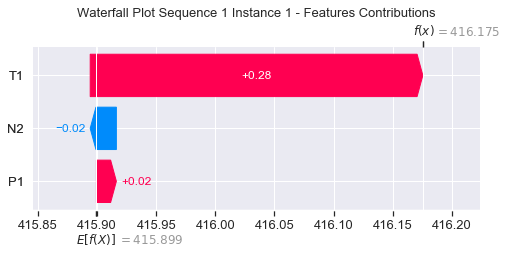

None

Contribution: [0.00207937 0.03059287 0.00063527]


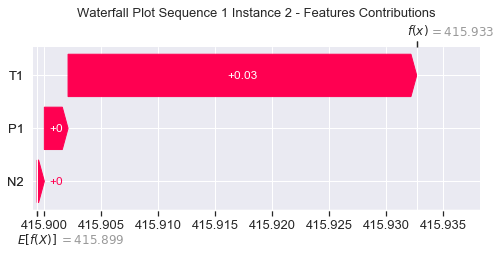

None

Contribution: [ 0.002119    0.01086536 -0.00512182]


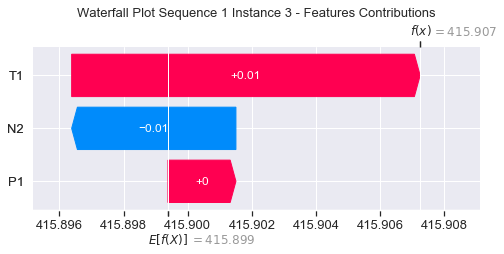

None

Contribution: [0.00500677 0.01058001 0.00282803]


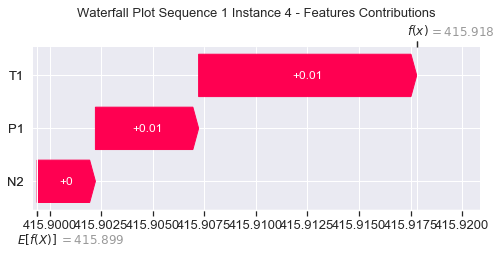

None

Contribution: [0.00779561 0.01128126 0.00870795]


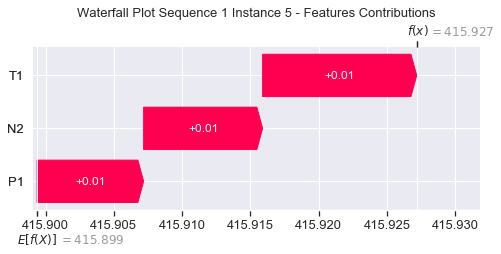

None

Contribution: [0.00898476 0.0156558  0.01191757]


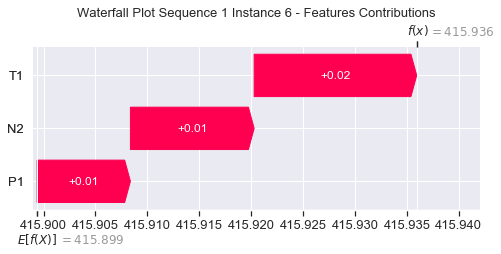

None

Contribution: [0.01151645 0.01814348 0.01593053]


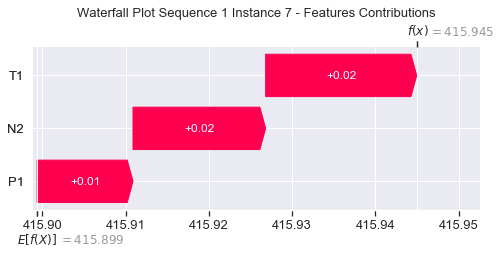

None

Contribution: [0.01332894 0.02100848 0.02078618]


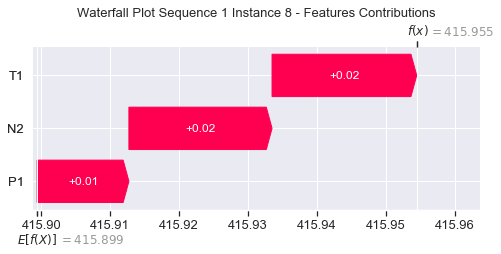

None

Contribution: [0.0162946  0.01500098 0.0259079 ]


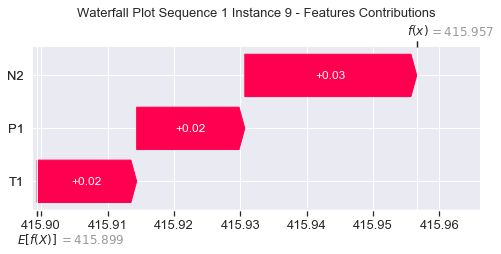

None

Contribution: [0.02121118 0.02158884 0.03252235]


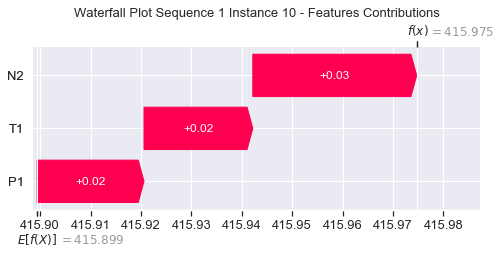

None

Contribution: [0.01912385 0.02368395 0.03903238]


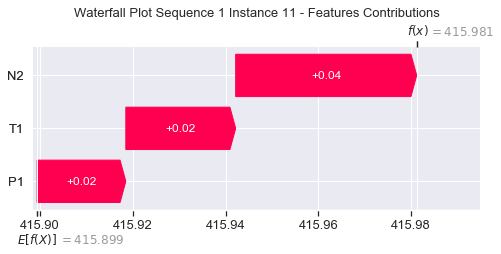

None

Contribution: [0.02303041 0.03148102 0.04740462]


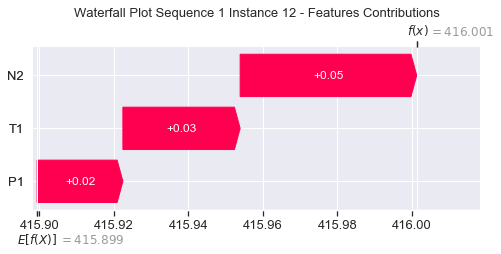

None

Contribution: [0.02453048 0.02932723 0.05557151]


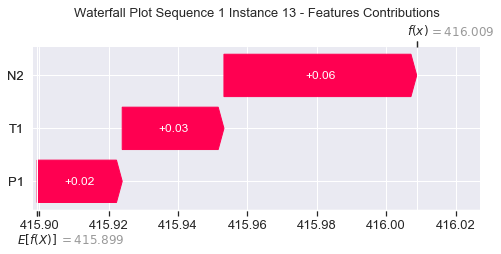

None

Contribution: [0.02321177 0.02701498 0.0653768 ]


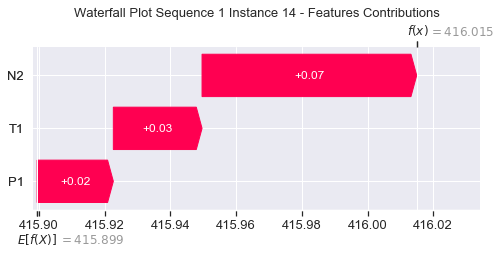

None

Contribution: [0.02612107 0.02156037 0.07737131]


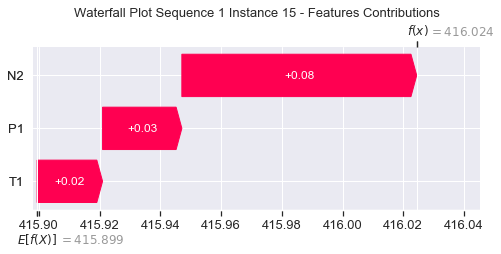

None

Contribution: [0.0243922  0.01330981 0.09333895]


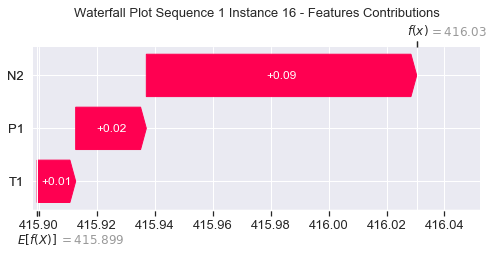

None

Contribution: [ 0.02372938 -0.00104036  0.11281262]


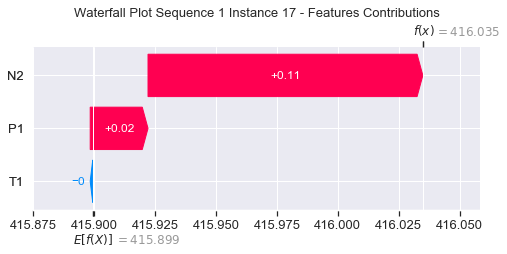

None

Contribution: [ 0.01897132 -0.03099681  0.13860377]


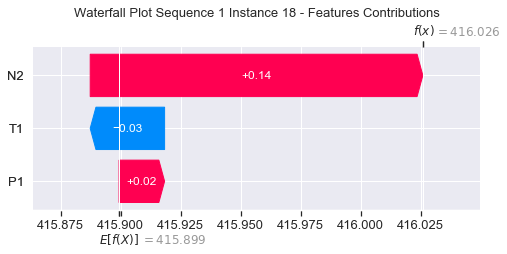

None

Contribution: [-0.0229794  -0.09033194  0.17687163]


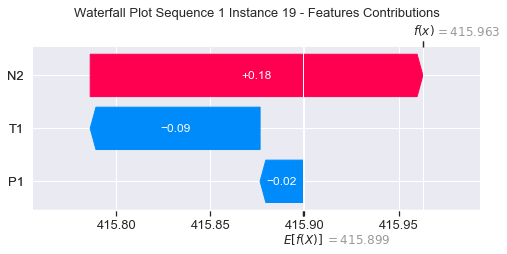

None

Contribution: [-0.01564625 -0.1456028   0.22483279]


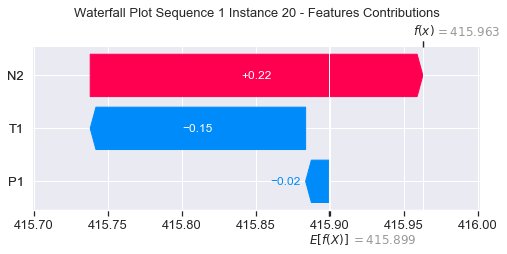

None

Contribution: [-0.05285045 -0.30112488  0.30431698]


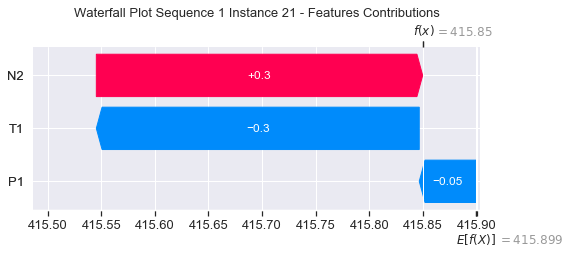

None

Contribution: [-0.18817621 -0.71062998  0.50865325]


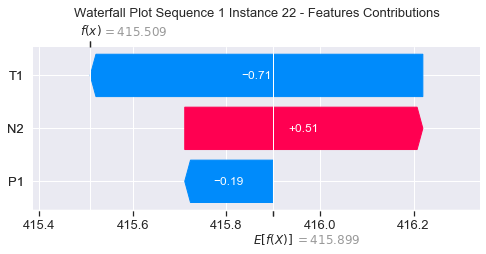

None

Contribution: [-0.26692864 -0.83389793  0.61017536]


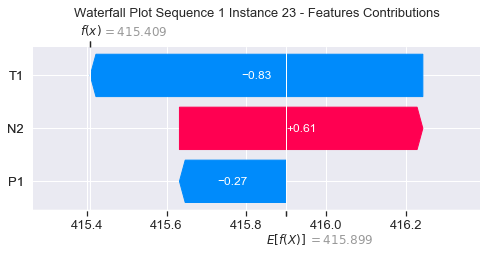

None

Contribution: [-0.69648537 -3.16762569  1.89171518]


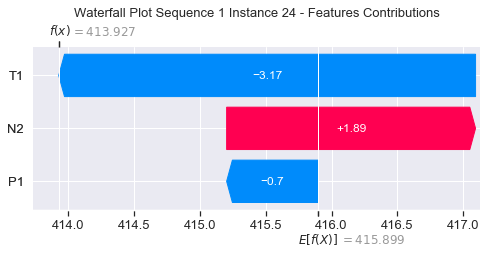

None

Contribution: [ 0.01491252  0.26403196 -0.01440446]


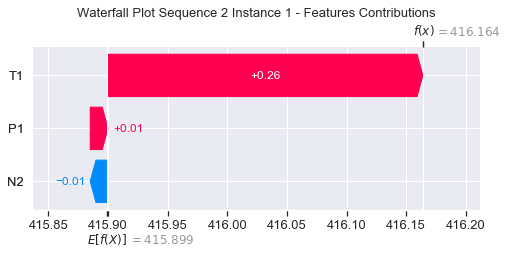

None

Contribution: [0.00218696 0.02904012 0.00139011]


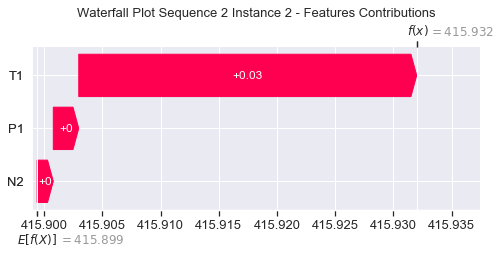

None

Contribution: [ 0.00218196  0.01084024 -0.00334425]


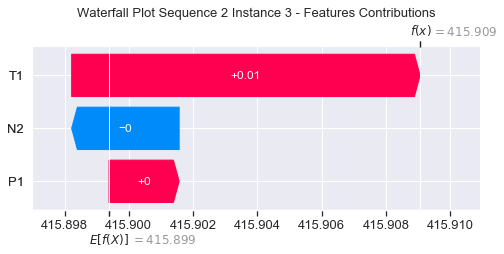

None

Contribution: [0.00604321 0.01039496 0.00494703]


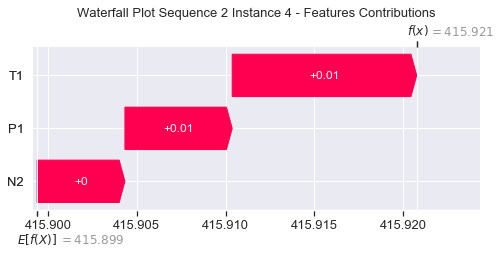

None

Contribution: [0.00880079 0.02552871 0.00923368]


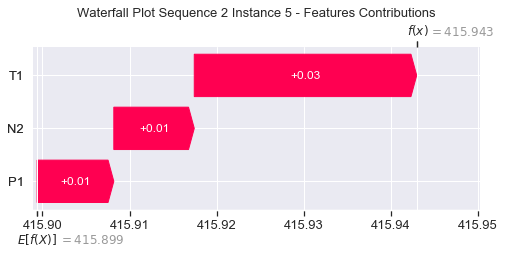

None

Contribution: [0.01133203 0.03681677 0.01296115]


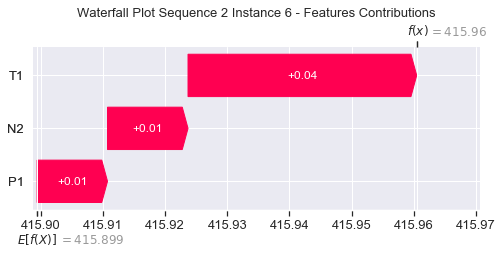

None

Contribution: [0.01363823 0.04499305 0.01677494]


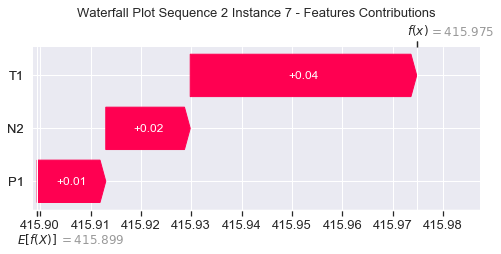

None

Contribution: [0.01609211 0.05025517 0.02168413]


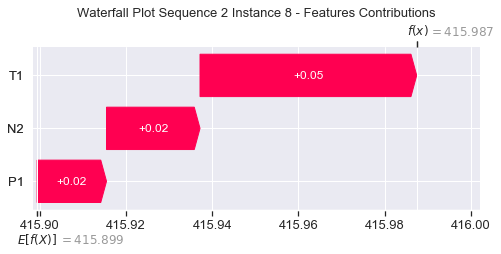

None

Contribution: [0.01940631 0.05615098 0.02426459]


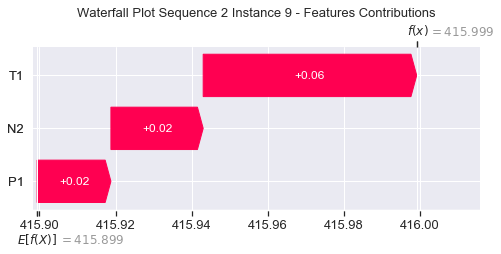

None

Contribution: [0.02387811 0.05781171 0.02964056]


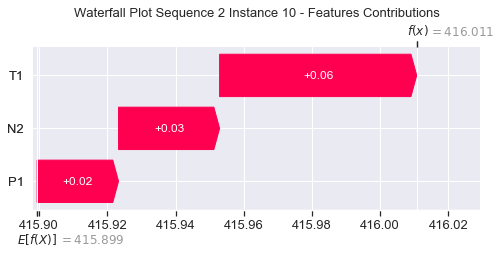

None

Contribution: [0.02416697 0.05676075 0.03901212]


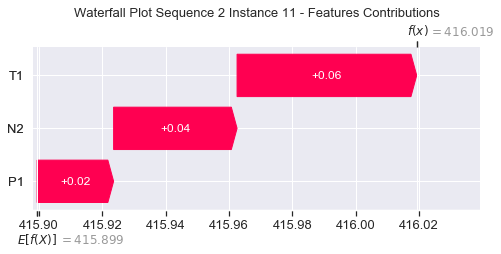

None

Contribution: [0.02473611 0.05686625 0.04847305]


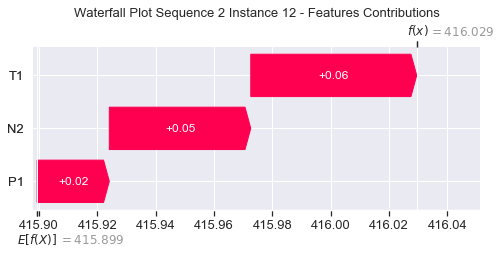

None

Contribution: [0.02556604 0.04524727 0.05615049]


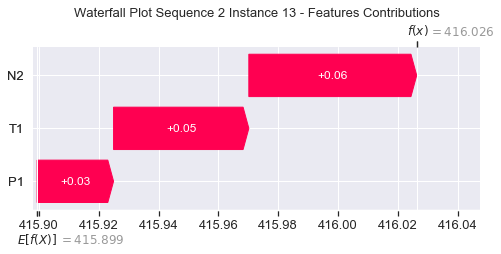

None

Contribution: [0.02592068 0.02729814 0.06570068]


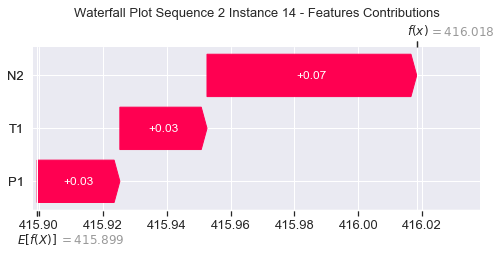

None

Contribution: [ 0.02559343 -0.00305072  0.07731364]


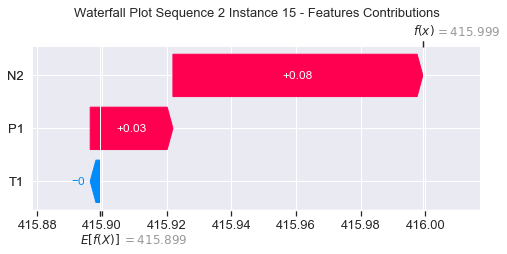

None

Contribution: [ 0.02152732 -0.04902702  0.09297253]


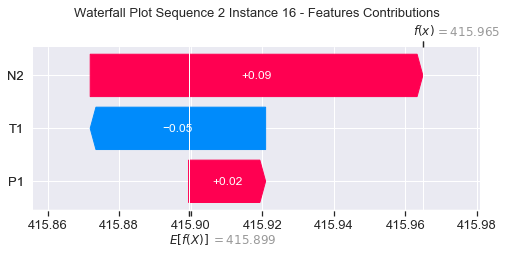

None

Contribution: [ 0.01852154 -0.13203361  0.11207963]


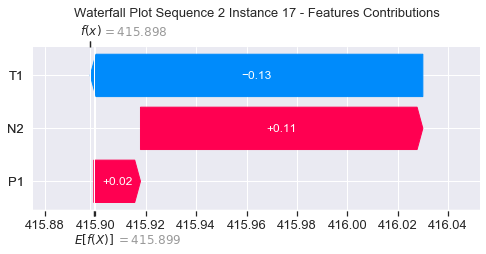

None

Contribution: [ 0.00810091 -0.2585763   0.13691601]


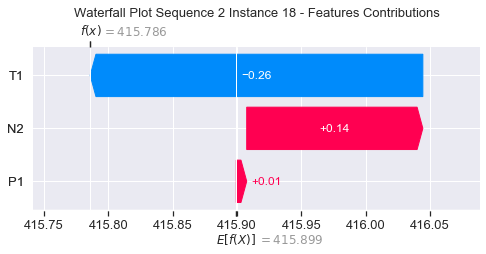

None

Contribution: [-0.02035871 -0.44939411  0.17194769]


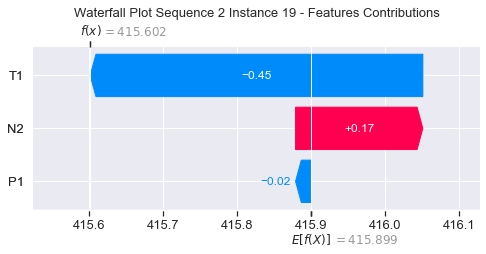

None

Contribution: [-0.03991542 -0.76406426  0.22757659]


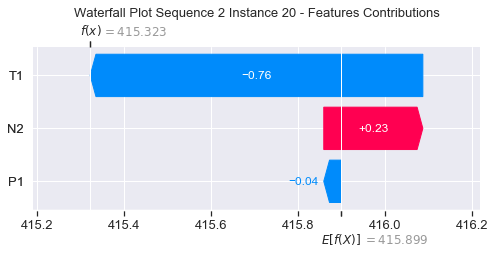

None

Contribution: [-0.09118283 -1.30238297  0.30923602]


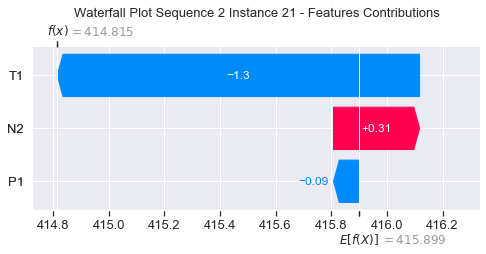

None

Contribution: [-0.27714119 -2.79862293  0.5135127 ]


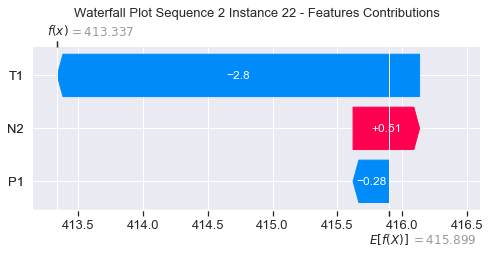

None

Contribution: [-0.37606942 -2.99291123  0.61060418]


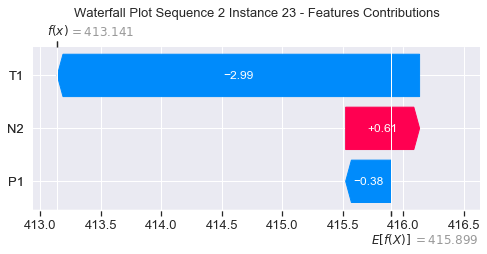

None

Contribution: [ -1.37496426 -11.40526136   1.88352719]


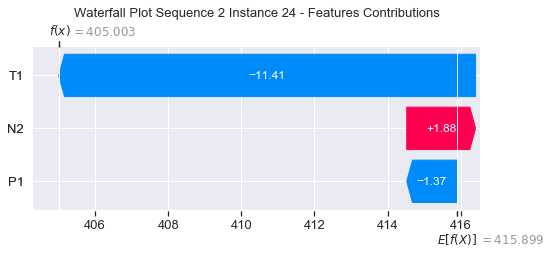

None

Contribution: [ 0.02505867  0.36099835 -0.01400082]


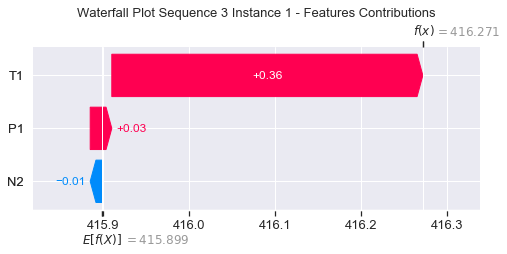

None

Contribution: [0.00200765 0.03169343 0.00156708]


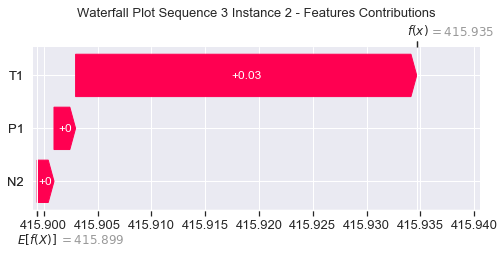

None

Contribution: [ 0.0034122   0.03031672 -0.00323868]


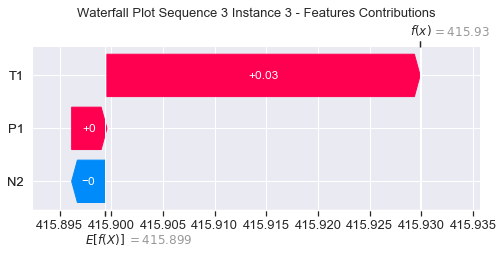

None

Contribution: [0.00545891 0.02967567 0.00440138]


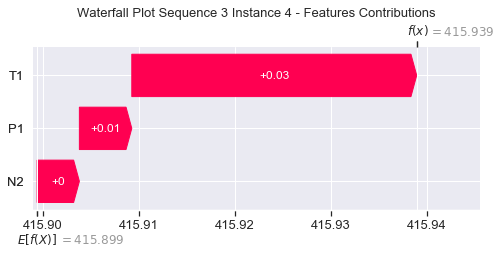

None

Contribution: [0.00908907 0.03729678 0.01055613]


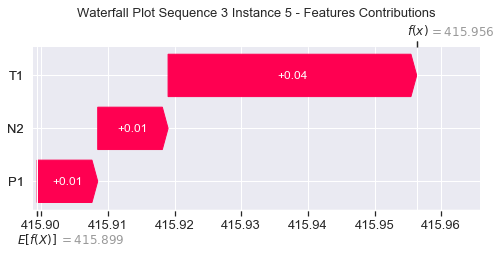

None

Contribution: [0.01172199 0.04533668 0.01384098]


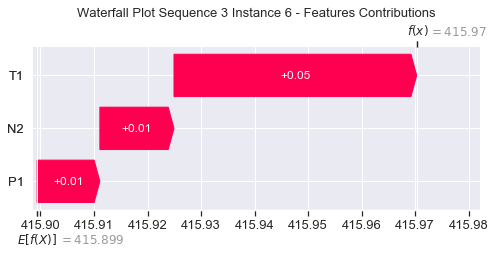

None

Contribution: [0.01429027 0.05325253 0.01799933]


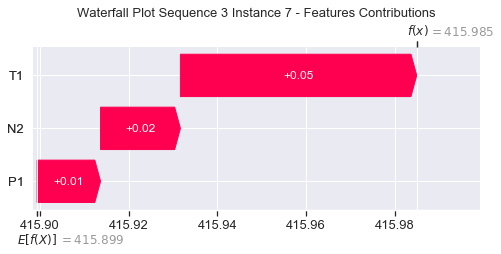

None

Contribution: [0.01641183 0.05829926 0.0227734 ]


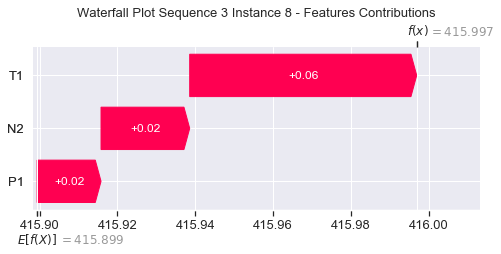

None

Contribution: [0.02097424 0.05620391 0.02747959]


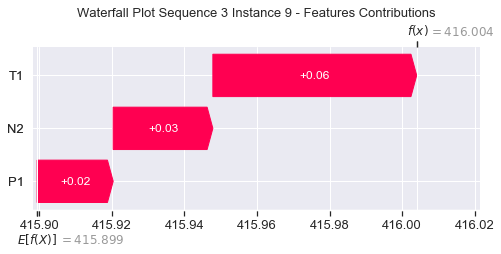

None

Contribution: [0.02293238 0.05014709 0.03177368]


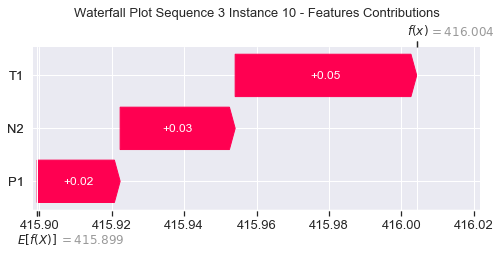

None

Contribution: [0.02333259 0.05405319 0.03959845]


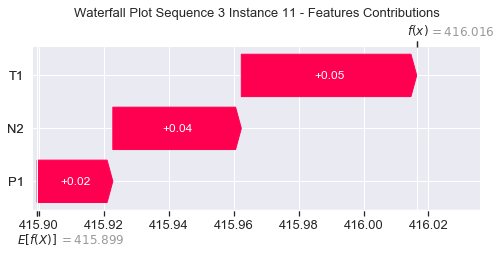

None

Contribution: [0.02316571 0.0571031  0.04751497]


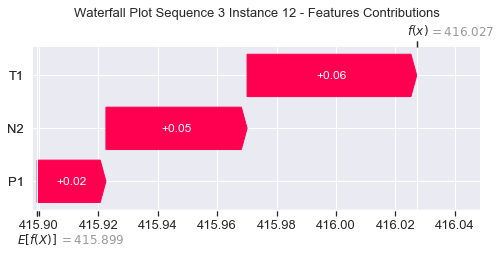

None

Contribution: [0.02462846 0.04597648 0.05559255]


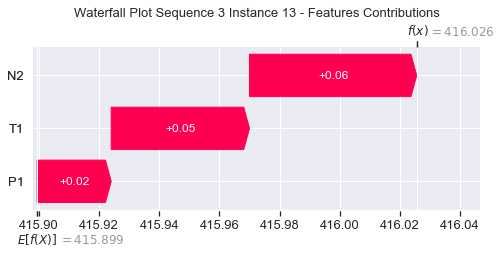

None

Contribution: [0.0271034  0.02719562 0.06471449]


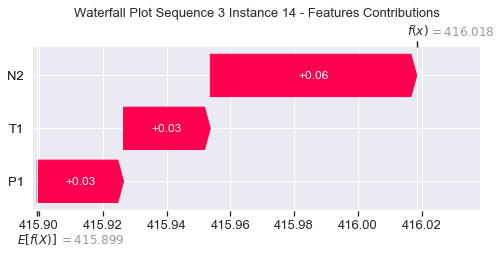

None

Contribution: [ 0.02552527 -0.00391886  0.07690527]


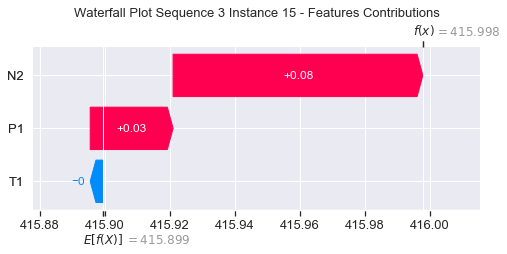

None

Contribution: [ 0.02432094 -0.05060687  0.09355031]


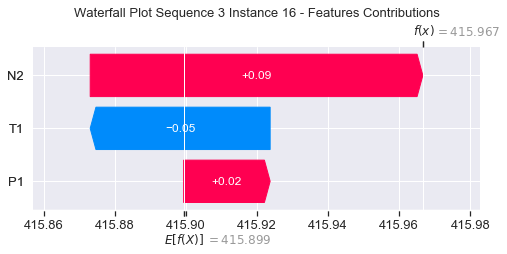

None

Contribution: [ 0.019029   -0.13365695  0.11257152]


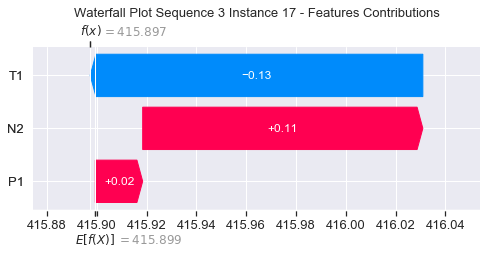

None

Contribution: [ 0.00962853 -0.26202823  0.13952705]


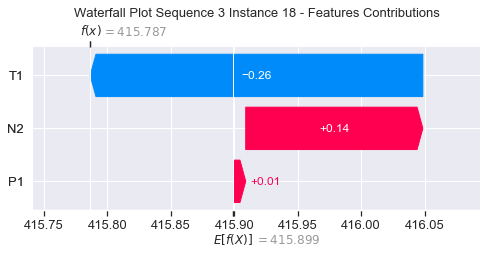

None

Contribution: [-0.00769102 -0.50455254  0.1825804 ]


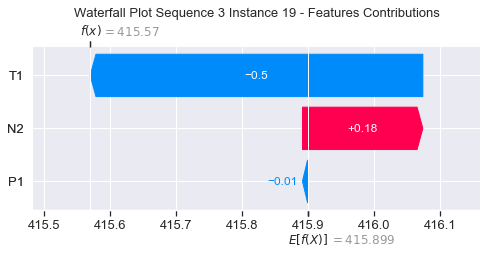

None

Contribution: [-0.04128071 -0.82709803  0.2298681 ]


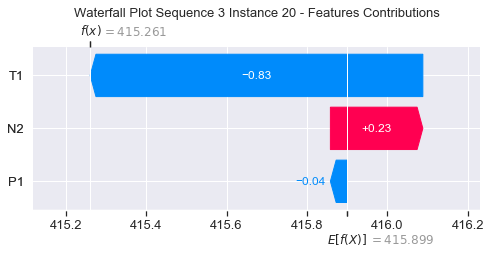

None

Contribution: [-0.08599409 -1.39823334  0.31816148]


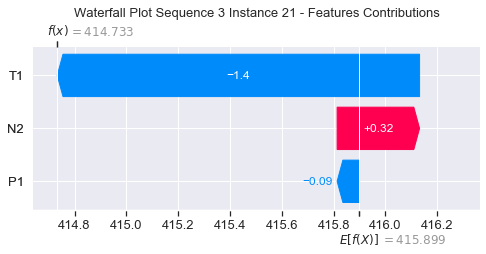

None

Contribution: [-0.24928668 -3.04003235  0.54778507]


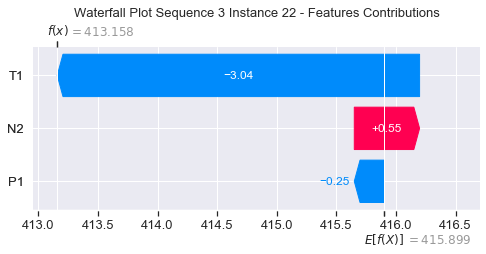

None

Contribution: [-0.32959678 -3.12605276  0.67164664]


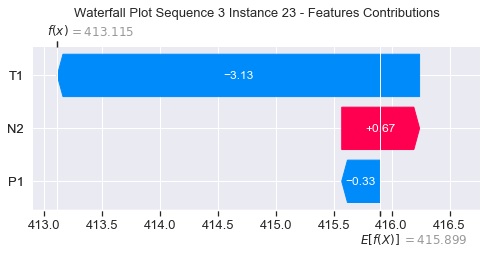

None

Contribution: [ -1.09528582 -12.61273813   2.03572658]


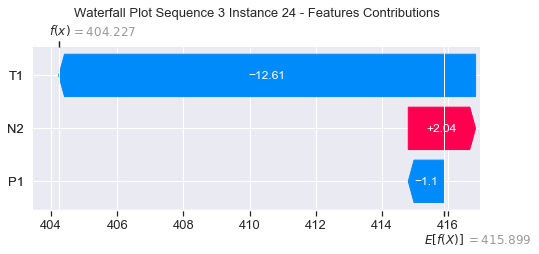

None

Contribution: [ 0.01750395  0.3741643  -0.01365424]


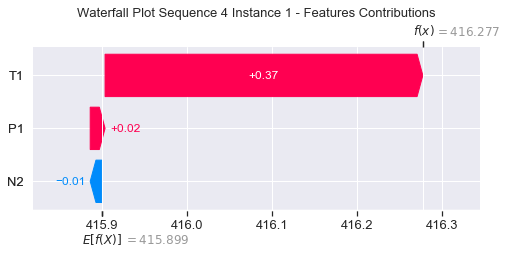

None

Contribution: [0.00195847 0.0318195  0.00134181]


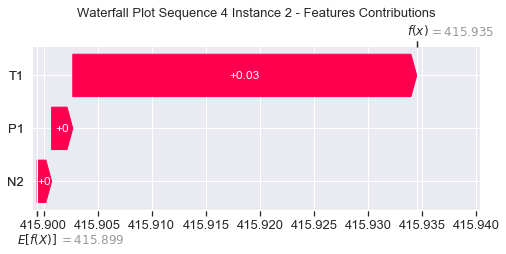

None

Contribution: [ 0.00424887  0.02957557 -0.00338708]


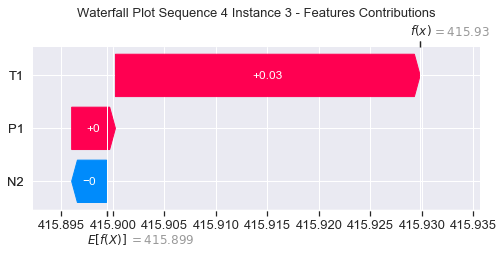

None

Contribution: [0.00490863 0.02786586 0.00441584]


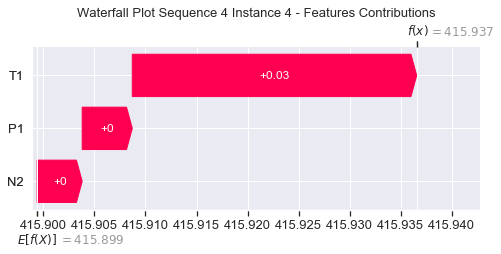

None

Contribution: [0.00859093 0.03912741 0.01031407]


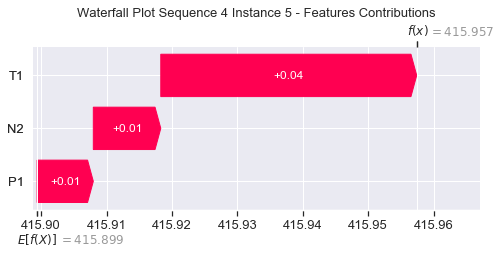

None

Contribution: [0.01055901 0.0503066  0.01341375]


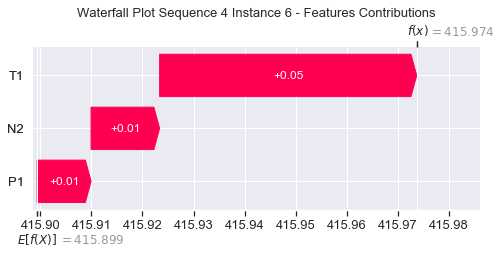

None

Contribution: [0.0127195 0.058483  0.0175305]


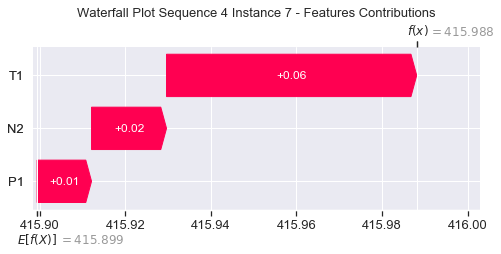

None

Contribution: [0.01541118 0.06432043 0.02226851]


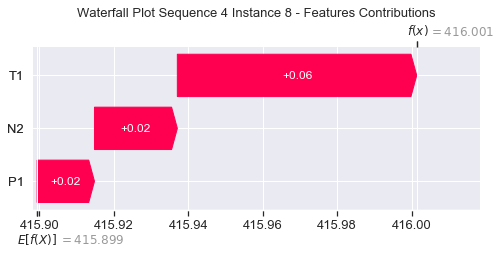

None

Contribution: [0.02179183 0.06418833 0.02645039]


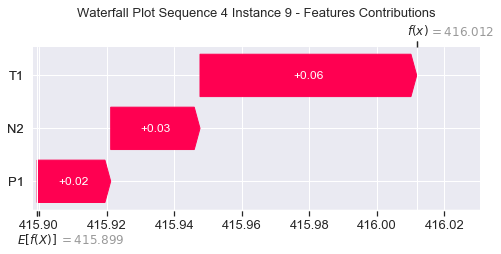

None

Contribution: [0.02186335 0.06808641 0.03178165]


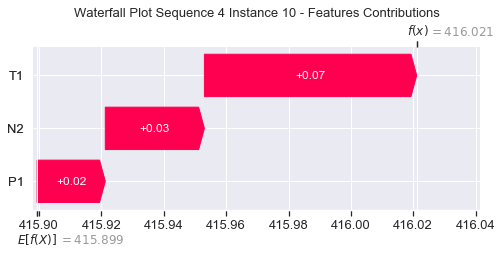

None

Contribution: [0.02580731 0.06363301 0.03887458]


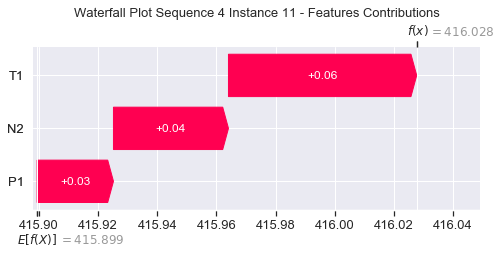

None

Contribution: [0.02337123 0.06083029 0.04742659]


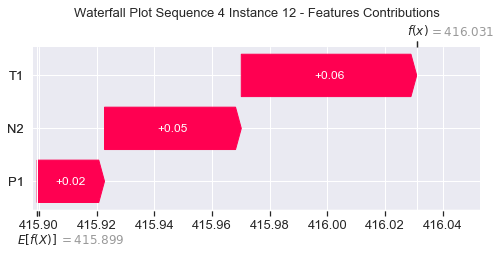

None

Contribution: [0.02451105 0.04793847 0.05546052]


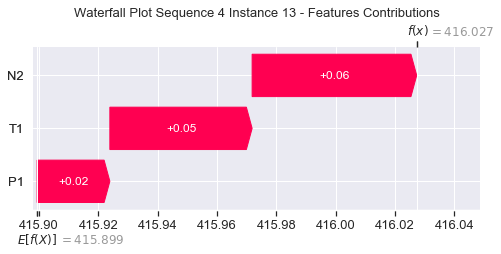

None

Contribution: [0.02595245 0.02691105 0.0641884 ]


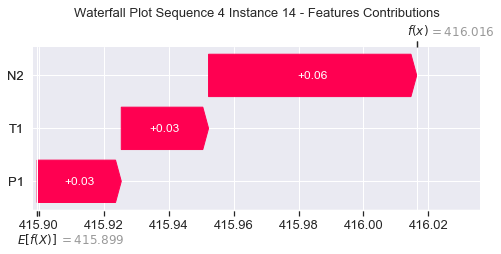

None

Contribution: [ 0.02542982 -0.00784936  0.07692895]


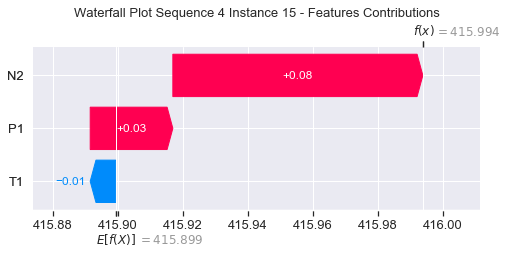

None

Contribution: [ 0.02190734 -0.05974779  0.09289994]


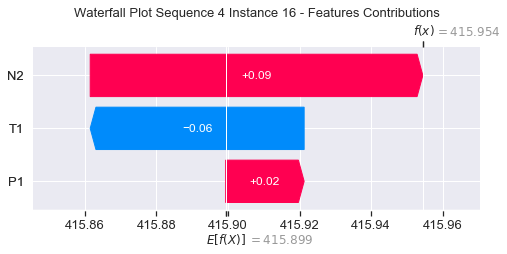

None

Contribution: [ 0.02033786 -0.15106712  0.11316657]


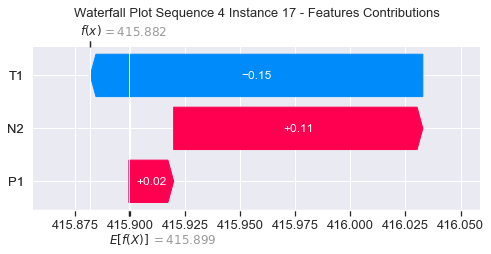

None

Contribution: [ 0.0122393  -0.29361059  0.14079104]


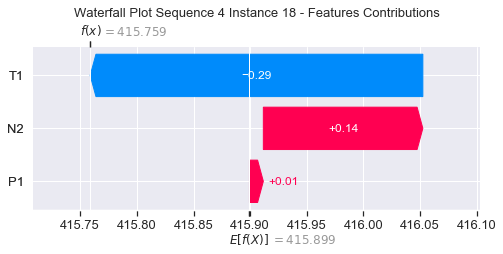

None

Contribution: [-0.00367917 -0.50810907  0.17727679]


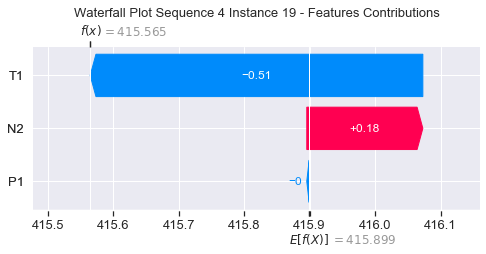

None

Contribution: [-0.03155468 -0.89281555  0.23415986]


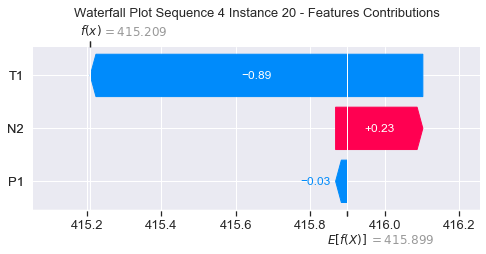

None

Contribution: [-0.07927792 -1.49434033  0.32391319]


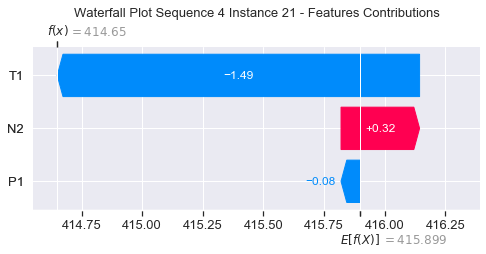

None

Contribution: [-0.25578928 -3.23581897  0.55452072]


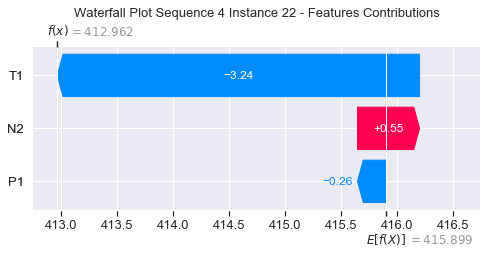

None

Contribution: [-0.33689874 -3.37141754  0.67968848]


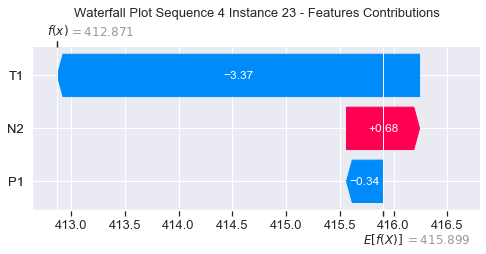

None

Contribution: [ -1.24576569 -13.47765233   2.12835298]


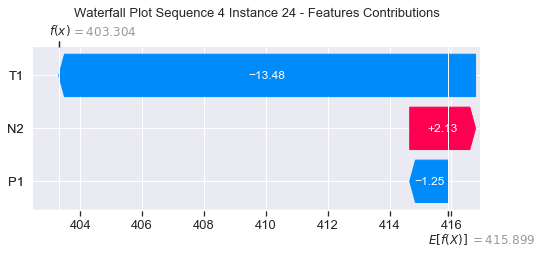

None

Contribution: [ 0.02364568  0.37925642 -0.01700172]


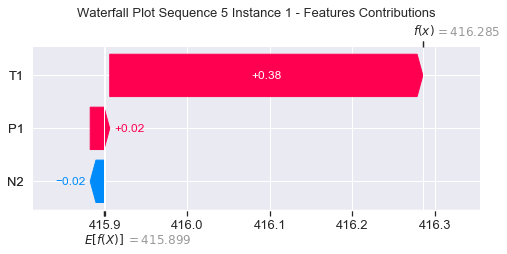

None

Contribution: [0.00200191 0.03199273 0.00143199]


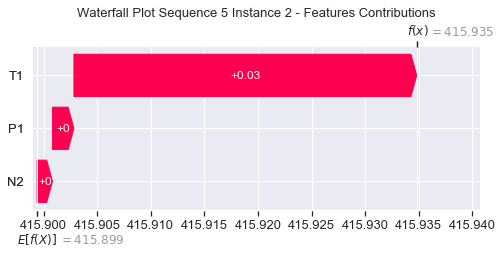

None

Contribution: [ 0.0043648   0.03061256 -0.00309381]


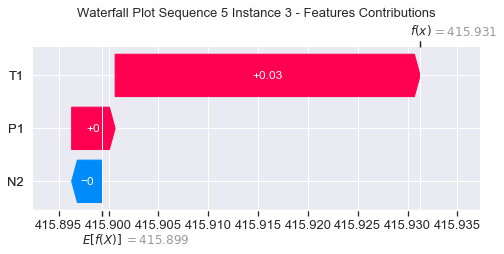

None

Contribution: [0.00652693 0.02794171 0.004546  ]


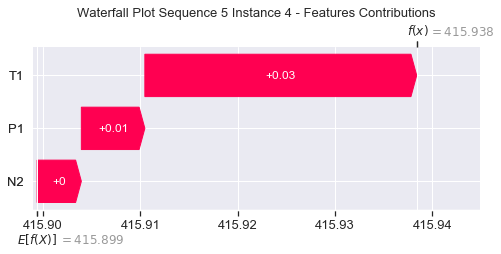

None

Contribution: [0.0103497  0.03846484 0.01053866]


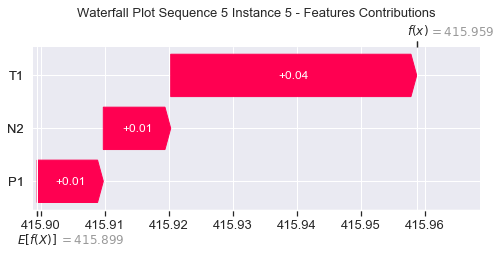

None

Contribution: [0.01245081 0.04689981 0.01384398]


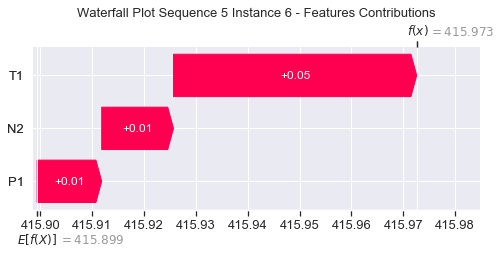

None

Contribution: [0.01505184 0.05512689 0.01815539]


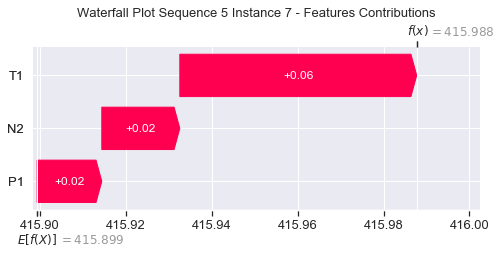

None

Contribution: [0.01735012 0.06006121 0.02291387]


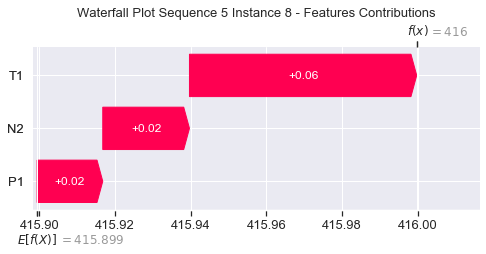

None

Contribution: [0.02171832 0.05999873 0.02806137]


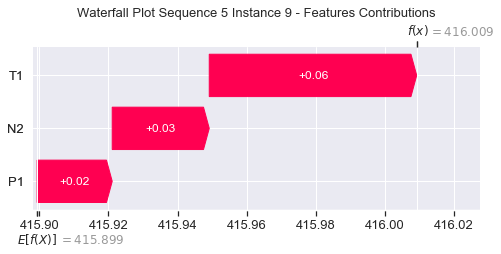

None

Contribution: [0.0277161  0.06055893 0.03329312]


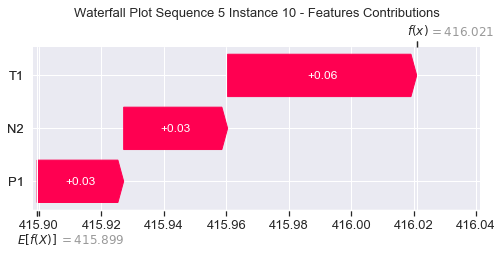

None

Contribution: [0.02531704 0.0561463  0.03998441]


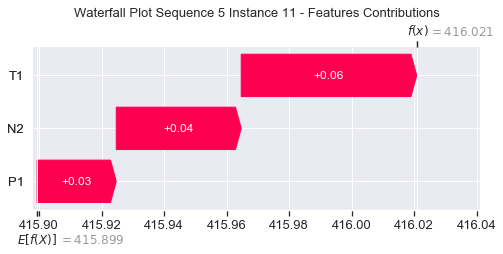

None

Contribution: [0.0251854  0.05745649 0.04785577]


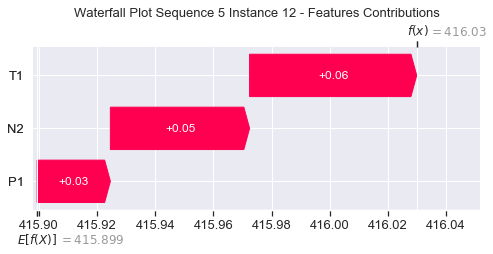

None

Contribution: [0.02600906 0.04644706 0.05595659]


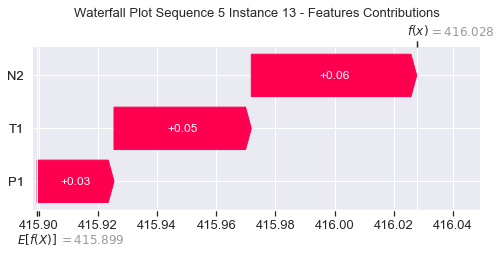

None

Contribution: [0.02539347 0.02767213 0.06427415]


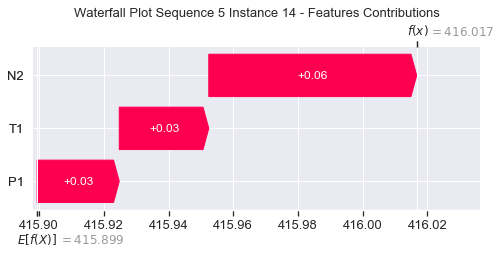

None

Contribution: [ 0.02568985 -0.00266605  0.07729003]


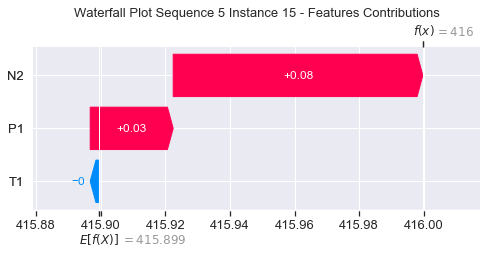

None

Contribution: [ 0.02453297 -0.05198214  0.09480907]


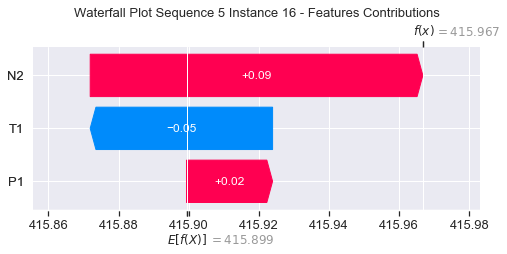

None

Contribution: [ 0.01961184 -0.12840616  0.11316339]


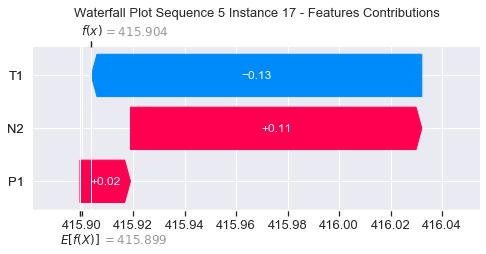

None

Contribution: [ 0.01201082 -0.25030565  0.14041762]


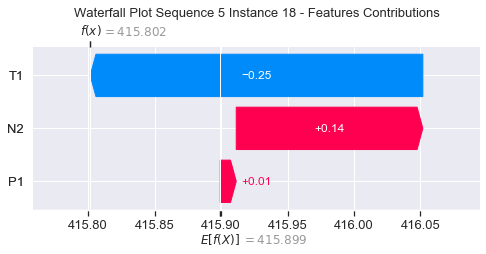

None

Contribution: [-0.01251802 -0.48657546  0.16947277]


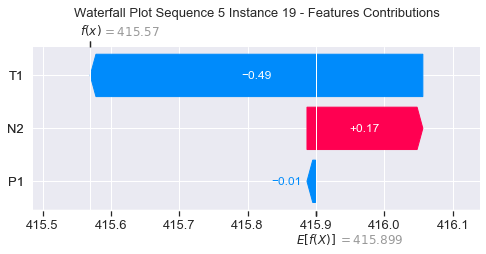

None

Contribution: [-0.02722438 -0.78530504  0.2311537 ]


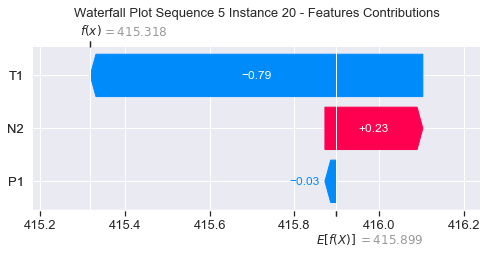

None

Contribution: [-0.06800397 -1.31834826  0.32137409]


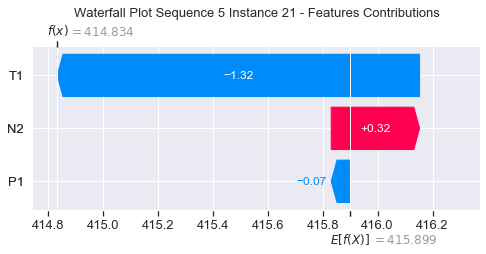

None

Contribution: [-0.22093091 -2.82526694  0.55700338]


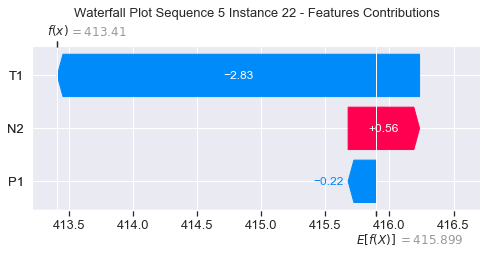

None

Contribution: [-0.28990405 -2.90181847  0.67916431]


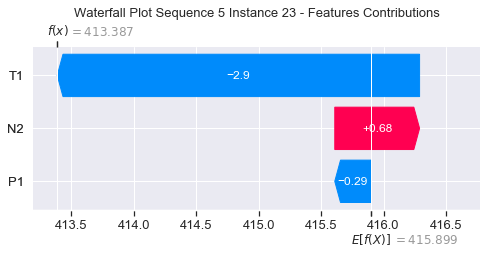

None

Contribution: [ -0.89112233 -11.63706941   2.12994021]


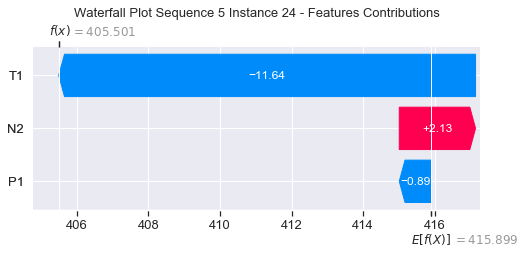

None

Contribution: [ 0.01636642  0.36296398 -0.01623746]


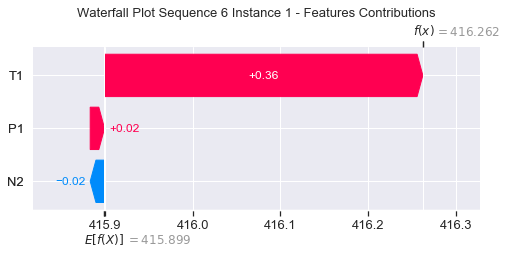

None

Contribution: [0.00196088 0.03137178 0.00120095]


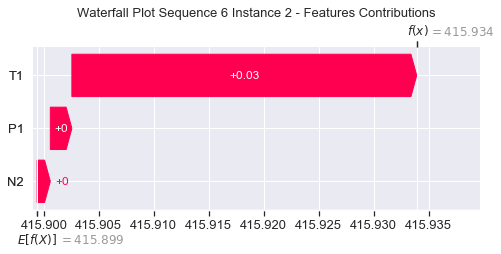

None

Contribution: [ 0.00363917  0.02540358 -0.00394044]


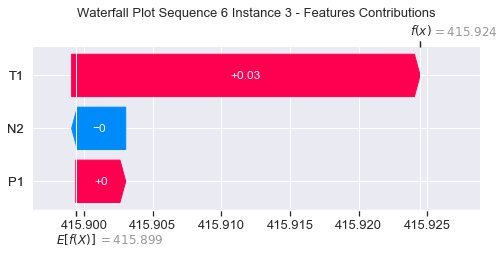

None

Contribution: [0.00551526 0.02568156 0.0039186 ]


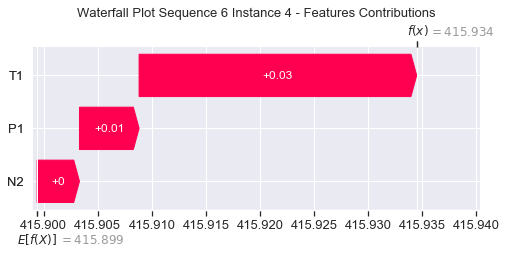

None

Contribution: [0.00882605 0.03259489 0.00959461]


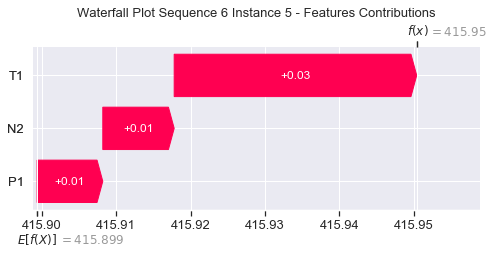

None

Contribution: [0.01088677 0.04442515 0.01297638]


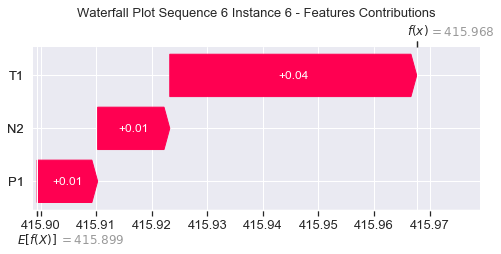

None

Contribution: [0.01311807 0.05317494 0.01731121]


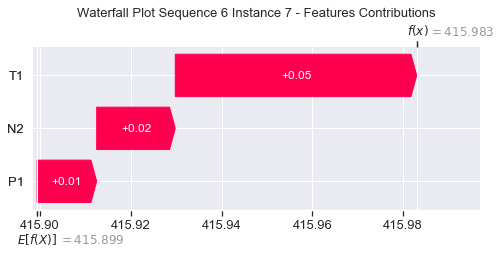

None

Contribution: [0.01564215 0.05958669 0.02188741]


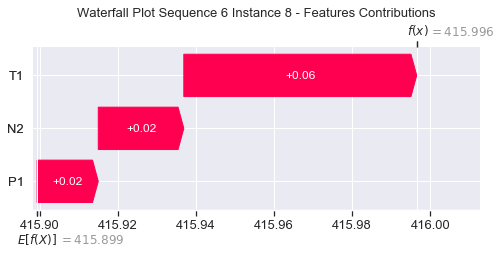

None

Contribution: [0.01985984 0.06406189 0.02696172]


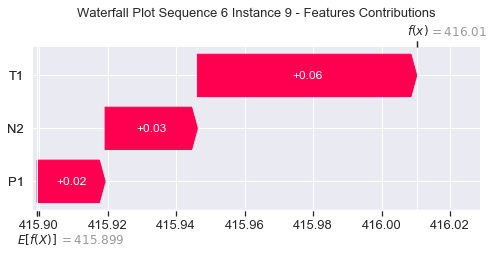

None

Contribution: [0.0251056  0.06169379 0.03181165]


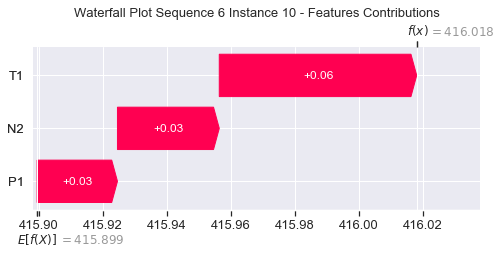

None

Contribution: [0.02415059 0.0629468  0.03916191]


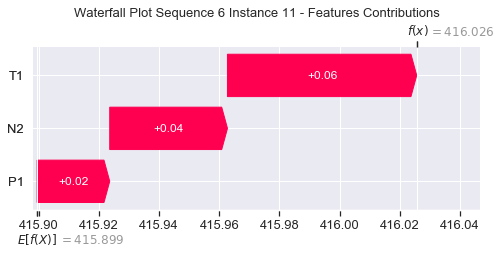

None

Contribution: [0.02367449 0.06084652 0.04857793]


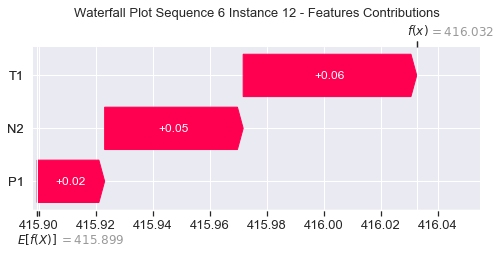

None

Contribution: [0.02472707 0.04761798 0.05620575]


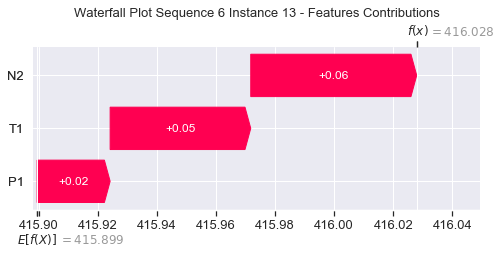

None

Contribution: [0.02537016 0.02557747 0.06535318]


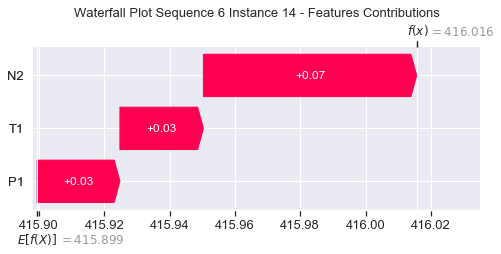

None

Contribution: [ 0.02508922 -0.01154451  0.07661262]


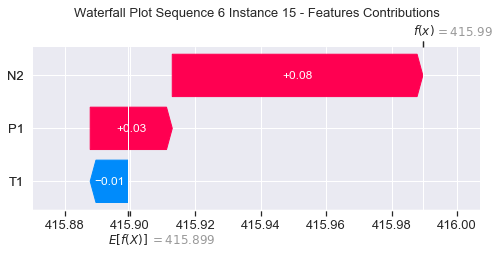

None

Contribution: [ 0.02221549 -0.07769875  0.09158321]


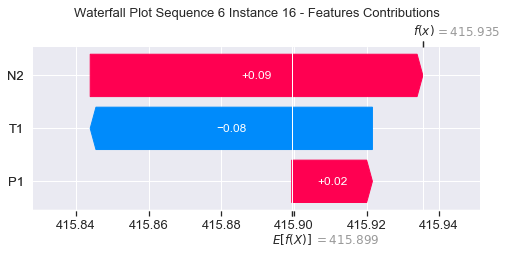

None

Contribution: [ 0.01864298 -0.1741265   0.11108299]


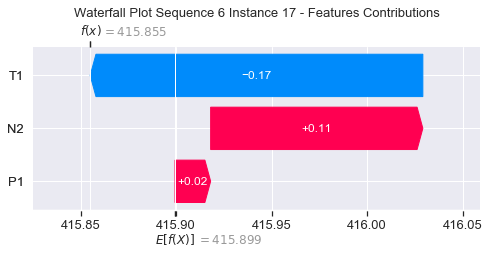

None

Contribution: [ 0.00885198 -0.33840903  0.13827266]


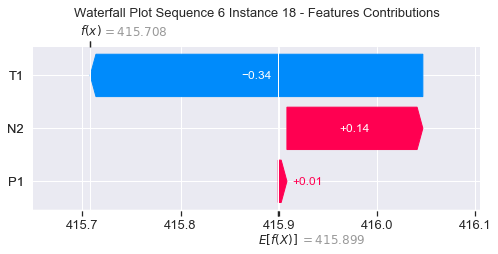

None

Contribution: [-0.01504664 -0.62728616  0.18455303]


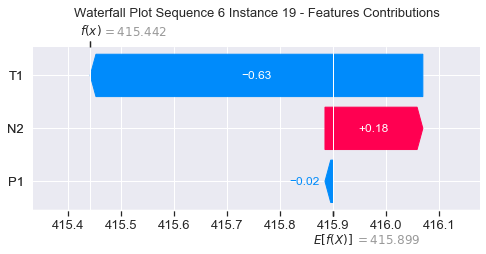

None

Contribution: [-0.04157133 -1.03225835  0.23761329]


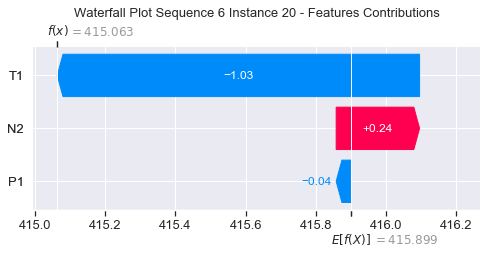

None

Contribution: [-0.09403165 -1.72924413  0.3281523 ]


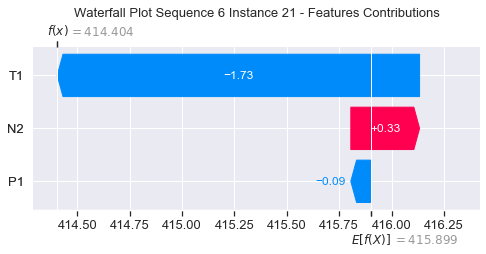

None

Contribution: [-0.28809006 -3.73751913  0.57242703]


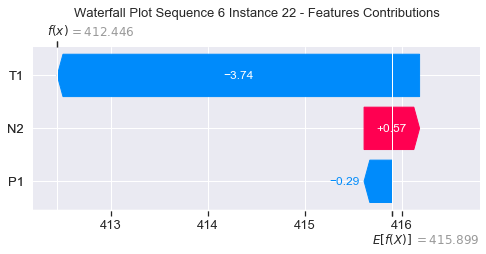

None

Contribution: [-0.37354372 -3.94847557  0.69901061]


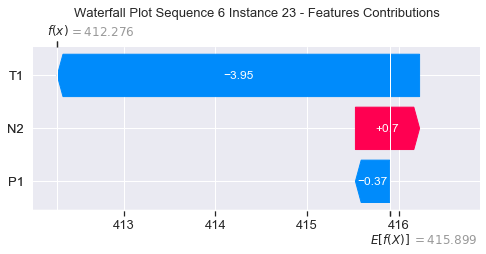

None

Contribution: [ -1.32954016 -15.78724506   2.28372139]


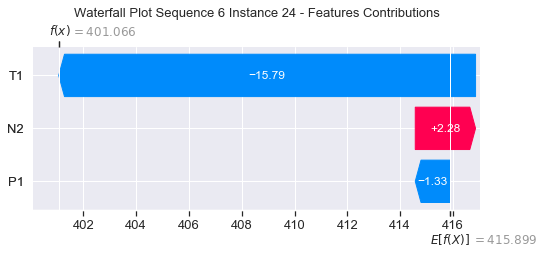

None

Contribution: [ 0.02100119  0.40736768 -0.01635407]


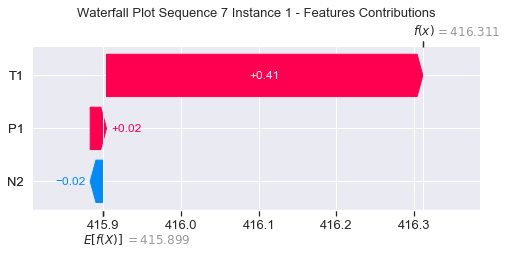

None

Contribution: [0.00194893 0.0322613  0.00152181]


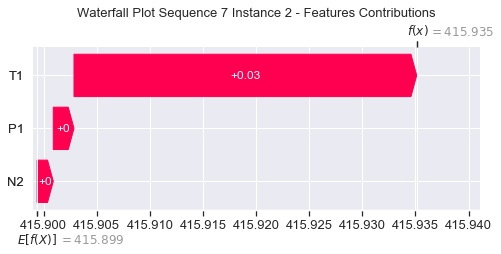

None

Contribution: [ 0.00366004  0.03236479 -0.00273725]


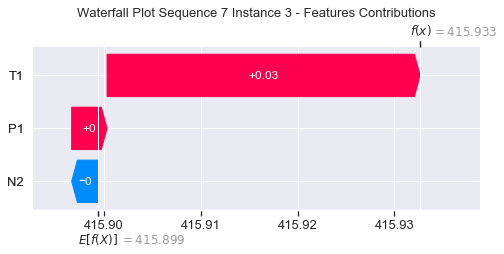

None

Contribution: [0.00570779 0.03472323 0.00423273]


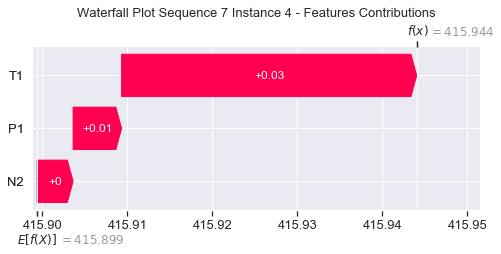

None

Contribution: [0.00893169 0.04645489 0.01034354]


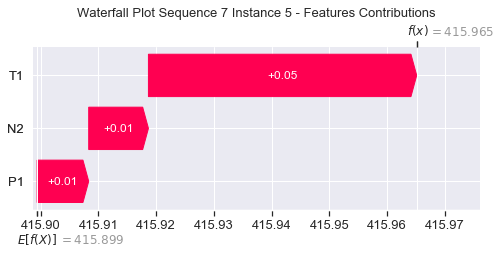

None

Contribution: [0.01199571 0.06022358 0.01419836]


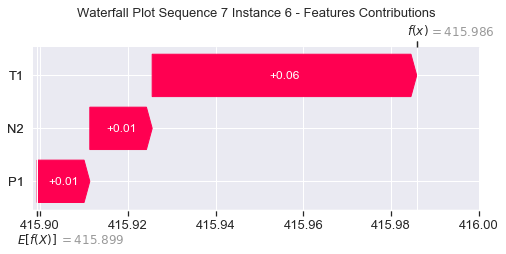

None

Contribution: [0.0149231  0.06908214 0.01839622]


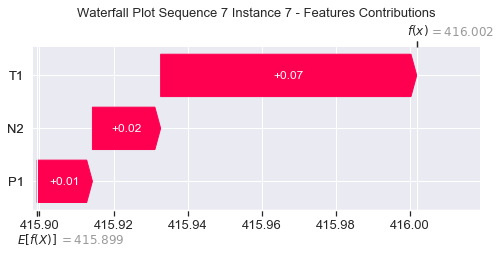

None

Contribution: [0.01704854 0.07518423 0.02329629]


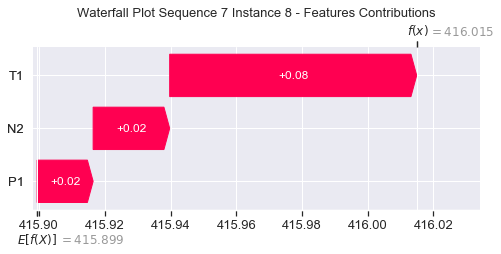

None

Contribution: [0.02212492 0.07238128 0.02879976]


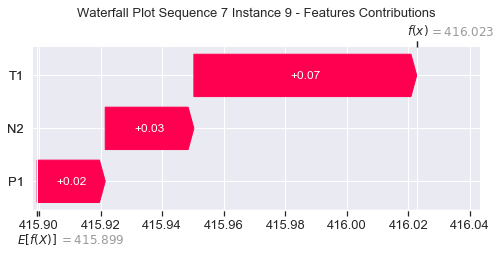

None

Contribution: [0.02368775 0.06976075 0.03305237]


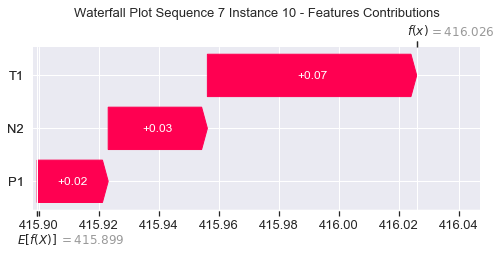

None

Contribution: [0.02470584 0.07173338 0.04158557]


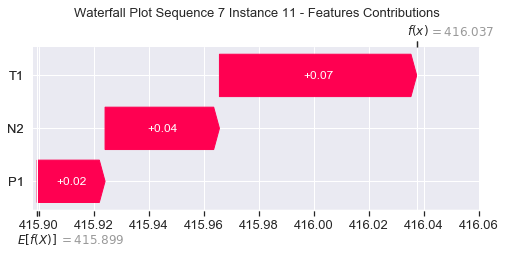

None

Contribution: [0.02543976 0.0675876  0.04833507]


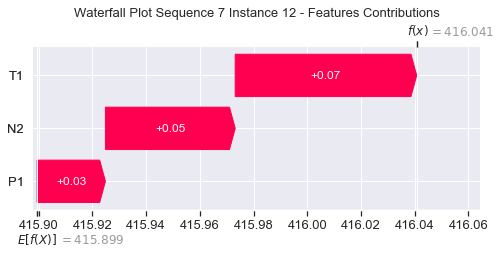

None

Contribution: [0.02627208 0.05130317 0.05608593]


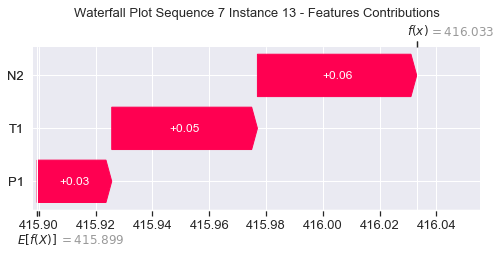

None

Contribution: [0.02662611 0.02547266 0.06509247]


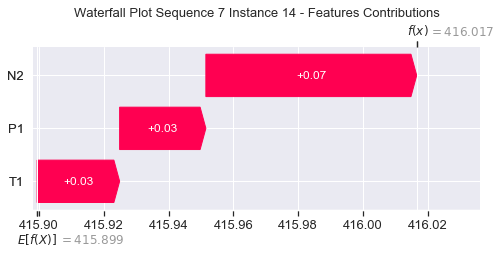

None

Contribution: [ 0.02523003 -0.0168444   0.076985  ]


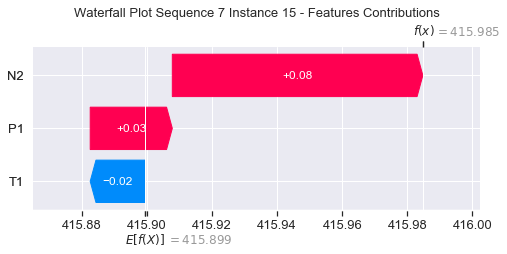

None

Contribution: [ 0.02343186 -0.08559452  0.09344355]


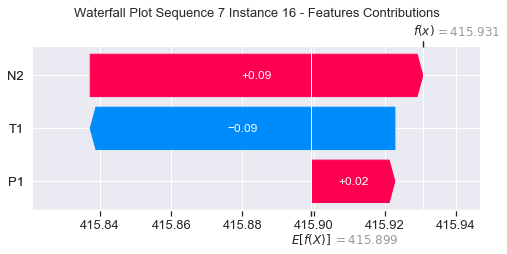

None

Contribution: [ 0.01417386 -0.18692088  0.11193416]


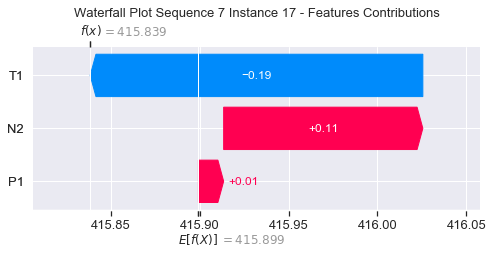

None

Contribution: [ 0.00083414 -0.3547094   0.13837152]


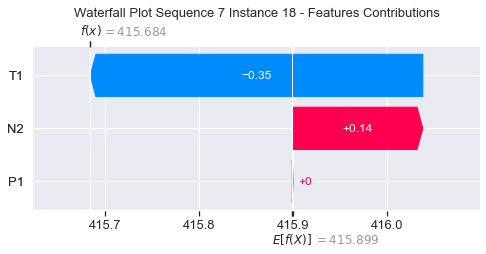

None

Contribution: [-0.00646543 -0.65837202  0.1869089 ]


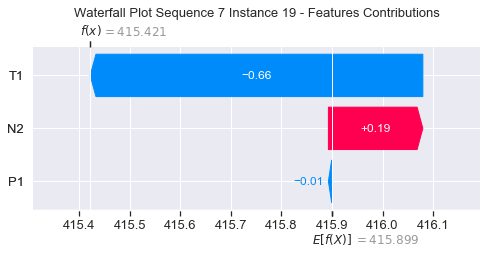

None

Contribution: [-0.06155615 -1.04079405  0.23217563]


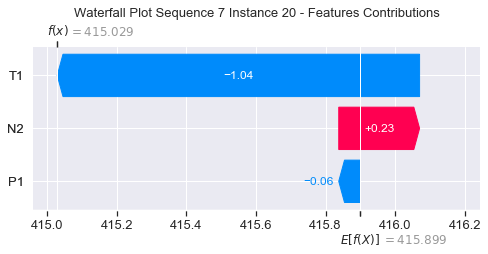

None

Contribution: [-0.12258451 -1.72144722  0.32280762]


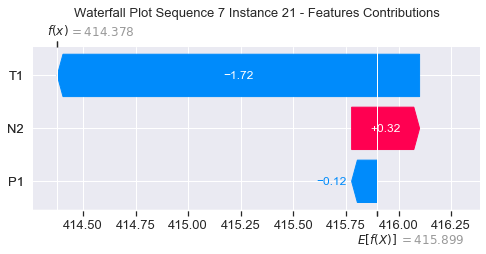

None

Contribution: [-0.32206713 -3.71445354  0.56205716]


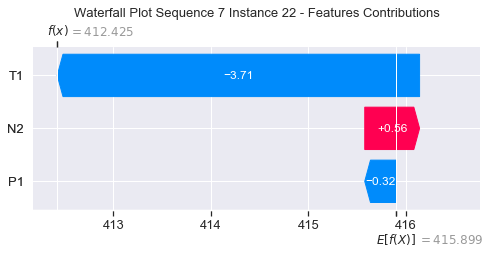

None

Contribution: [-0.41200863 -3.86281488  0.67897961]


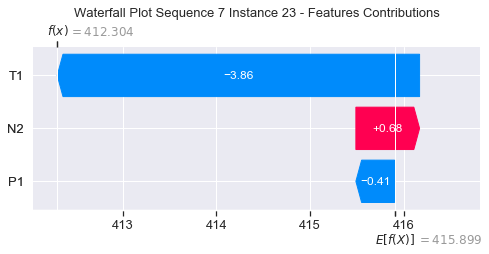

None

Contribution: [ -1.39811109 -15.73145025   2.14660469]


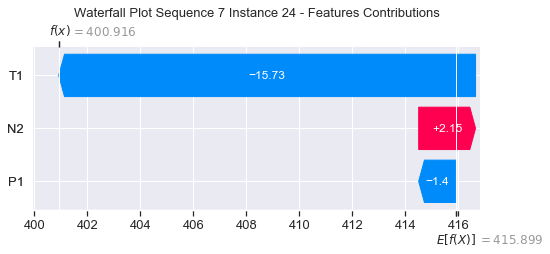

None

Contribution: [ 0.02256139  0.41117572 -0.01638851]


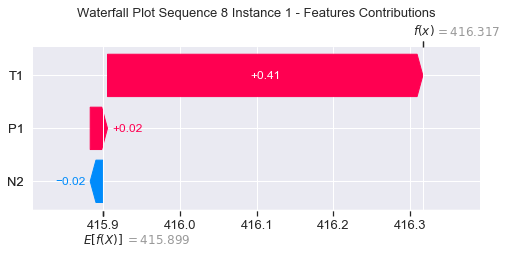

None

Contribution: [0.00199675 0.0320791  0.00153455]


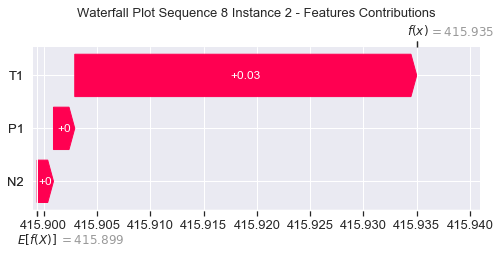

None

Contribution: [ 0.00420022  0.03619252 -0.00399591]


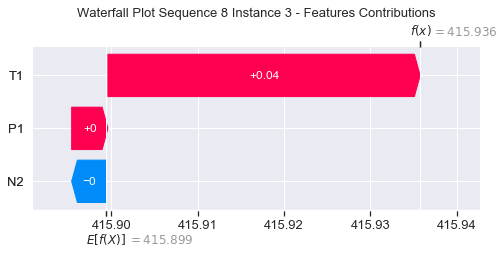

None

Contribution: [0.00702324 0.03506876 0.0043235 ]


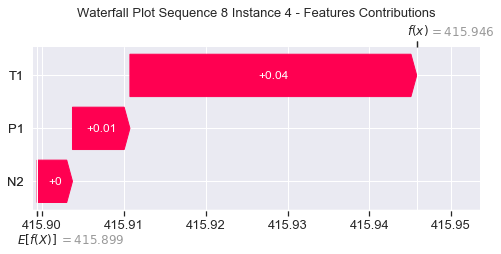

None

Contribution: [0.01527193 0.04784309 0.01270231]


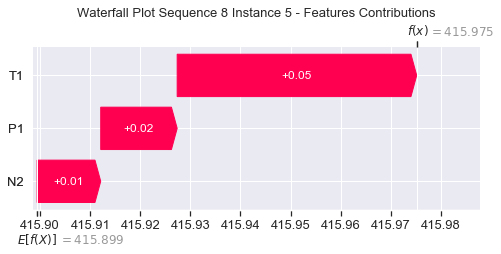

None

Contribution: [0.01381762 0.05415084 0.01443307]


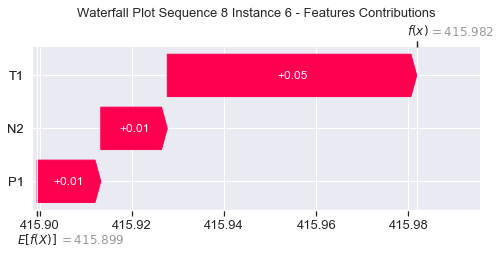

None

Contribution: [0.01680761 0.06331735 0.01842498]


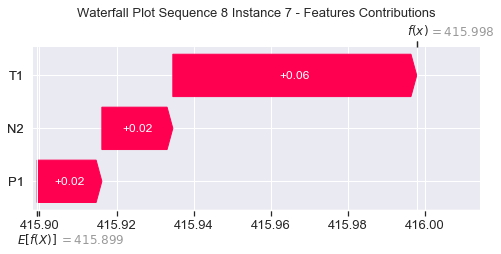

None

Contribution: [0.0193531  0.06763467 0.02311843]


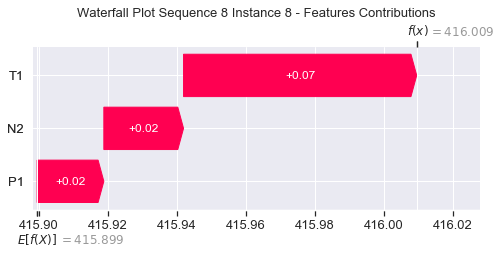

None

Contribution: [0.02693723 0.0740069  0.02570446]


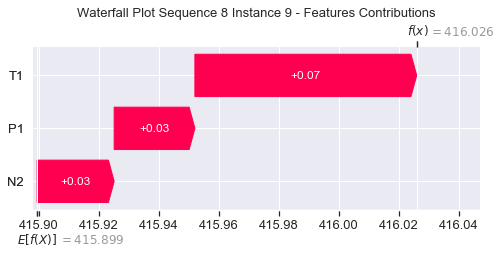

None

Contribution: [0.03869485 0.07795338 0.03171088]


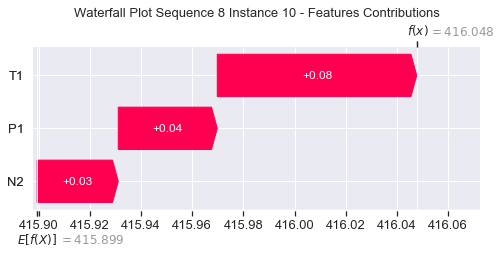

None

Contribution: [0.02456067 0.05921752 0.03660852]


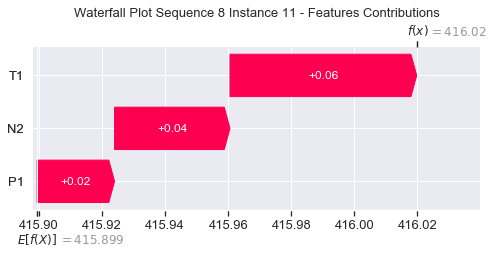

None

Contribution: [0.02248155 0.05336894 0.04624054]


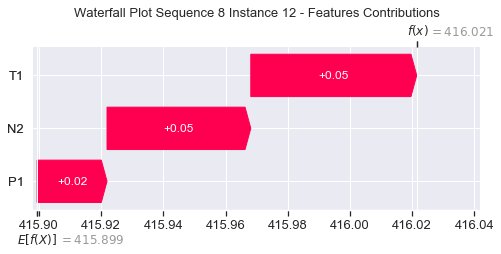

None

Contribution: [0.02494118 0.04524152 0.05485974]


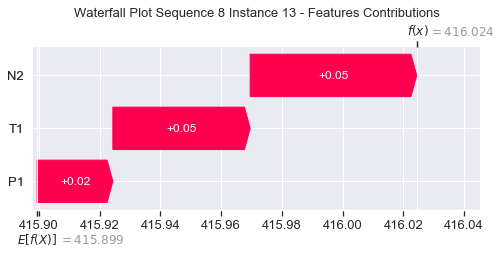

None

Contribution: [0.0254729  0.02877404 0.06406438]


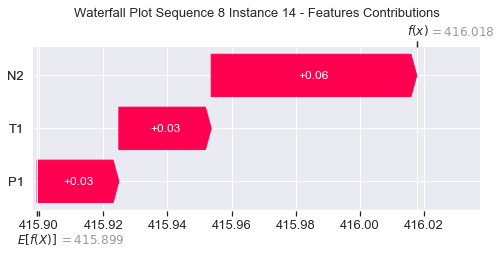

None

Contribution: [0.02584511 0.00150123 0.07728927]


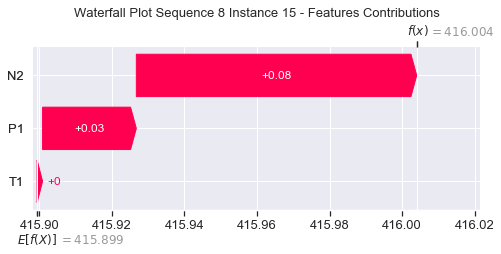

None

Contribution: [ 0.02503805 -0.0445696   0.09526074]


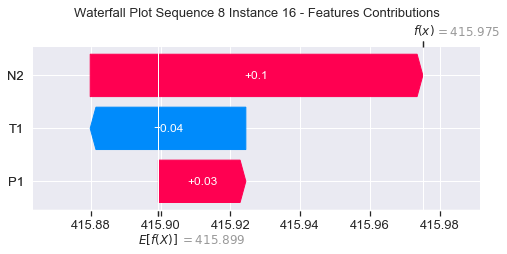

None

Contribution: [ 0.02568511 -0.1070801   0.11780607]


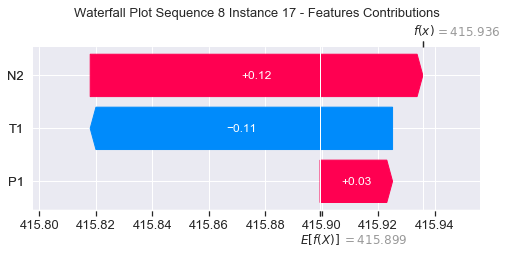

None

Contribution: [ 0.02641492 -0.20579237  0.14991274]


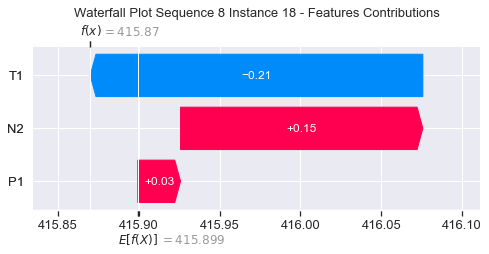

None

Contribution: [ 0.00683605 -0.45541679  0.19506419]


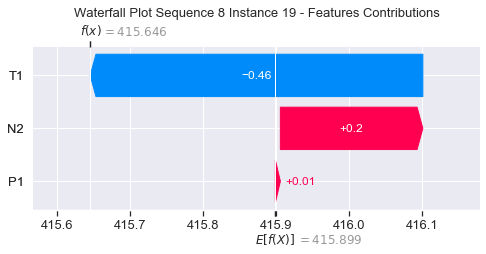

None

Contribution: [-0.013497   -0.70741667  0.25142432]


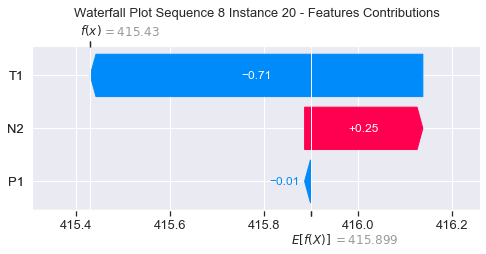

None

Contribution: [-0.04276643 -1.14582217  0.35103142]


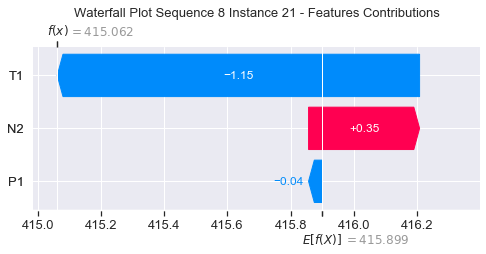

None

Contribution: [-0.16068834 -2.38632724  0.60798532]


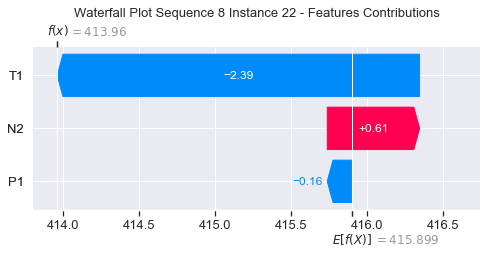

None

Contribution: [-0.12999249 -2.30215192  0.76281322]


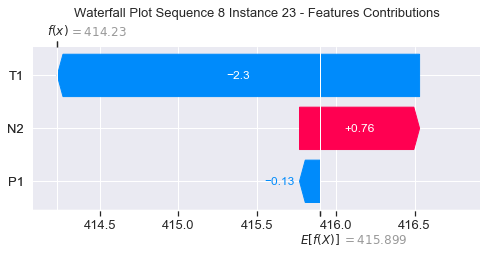

None

Contribution: [-0.62904579 -9.84148523  2.2829324 ]


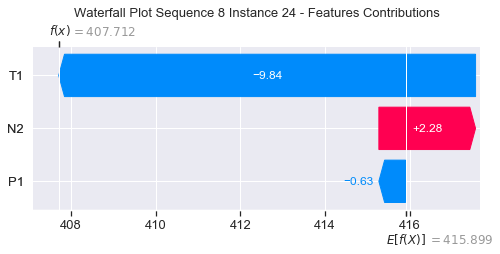

None

Contribution: [ 0.01729266  0.34941091 -0.01755258]


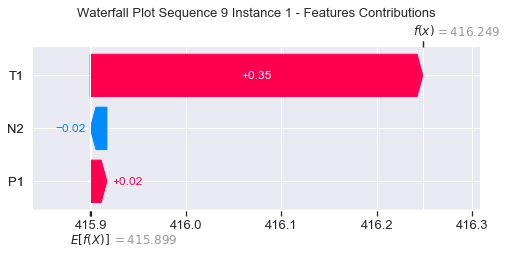

None

Contribution: [0.00199029 0.03044165 0.0010121 ]


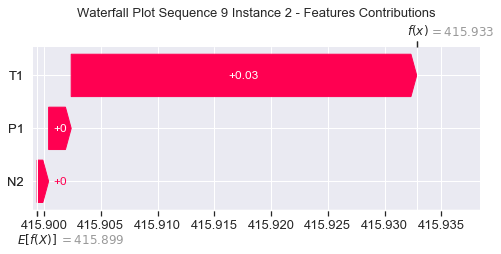

None

Contribution: [ 0.00245747  0.02730054 -0.00430316]


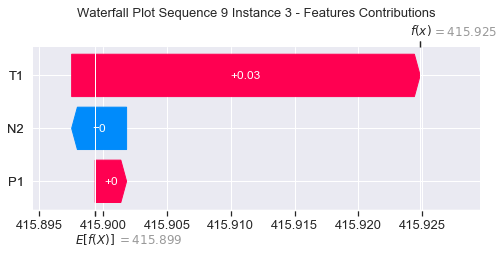

None

Contribution: [0.0062819  0.01899546 0.00470729]


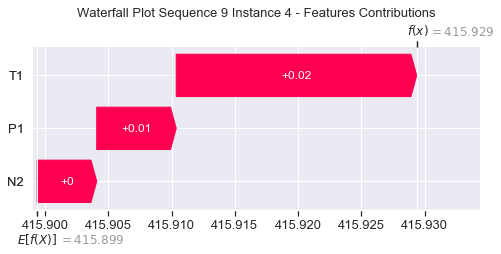

None

Contribution: [0.00891663 0.02818945 0.00987599]


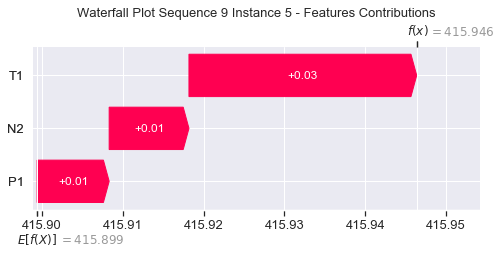

None

Contribution: [0.01137603 0.03787365 0.01328419]


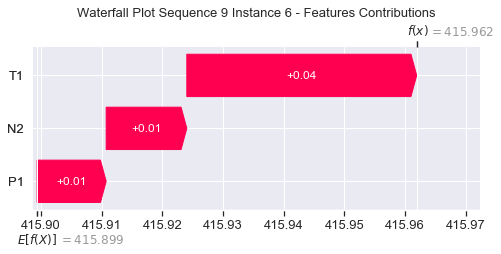

None

Contribution: [0.01359646 0.04484448 0.01743068]


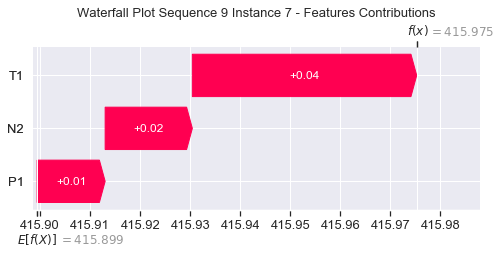

None

Contribution: [0.01522344 0.04976023 0.02197679]


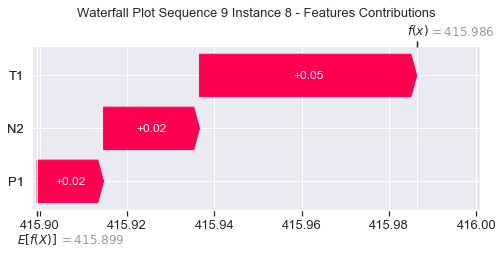

None

Contribution: [0.01636708 0.04854254 0.02671061]


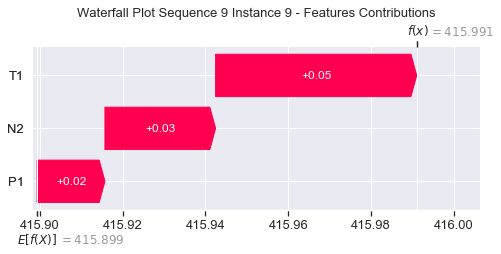

None

Contribution: [0.02206601 0.04924992 0.03113838]


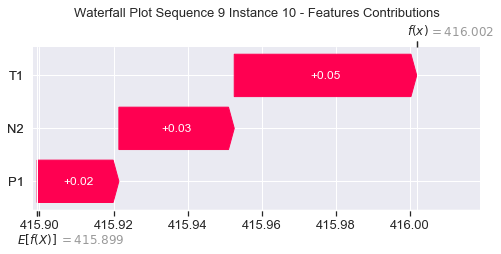

None

Contribution: [0.02044103 0.04966477 0.03873977]


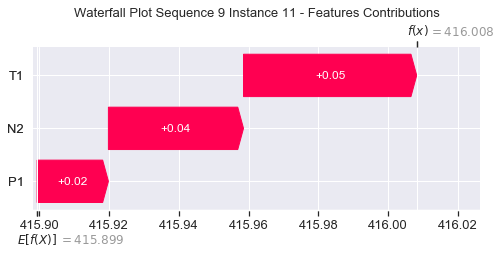

None

Contribution: [0.02258203 0.05306708 0.04675131]


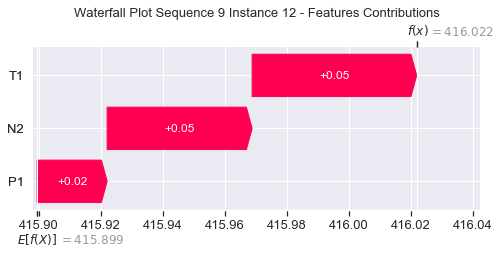

None

Contribution: [0.023654   0.04359984 0.054903  ]


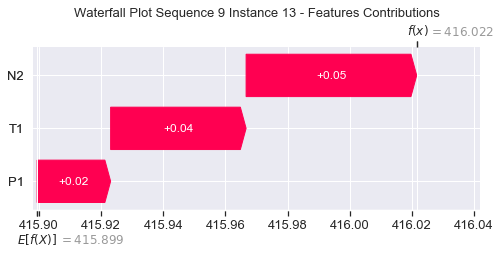

None

Contribution: [0.02348714 0.02795726 0.06352596]


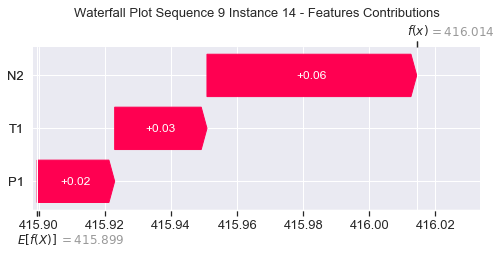

None

Contribution: [0.02557981 0.00082755 0.07694107]


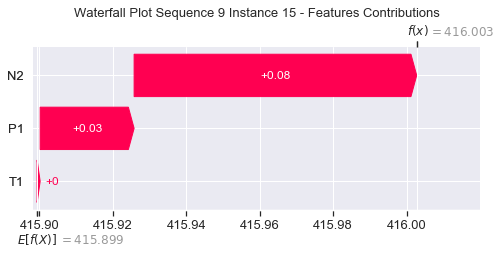

None

Contribution: [ 0.02570211 -0.05299094  0.09431809]


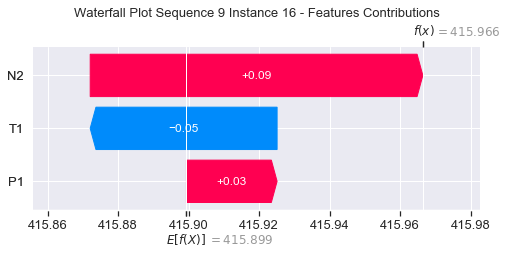

None

Contribution: [ 0.02569657 -0.11619353  0.11480353]


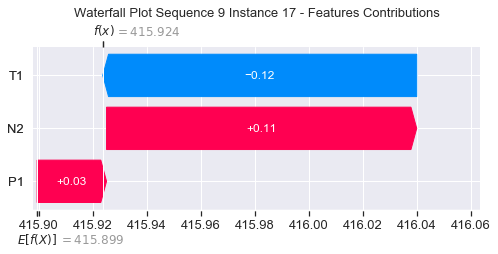

None

Contribution: [ 0.02413921 -0.23607247  0.1444129 ]


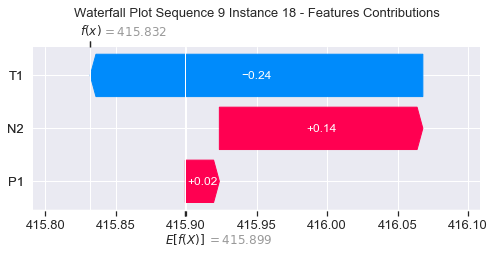

None

Contribution: [ 0.0066343  -0.40142154  0.19293068]


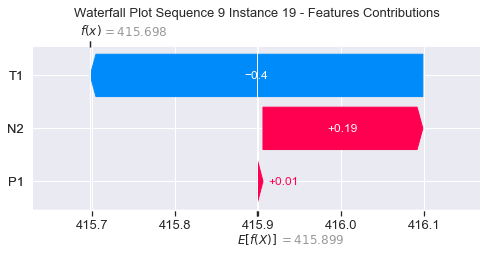

None

Contribution: [ 0.01680875 -0.74093753  0.24763744]


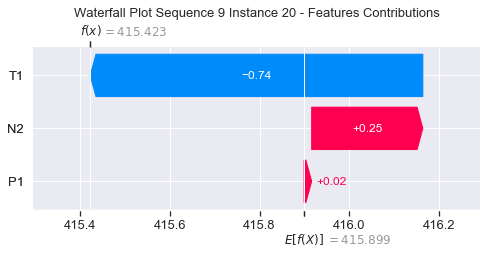

None

Contribution: [ 0.01207067 -1.26356087  0.34996555]


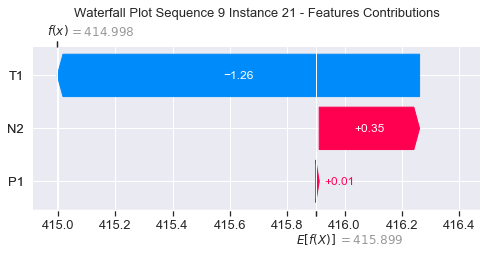

None

Contribution: [-0.04047035 -2.73745973  0.62262015]


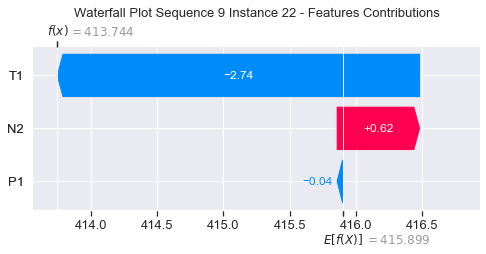

None

Contribution: [-0.10254566 -2.9222752   0.74923548]


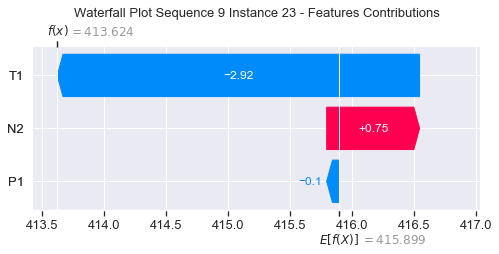

None

Contribution: [ -0.173727   -11.75465036   2.36944978]


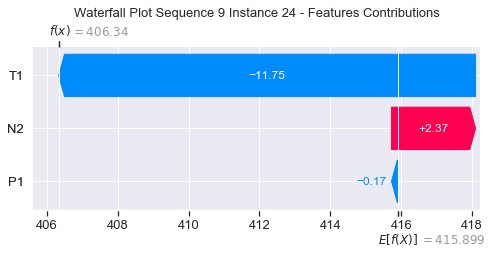

None

Contribution: [ 0.00833162  0.37325552 -0.01819662]


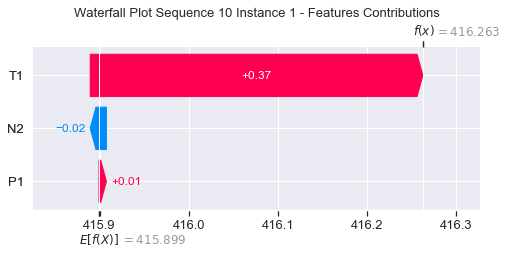

None

Contribution: [0.00184219 0.03192647 0.00078258]


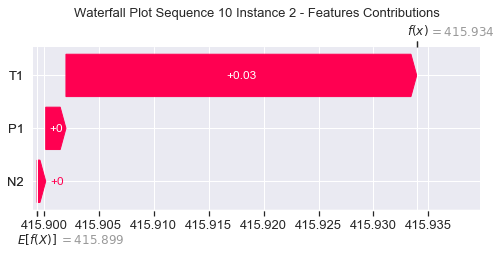

None

Contribution: [ 0.00209805  0.02653512 -0.00431042]


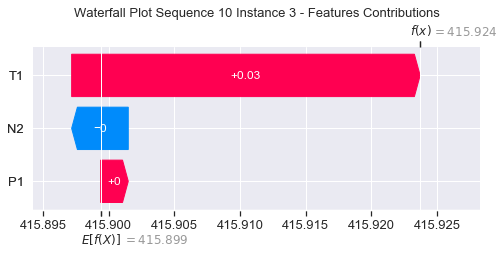

None

Contribution: [0.00351383 0.02501739 0.00350839]


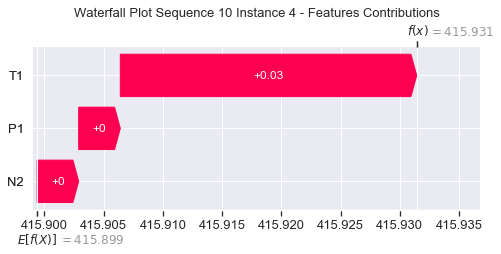

None

Contribution: [0.00545199 0.02544193 0.00919659]


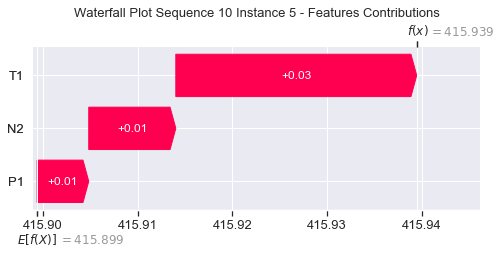

None

Contribution: [0.00494306 0.04418465 0.01136943]


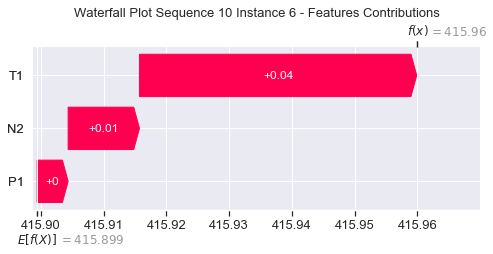

None

Contribution: [0.00740812 0.0560311  0.01551039]


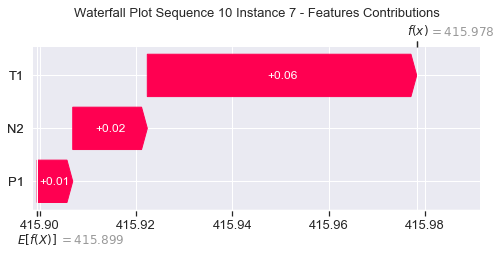

None

Contribution: [0.00702678 0.05696523 0.01983654]


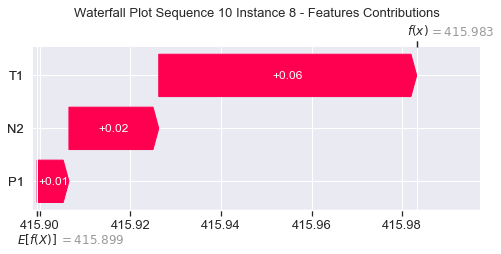

None

Contribution: [0.0051754  0.0486965  0.02516187]


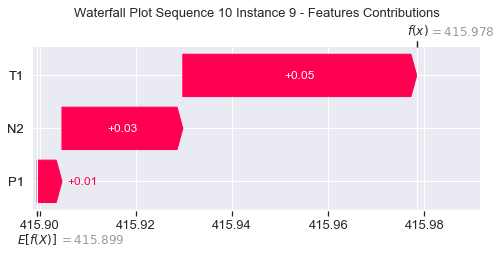

None

Contribution: [0.00937969 0.04499116 0.02965343]


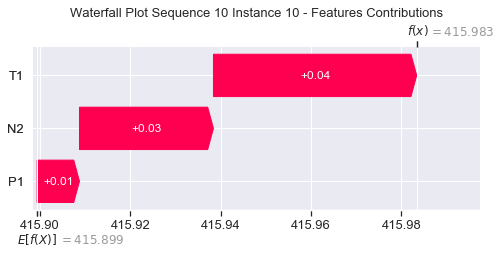

None

Contribution: [0.0016675  0.04006422 0.0347951 ]


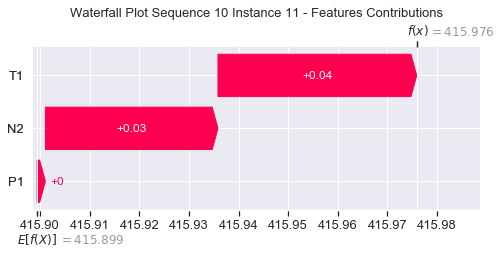

None

Contribution: [0.01417742 0.05790777 0.04414698]


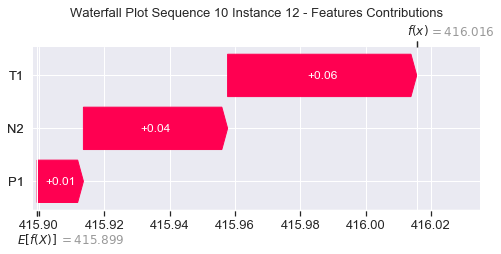

None

Contribution: [0.01778778 0.04649873 0.05339443]


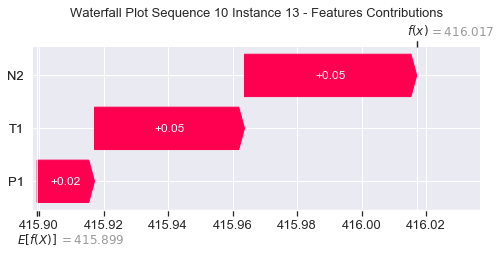

None

Contribution: [0.02031836 0.02541803 0.06375194]


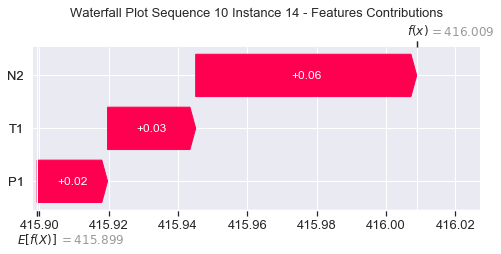

None

Contribution: [ 0.02515107 -0.01247721  0.07729932]


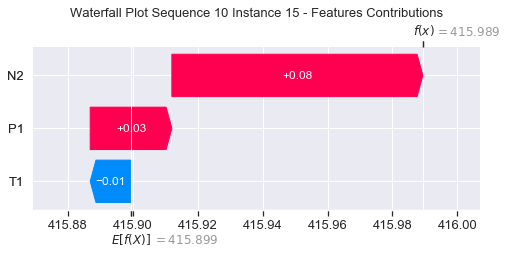

None

Contribution: [ 0.02445564 -0.13228579  0.09533107]


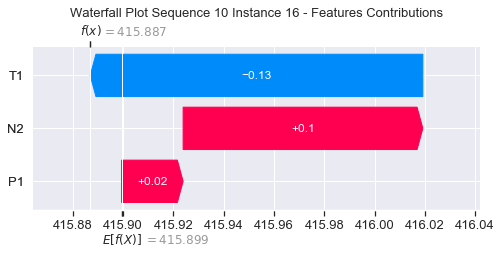

None

Contribution: [ 0.03735922 -0.18976134  0.11749322]


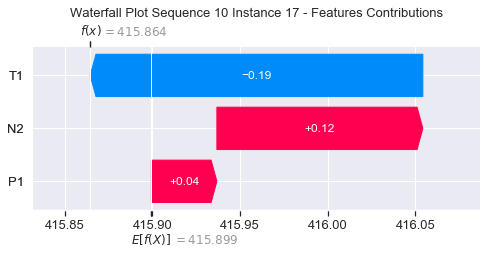

None

Contribution: [ 0.04944349 -0.36558606  0.14920534]


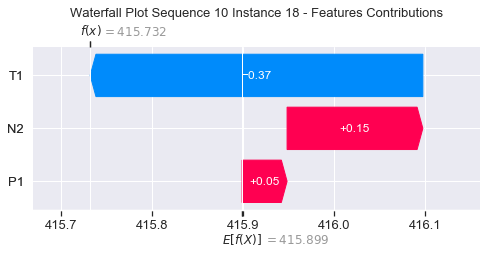

None

Contribution: [ 0.0353188  -0.88888205  0.21023594]


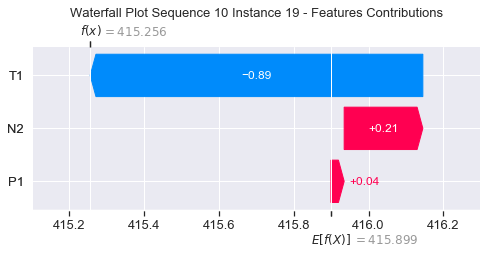

None

Contribution: [ 0.073004   -1.10064417  0.24660205]


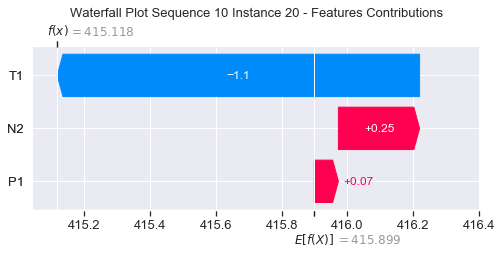

None

Contribution: [ 0.11185356 -1.74652336  0.34708804]


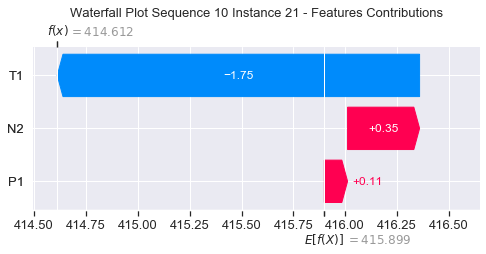

None

Contribution: [ 0.21191194 -3.53408567  0.6190329 ]


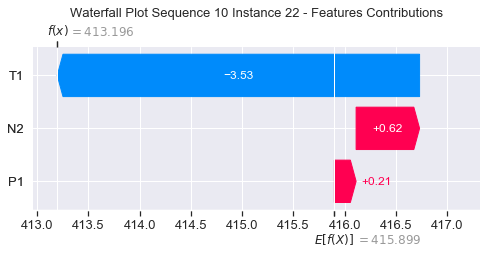

None

Contribution: [ 0.21987402 -3.89957689  0.76559121]


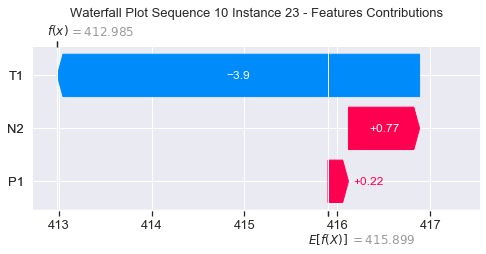

None

Contribution: [  0.7538468  -14.46951612   2.28623334]


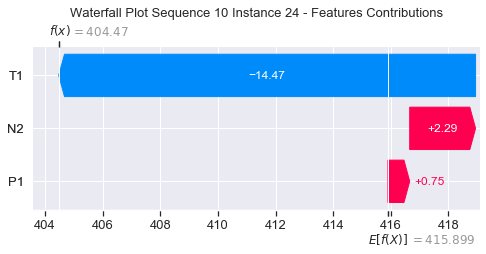

None

Contribution: [ 0.0087653   0.38115182 -0.01462304]


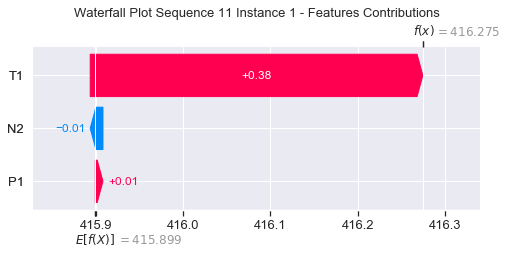

None

Contribution: [0.00179338 0.03292662 0.00096797]


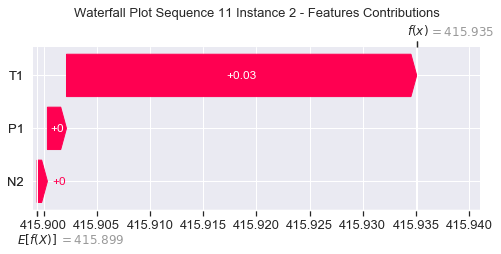

None

Contribution: [-0.00050465  0.02684752 -0.00492271]


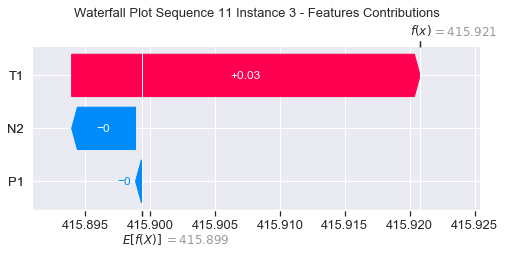

None

Contribution: [-3.32997790e-05  1.82612822e-02  3.16492322e-03]


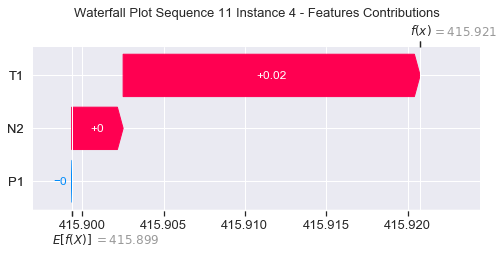

None

Contribution: [0.00158258 0.02306497 0.00793282]


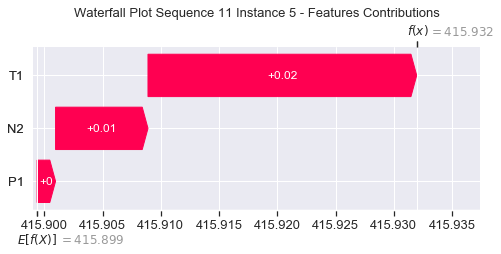

None

Contribution: [0.00069954 0.02838627 0.01073413]


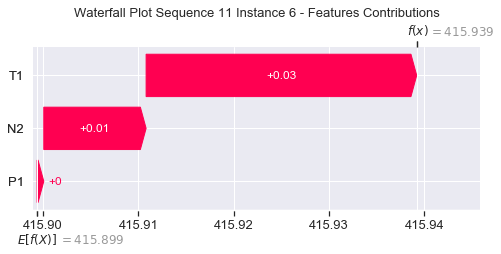

None

Contribution: [0.00244862 0.03306757 0.01471887]


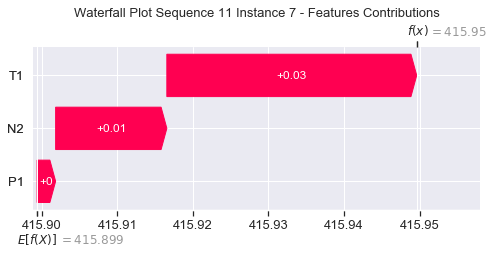

None

Contribution: [0.00303968 0.03709027 0.01925188]


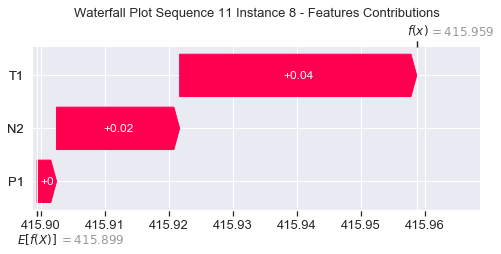

None

Contribution: [0.01062305 0.03764155 0.02500796]


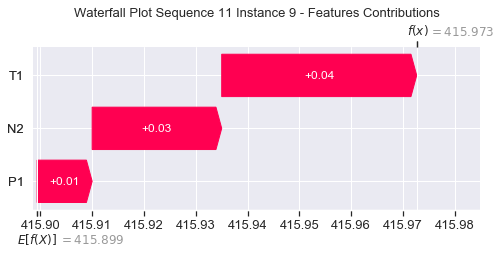

None

Contribution: [0.01507474 0.03912339 0.02932726]


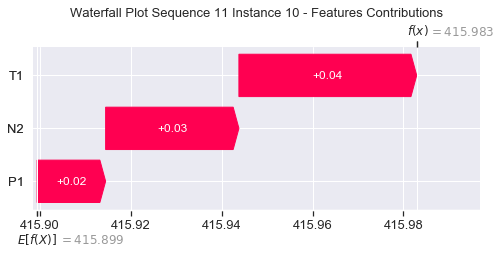

None

Contribution: [0.00854523 0.04085435 0.03621453]


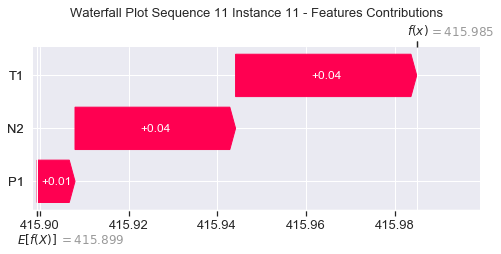

None

Contribution: [0.00950207 0.04224371 0.0443162 ]


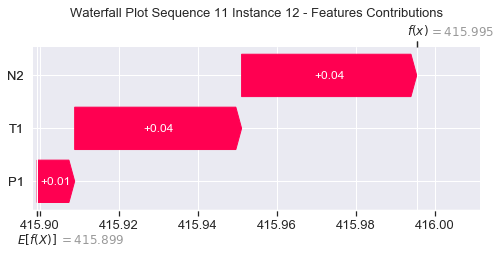

None

Contribution: [0.01361275 0.03672444 0.05313683]


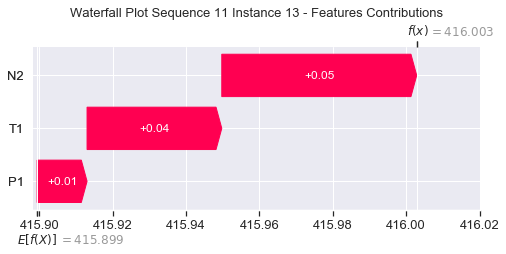

None

Contribution: [0.01807528 0.02814569 0.06318693]


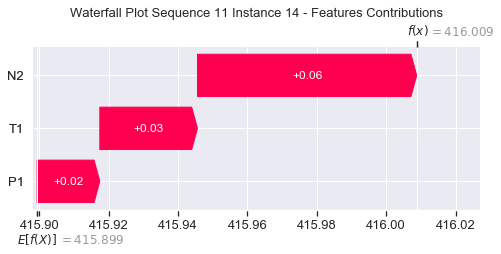

None

Contribution: [0.02428287 0.01391451 0.07677602]


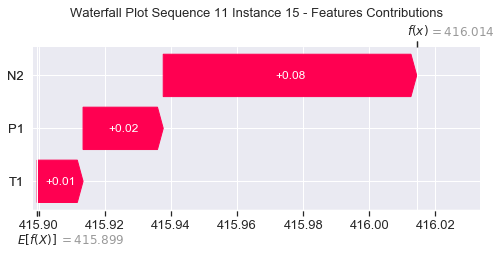

None

Contribution: [ 0.03717425 -0.01697349  0.09441757]


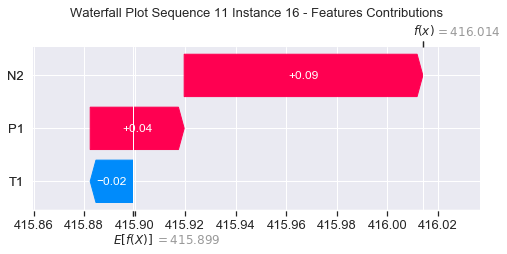

None

Contribution: [ 0.04472137 -0.04263435  0.11617086]


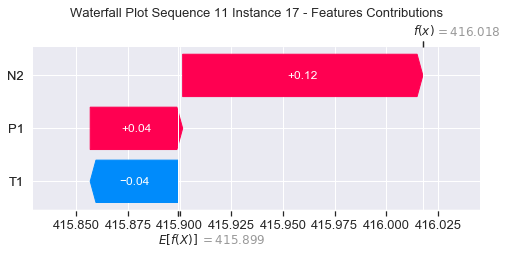

None

Contribution: [ 0.06388635 -0.09992158  0.14598096]


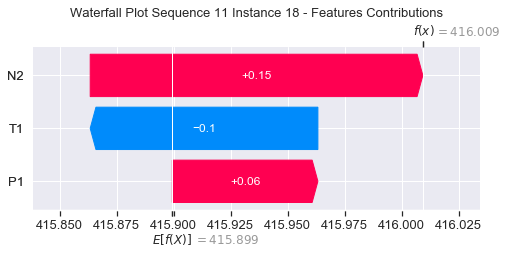

None

Contribution: [ 0.10552194 -0.19089797  0.19705349]


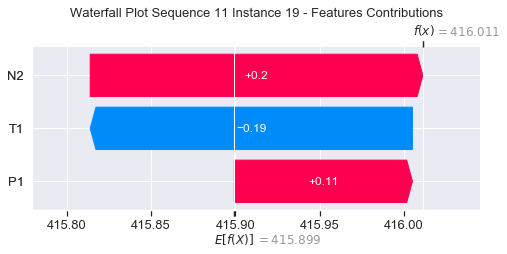

None

Contribution: [ 0.11531791 -0.34474528  0.24148849]


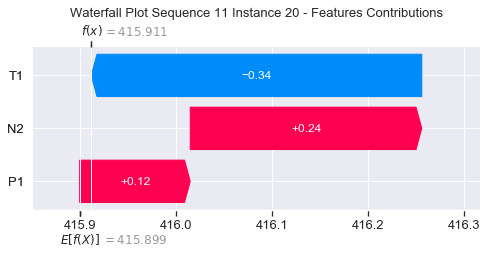

None

Contribution: [ 0.17780329 -0.62381383  0.33578308]


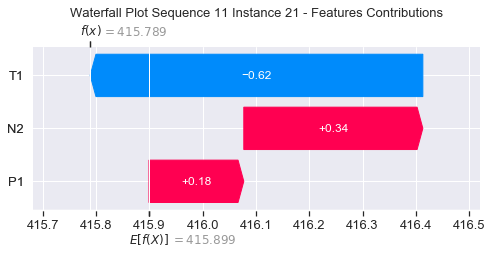

None

Contribution: [ 0.33843212 -1.37824939  0.58380161]


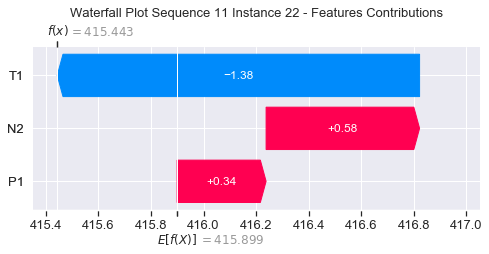

None

Contribution: [ 0.35230429 -1.46664203  0.70250299]


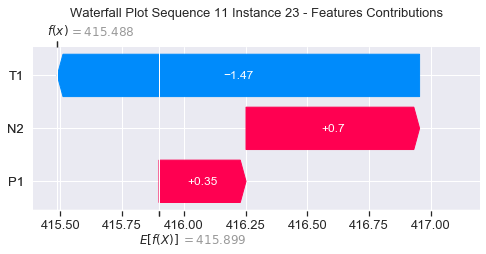

None

Contribution: [ 1.51760932 -5.68052013  2.1789736 ]


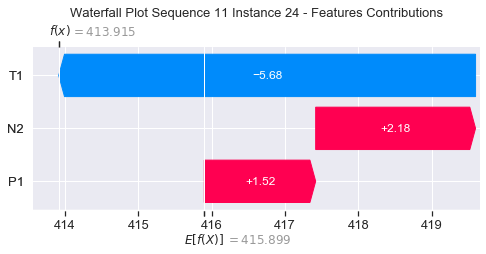

None

Contribution: [-0.00685311  0.30747477 -0.01778413]


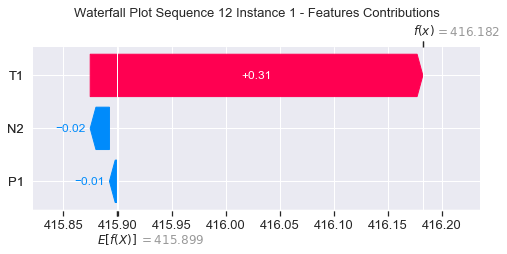

None

Contribution: [0.00169005 0.03128221 0.00090919]


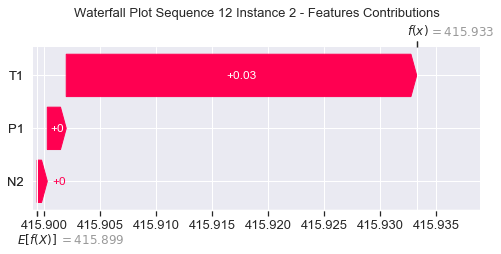

None

Contribution: [-0.00130795  0.01630148 -0.00367899]


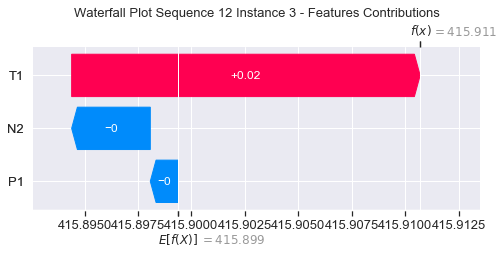

None

Contribution: [0.00042052 0.01327768 0.00414547]


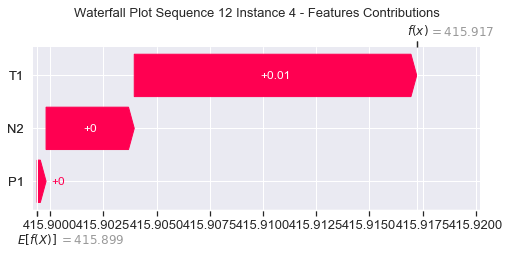

None

Contribution: [0.00208008 0.01648612 0.00881639]


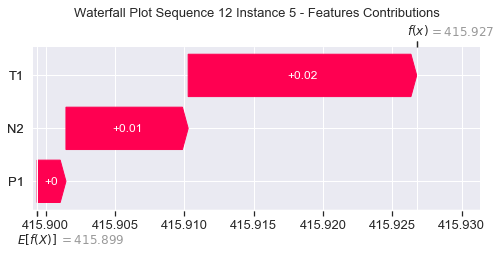

None

Contribution: [0.00222125 0.02477527 0.01158631]


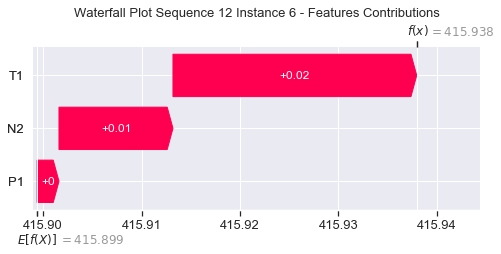

None

Contribution: [0.00303236 0.0312861  0.01551529]


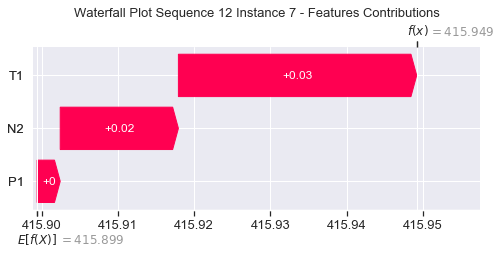

None

Contribution: [0.00423962 0.03488973 0.02018251]


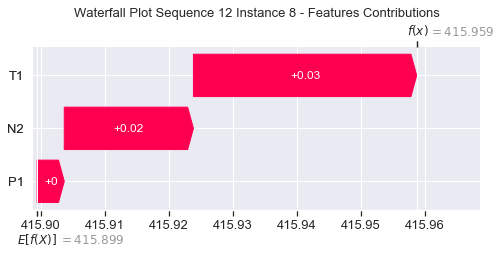

None

Contribution: [0.00765231 0.03840038 0.02565796]


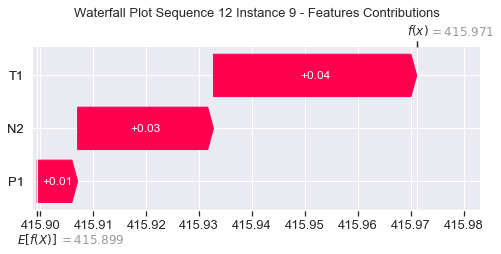

None

Contribution: [0.00647909 0.03889722 0.02920232]


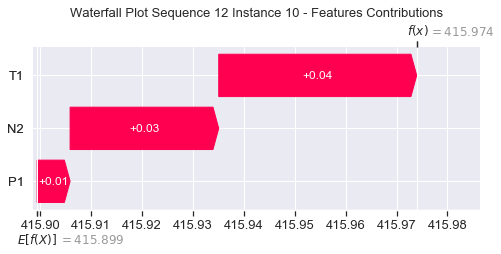

None

Contribution: [0.01183929 0.03922397 0.03823951]


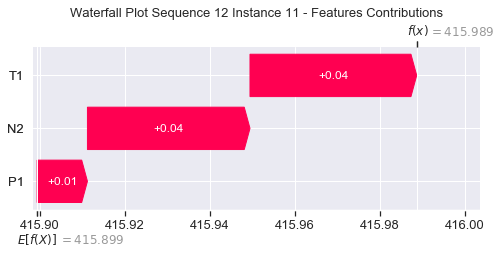

None

Contribution: [0.01311374 0.0449014  0.04626655]


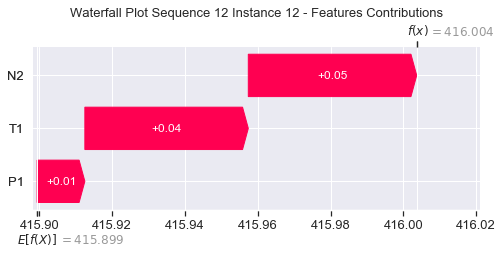

None

Contribution: [0.01568704 0.03860337 0.05453807]


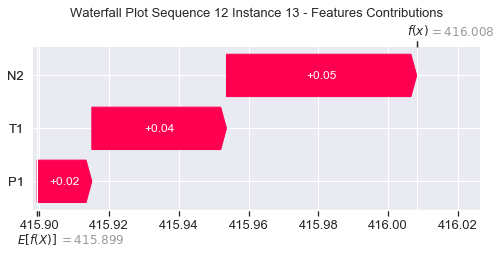

None

Contribution: [0.01876575 0.02865097 0.06425699]


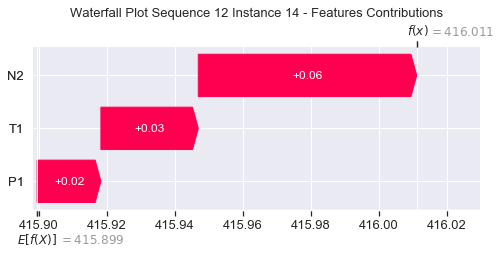

None

Contribution: [0.02483864 0.01009581 0.07726179]


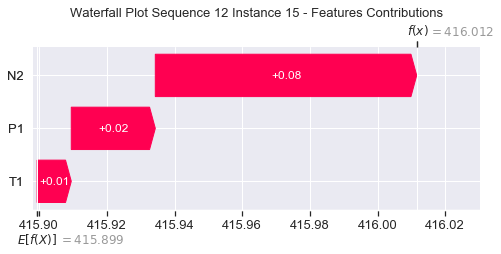

None

Contribution: [ 0.03232768 -0.02817714  0.09486456]


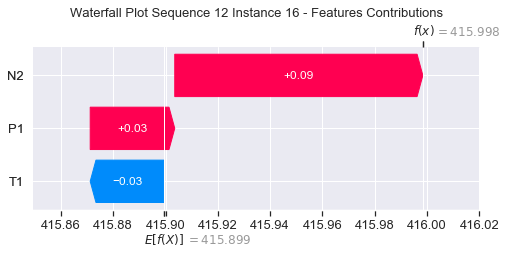

None

Contribution: [ 0.0434371  -0.07230443  0.11706602]


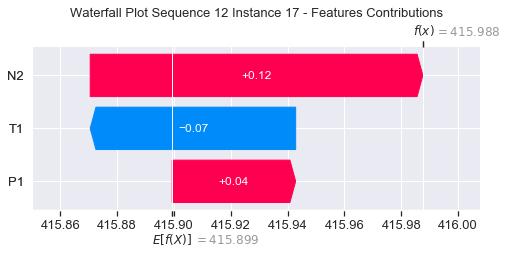

None

Contribution: [ 0.05945433 -0.15556299  0.14851954]


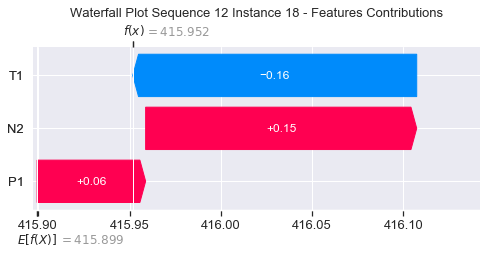

None

Contribution: [ 0.05864279 -0.32999612  0.19312261]


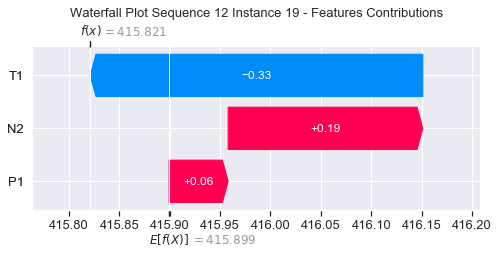

None

Contribution: [ 0.12092771 -0.49924429  0.25928134]


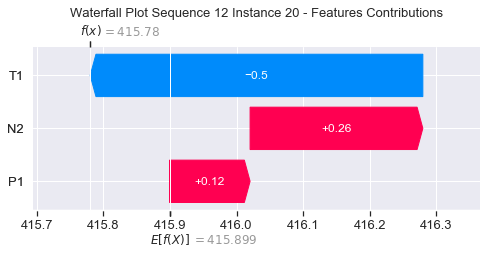

None

Contribution: [ 0.1774145  -0.86813916  0.36368662]


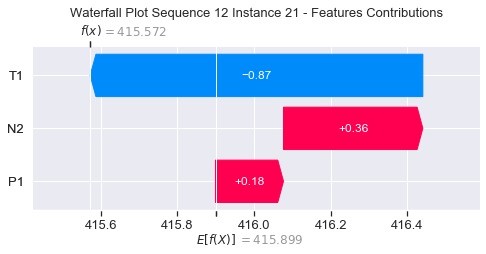

None

Contribution: [ 0.29701588 -1.84002226  0.63969025]


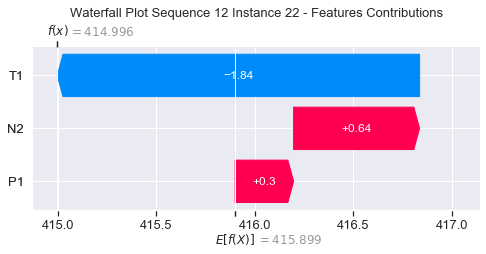

None

Contribution: [ 0.26460722 -2.04386179  0.76839513]


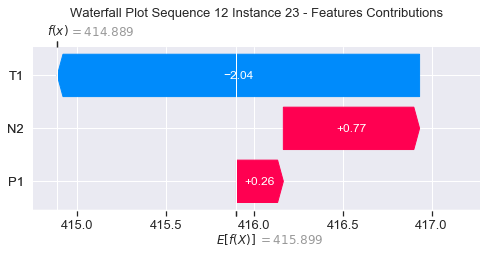

None

Contribution: [ 1.1633685  -7.23093784  2.54941027]


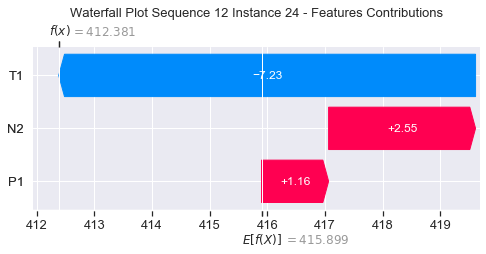

None

Contribution: [-0.00095294  0.31829971 -0.0247615 ]


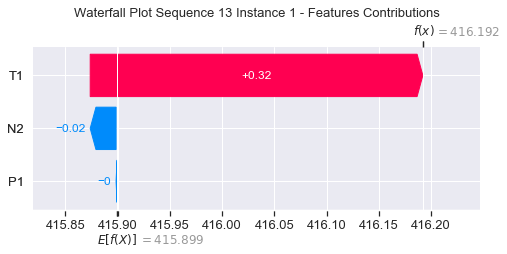

None

Contribution: [0.00179079 0.03262203 0.0008263 ]


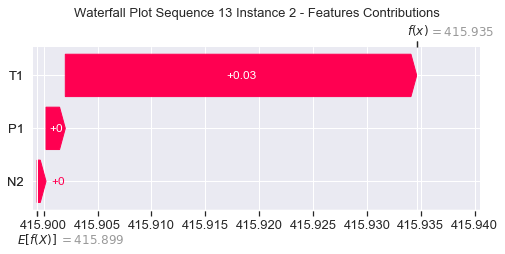

None

Contribution: [ 0.00030784  0.01730636 -0.00414643]


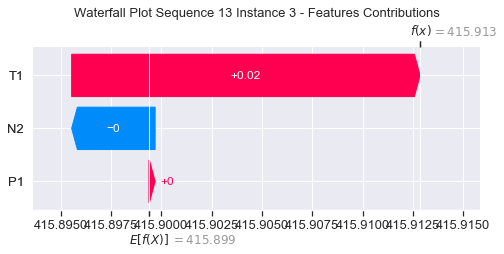

None

Contribution: [0.00259231 0.01310793 0.00376478]


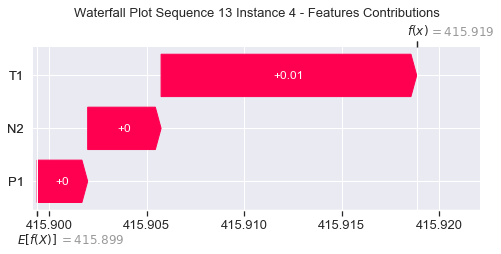

None

Contribution: [0.00422238 0.0204403  0.00878898]


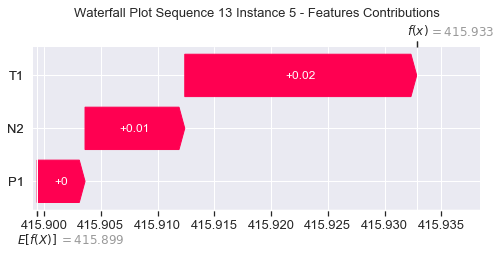

None

Contribution: [0.00519527 0.02670257 0.01187727]


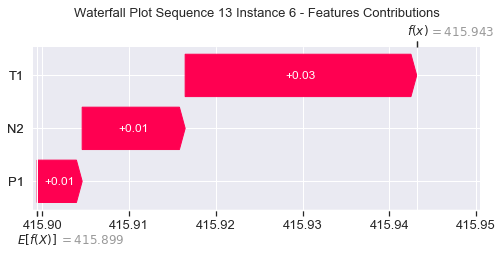

None

Contribution: [0.00654328 0.03236106 0.01576642]


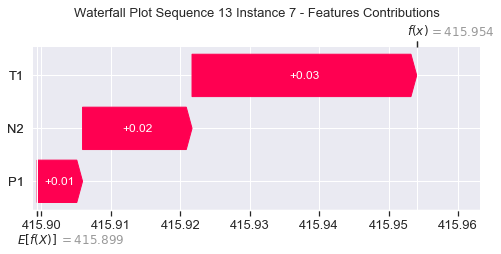

None

Contribution: [0.00787573 0.0357715  0.0202142 ]


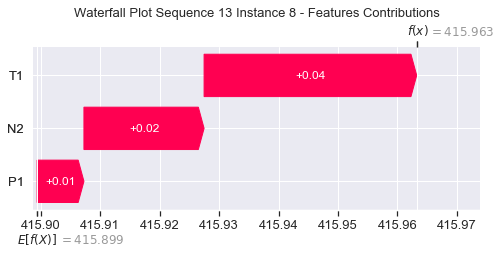

None

Contribution: [0.00962586 0.0378984  0.02444205]


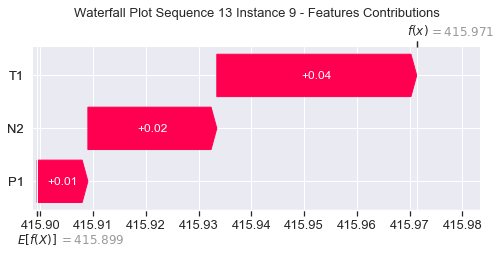

None

Contribution: [0.0146935  0.05130206 0.03018132]


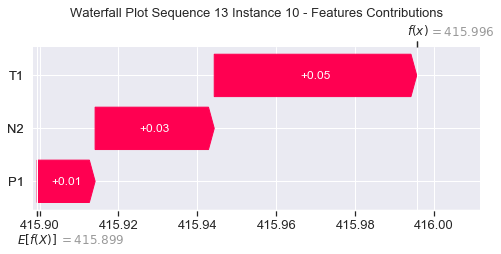

None

Contribution: [0.0132267  0.03722016 0.03642585]


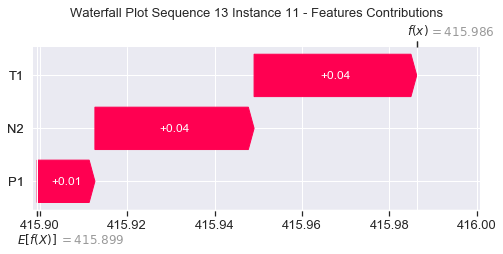

None

Contribution: [0.01560461 0.03873316 0.04486111]


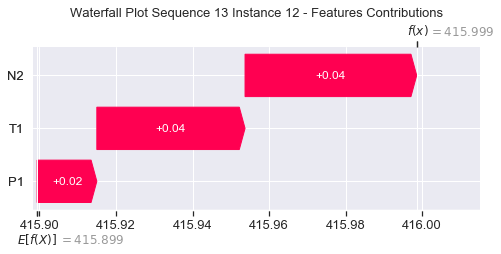

None

Contribution: [0.01811011 0.03497019 0.05345769]


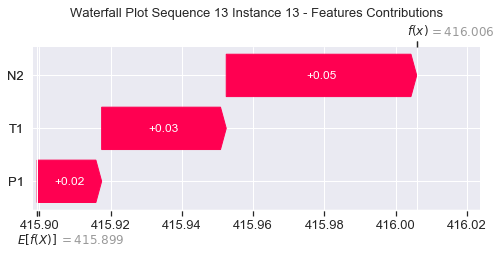

None

Contribution: [0.02059496 0.02763459 0.06334816]


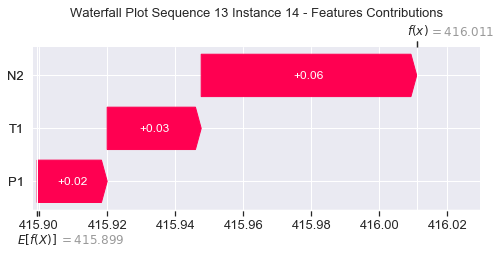

None

Contribution: [0.02524439 0.01571247 0.07707079]


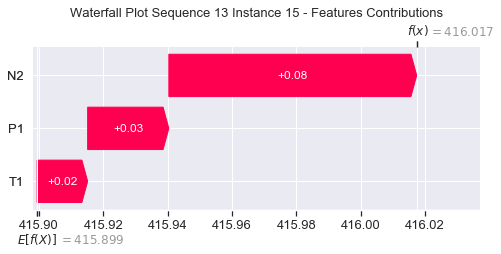

None

Contribution: [ 0.02891921 -0.00803639  0.09484028]


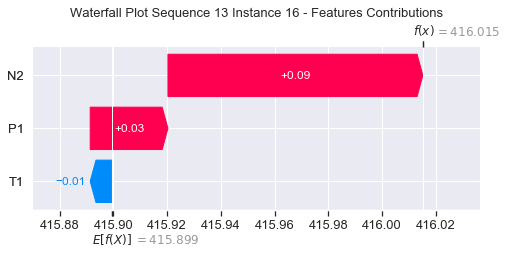

None

Contribution: [ 0.03628876 -0.03953228  0.1179003 ]


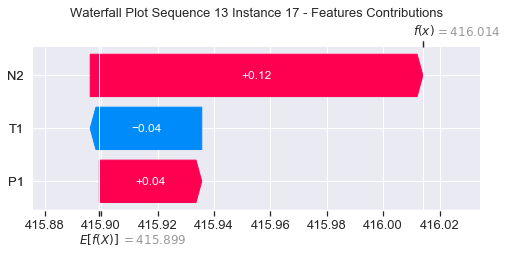

None

Contribution: [ 0.04373322 -0.0963322   0.14954166]


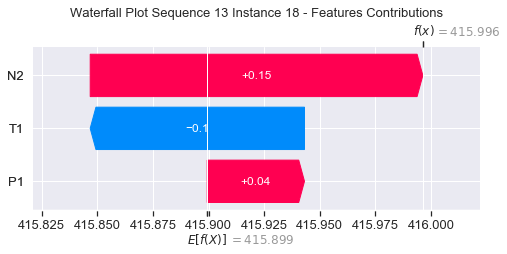

None

Contribution: [ 0.02401507 -0.23484429  0.19828863]


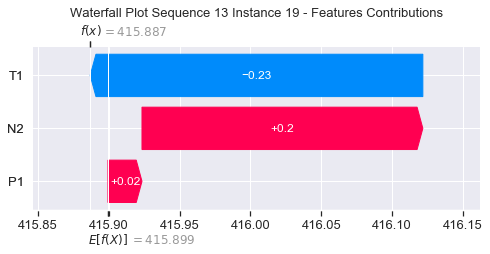

None

Contribution: [ 0.06406754 -0.36145386  0.25840759]


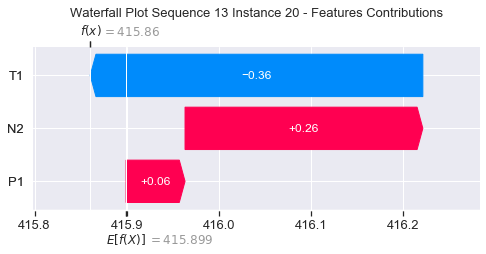

None

Contribution: [ 0.08729199 -0.61602681  0.3669674 ]


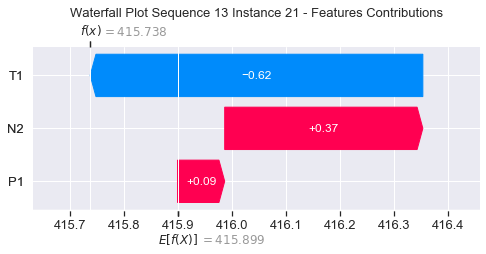

None

Contribution: [ 0.10853557 -1.28324065  0.65367205]


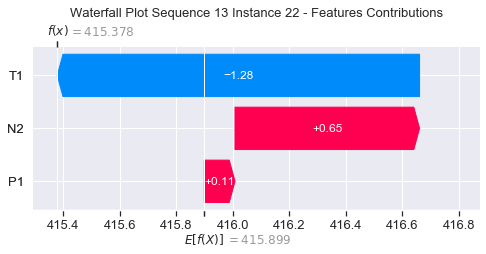

None

Contribution: [ 0.04678822 -1.39601183  0.7759284 ]


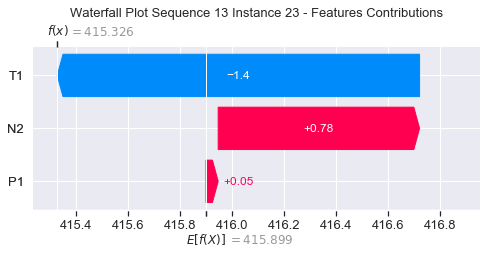

None

Contribution: [ 0.34862785 -5.12743929  2.49248367]


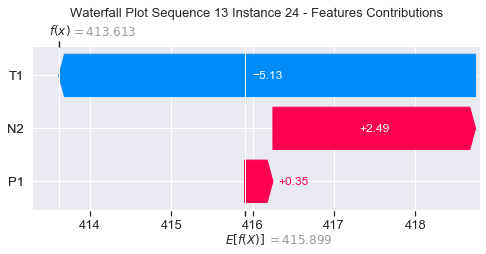

None

Contribution: [ 0.00410959  0.28434363 -0.0240115 ]


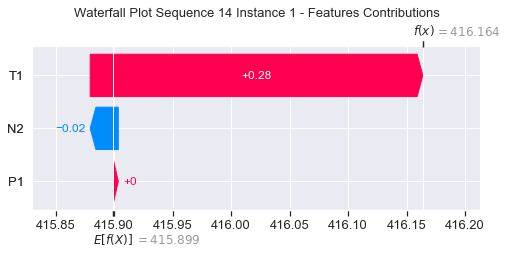

None

Contribution: [0.00186377 0.0308348  0.00036383]


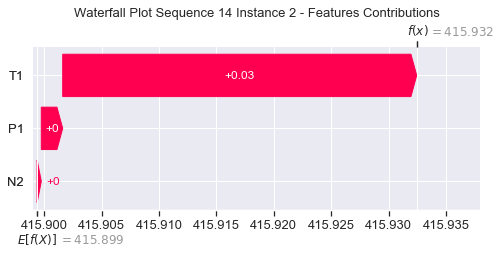

None

Contribution: [ 0.00075595  0.0081573  -0.00496723]


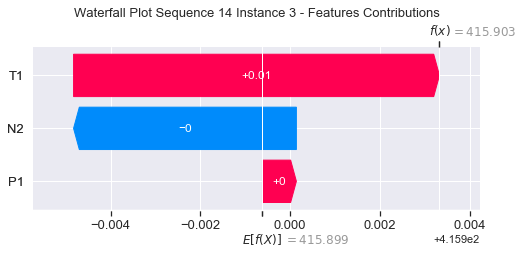

None

Contribution: [0.00108353 0.00728496 0.00279725]


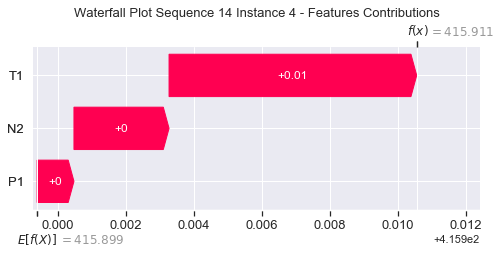

None

Contribution: [0.00340923 0.00906221 0.00853946]


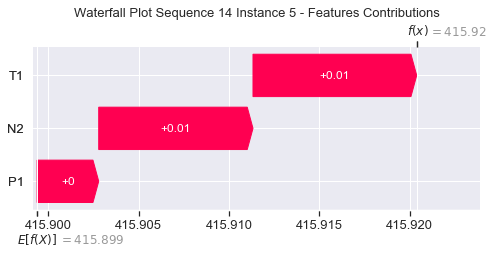

None

Contribution: [0.00477551 0.01517498 0.01155254]


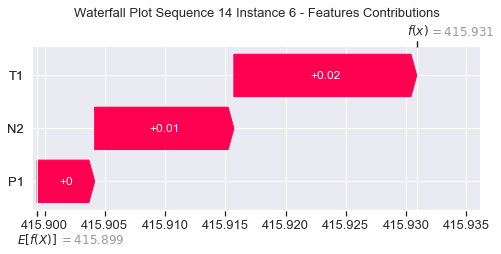

None

Contribution: [0.00590486 0.01930022 0.01533448]


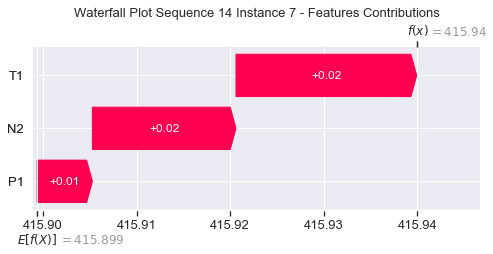

None

Contribution: [0.007367   0.02233014 0.01987869]


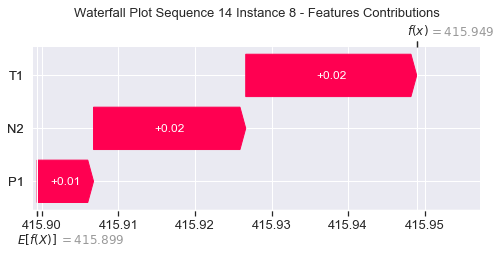

None

Contribution: [0.00946866 0.01979471 0.02445283]


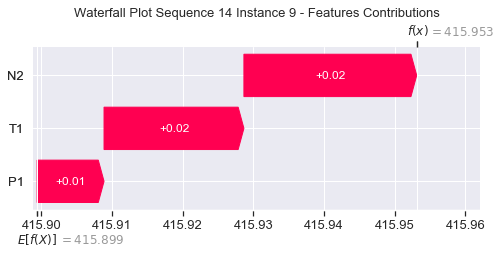

None

Contribution: [0.01276926 0.02233564 0.02947915]


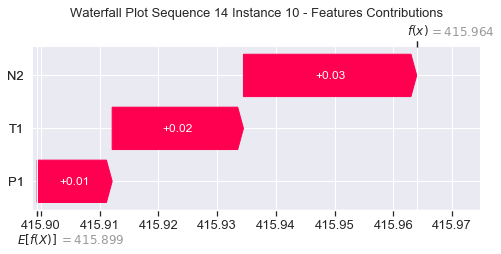

None

Contribution: [0.01432278 0.02499813 0.03695587]


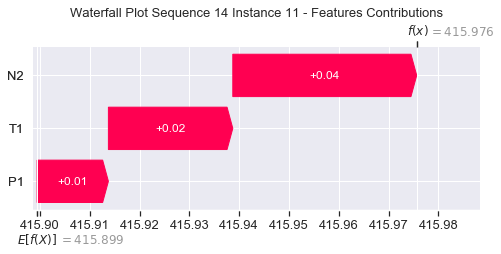

None

Contribution: [0.01594701 0.03422102 0.04521057]


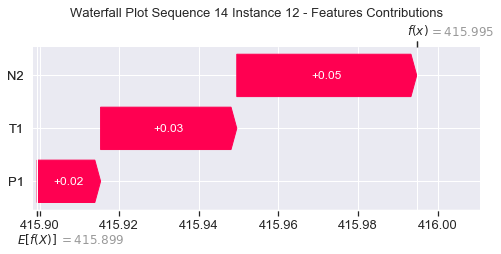

None

Contribution: [0.01812173 0.03162643 0.05362264]


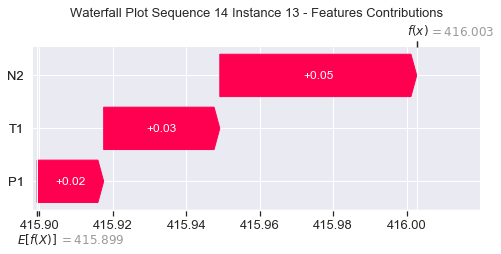

None

Contribution: [0.02100732 0.02718935 0.06404387]


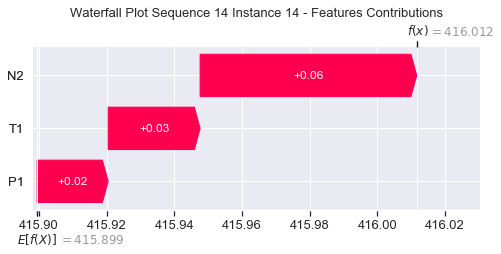

None

Contribution: [0.02506944 0.01744848 0.0766978 ]


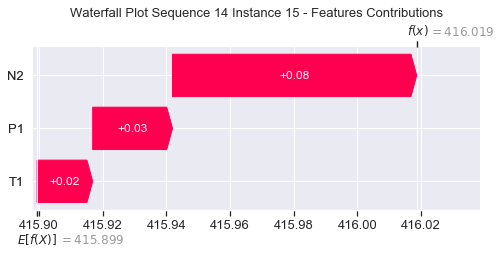

None

Contribution: [ 0.02870009 -0.01111211  0.09433523]


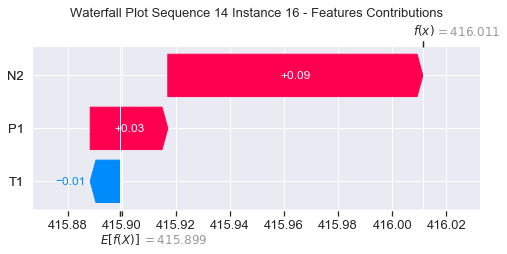

None

Contribution: [ 0.03618892 -0.03349373  0.11657792]


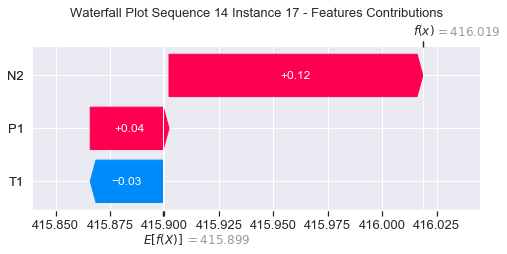

None

Contribution: [ 0.04356106 -0.09336827  0.14751612]


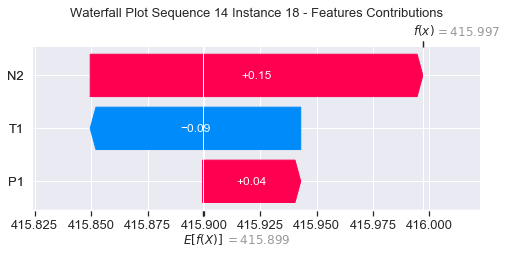

None

Contribution: [ 0.04976382 -0.24187853  0.20247282]


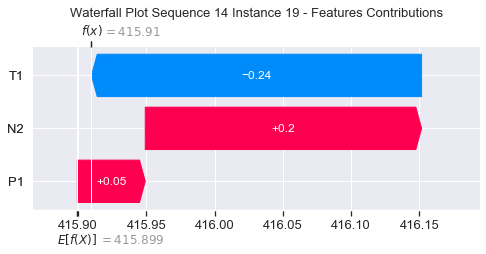

None

Contribution: [ 0.07081009 -0.35282381  0.25625926]


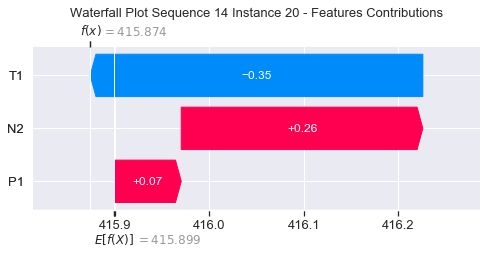

None

Contribution: [ 0.09538522 -0.63428263  0.3608315 ]


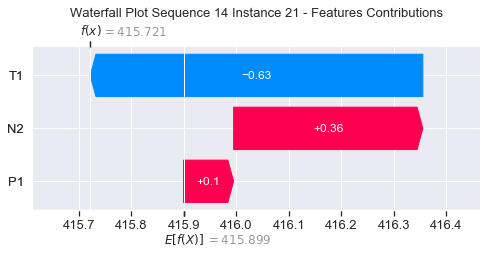

None

Contribution: [ 0.12803402 -1.38962656  0.63884592]


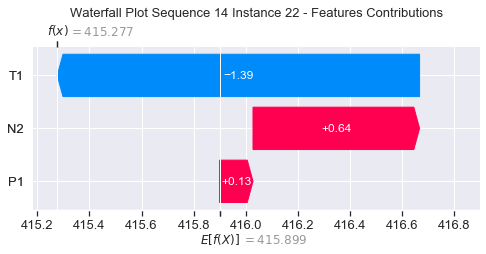

None

Contribution: [ 0.05607234 -1.60595606  0.76016822]


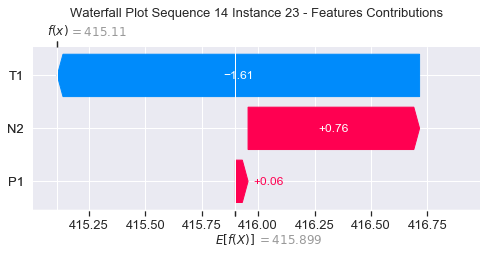

None

Contribution: [ 0.38170022 -5.89896172  2.38360129]


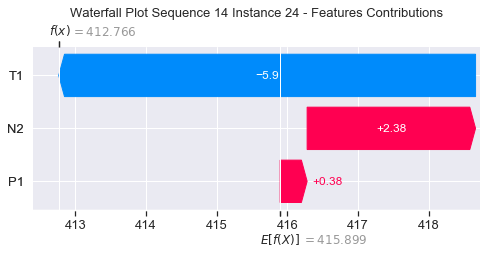

None

Contribution: [ 0.00551533  0.29845056 -0.0189219 ]


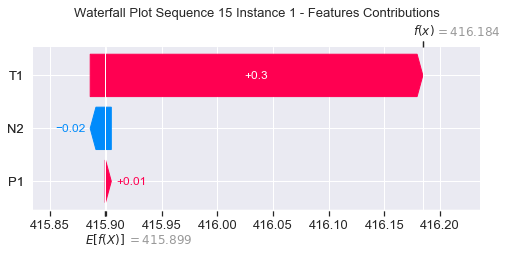

None

Contribution: [0.00186836 0.03141852 0.00063609]


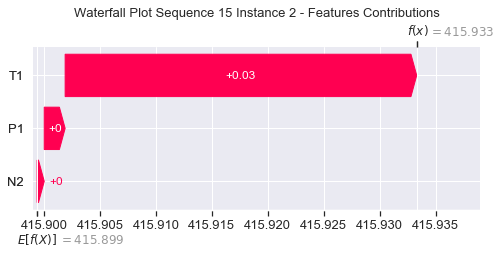

None

Contribution: [ 0.00010478  0.01384712 -0.00458518]


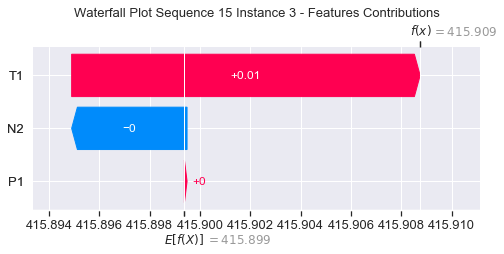

None

Contribution: [0.00305008 0.01416398 0.00353085]


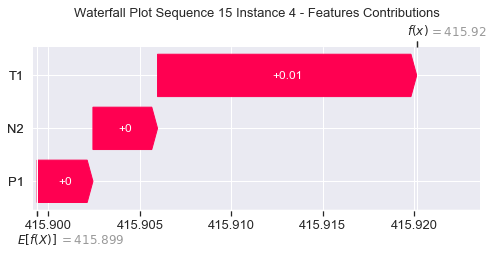

None

Contribution: [0.00383652 0.01521947 0.0083229 ]


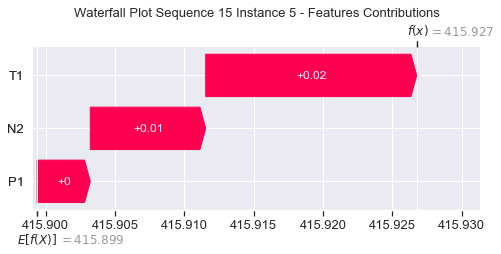

None

Contribution: [0.00426271 0.02261018 0.01089776]


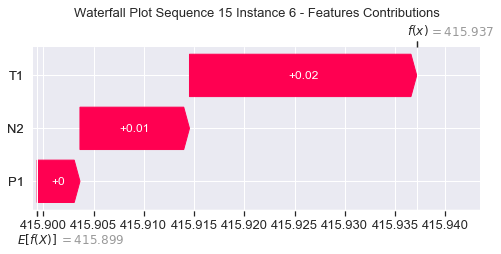

None

Contribution: [0.00546842 0.02650793 0.01458703]


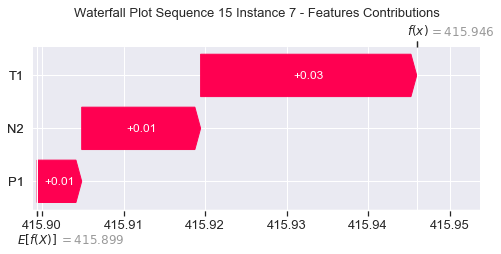

None

Contribution: [0.00726917 0.0303631  0.01926945]


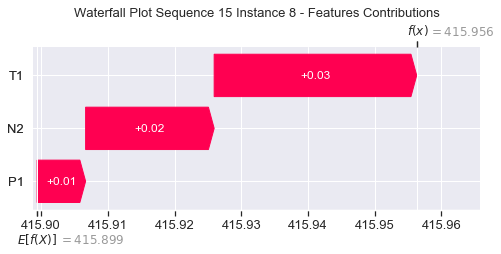

None

Contribution: [0.01176686 0.02969003 0.02417384]


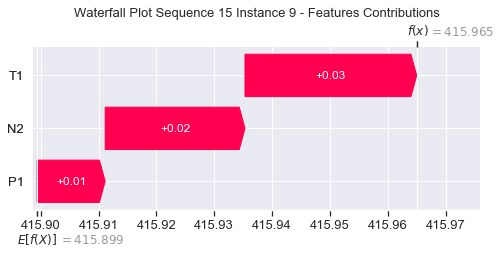

None

Contribution: [0.01305091 0.03185351 0.02892952]


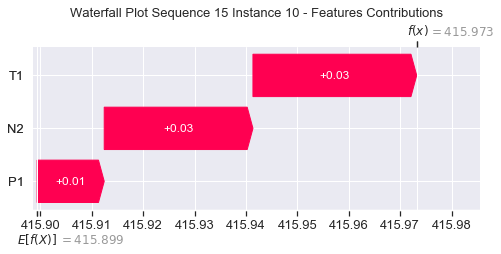

None

Contribution: [0.01657402 0.03478648 0.03721099]


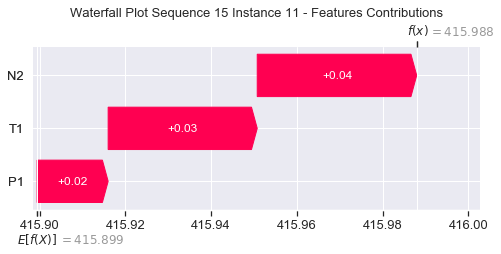

None

Contribution: [0.01620744 0.03616416 0.04502306]


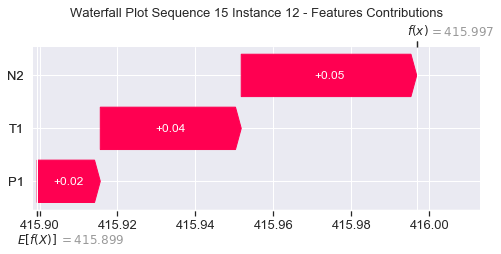

None

Contribution: [0.01836576 0.03278606 0.05337815]


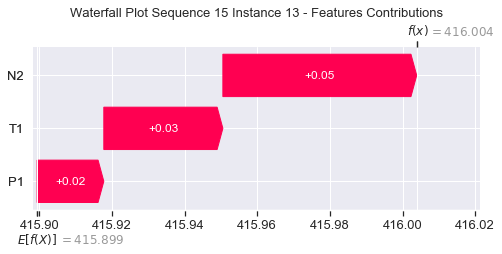

None

Contribution: [0.01995641 0.02812485 0.06282204]


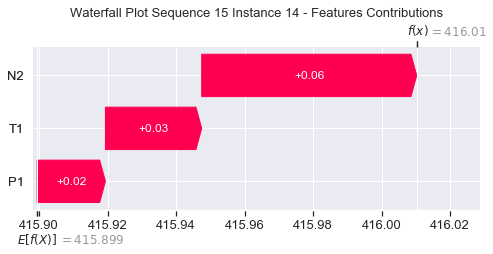

None

Contribution: [0.02513873 0.0164343  0.07664734]


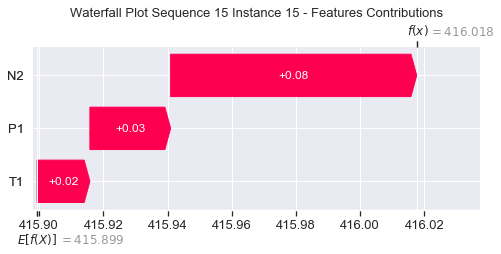

None

Contribution: [0.02944215 0.00034923 0.0945199 ]


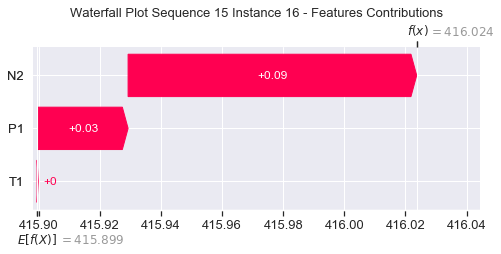

None

Contribution: [ 0.03634904 -0.03323667  0.11770378]


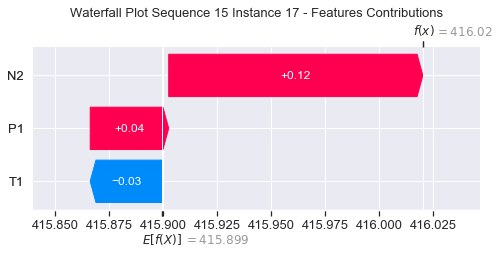

None

Contribution: [ 0.0445395  -0.09171939  0.14972068]


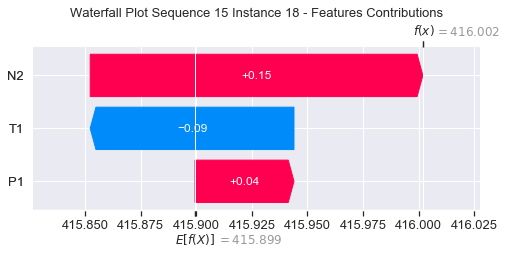

None

Contribution: [ 0.05100231 -0.18069261  0.19780787]


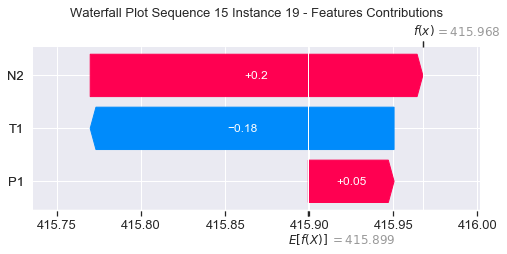

None

Contribution: [ 0.06865739 -0.33704277  0.26119991]


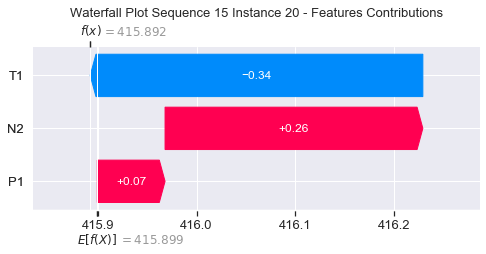

None

Contribution: [ 0.08573342 -0.59377983  0.36568774]


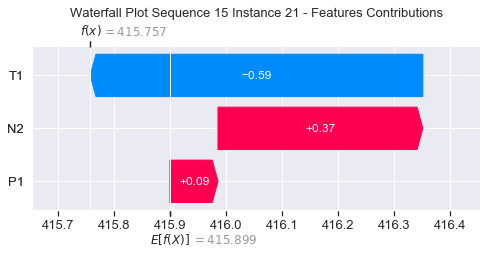

None

Contribution: [ 0.08864117 -1.28817756  0.63869878]


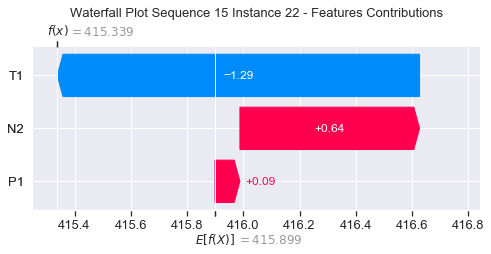

None

Contribution: [ 0.0341891  -1.47726894  0.76185212]


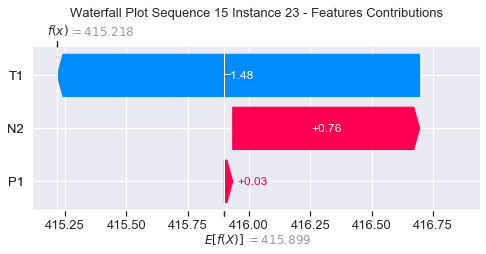

None

Contribution: [ 0.43555256 -5.61720949  2.49738152]


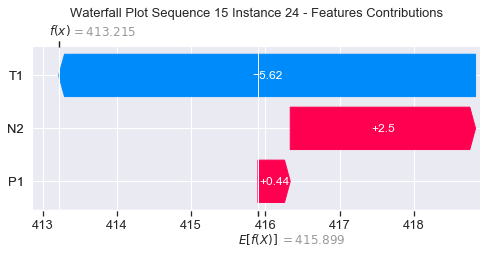

None

Contribution: [ 0.00079016  0.29544136 -0.0246355 ]


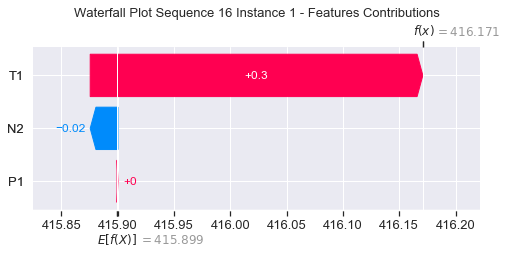

None

Contribution: [0.00193267 0.03074647 0.00071956]


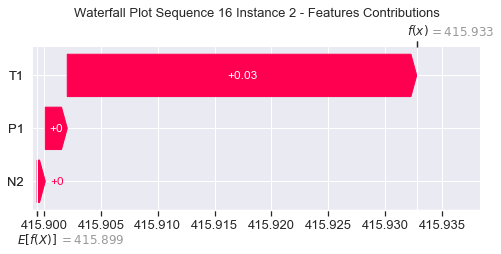

None

Contribution: [ 0.00112212  0.01125197 -0.00473741]


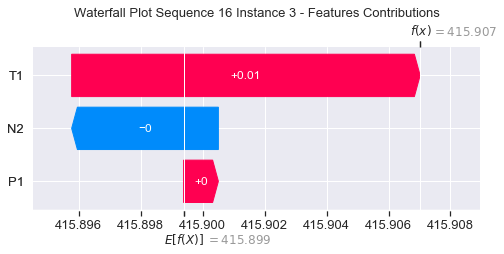

None

Contribution: [0.00182269 0.00970249 0.00349948]


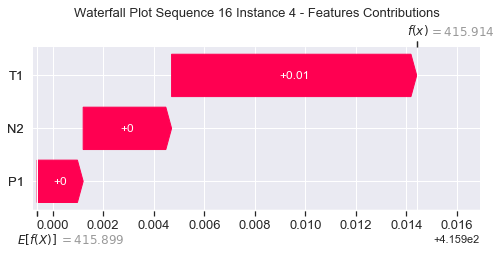

None

Contribution: [0.00321161 0.01663505 0.00841007]


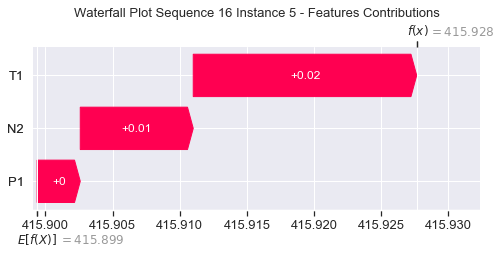

None

Contribution: [0.00390879 0.02397908 0.01108579]


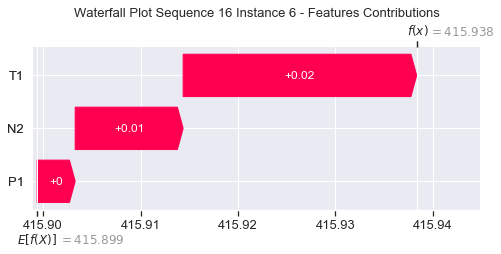

None

Contribution: [0.00532368 0.02827288 0.01484803]


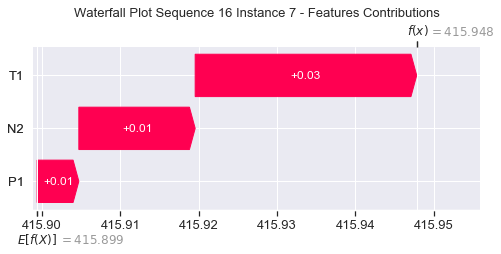

None

Contribution: [0.00687348 0.03359614 0.01953873]


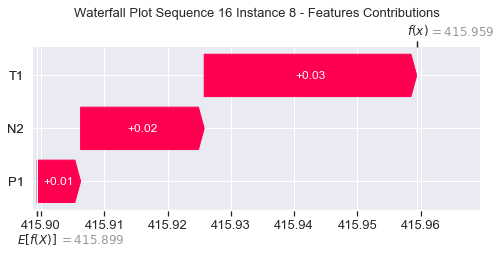

None

Contribution: [0.0108507  0.03904106 0.02414486]


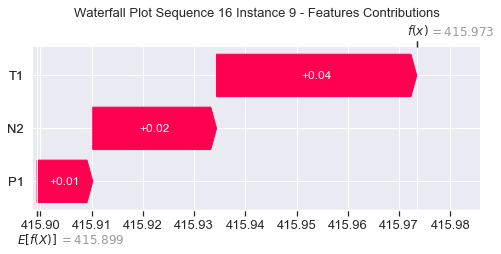

None

Contribution: [0.01411619 0.03451114 0.02937555]


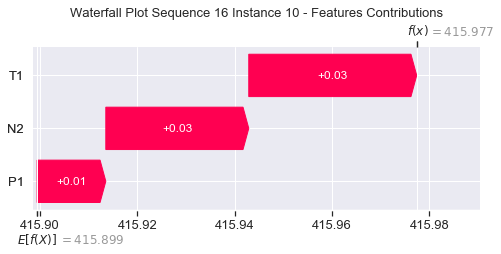

None

Contribution: [0.01445521 0.04507819 0.03653938]


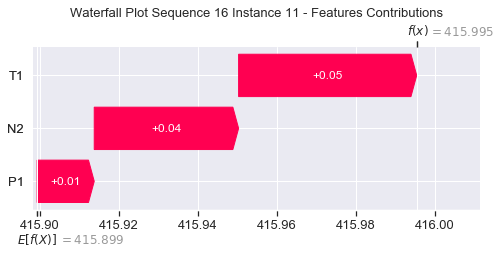

None

Contribution: [0.01612711 0.04050147 0.04466298]


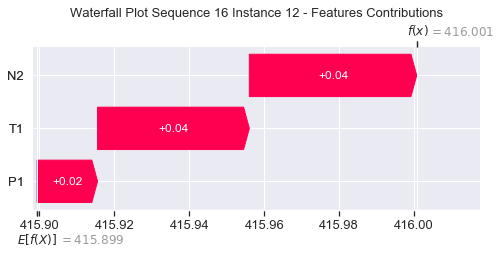

None

Contribution: [0.01851097 0.03539528 0.05334112]


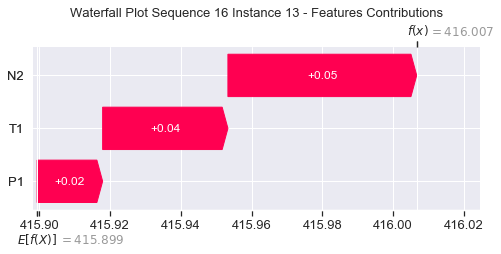

None

Contribution: [0.02195427 0.02793864 0.0639116 ]


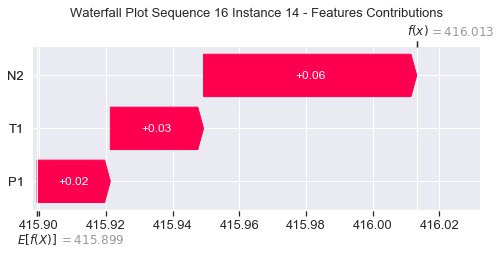

None

Contribution: [0.02517588 0.01331277 0.07690203]


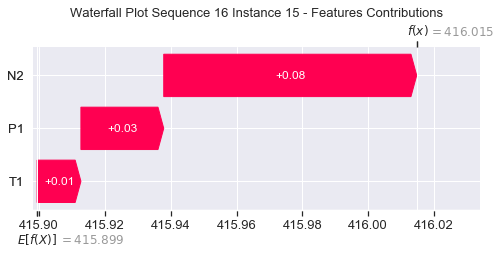

None

Contribution: [ 0.02777348 -0.01854111  0.09392433]


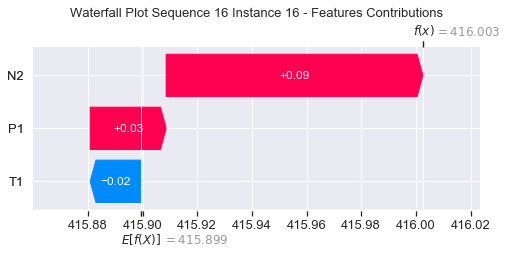

None

Contribution: [ 0.03542597 -0.05015659  0.11713473]


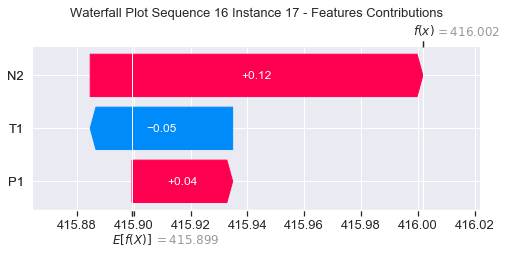

None

Contribution: [ 0.04250027 -0.12106581  0.1478153 ]


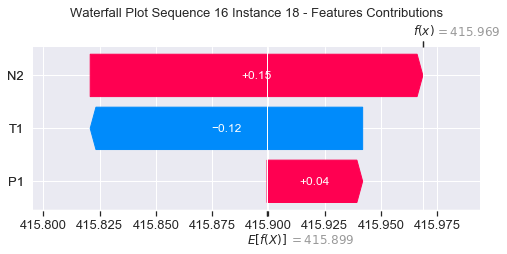

None

Contribution: [ 0.04952174 -0.26519081  0.1941224 ]


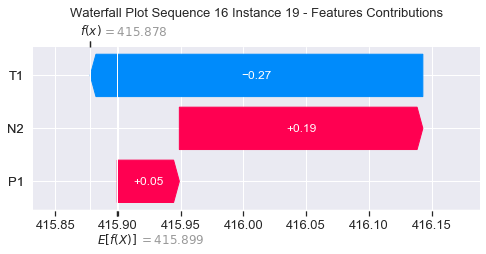

None

Contribution: [ 0.06312667 -0.41794295  0.25020634]


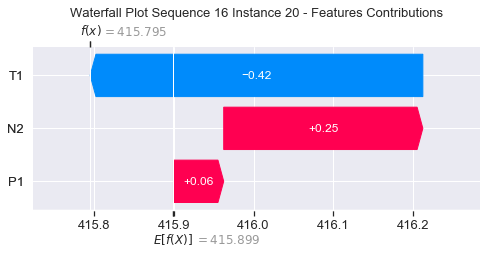

None

Contribution: [ 0.07943664 -0.74145483  0.34984396]


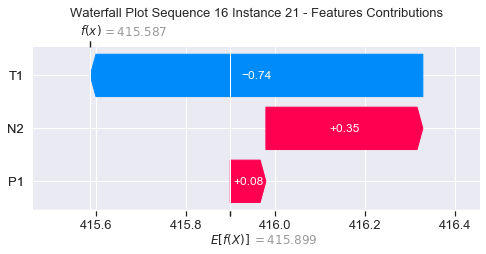

None

Contribution: [ 0.09493467 -1.64851719  0.6094132 ]


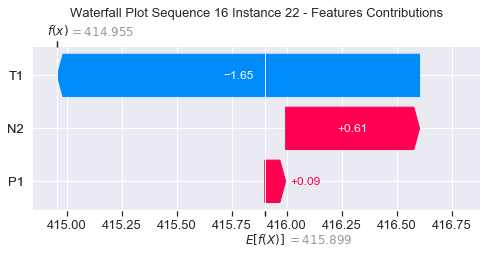

None

Contribution: [ 0.03072051 -1.8468927   0.72818126]


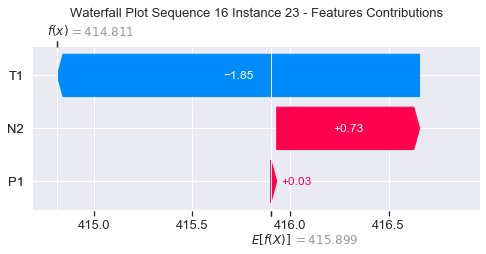

None

Contribution: [ 0.43808206 -6.68474095  2.34622411]


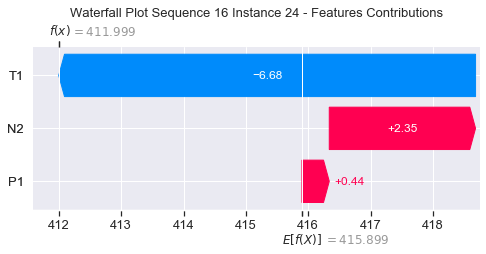

None

Contribution: [ 0.00188419  0.2989502  -0.02344364]


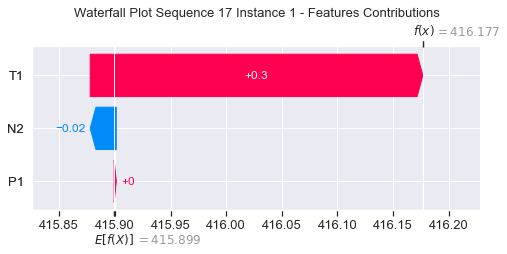

None

Contribution: [0.00192775 0.0319498  0.00084851]


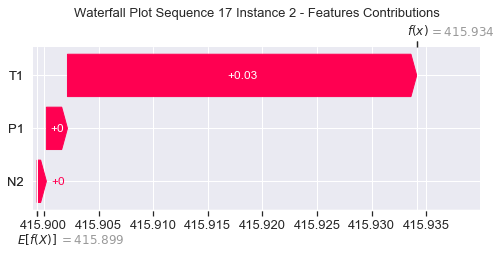

None

Contribution: [-0.0007073   0.0165032  -0.00485185]


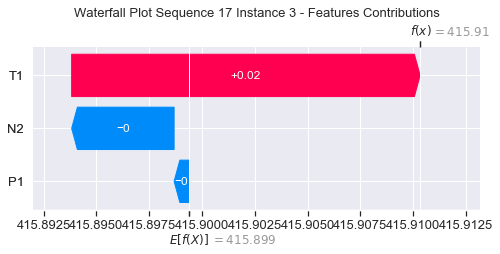

None

Contribution: [0.00069976 0.01458626 0.00286851]


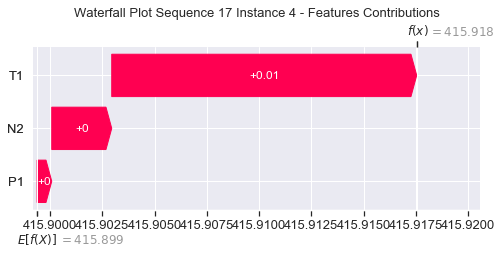

None

Contribution: [0.00332009 0.02200837 0.00885855]


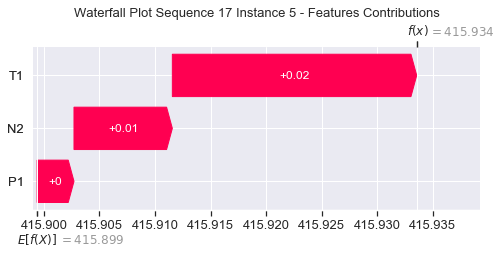

None

Contribution: [0.004843   0.02978074 0.01199045]


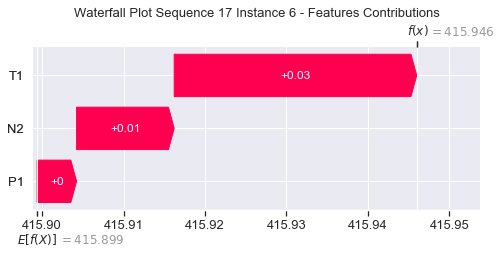

None

Contribution: [0.00609405 0.03588538 0.01585979]


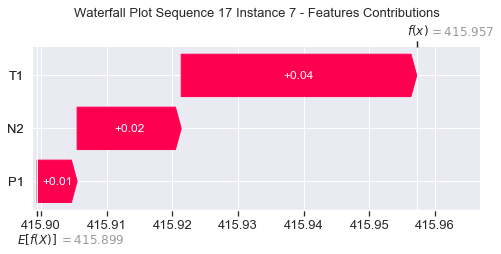

None

Contribution: [0.00771553 0.04021841 0.02056648]


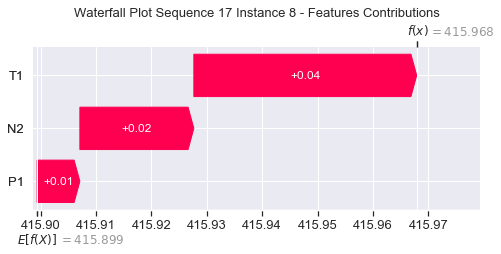

None

Contribution: [0.01102288 0.04358674 0.02593113]


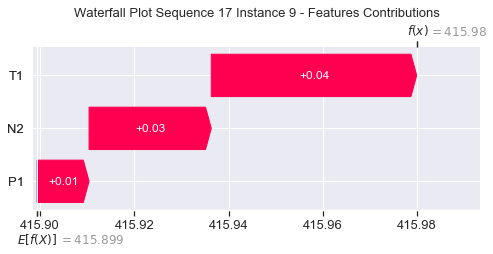

None

Contribution: [0.01522688 0.04058816 0.02893147]


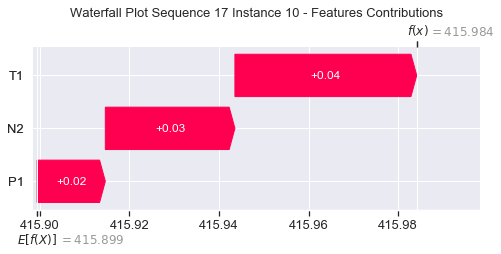

None

Contribution: [0.015672   0.044197   0.03843054]


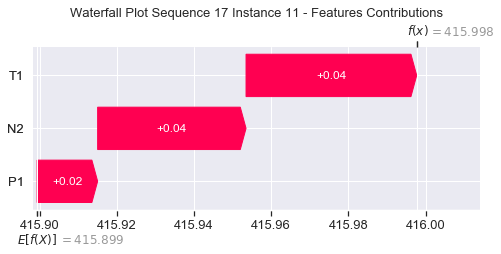

None

Contribution: [0.01610135 0.04513565 0.04558124]


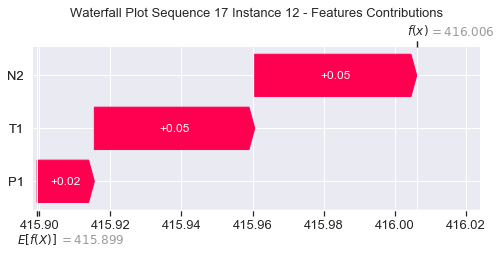

None

Contribution: [0.0183411  0.03872083 0.05396603]


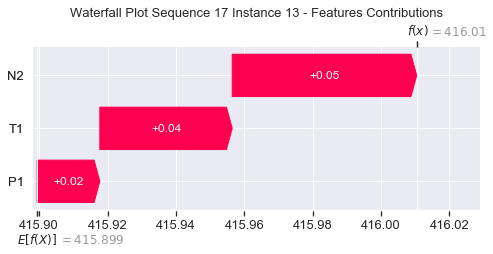

None

Contribution: [0.02299385 0.02869184 0.06427735]


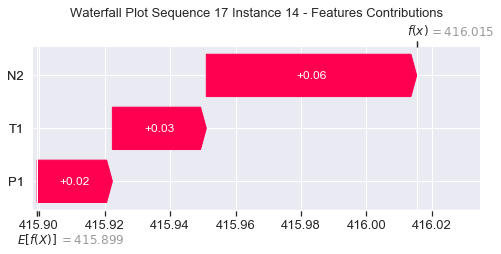

None

Contribution: [0.02517749 0.01010246 0.07698835]


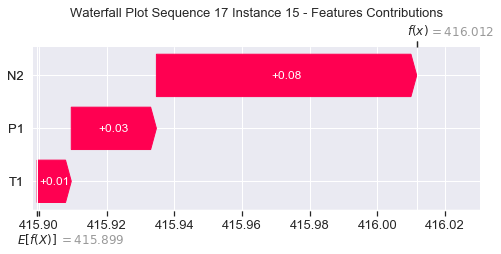

None

Contribution: [ 0.03074997 -0.01581913  0.09493237]


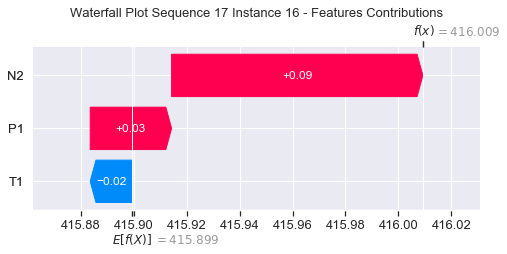

None

Contribution: [ 0.03564868 -0.06996929  0.11711485]


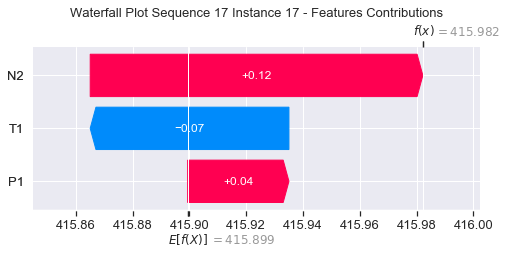

None

Contribution: [ 0.0421185  -0.15195677  0.14823625]


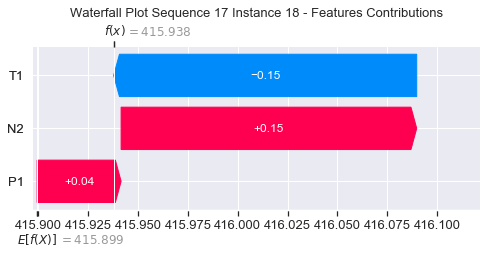

None

Contribution: [ 0.04961124 -0.25029005  0.19905317]


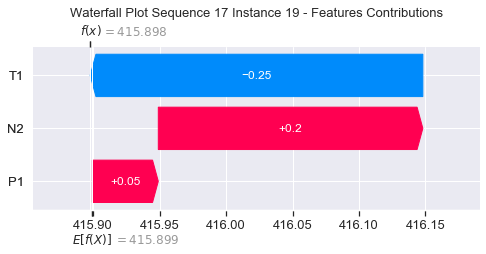

None

Contribution: [ 0.06524564 -0.50428956  0.25728206]


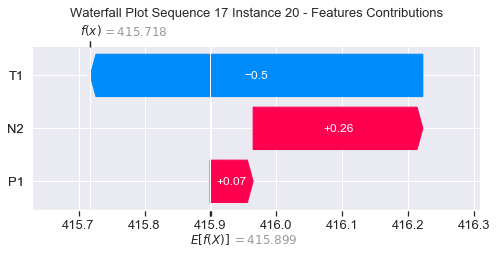

None

Contribution: [ 0.08730726 -0.87328429  0.36343009]


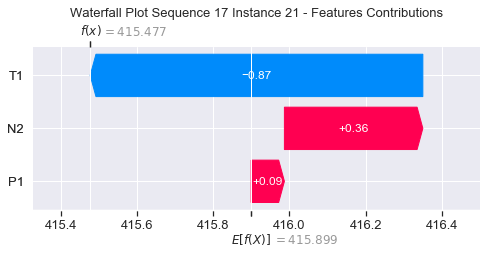

None

Contribution: [ 0.11672647 -1.86459398  0.64637436]


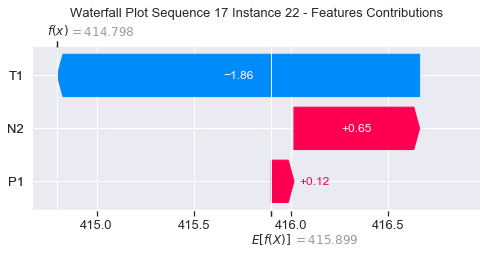

None

Contribution: [ 0.04029751 -2.01616239  0.76729351]


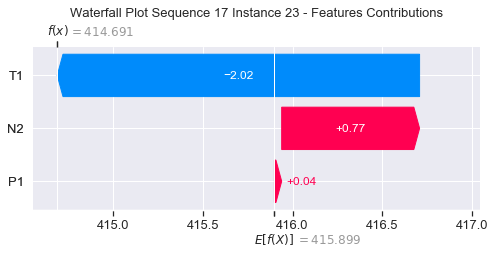

None

Contribution: [ 0.57037605 -7.5855305   2.50791519]


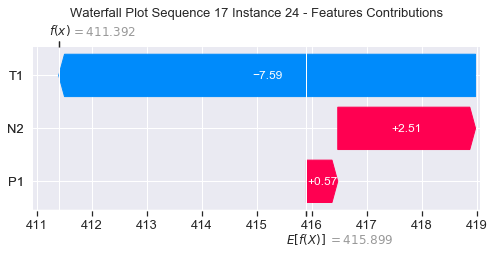

None

Contribution: [-0.0042109   0.32200584 -0.02398791]


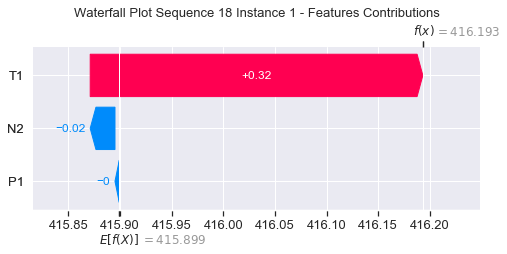

None

Contribution: [0.00185427 0.03192229 0.00060034]


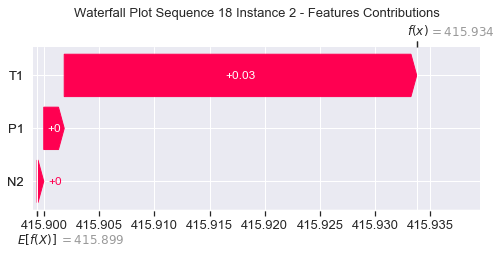

None

Contribution: [-0.00099195  0.01708817 -0.00523095]


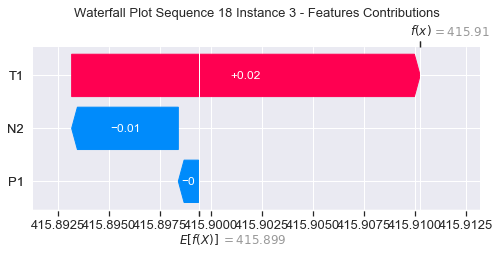

None

Contribution: [0.00226754 0.01738314 0.00315594]


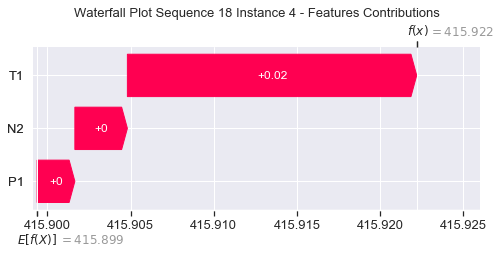

None

Contribution: [0.0030015  0.02074528 0.00789599]


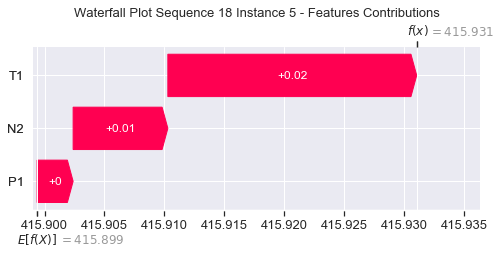

None

Contribution: [0.00286401 0.02646504 0.01017621]


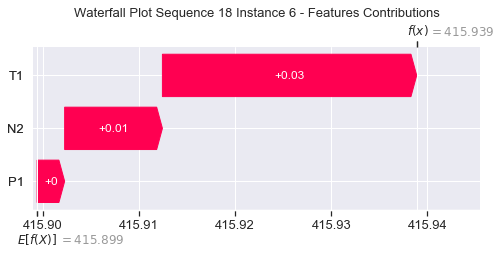

None

Contribution: [0.00326523 0.03131047 0.01366134]


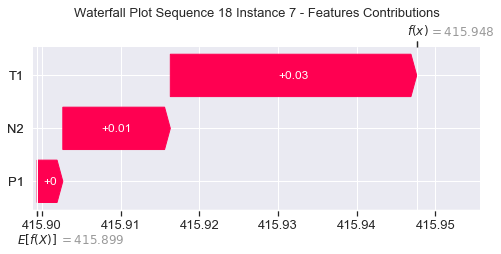

None

Contribution: [0.00512876 0.03543719 0.01831328]


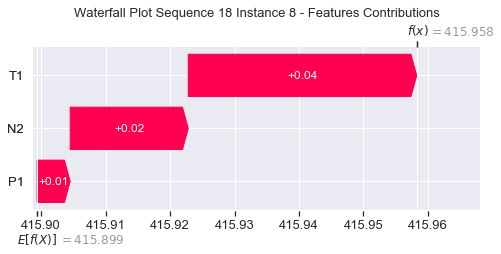

None

Contribution: [0.00903192 0.03496783 0.02337456]


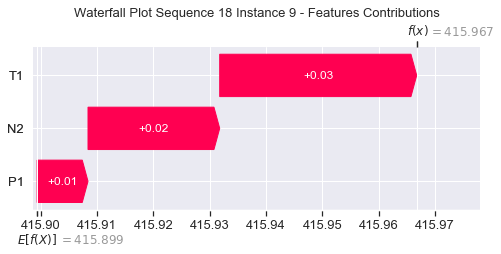

None

Contribution: [0.00982669 0.03796628 0.02871436]


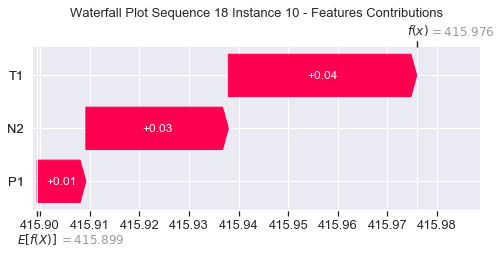

None

Contribution: [0.01317472 0.03751377 0.03559236]


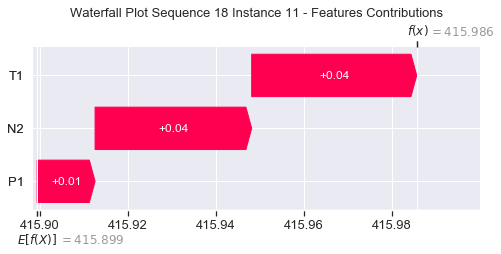

None

Contribution: [0.01048361 0.03917222 0.04272856]


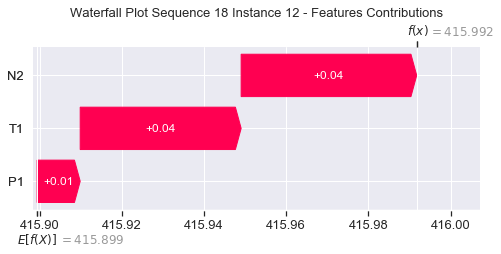

None

Contribution: [0.01390154 0.03506533 0.05160209]


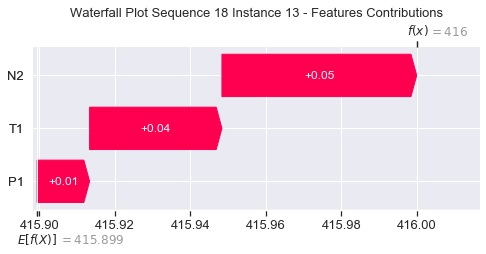

None

Contribution: [0.02042849 0.02742364 0.0628921 ]


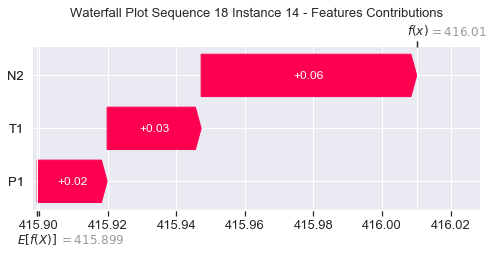

None

Contribution: [0.02449358 0.01388917 0.07615596]


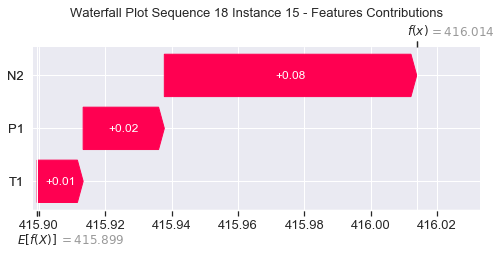

None

Contribution: [ 0.02934225 -0.00447917  0.09373835]


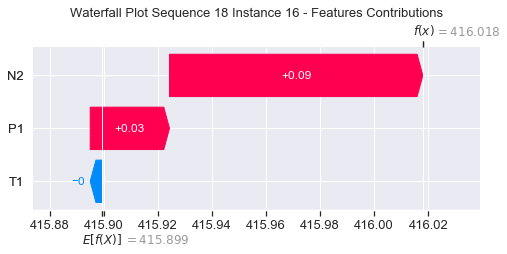

None

Contribution: [ 0.04299643 -0.04833053  0.11904737]


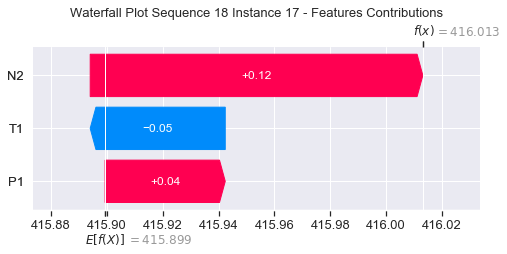

None

Contribution: [ 0.05634009 -0.11676526  0.15226863]


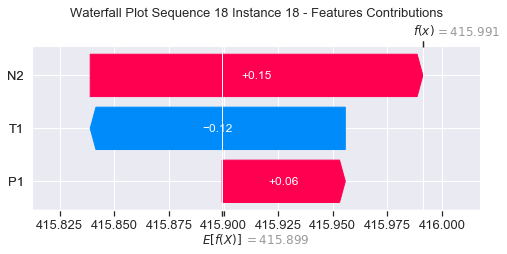

None

Contribution: [ 0.06514674 -0.24339277  0.20340411]


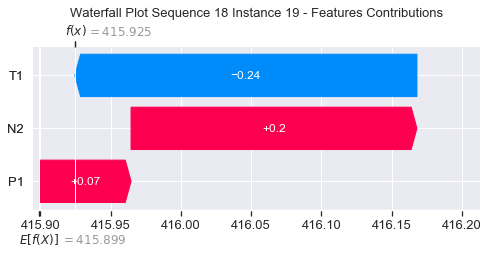

None

Contribution: [ 0.09112007 -0.43660344  0.26342178]


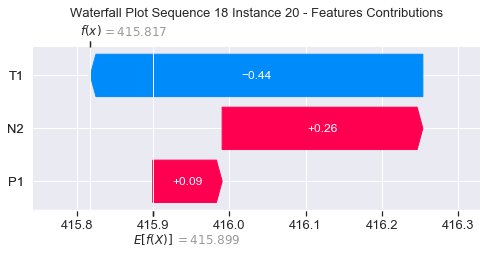

None

Contribution: [ 0.12992016 -0.76213285  0.37126416]


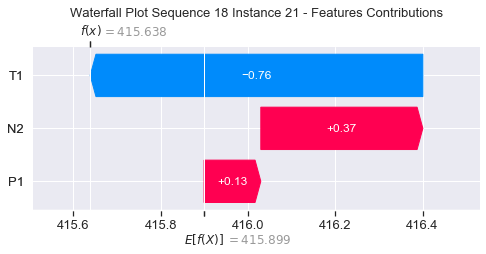

None

Contribution: [ 0.18094811 -1.67534549  0.65075767]


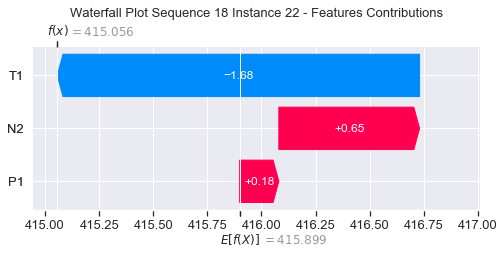

None

Contribution: [ 0.13481426 -1.80803429  0.77661694]


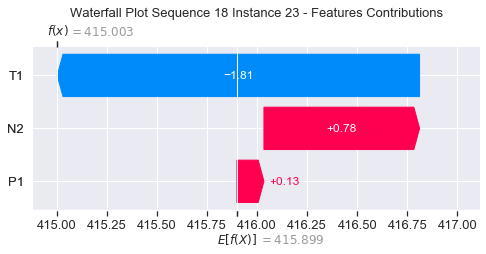

None

Contribution: [ 0.70276745 -7.0188368   2.47669184]


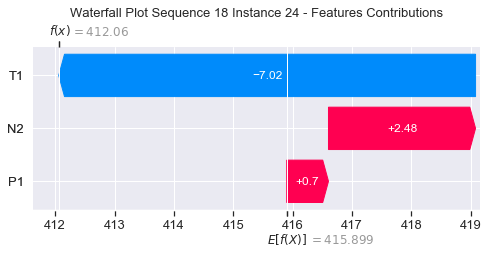

None

Contribution: [-0.00675564  0.30996391 -0.0240567 ]


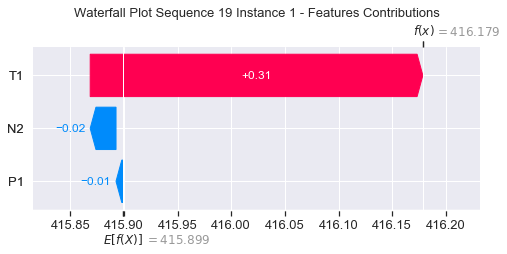

None

Contribution: [0.00179707 0.03172435 0.00063708]


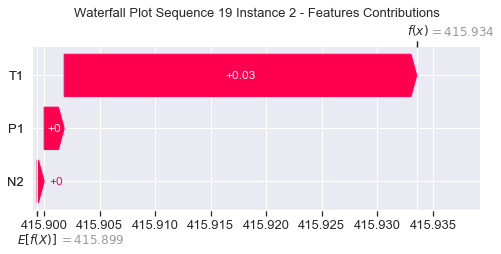

None

Contribution: [ 0.00062024  0.01601427 -0.00448575]


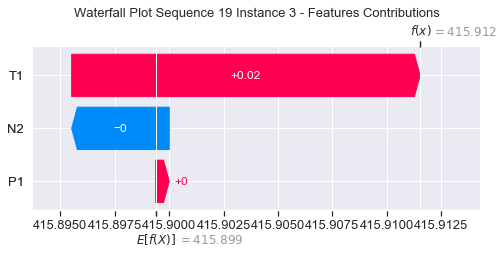

None

Contribution: [0.0012137  0.01534255 0.00286533]


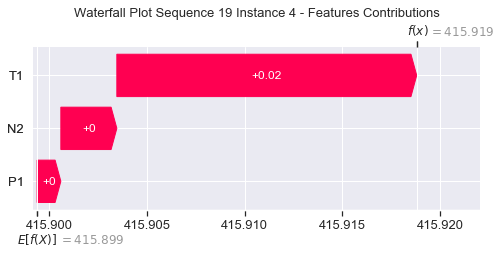

None

Contribution: [0.00240862 0.02007319 0.00788754]


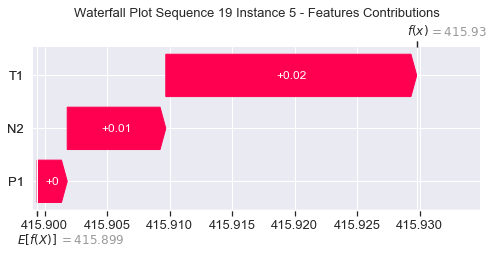

None

Contribution: [0.00361225 0.02763737 0.01120302]


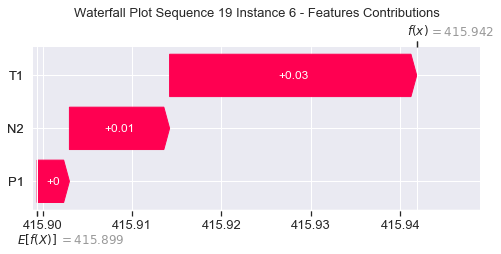

None

Contribution: [0.00421383 0.03237819 0.01488087]


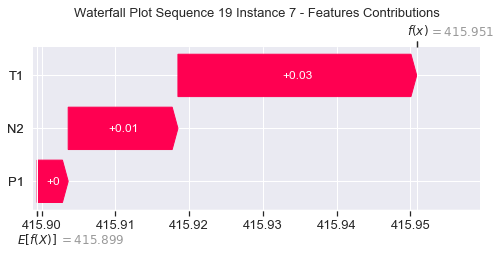

None

Contribution: [0.00583884 0.03708792 0.01947629]


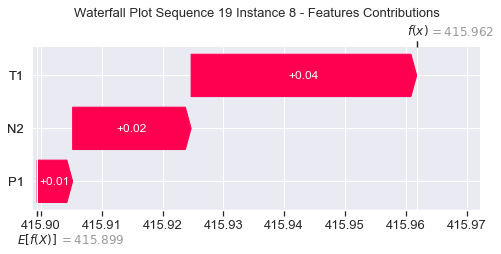

None

Contribution: [0.00900224 0.0376228  0.02332565]


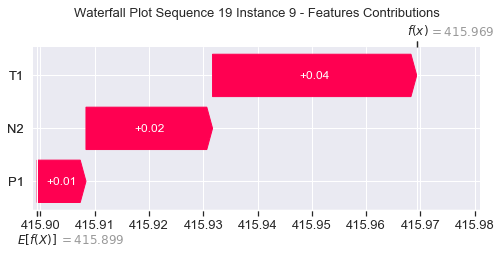

None

Contribution: [0.01140097 0.03856009 0.02902659]


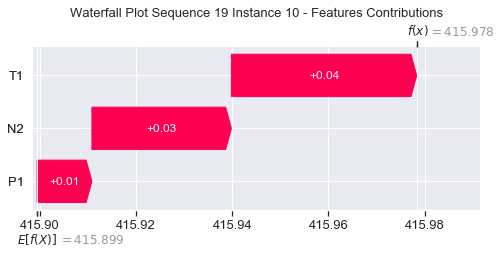

None

Contribution: [0.01482305 0.04318712 0.03663262]


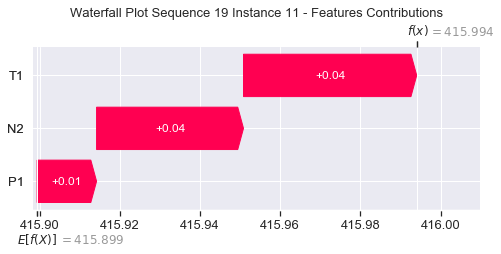

None

Contribution: [0.01392818 0.04295864 0.04509707]


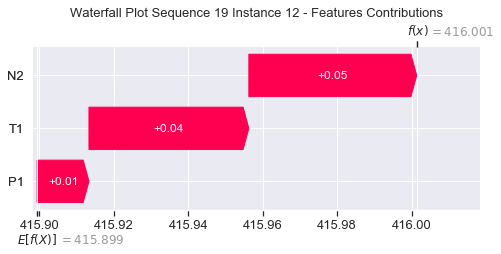

None

Contribution: [0.01619452 0.03708128 0.05340105]


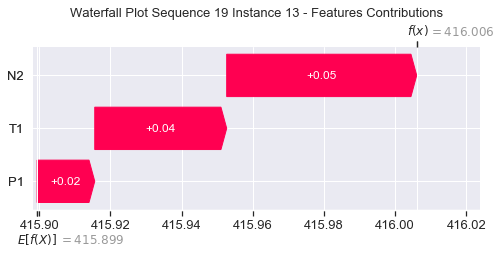

None

Contribution: [0.01933143 0.02800814 0.06253912]


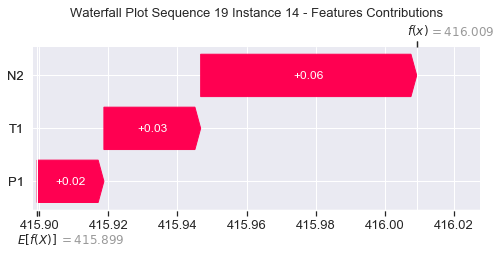

None

Contribution: [0.02473024 0.01198237 0.07660198]


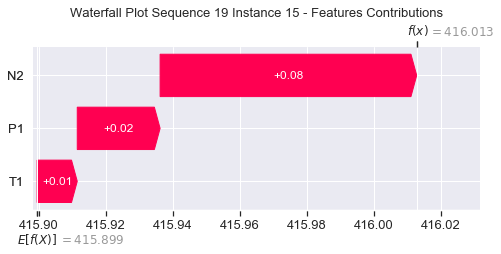

None

Contribution: [ 0.02997917 -0.00935478  0.09378729]


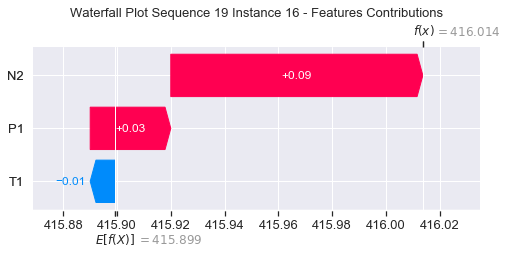

None

Contribution: [ 0.04117858 -0.05721244  0.11587136]


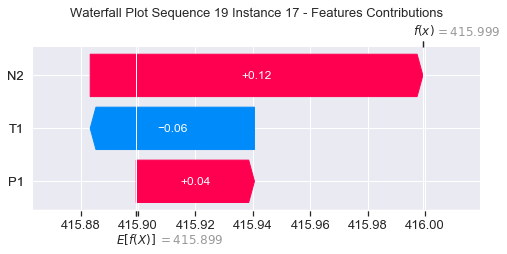

None

Contribution: [ 0.05362361 -0.13265503  0.14517803]


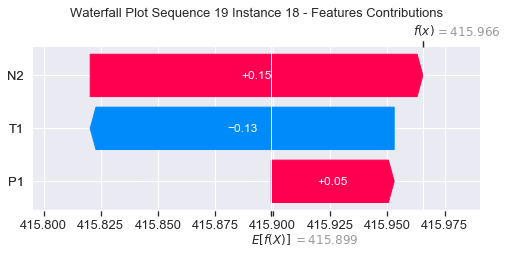

None

Contribution: [ 0.04785408 -0.26043436  0.18817816]


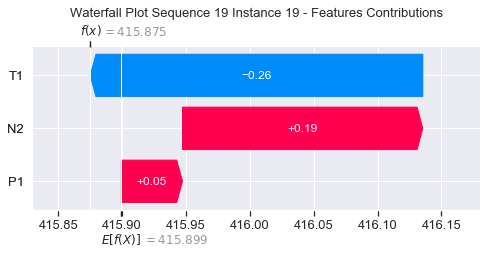

None

Contribution: [ 0.10578914 -0.44716182  0.24746329]


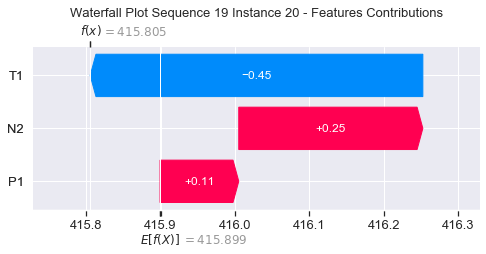

None

Contribution: [ 0.15544273 -0.78835034  0.34585925]


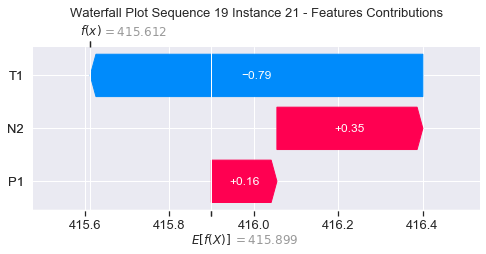

None

Contribution: [ 0.253497   -1.74089364  0.60068912]


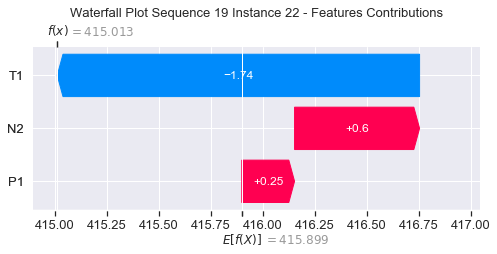

None

Contribution: [ 0.18610304 -1.92517906  0.70509911]


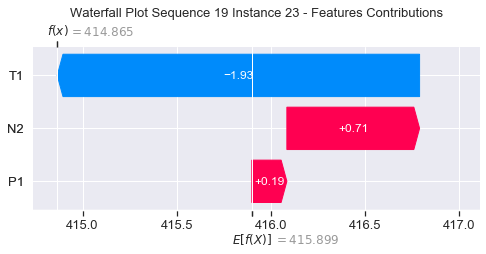

None

Contribution: [ 0.71384897 -7.47469397  2.126729  ]


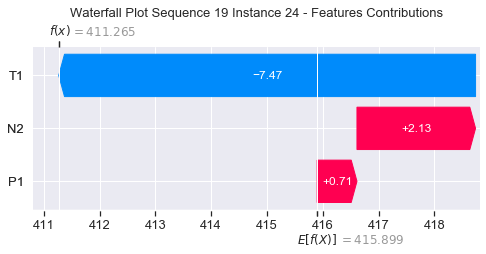

None

Contribution: [ 0.00699221  0.32073077 -0.01399129]


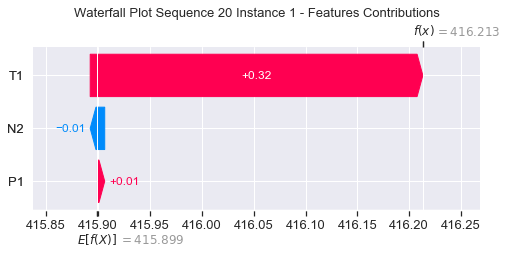

None

Contribution: [0.00175927 0.03123952 0.00087723]


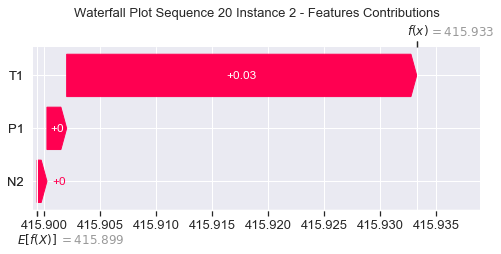

None

Contribution: [-0.00123603  0.01647804 -0.00435218]


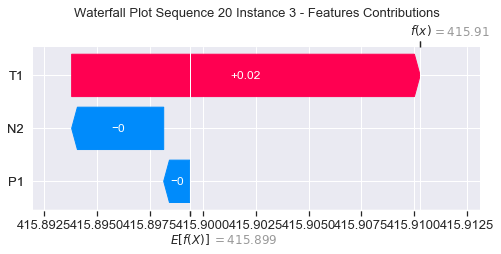

None

Contribution: [0.00203616 0.01396686 0.00382568]


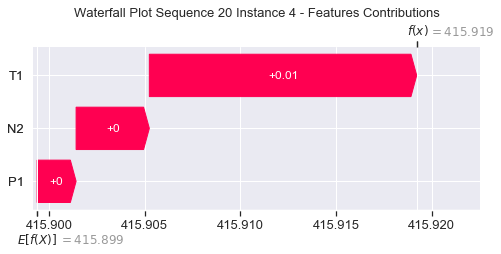

None

Contribution: [0.00144113 0.01733175 0.00814156]


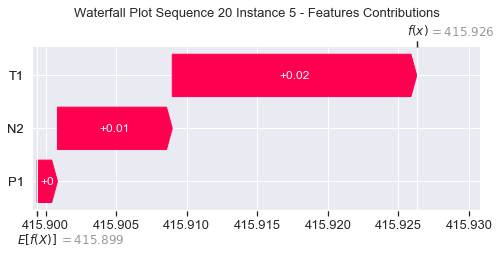

None

Contribution: [0.0033426  0.0253057  0.01144225]


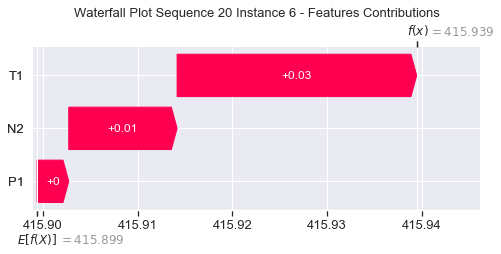

None

Contribution: [0.00401092 0.02999335 0.01485577]


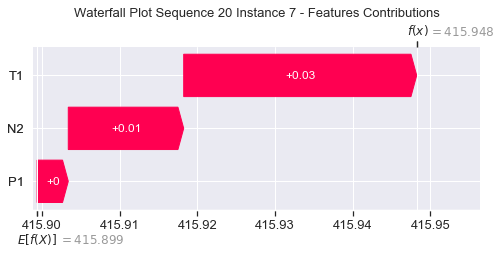

None

Contribution: [0.00562221 0.03457817 0.01973205]


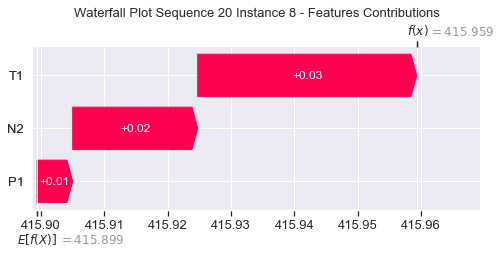

None

Contribution: [0.01045271 0.03797808 0.024     ]


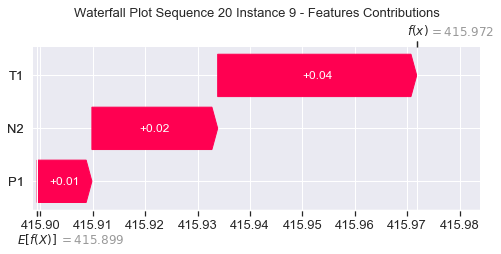

None

Contribution: [0.00962587 0.04590677 0.03042896]


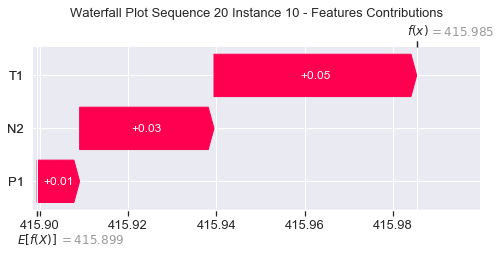

None

Contribution: [0.01601459 0.04148543 0.03834286]


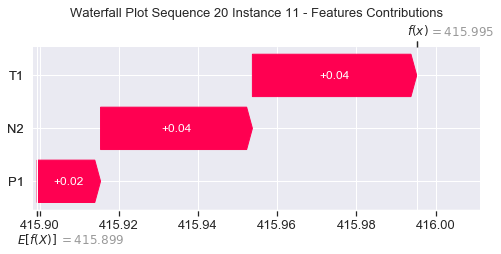

None

Contribution: [0.01300921 0.03856733 0.04504996]


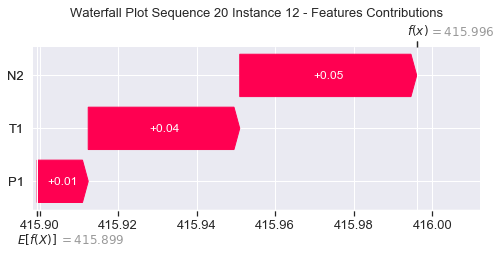

None

Contribution: [0.01543181 0.0345904  0.05323194]


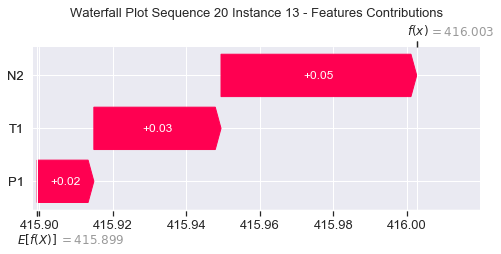

None

Contribution: [0.01981516 0.02763463 0.0633726 ]


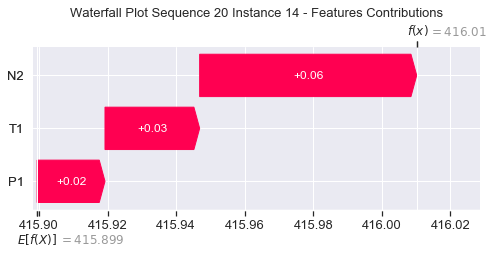

None

Contribution: [0.02469622 0.01449868 0.07661194]


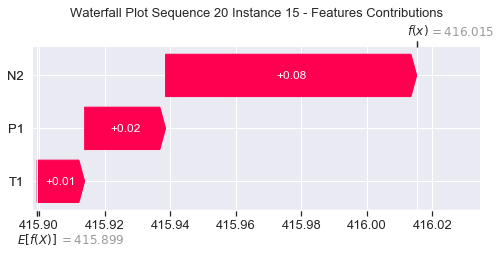

None

Contribution: [ 0.03033212 -0.01272298  0.09437548]


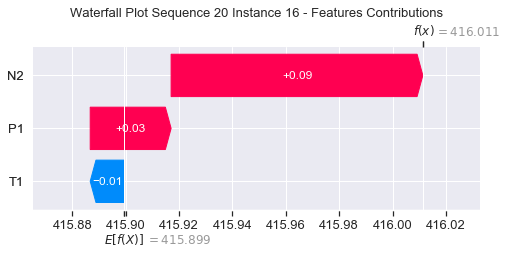

None

Contribution: [ 0.04136436 -0.04770789  0.11699219]


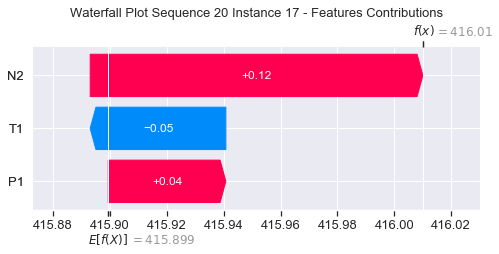

None

Contribution: [ 0.05381921 -0.11807474  0.14736627]


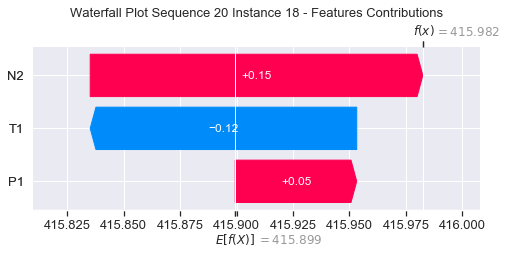

None

Contribution: [ 0.06766867 -0.23629456  0.19778584]


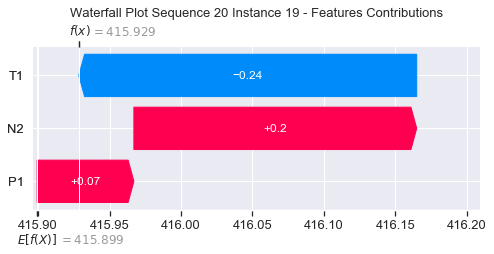

None

Contribution: [ 0.10710211 -0.42775948  0.25673722]


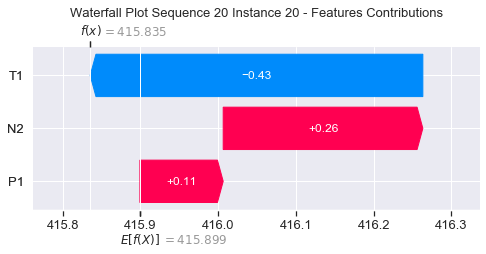

None

Contribution: [ 0.16217583 -0.73629821  0.35912245]


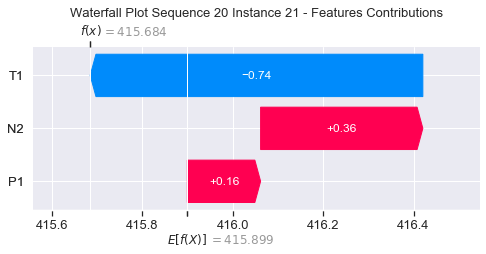

None

Contribution: [ 0.27839706 -1.58610379  0.62109919]


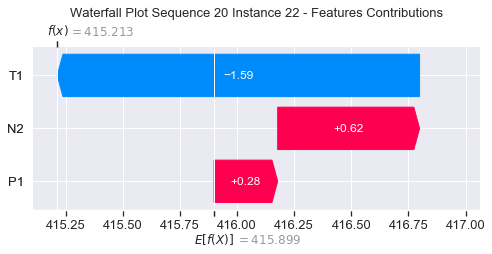

None

Contribution: [ 0.20435219 -1.79212454  0.72613085]


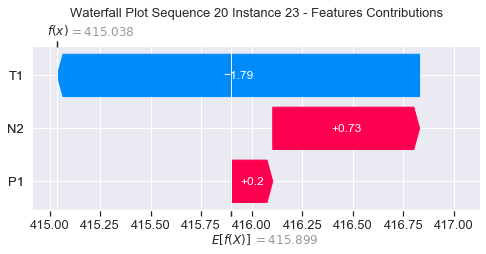

None

Contribution: [ 0.99212759 -6.90185531  2.22314181]


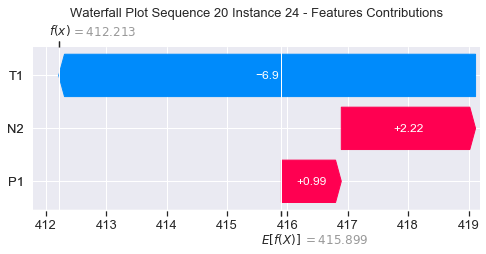

None

Contribution: [-0.0024471   0.30789158 -0.01676278]


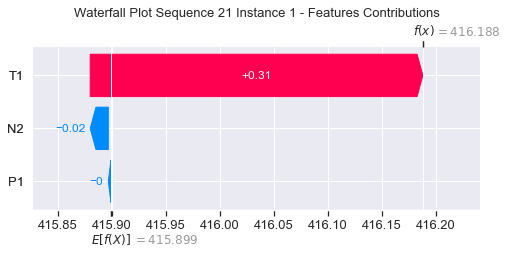

None

Contribution: [0.00167288 0.03093149 0.00067917]


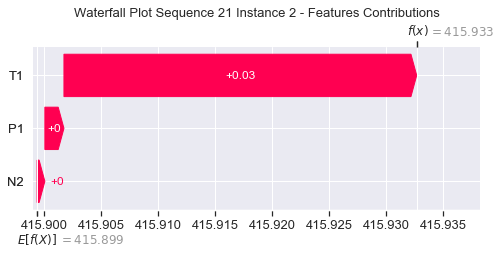

None

Contribution: [-0.00154715  0.01110243 -0.00439912]


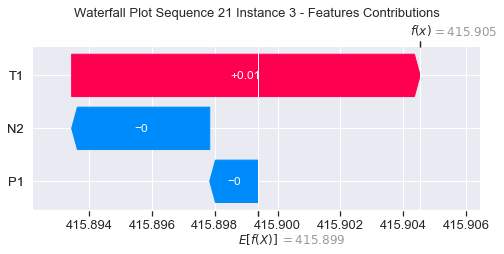

None

Contribution: [0.00014275 0.01006707 0.00363865]


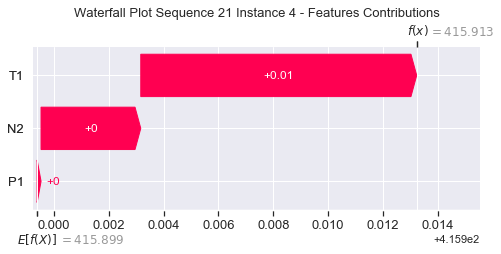

None

Contribution: [0.00189775 0.01777487 0.00840911]


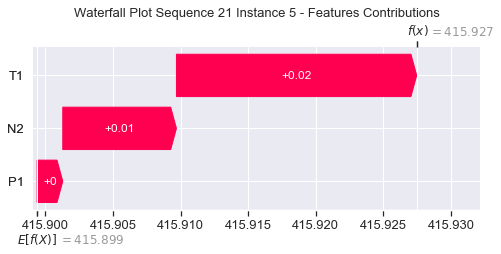

None

Contribution: [0.0014388  0.02307893 0.01093028]


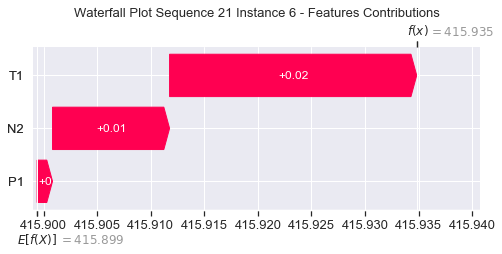

None

Contribution: [0.00253277 0.02822233 0.0146693 ]


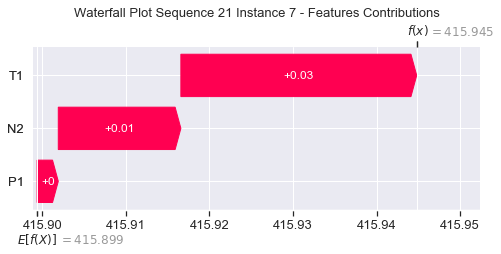

None

Contribution: [0.00363086 0.03305289 0.01917021]


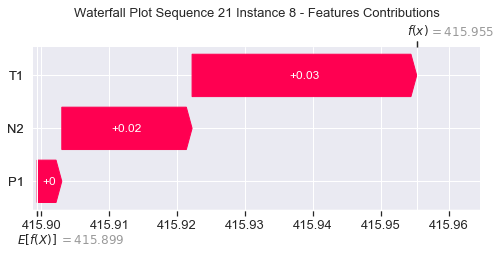

None

Contribution: [0.00696046 0.03713091 0.02397378]


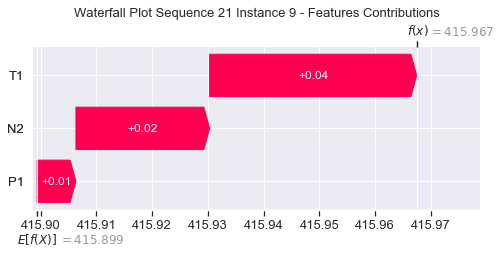

None

Contribution: [0.0167122  0.03829719 0.0297706 ]


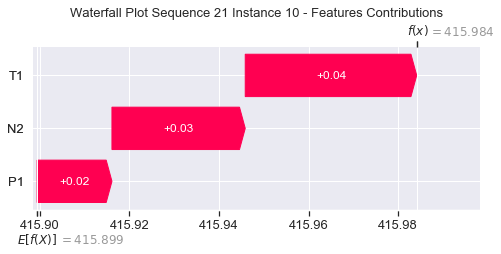

None

Contribution: [0.00991099 0.03995834 0.03586308]


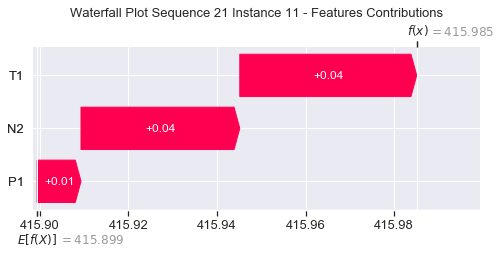

None

Contribution: [0.01342059 0.04161335 0.0440851 ]


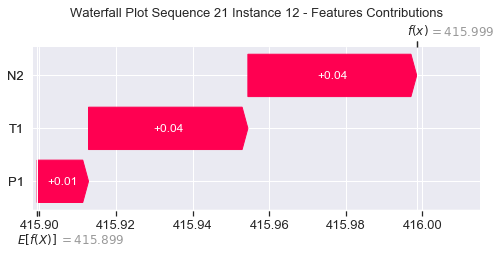

None

Contribution: [0.01616281 0.03661164 0.0526412 ]


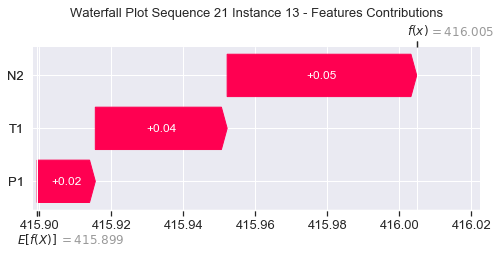

None

Contribution: [0.01818775 0.02784081 0.06229426]


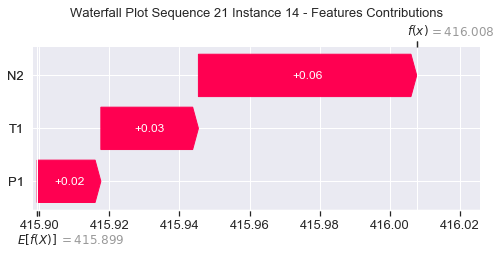

None

Contribution: [0.02455115 0.01203654 0.07611694]


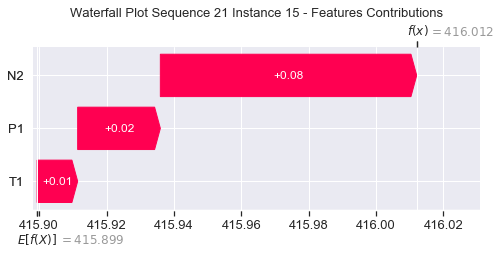

None

Contribution: [ 0.03075332 -0.01159852  0.09418028]


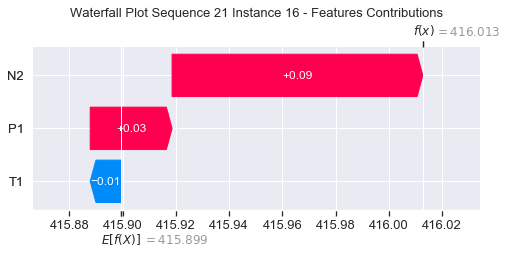

None

Contribution: [ 0.04143314 -0.06115269  0.11776622]


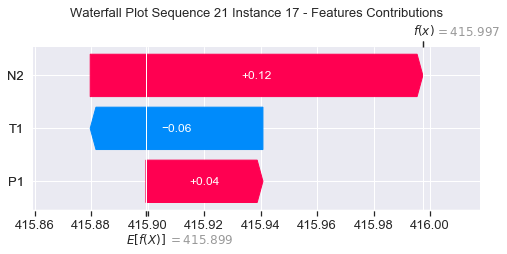

None

Contribution: [ 0.05593685 -0.14001543  0.15057619]


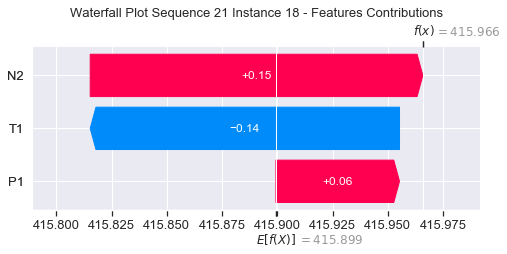

None

Contribution: [ 0.07266897 -0.28976827  0.20400598]


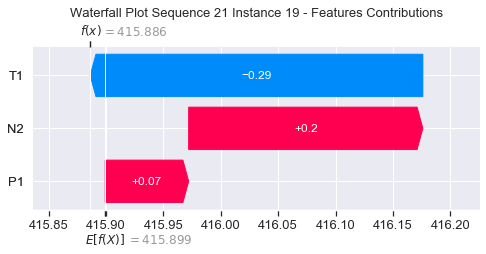

None

Contribution: [ 0.10661741 -0.49740761  0.2638381 ]


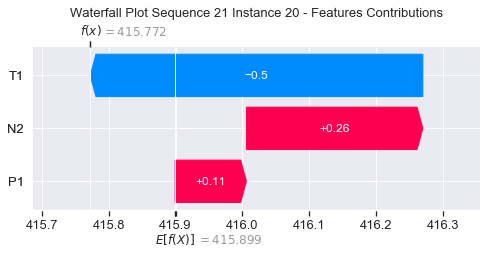

None

Contribution: [ 0.14987897 -0.88586487  0.37361963]


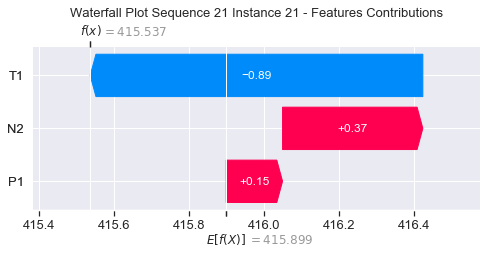

None

Contribution: [ 0.24291127 -1.96908342  0.6665175 ]


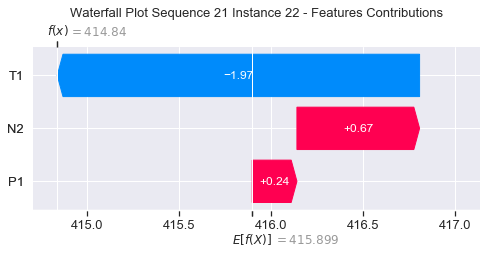

None

Contribution: [ 0.20883066 -2.13203759  0.79584573]


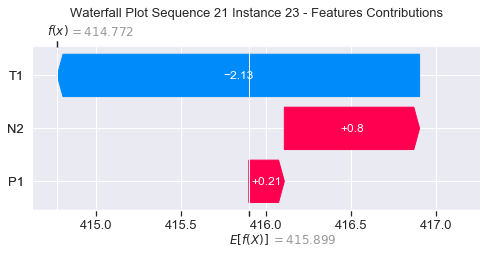

None

Contribution: [ 0.70732513 -8.37206661  2.4540995 ]


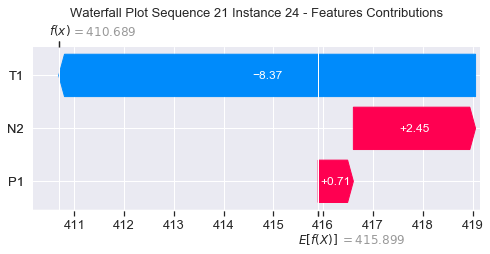

None

Contribution: [ 0.01245061  0.33618978 -0.01696222]


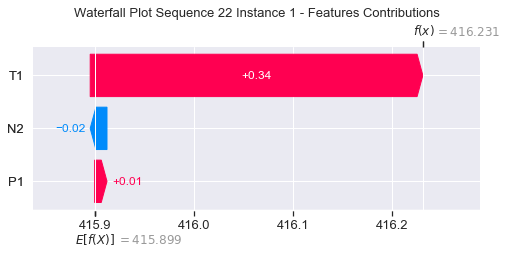

None

Contribution: [0.001851   0.03195342 0.00074692]


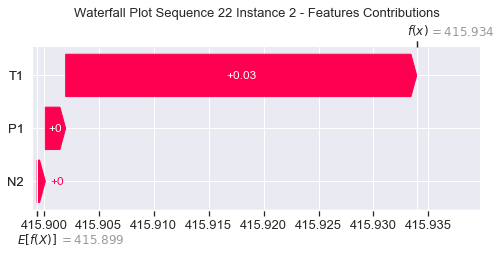

None

Contribution: [-0.00151912  0.02020408 -0.00526648]


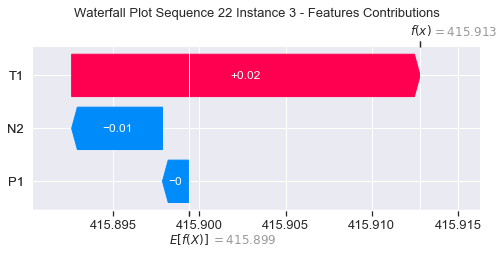

None

Contribution: [0.00014063 0.01901889 0.00292325]


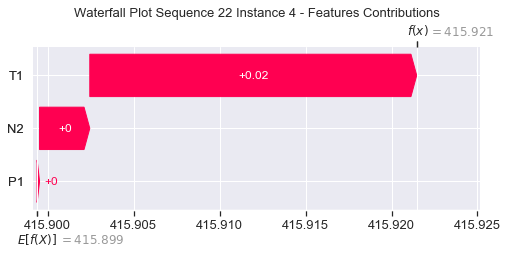

None

Contribution: [0.00221668 0.026255   0.00906018]


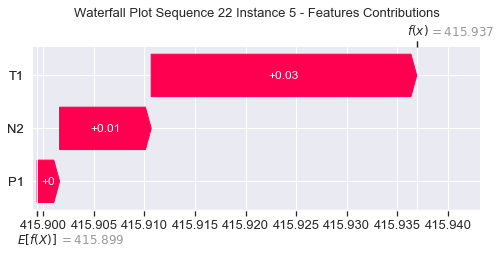

None

Contribution: [0.00308472 0.03279783 0.01253984]


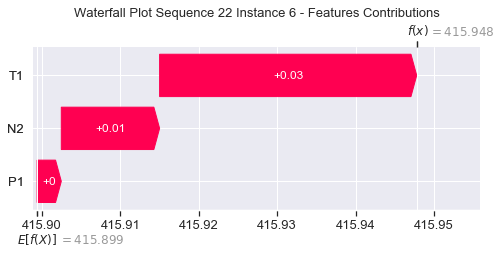

None

Contribution: [0.00348424 0.03868623 0.01636622]


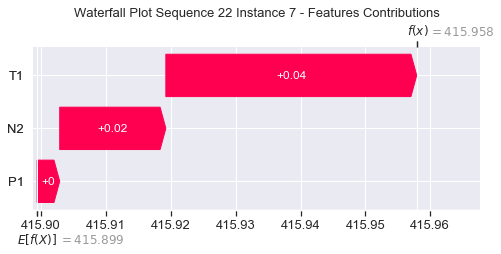

None

Contribution: [0.00528573 0.04228299 0.02121503]


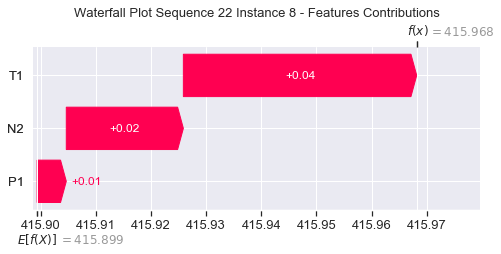

None

Contribution: [0.0095672  0.04419856 0.0272792 ]


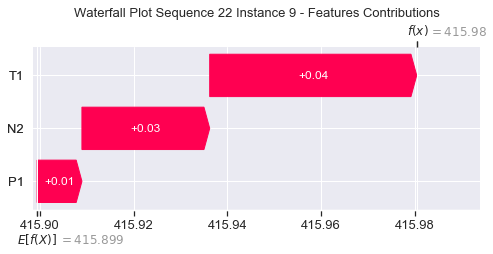

None

Contribution: [0.01118293 0.04132203 0.03166608]


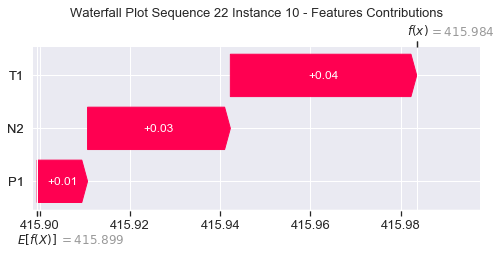

None

Contribution: [0.01597393 0.04218906 0.04043374]


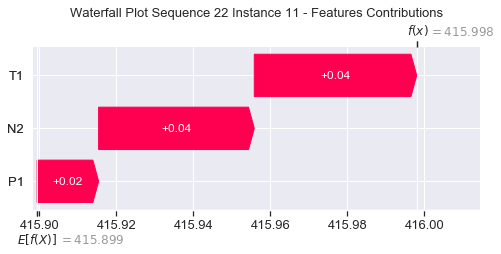

None

Contribution: [0.01391426 0.04224787 0.04609389]


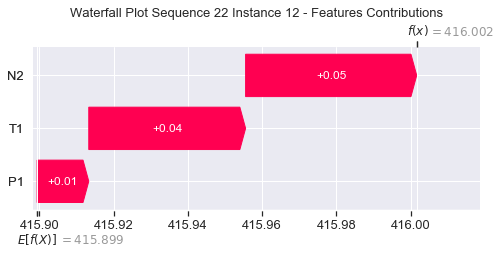

None

Contribution: [0.01605293 0.03727504 0.05422091]


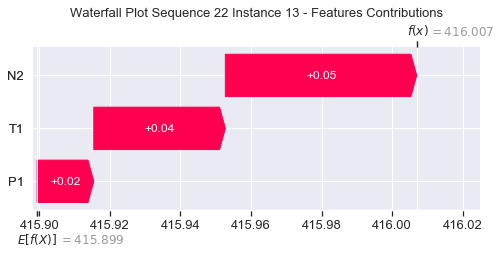

None

Contribution: [0.02026711 0.02836987 0.06385588]


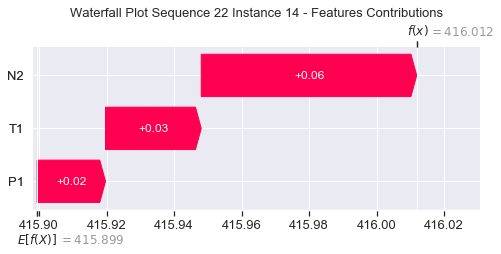

None

Contribution: [0.02478875 0.01281565 0.07701315]


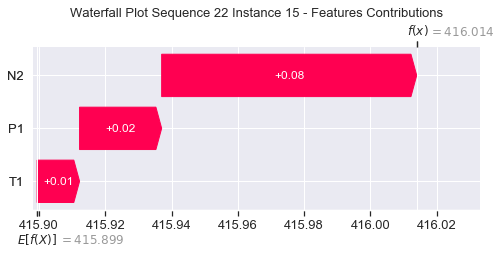

None

Contribution: [ 0.03134945 -0.0118457   0.09473508]


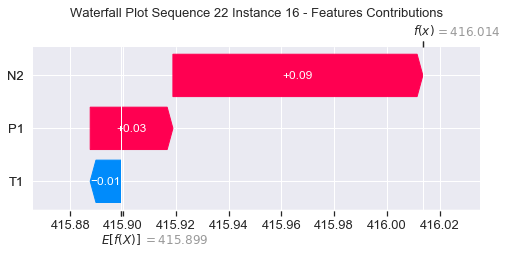

None

Contribution: [ 0.04254417 -0.05245613  0.11685198]


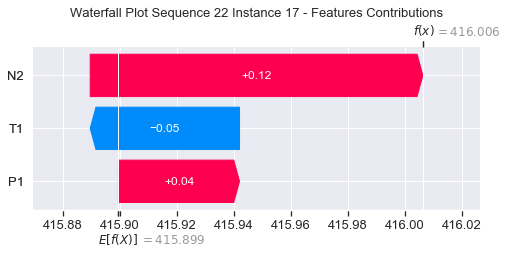

None

Contribution: [ 0.05675515 -0.1174914   0.14785542]


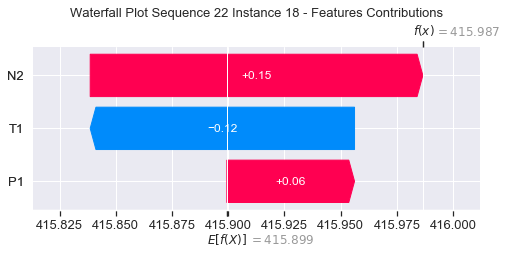

None

Contribution: [ 0.05046125 -0.2464305   0.19557093]


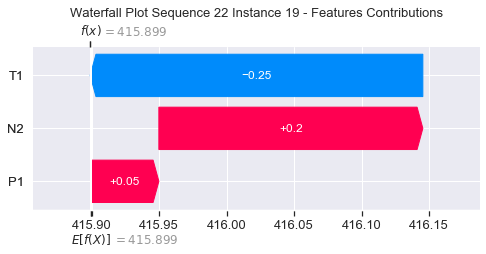

None

Contribution: [ 0.11891394 -0.4215404   0.25974026]


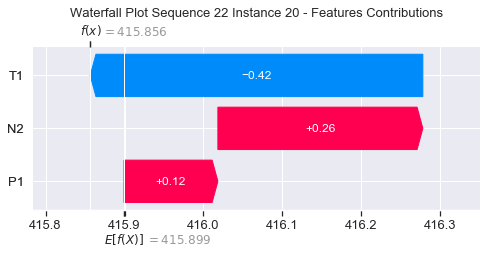

None

Contribution: [ 0.17301968 -0.71953703  0.36831083]


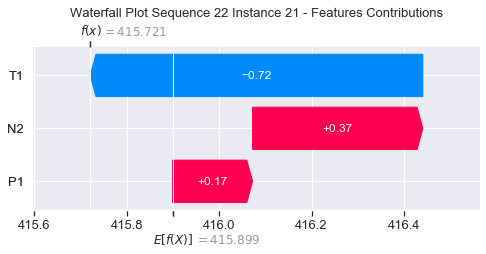

None

Contribution: [ 0.27927142 -1.52739233  0.65506827]


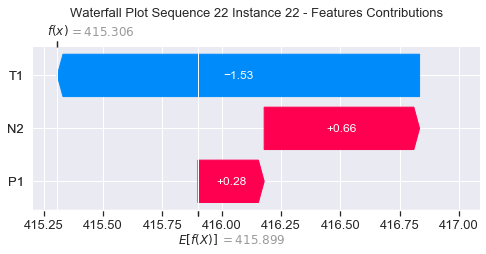

None

Contribution: [ 0.22131357 -1.59198782  0.77237533]


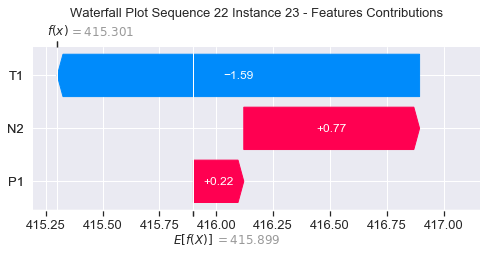

None

Contribution: [ 0.84340238 -6.41064453  2.49089624]


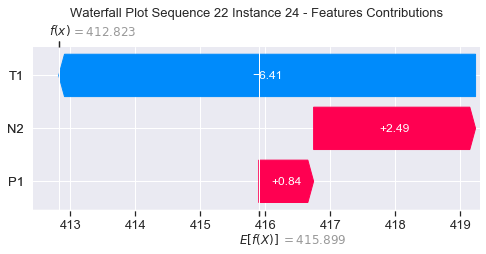

None

Contribution: [ 0.00678352  0.31342538 -0.02201004]


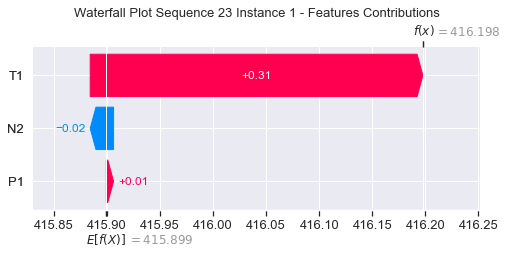

None

Contribution: [0.00177075 0.03070557 0.00054197]


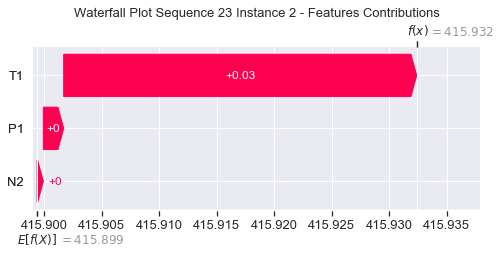

None

Contribution: [ 0.0002744   0.01998069 -0.00481232]


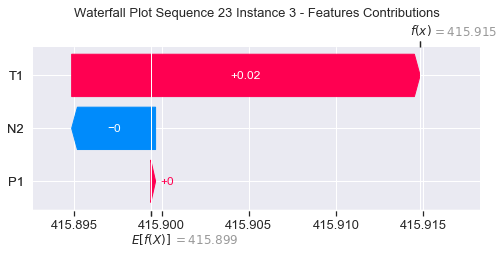

None

Contribution: [0.00314316 0.01790138 0.0035653 ]


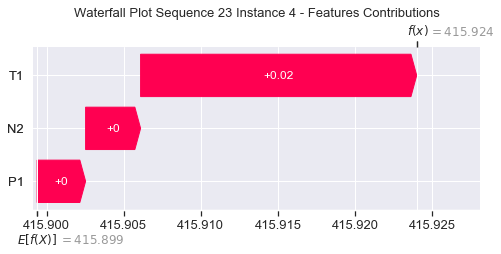

None

Contribution: [0.00216704 0.02204126 0.00799554]


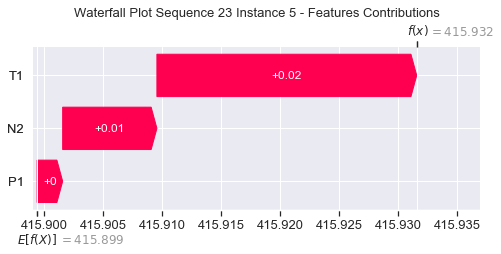

None

Contribution: [0.00208517 0.02784531 0.01075118]


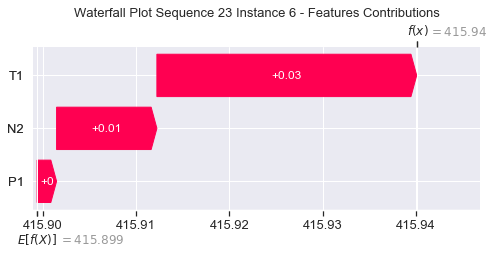

None

Contribution: [0.00267402 0.03273716 0.01429787]


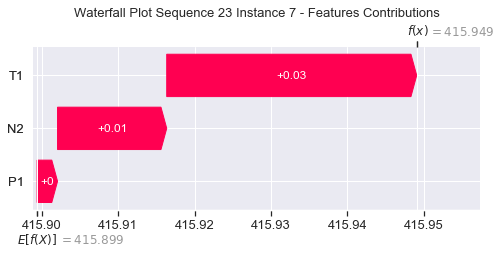

None

Contribution: [0.00422771 0.03731035 0.01890809]


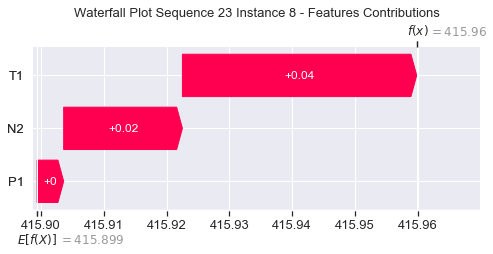

None

Contribution: [0.00717115 0.03866196 0.02309074]


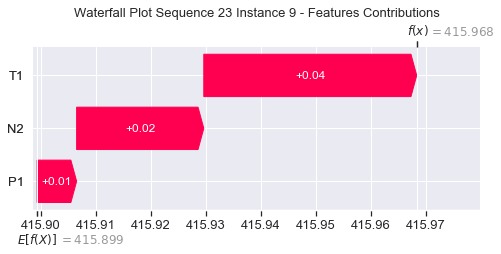

None

Contribution: [0.00880336 0.03938438 0.02836692]


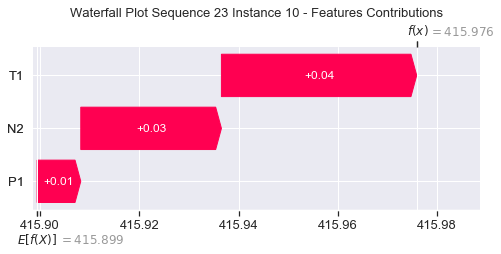

None

Contribution: [0.01214569 0.04134928 0.0362238 ]


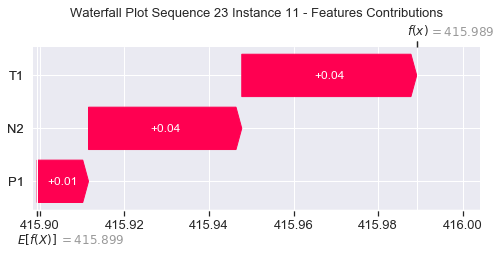

None

Contribution: [0.01234815 0.04114193 0.04407896]


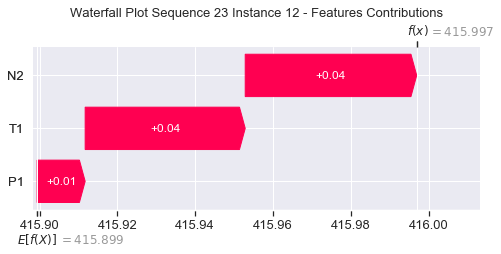

None

Contribution: [0.01512616 0.03624378 0.05258374]


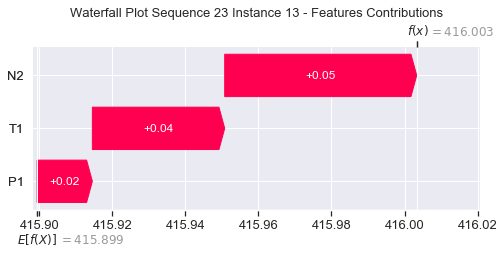

None

Contribution: [0.01918736 0.02789583 0.06242626]


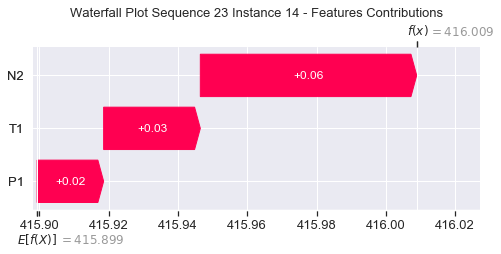

None

Contribution: [0.02464114 0.01320956 0.07655124]


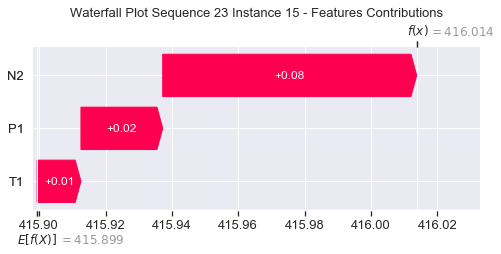

None

Contribution: [ 0.0293082  -0.0119776   0.09440293]


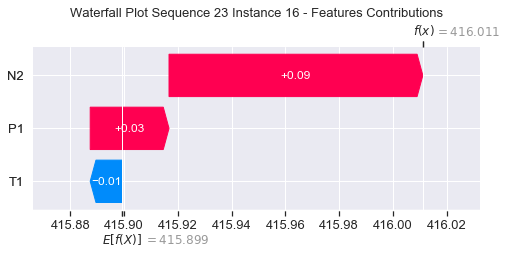

None

Contribution: [ 0.04301647 -0.05122302  0.11875957]


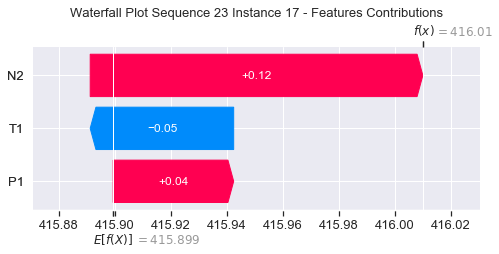

None

Contribution: [ 0.05757148 -0.12021199  0.151425  ]


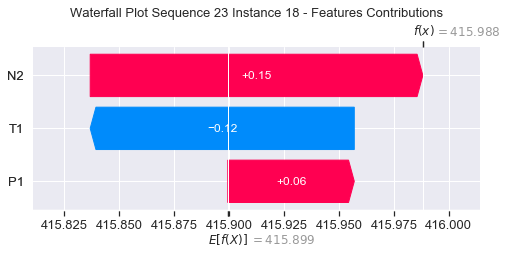

None

Contribution: [ 0.06625065 -0.25894133  0.1950072 ]


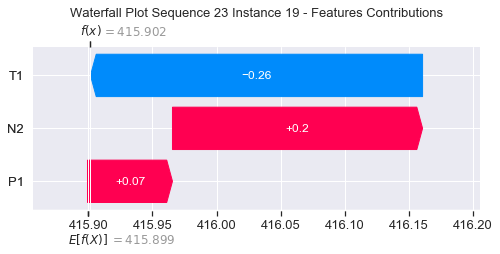

None

Contribution: [ 0.1084902  -0.4353464   0.26588198]


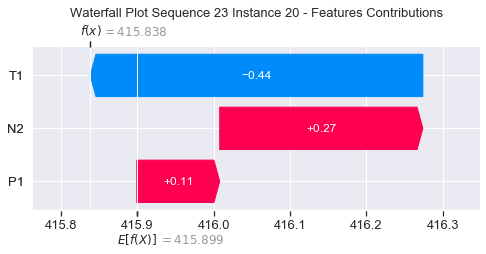

None

Contribution: [ 0.15516622 -0.76442421  0.37613741]


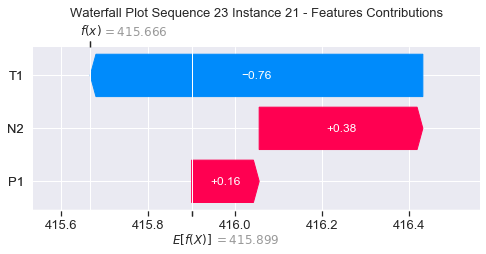

None

Contribution: [ 0.23927926 -1.67897758  0.66322012]


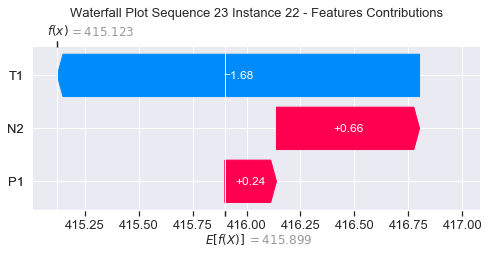

None

Contribution: [ 0.19201786 -1.80972174  0.78103491]


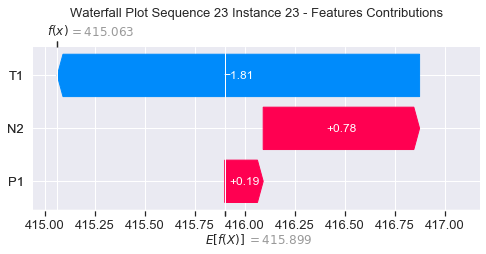

None

Contribution: [ 1.09321928 -7.00561856  2.53987462]


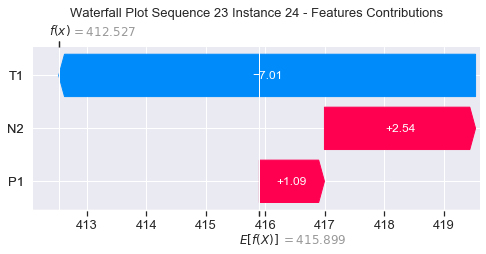

None

Contribution: [-0.01005744  0.31784488 -0.02525413]


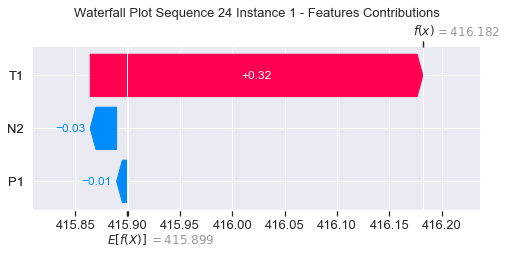

None

Contribution: [0.00184592 0.0322772  0.00064914]


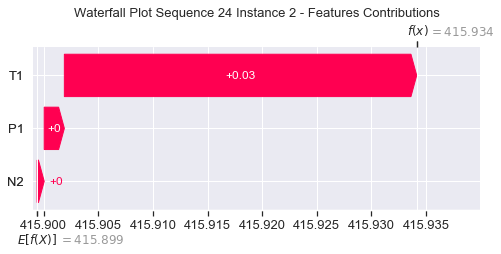

None

Contribution: [-0.00143538  0.01631262 -0.00521929]


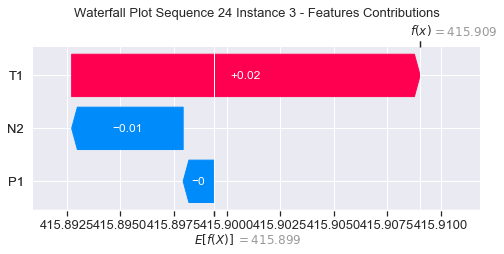

None

Contribution: [-0.0006976   0.0169782   0.00303898]


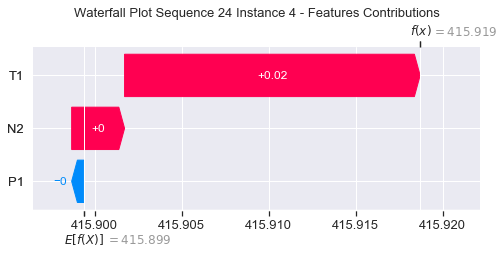

None

Contribution: [0.00159855 0.02328593 0.00834904]


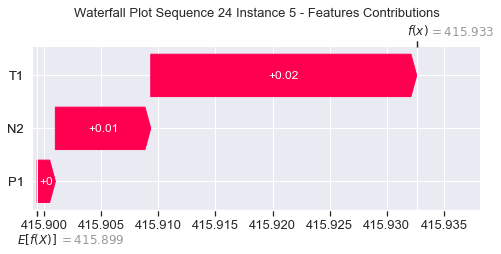

None

Contribution: [0.0021449  0.03050192 0.01092621]


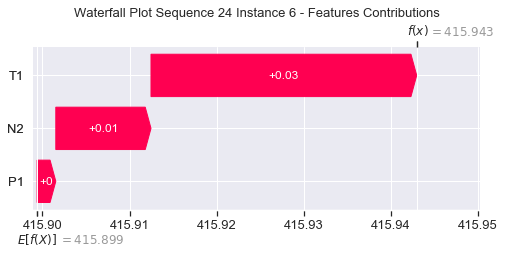

None

Contribution: [0.00268119 0.03575853 0.01442906]


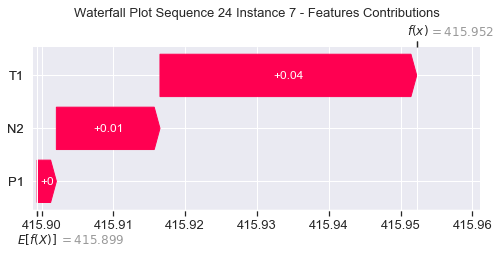

None

Contribution: [0.00427759 0.03992061 0.0192382 ]


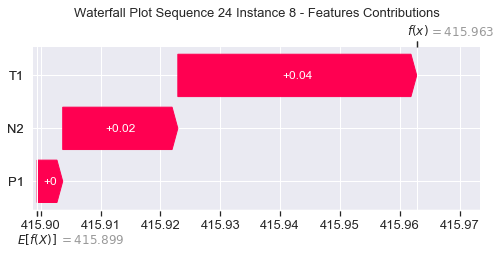

None

Contribution: [0.00915887 0.04188377 0.02439989]


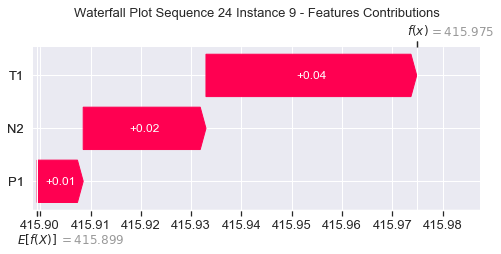

None

Contribution: [0.01053847 0.04543896 0.02922367]


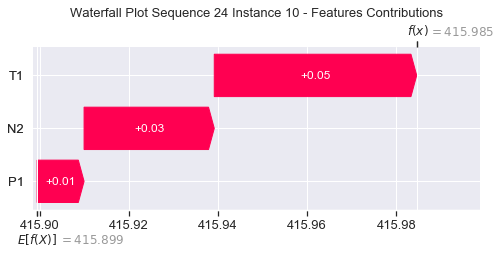

None

Contribution: [0.01342686 0.04507403 0.03727599]


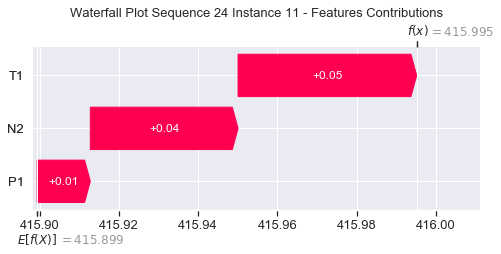

None

Contribution: [0.01139378 0.0446445  0.04407498]


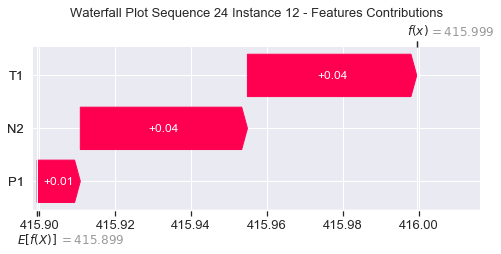

None

Contribution: [0.01440879 0.03820567 0.05276622]


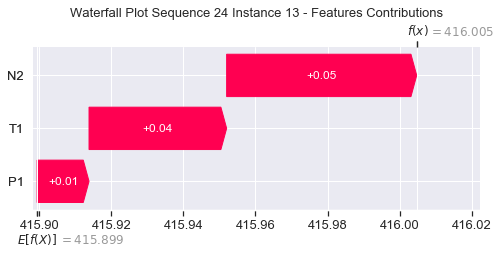

None

Contribution: [0.01995283 0.02909053 0.06381675]


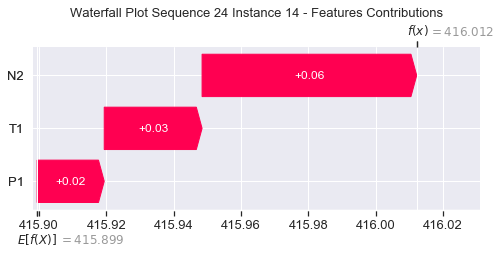

None

Contribution: [0.0246391  0.01339369 0.07704126]


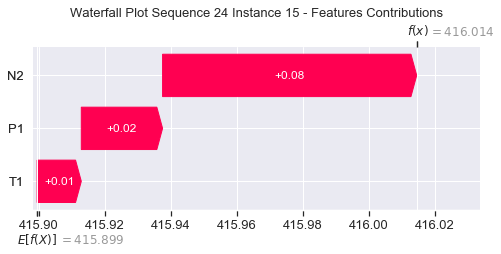

None

Contribution: [ 0.02991269 -0.01812728  0.09478099]


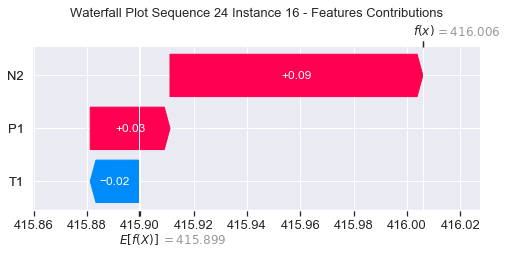

None

Contribution: [ 0.04449016 -0.0468512   0.12005277]


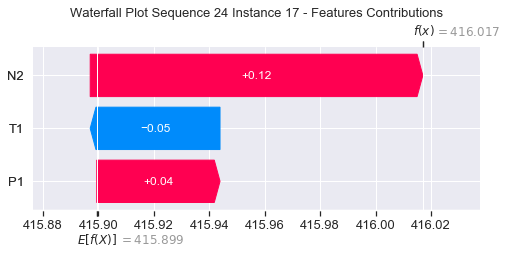

None

Contribution: [ 0.06030007 -0.10623864  0.15359816]


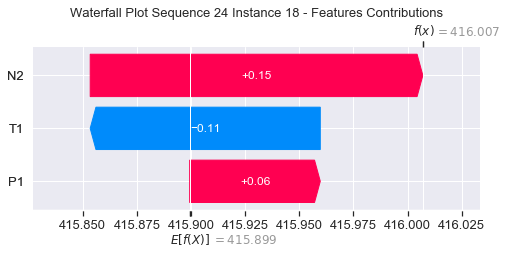

None

Contribution: [ 0.06582128 -0.20273541  0.21561738]


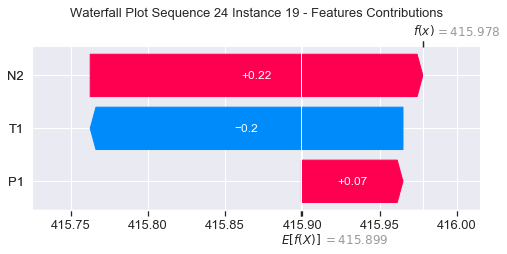

None

Contribution: [ 0.11832251 -0.34069507  0.26979049]


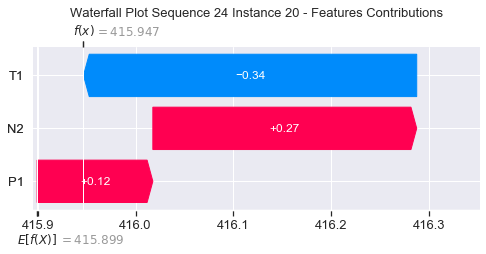

None

Contribution: [ 0.17829429 -0.60600655  0.38105161]


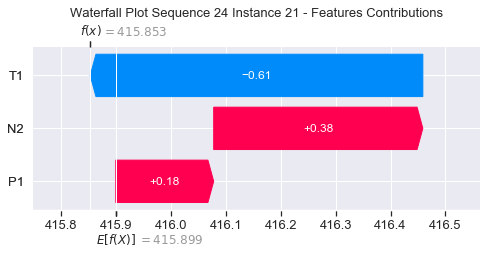

None

Contribution: [ 0.31062996 -1.29382971  0.67388642]


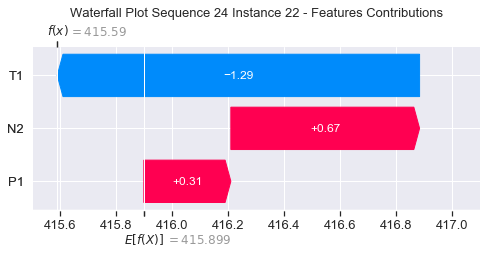

None

Contribution: [ 0.25863523 -1.40739479  0.79765497]


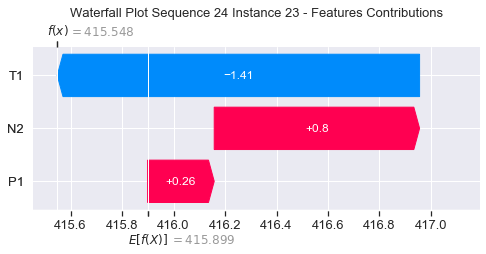

None

Contribution: [ 1.11777083 -5.12091054  2.50450963]


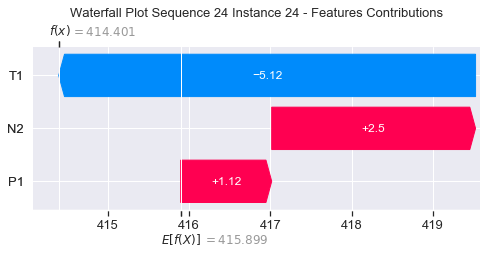

None

Contribution: [-0.00264726  0.29761933 -0.02193305]


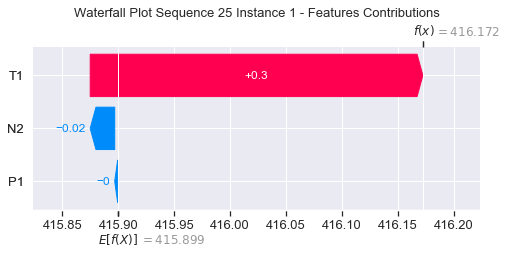

None

Contribution: [0.00174837 0.03146547 0.00053595]


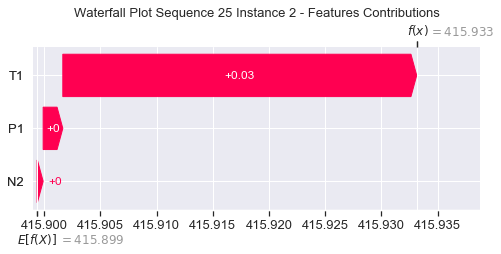

None

Contribution: [-0.00213087  0.0141287  -0.00532802]


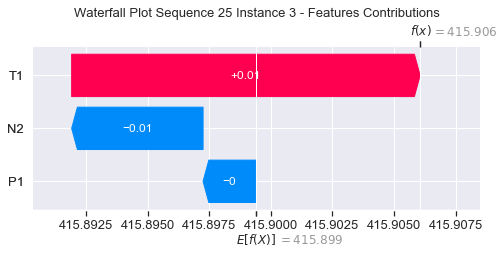

None

Contribution: [0.0021441 0.015935  0.0035642]


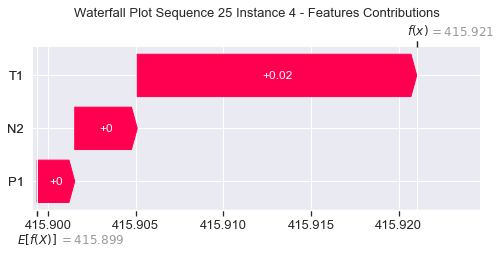

None

Contribution: [0.00281286 0.01822483 0.00878825]


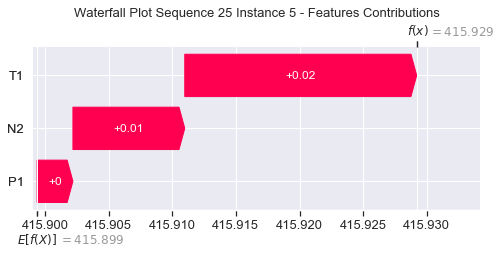

None

Contribution: [0.00380582 0.025613   0.01142026]


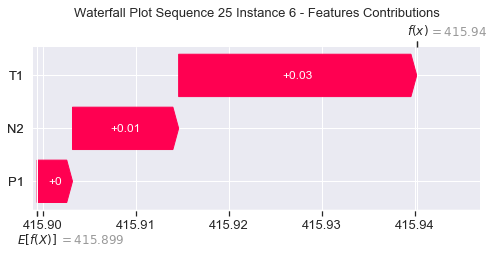

None

Contribution: [0.00486003 0.03118964 0.0150775 ]


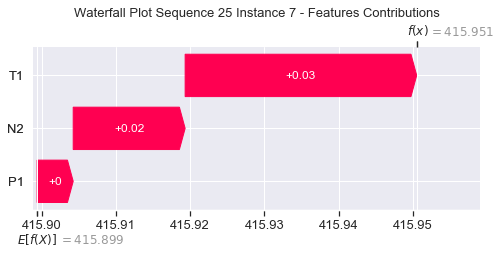

None

Contribution: [0.00601522 0.03422236 0.01962899]


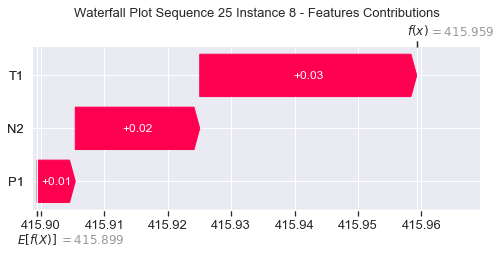

None

Contribution: [0.00780831 0.03596307 0.02336924]


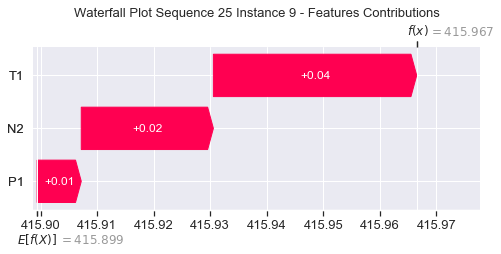

None

Contribution: [0.01718549 0.04211425 0.03026013]


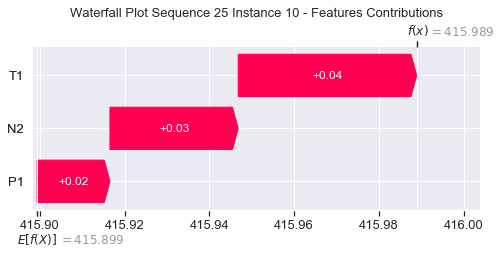

None

Contribution: [0.01151975 0.03634711 0.03580091]


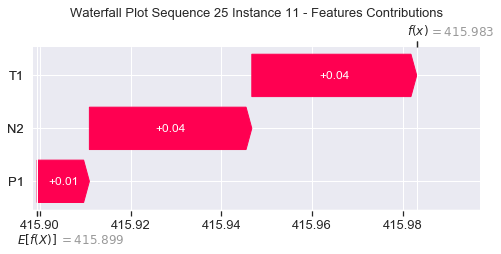

None

Contribution: [0.01346908 0.03976071 0.04432681]


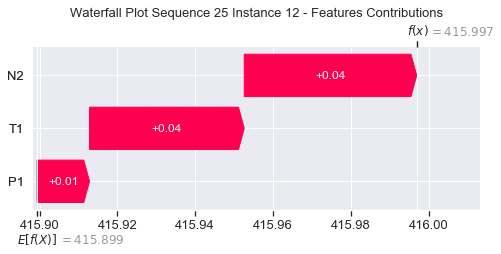

None

Contribution: [0.01623861 0.03540443 0.05304557]


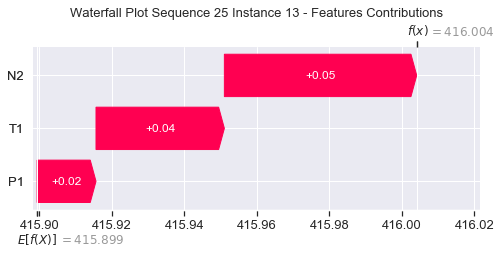

None

Contribution: [0.01943701 0.02846381 0.06380399]


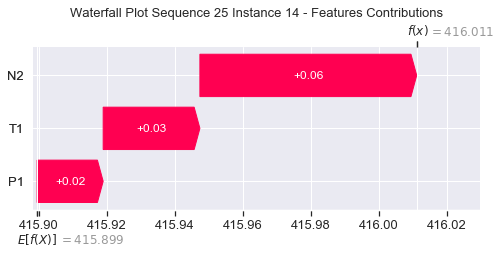

None

Contribution: [0.02494013 0.01574693 0.07710523]


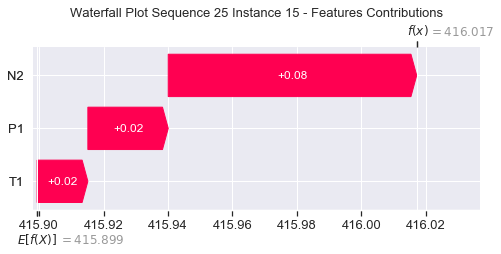

None

Contribution: [ 0.02821799 -0.01324082  0.09471241]


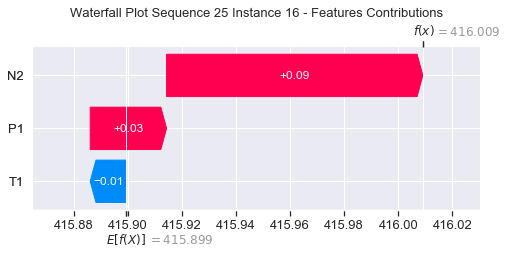

None

Contribution: [ 0.04067898 -0.03906557  0.11961586]


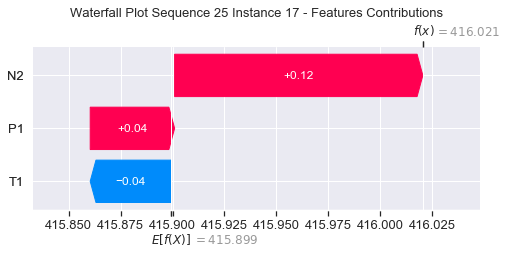

None

Contribution: [ 0.0529967  -0.09407547  0.15289474]


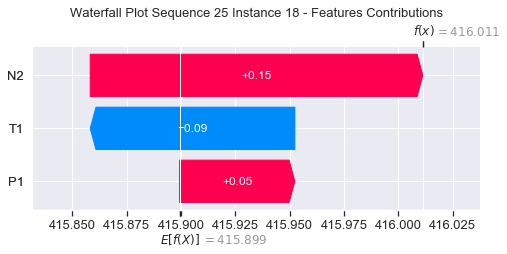

None

Contribution: [ 0.07762929 -0.1942485   0.20851064]


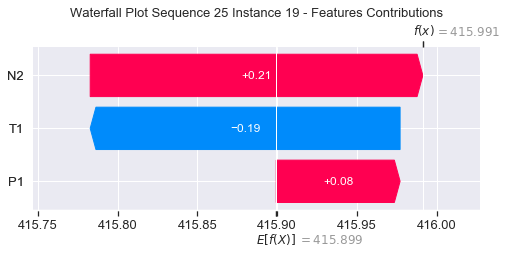

None

Contribution: [ 0.09683236 -0.32548026  0.26776804]


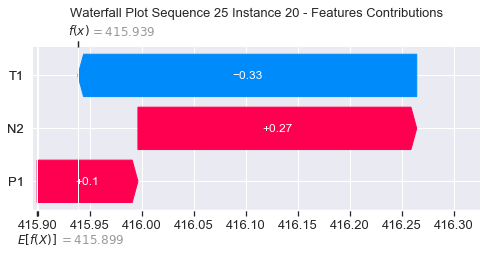

None

Contribution: [ 0.14396496 -0.5640308   0.37997021]


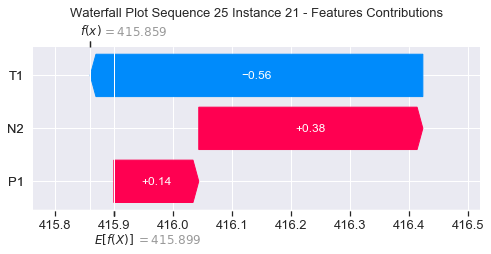

None

Contribution: [ 0.24326724 -1.15575003  0.67528003]


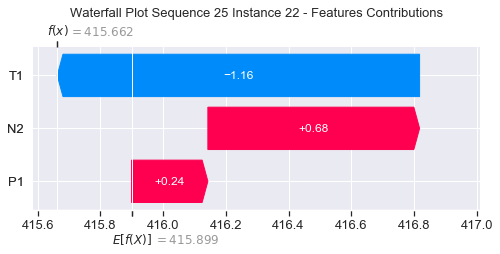

None

Contribution: [ 0.18891293 -1.28861653  0.8020471 ]


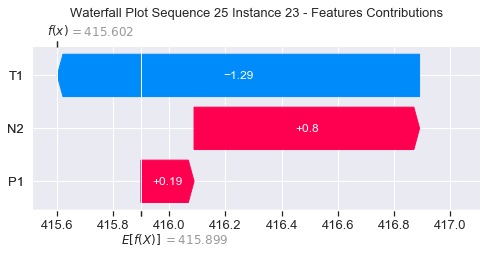

None

Contribution: [ 0.8608059  -4.60531148  2.6030571 ]


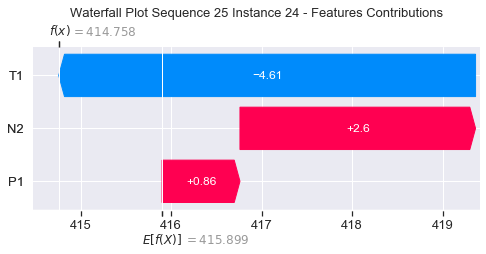

None

Contribution: [-0.00067829  0.28798607 -0.02721184]


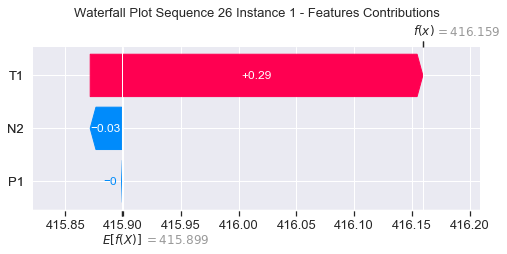

None

Contribution: [0.00175993 0.03090365 0.00037608]


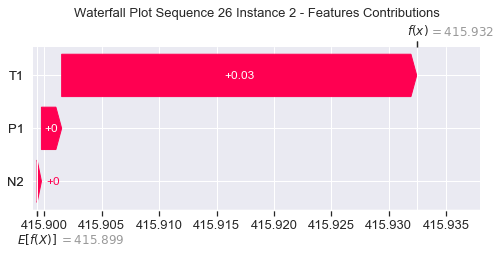

None

Contribution: [-0.00185265  0.01064431 -0.00560502]


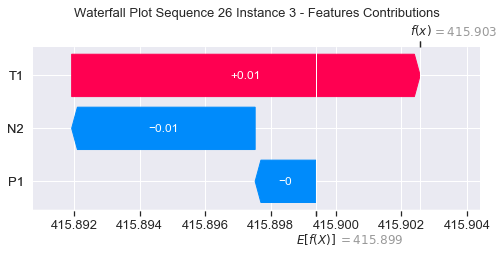

None

Contribution: [0.00063485 0.01139476 0.00269093]


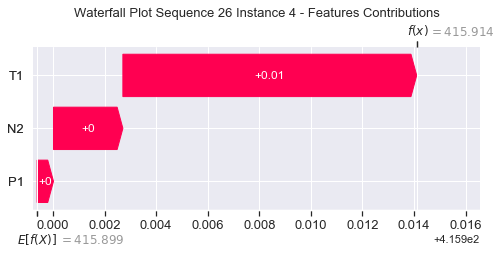

None

Contribution: [0.00198942 0.01505814 0.00776423]


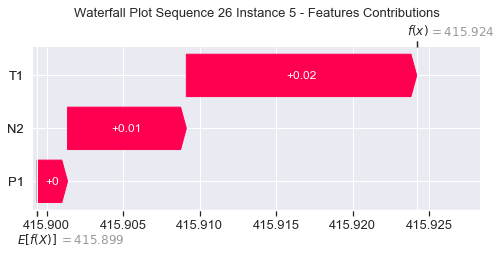

None

Contribution: [0.00365533 0.02162944 0.01052629]


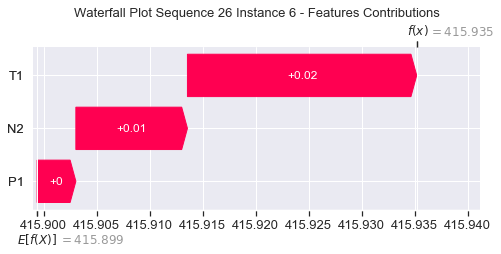

None

Contribution: [0.00449967 0.0261431  0.01402921]


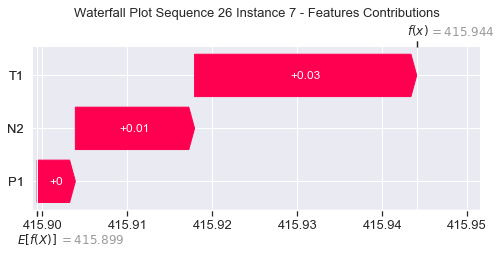

None

Contribution: [0.00572538 0.02972498 0.0186217 ]


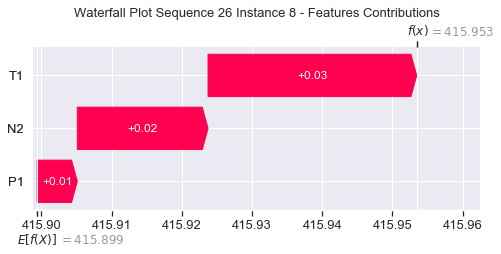

None

Contribution: [0.00883857 0.03149844 0.0233493 ]


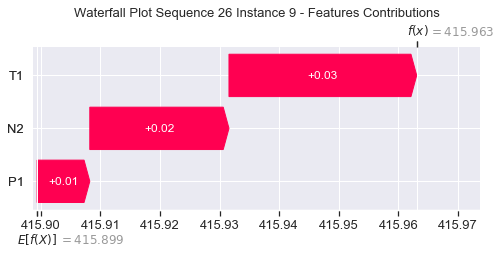

None

Contribution: [0.01204684 0.03325743 0.02815455]


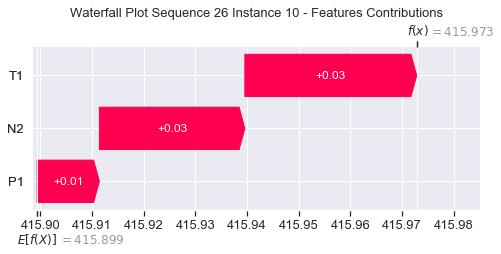

None

Contribution: [0.01186295 0.03511615 0.03575841]


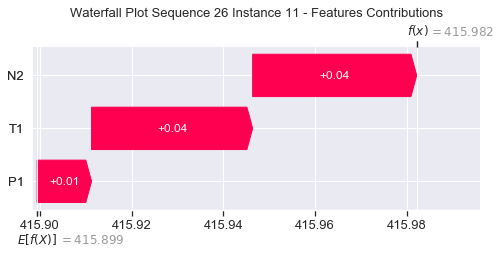

None

Contribution: [0.01073636 0.0371142  0.04298938]


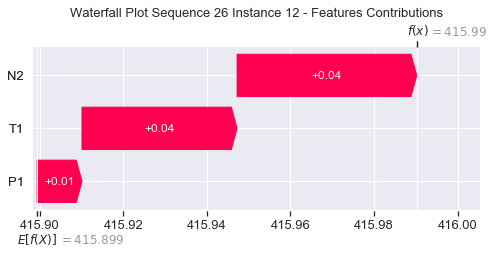

None

Contribution: [0.01411974 0.03341788 0.05181214]


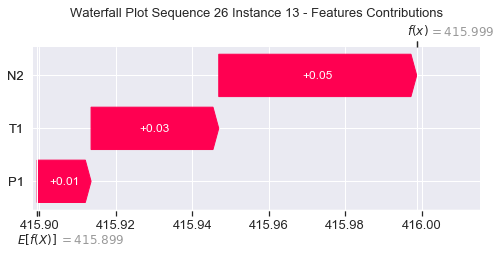

None

Contribution: [0.01933261 0.02770463 0.06273794]


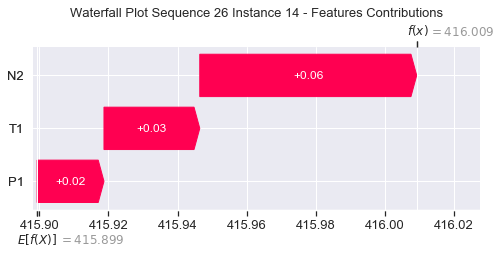

None

Contribution: [0.0245353  0.01642518 0.0763514 ]


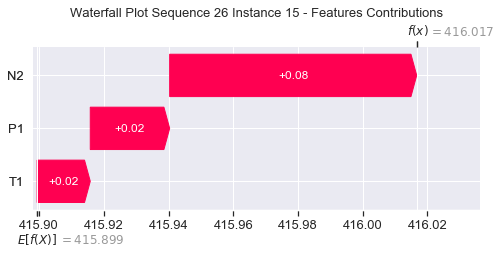

None

Contribution: [0.03038094 0.00162539 0.09487979]


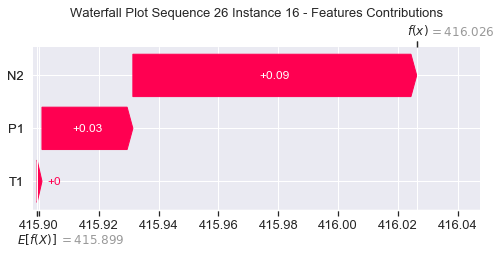

None

Contribution: [ 0.04169272 -0.03425535  0.119275  ]


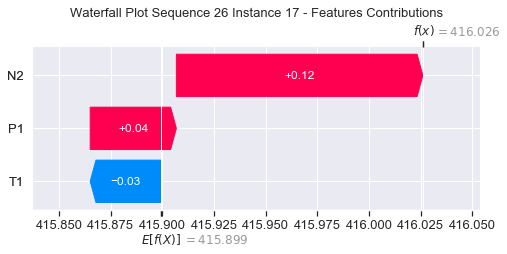

None

Contribution: [ 0.05373911 -0.08868991  0.15218497]


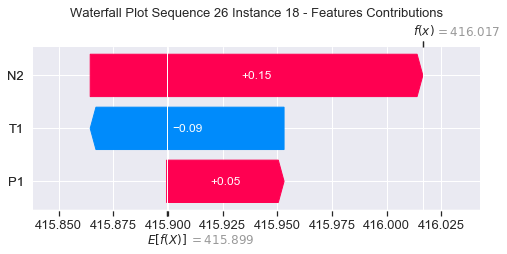

None

Contribution: [ 0.06371416 -0.17098053  0.20254512]


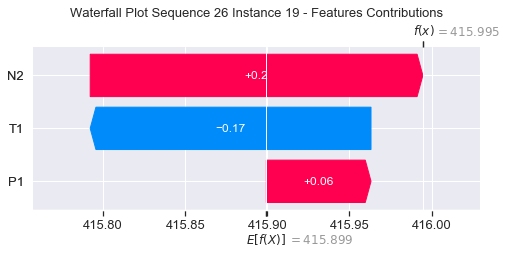

None

Contribution: [ 0.09082624 -0.32517515  0.26505924]


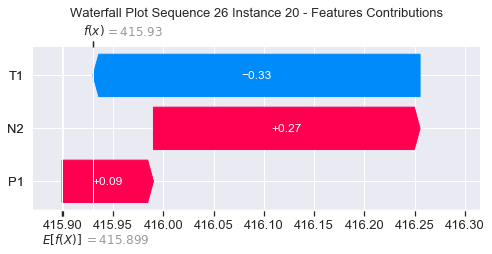

None

Contribution: [ 0.14315936 -0.58184604  0.37673779]


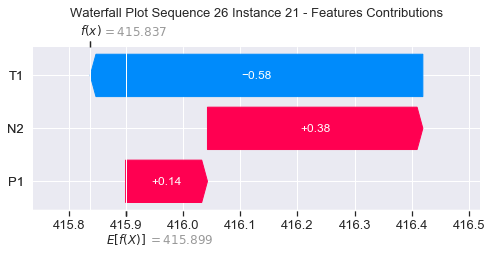

None

Contribution: [ 0.25236389 -1.26466816  0.67036563]


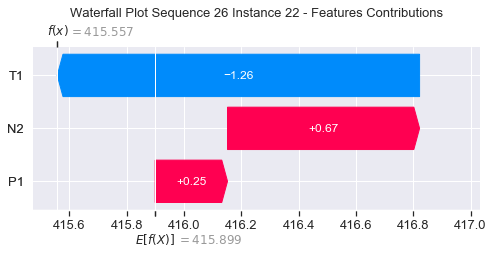

None

Contribution: [ 0.18317618 -1.41729573  0.78840068]


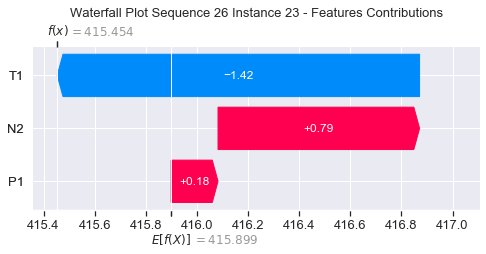

None

Contribution: [ 0.70539503 -5.31462884  2.45335562]


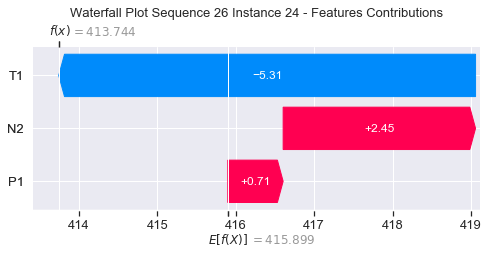

None

Contribution: [ 0.00191067  0.29853889 -0.02080691]


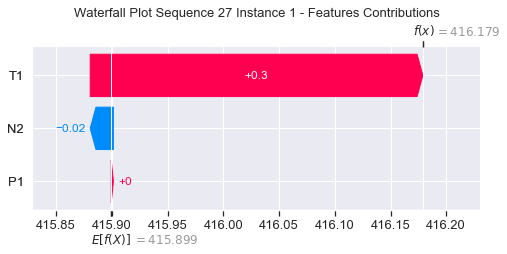

None

Contribution: [0.00171091 0.03121294 0.00046693]


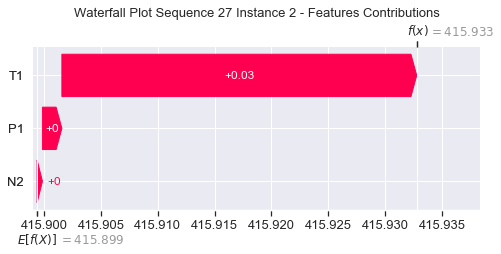

None

Contribution: [-0.00175232  0.01481611 -0.00550052]


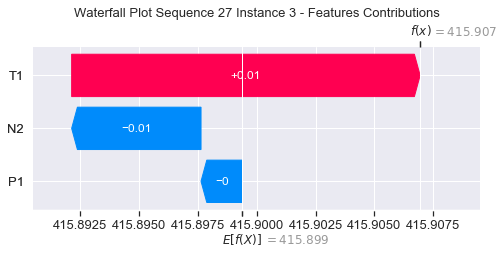

None

Contribution: [0.00041079 0.01234538 0.0029494 ]


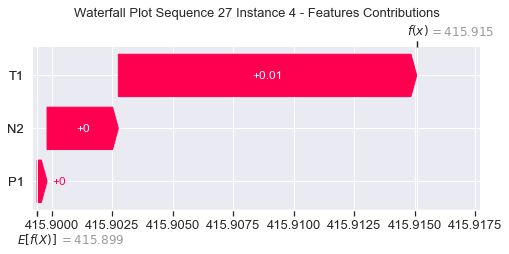

None

Contribution: [0.00391011 0.02076561 0.00880488]


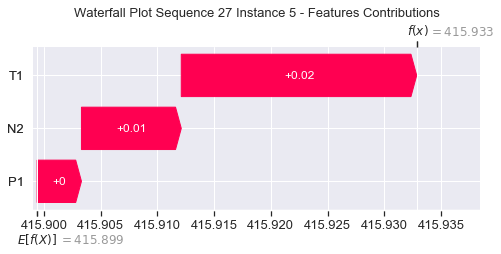

None

Contribution: [0.00329196 0.02535429 0.01120102]


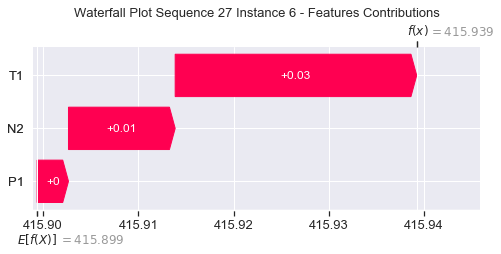

None

Contribution: [0.0043134  0.02979669 0.01494971]


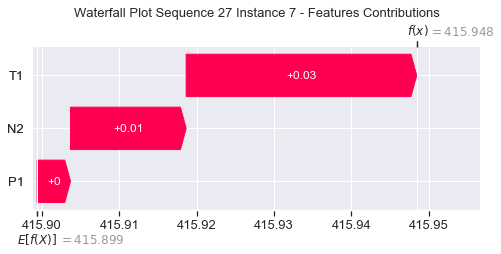

None

Contribution: [0.00598215 0.03399903 0.0196752 ]


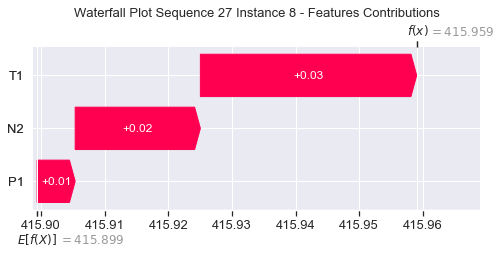

None

Contribution: [0.01052582 0.0348929  0.02457886]


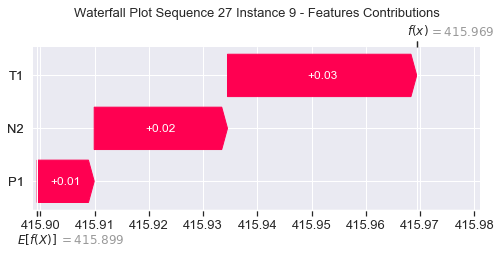

None

Contribution: [0.01358869 0.03721299 0.02978695]


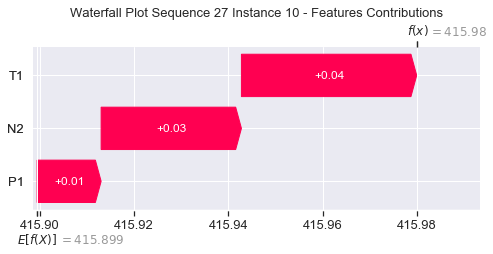

None

Contribution: [0.01443249 0.04016352 0.03734302]


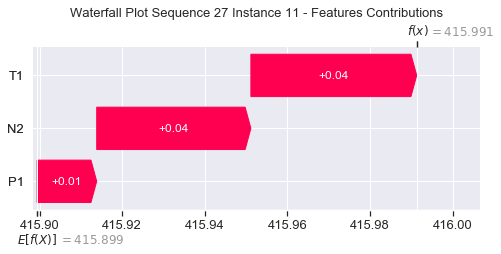

None

Contribution: [0.01508747 0.04158588 0.04559616]


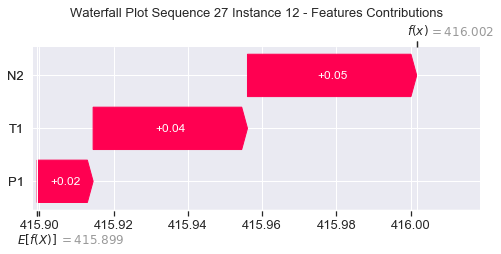

None

Contribution: [0.01752448 0.03607922 0.05396536]


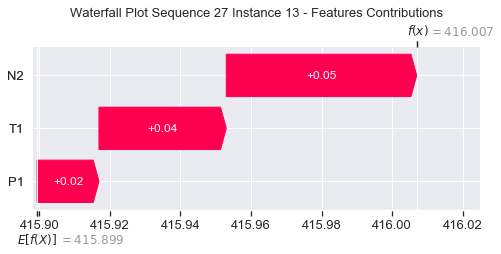

None

Contribution: [0.02093895 0.02816911 0.0638006 ]


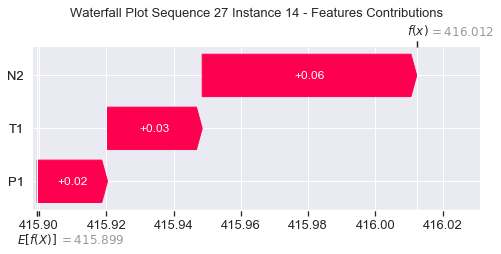

None

Contribution: [0.02505502 0.01552044 0.07706537]


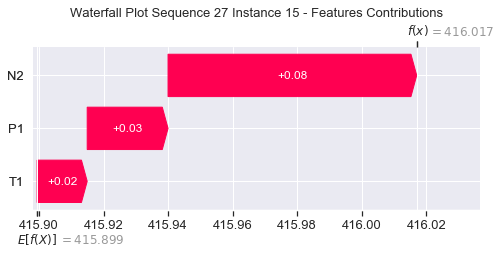

None

Contribution: [0.03056701 0.00041304 0.09487493]


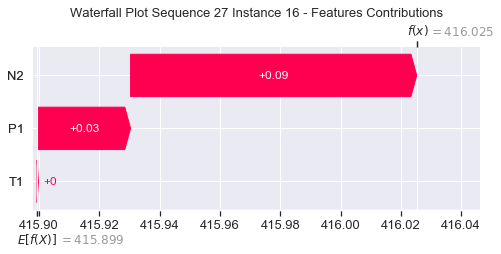

None

Contribution: [ 0.03978982 -0.03315368  0.11788626]


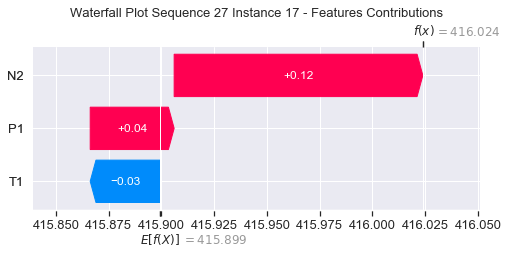

None

Contribution: [ 0.0524944  -0.08237829  0.14988102]


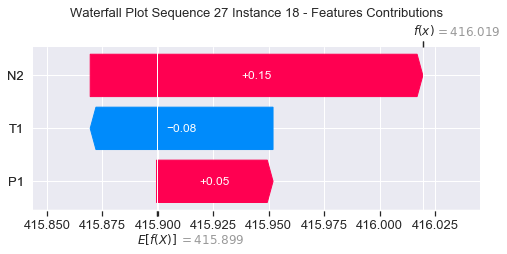

None

Contribution: [ 0.05956435 -0.17891666  0.19513828]


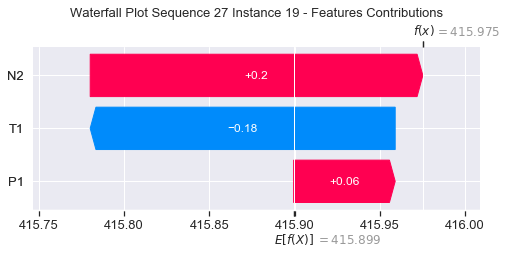

None

Contribution: [ 0.09469463 -0.28462301  0.26087929]


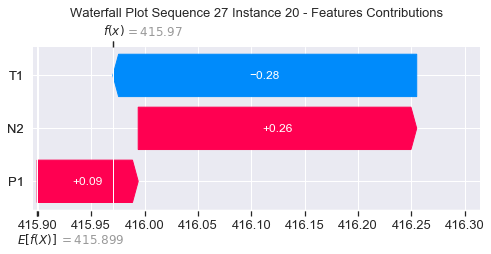

None

Contribution: [ 0.12617061 -0.53431935  0.36420638]


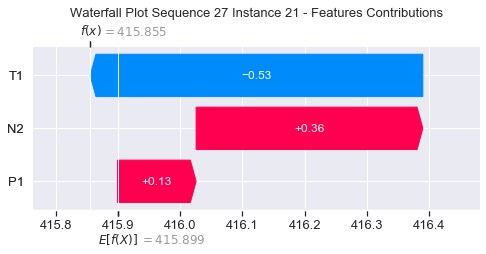

None

Contribution: [ 0.16933868 -1.20179578  0.63345004]


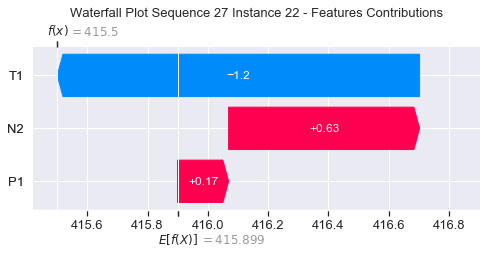

None

Contribution: [ 0.14323682 -1.28533566  0.760294  ]


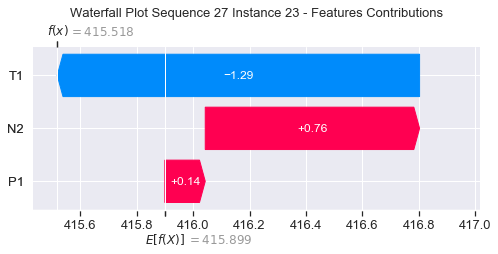

None

Contribution: [ 0.63465781 -4.53277669  2.39709262]


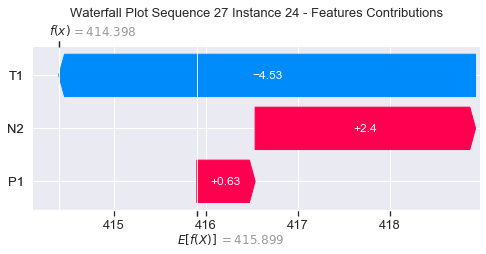

None

Contribution: [ 0.00614333  0.27497494 -0.01904155]


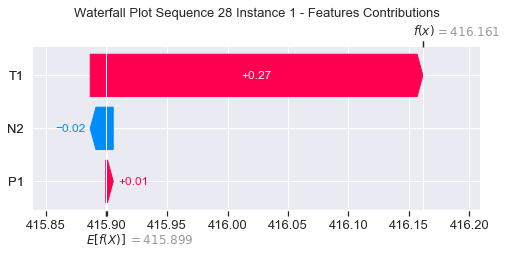

None

Contribution: [0.00183728 0.03065334 0.00064051]


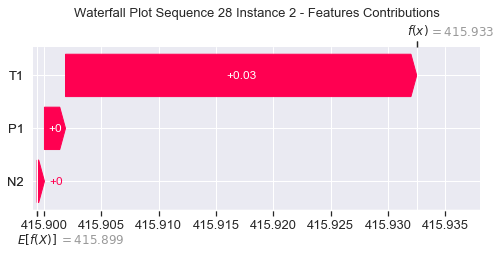

None

Contribution: [ 0.00148257  0.01379672 -0.0044307 ]


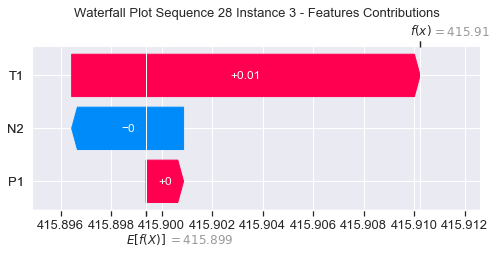

None

Contribution: [0.00013957 0.01203397 0.0029346 ]


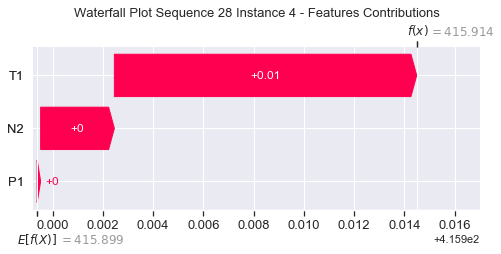

None

Contribution: [5.78752764e-05 1.67419519e-02 7.30458446e-03]


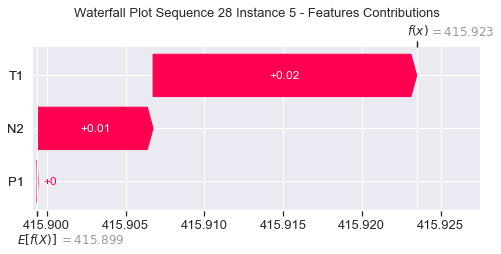

None

Contribution: [0.00175402 0.0178065  0.01039599]


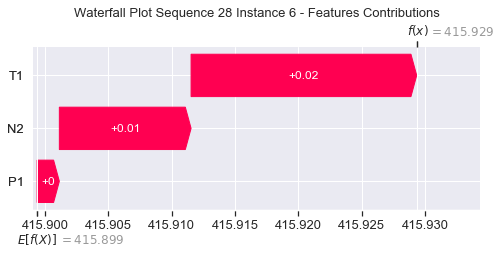

None

Contribution: [0.00375416 0.01909388 0.01378319]


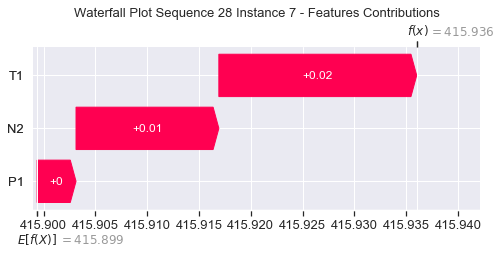

None

Contribution: [0.00348903 0.02617189 0.01807754]


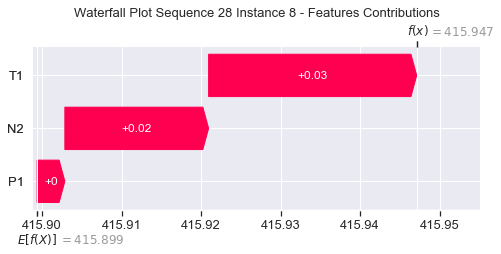

None

Contribution: [0.00792523 0.01971549 0.02062994]


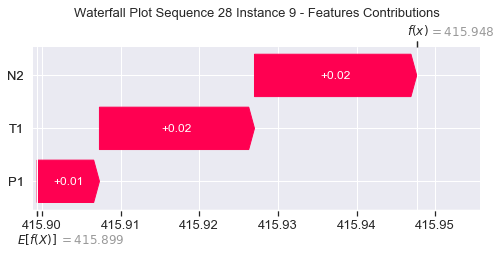

None

Contribution: [0.00641867 0.02349172 0.02582839]


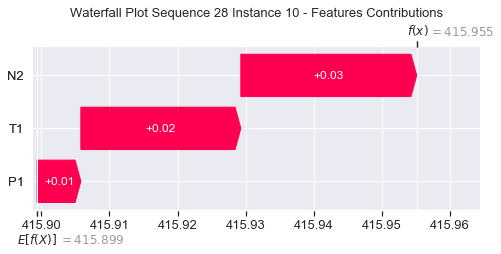

None

Contribution: [0.00744183 0.03390269 0.03419217]


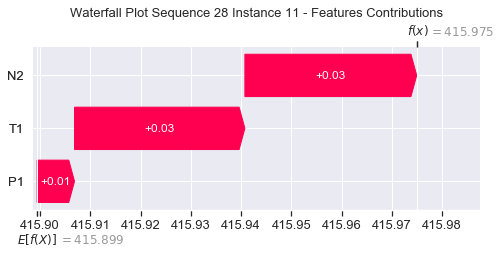

None

Contribution: [0.01050678 0.03845981 0.04281548]


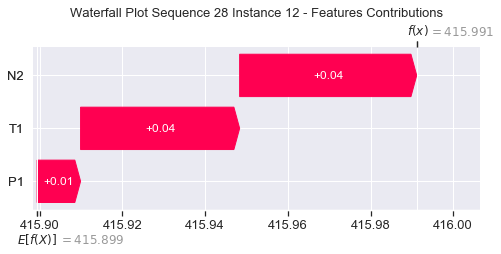

None

Contribution: [0.01370237 0.03416386 0.05117658]


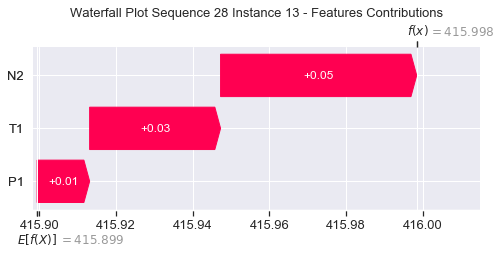

None

Contribution: [0.02024242 0.02743761 0.06217756]


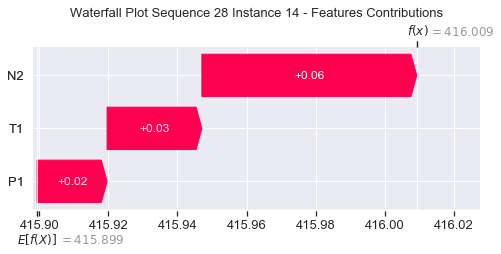

None

Contribution: [0.02397165 0.01179438 0.07514532]


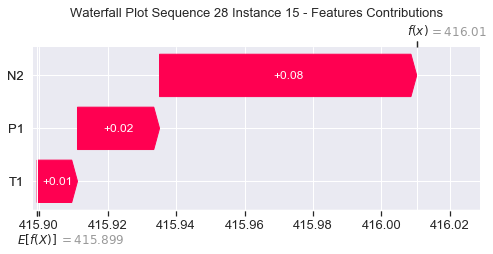

None

Contribution: [ 0.03329227 -0.00677009  0.09364522]


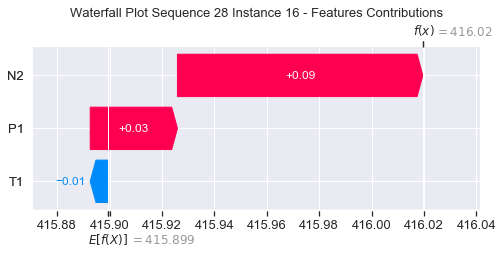

None

Contribution: [ 0.04555052 -0.05914654  0.11746955]


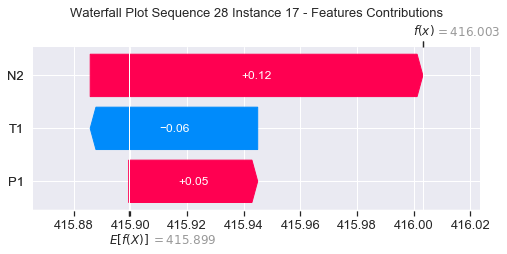

None

Contribution: [ 0.06734991 -0.15163977  0.15019567]


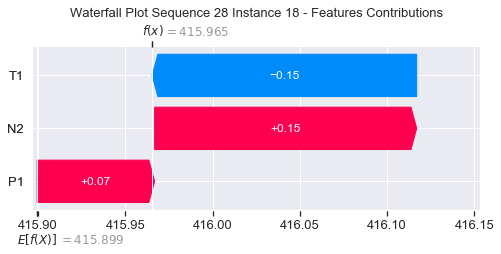

None

Contribution: [ 0.06463088 -0.32069347  0.20109889]


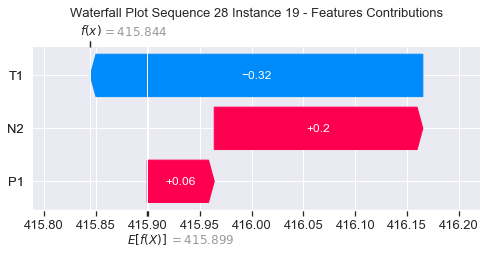

None

Contribution: [ 0.16023415 -0.58282162  0.26965057]


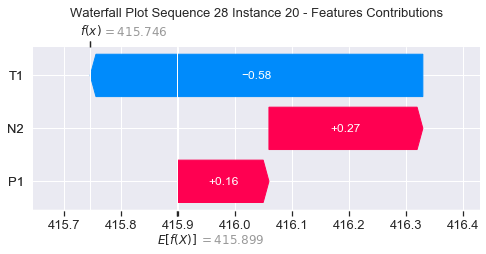

None

Contribution: [ 0.27415546 -1.10171372  0.38632382]


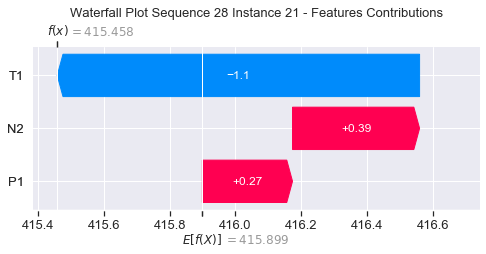

None

Contribution: [ 0.59557392 -2.7011245   0.6912441 ]


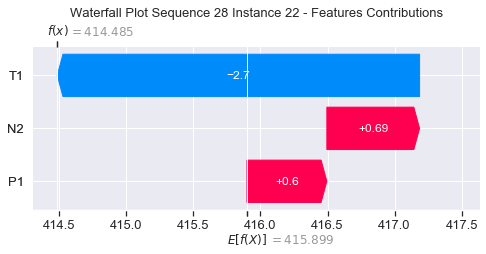

None

Contribution: [ 0.58206392 -2.9053367   0.80479517]


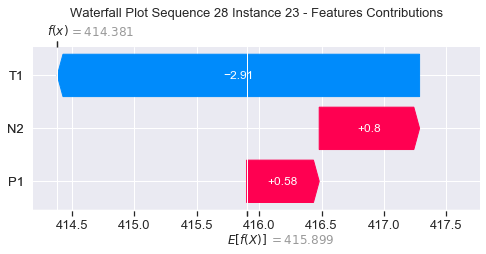

None

Contribution: [  3.7156458  -13.57152921   2.85865297]


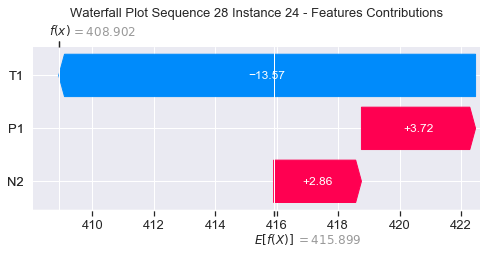

None

Contribution: [-0.06012711  0.45320345 -0.03651878]


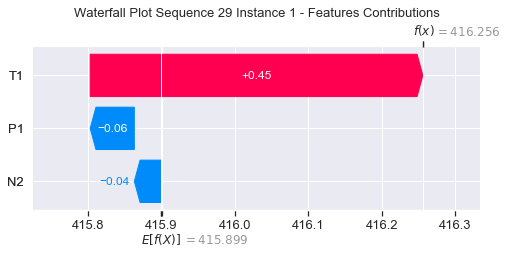

None

Contribution: [0.00159127 0.03406652 0.00078139]


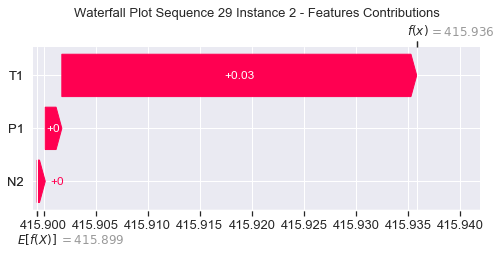

None

Contribution: [-0.0079226   0.03947857 -0.00554324]


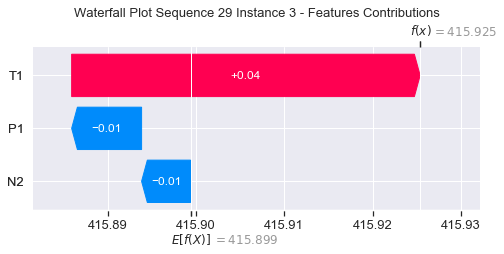

None

Contribution: [-0.00904074  0.03657655  0.00159332]


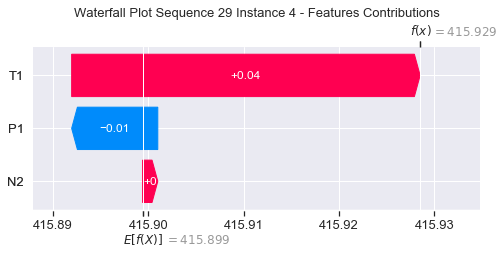

None

Contribution: [-0.00541153  0.04933215  0.00834033]


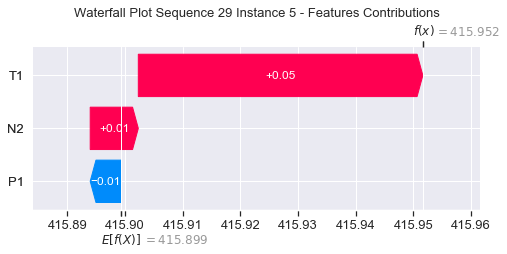

None

Contribution: [-0.01475861  0.06827157  0.00904301]


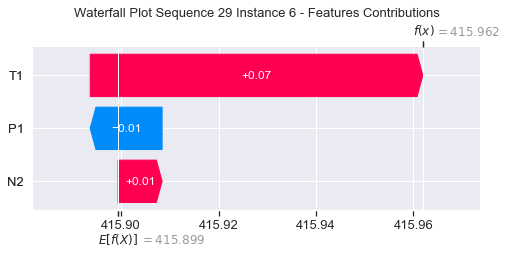

None

Contribution: [-0.01687905  0.08088314  0.01258301]


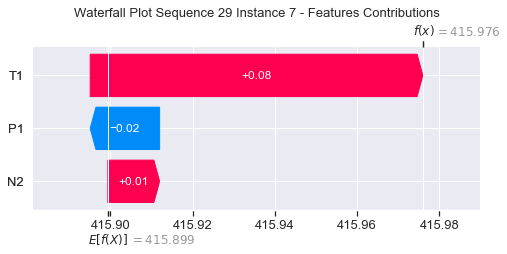

None

Contribution: [-0.01515053  0.08476393  0.01727321]


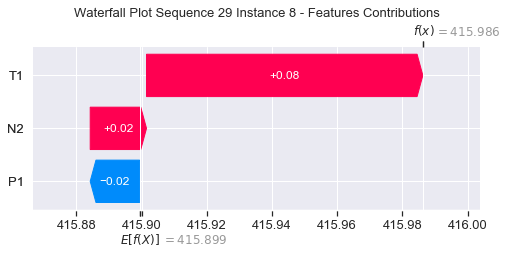

None

Contribution: [-0.01107555  0.09303654  0.02276091]


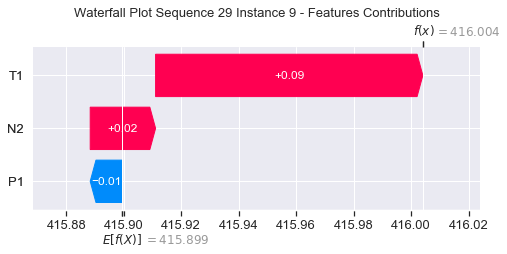

None

Contribution: [0.0048942  0.0913066  0.02987049]


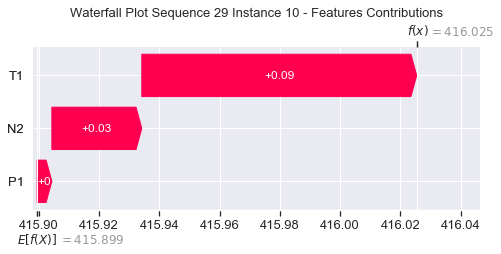

None

Contribution: [-0.00934291  0.08634796  0.03352404]


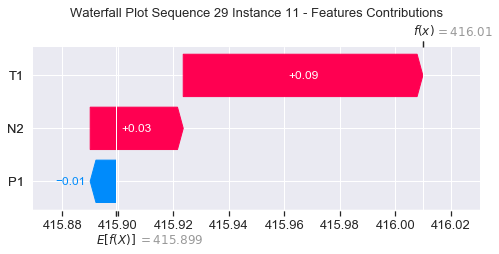

None

Contribution: [-0.0098536   0.07972437  0.04149444]


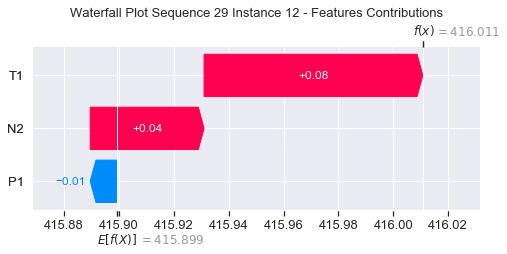

None

Contribution: [-0.00151614  0.05974421  0.05116909]


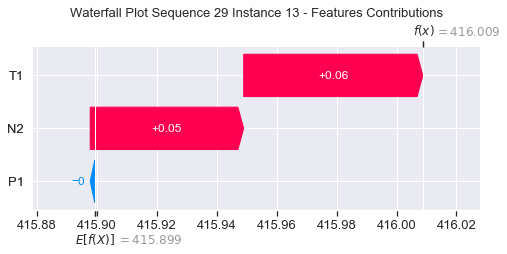

None

Contribution: [0.00339824 0.03048305 0.06153832]


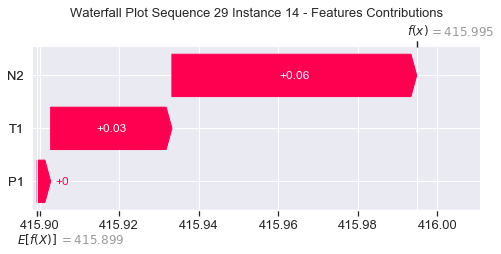

None

Contribution: [ 0.02327251 -0.01183813  0.07748311]


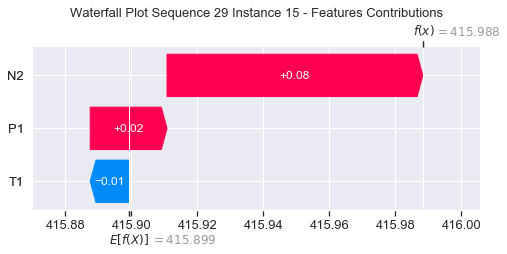

None

Contribution: [ 0.04603904 -0.09429     0.09870595]


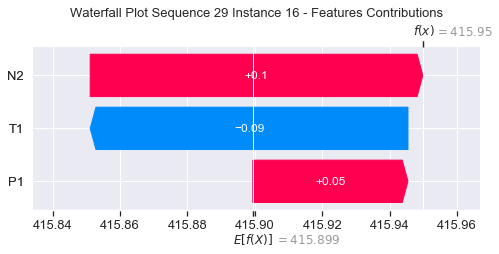

None

Contribution: [ 0.07346284 -0.16819493  0.12509669]


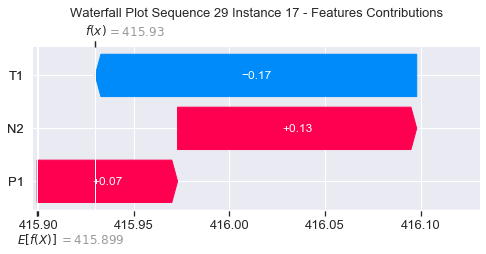

None

Contribution: [ 0.11230836 -0.29674137  0.16291901]


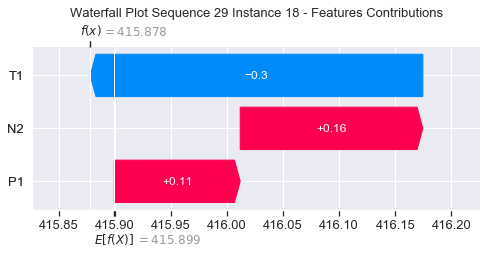

None

Contribution: [ 0.10448526 -0.38482618  0.20244268]


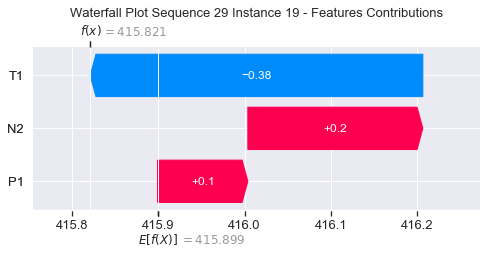

None

Contribution: [ 0.17608938 -0.72611524  0.27809144]


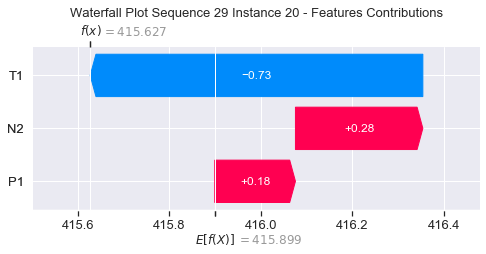

None

Contribution: [ 0.2404755  -1.18379136  0.39193938]


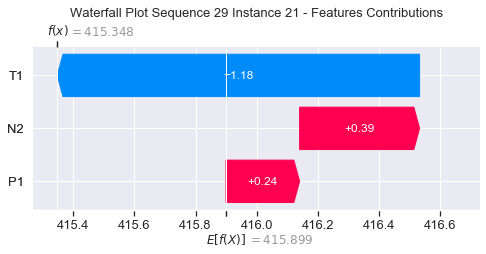

None

Contribution: [ 0.30635554 -2.30295364  0.68256832]


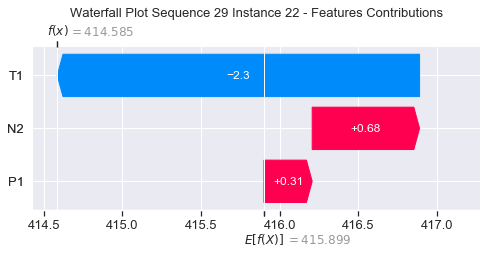

None

Contribution: [ 0.34381455 -2.40236758  0.83579016]


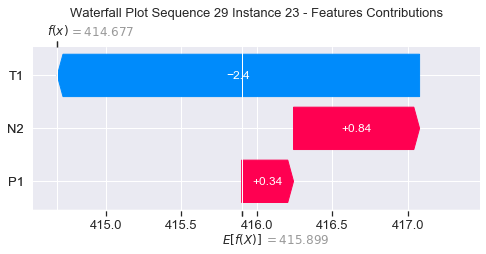

None

Contribution: [ 0.63861462 -7.4462584   2.64217923]


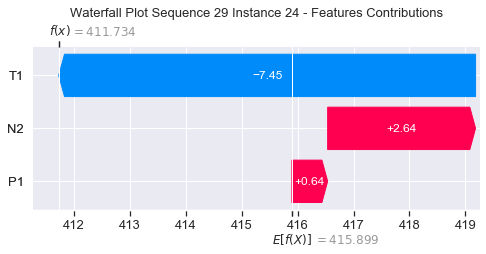

None

Contribution: [ 0.00467691  0.30803105 -0.02677968]


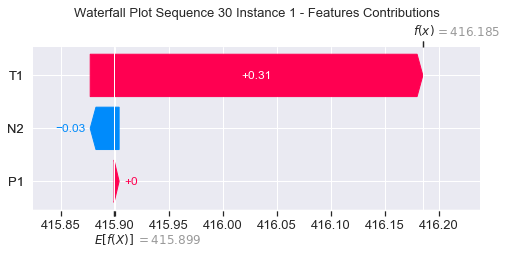

None

Contribution: [0.00194044 0.0326849  0.00074657]


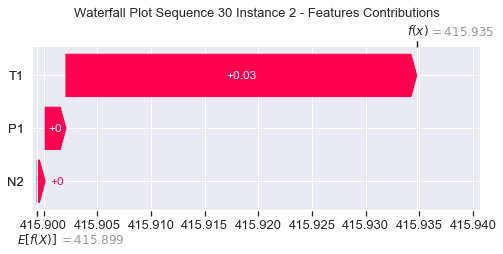

None

Contribution: [ 8.42198758e-05  2.11607562e-02 -4.92173047e-03]


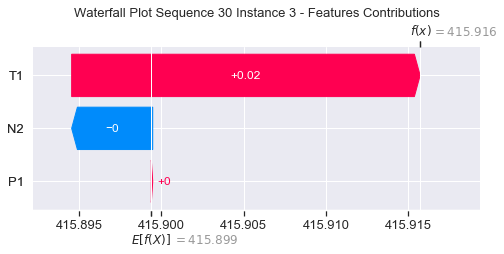

None

Contribution: [0.0054931  0.02213681 0.00352346]


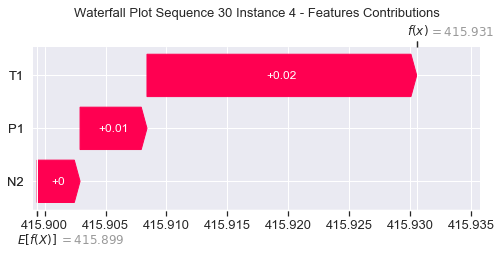

None

Contribution: [0.00227947 0.01762251 0.00792309]


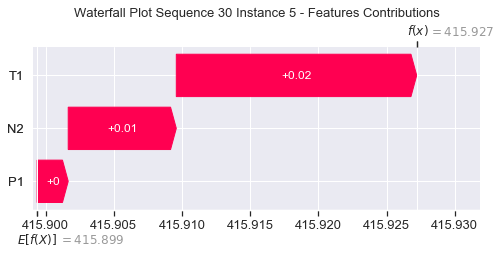

None

Contribution: [0.00345766 0.02490905 0.01074731]


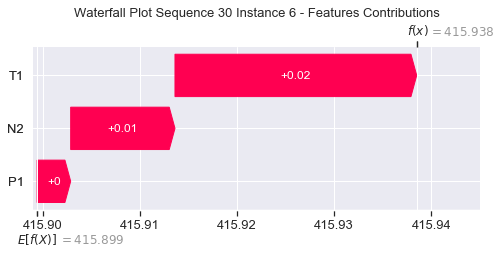

None

Contribution: [0.00459229 0.02983709 0.01457787]


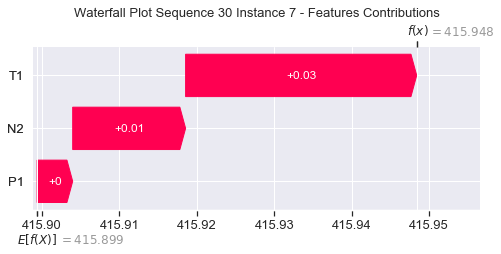

None

Contribution: [0.00602301 0.03342204 0.01914785]


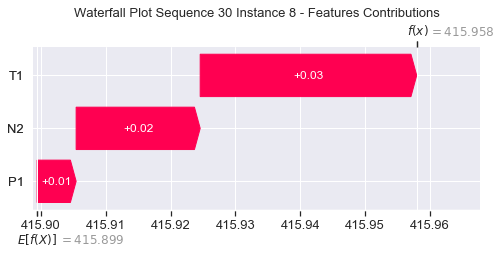

None

Contribution: [0.009208   0.0322807  0.02441066]


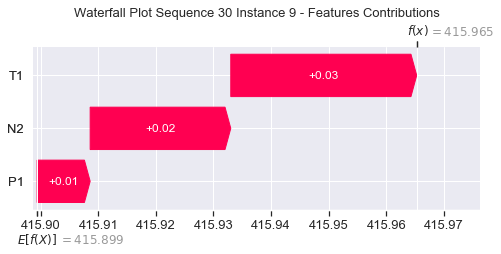

None

Contribution: [0.01131822 0.03662865 0.02884402]


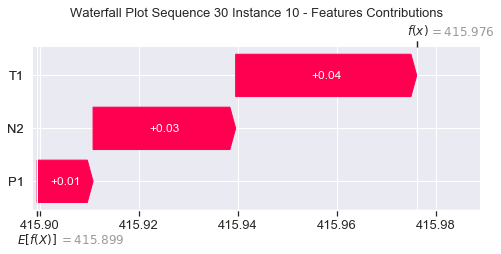

None

Contribution: [0.01441074 0.03683305 0.03642666]


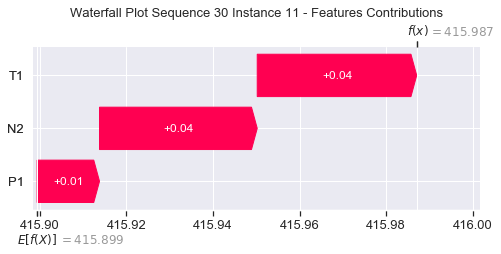

None

Contribution: [0.01557137 0.04139547 0.0444646 ]


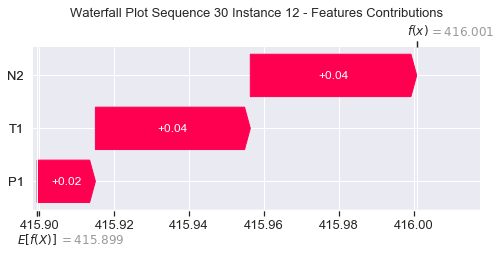

None

Contribution: [0.01772054 0.03606664 0.05319251]


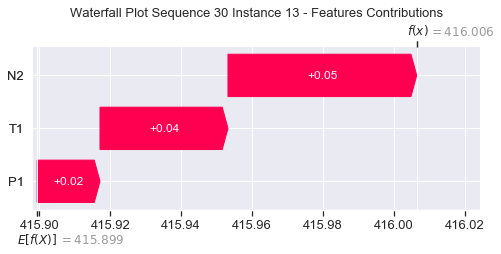

None

Contribution: [0.02069116 0.02851646 0.06419152]


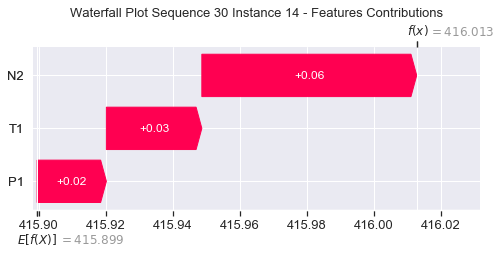

None

Contribution: [0.02513358 0.01395939 0.07693953]


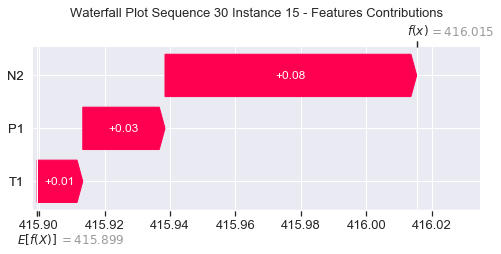

None

Contribution: [ 0.0310102  -0.00701744  0.09552135]


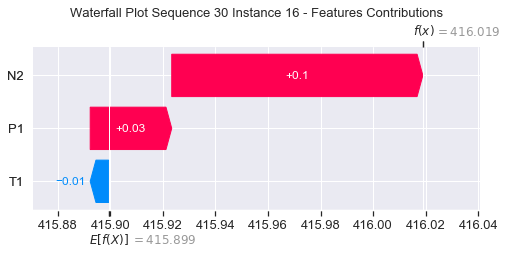

None

Contribution: [ 0.03738507 -0.04704138  0.11810188]


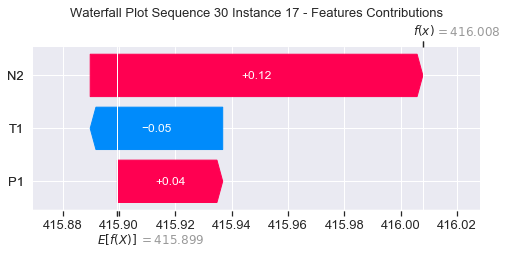

None

Contribution: [ 0.04615199 -0.11141906  0.14977517]


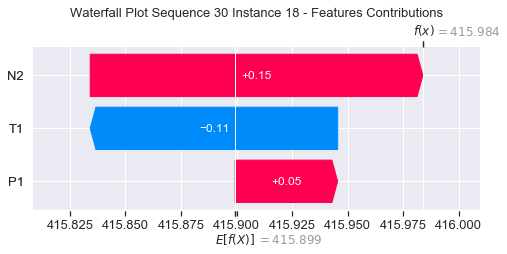

None

Contribution: [ 0.06068373 -0.18633606  0.20080399]


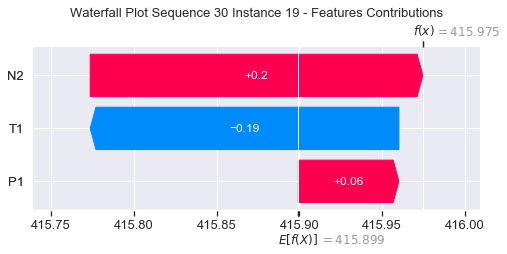

None

Contribution: [ 0.08002724 -0.36916501  0.25746896]


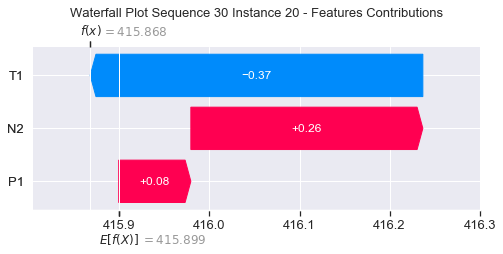

None

Contribution: [ 0.10770622 -0.65876054  0.36281209]


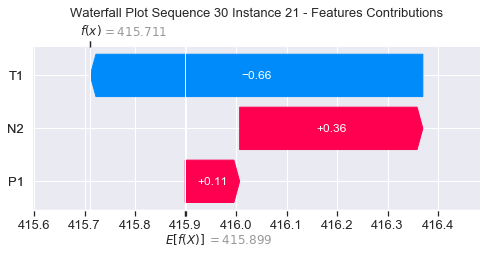

None

Contribution: [ 0.1483713  -1.42159937  0.64562634]


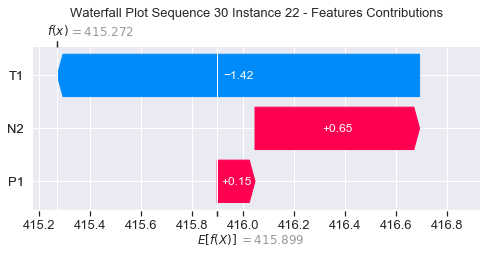

None

Contribution: [ 0.0798311  -1.58718102  0.763842  ]


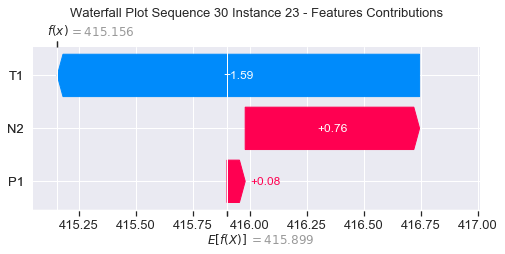

None

Contribution: [ 0.76387489 -5.57726128  2.53763824]


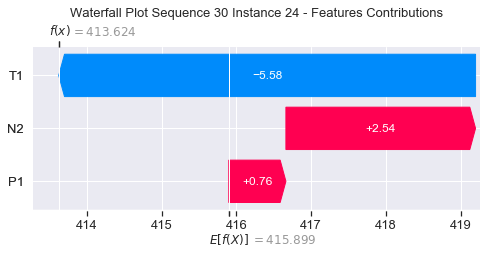

None

Contribution: [-0.00638129  0.29211082 -0.02693427]


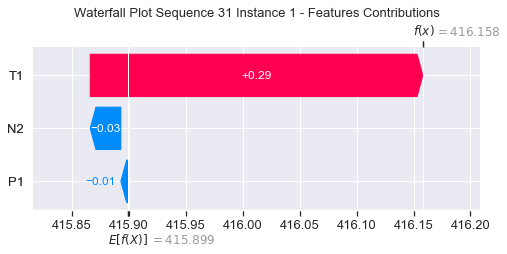

None

Contribution: [0.00188696 0.03194822 0.00058971]


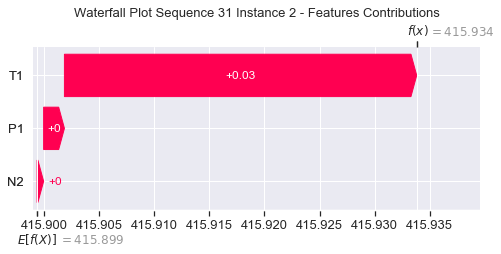

None

Contribution: [ 0.00028075  0.01318959 -0.00600519]


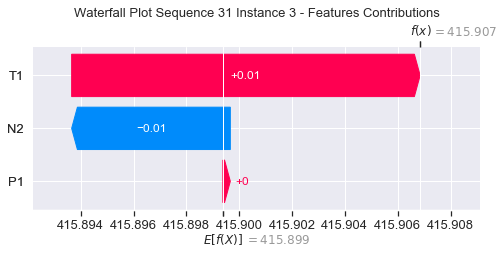

None

Contribution: [0.00239894 0.01211121 0.00292164]


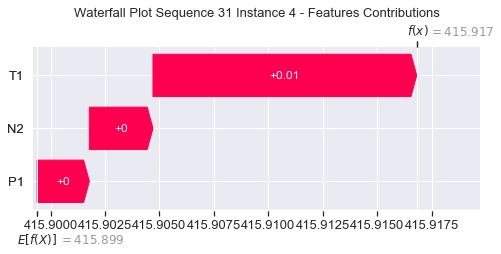

None

Contribution: [0.00221736 0.01748648 0.00629496]


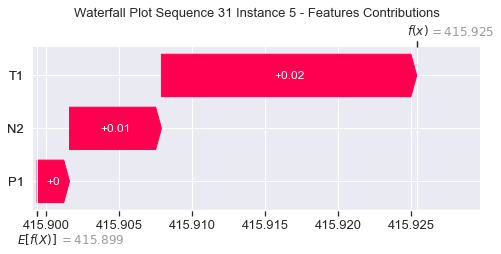

None

Contribution: [0.00465383 0.02368214 0.00948996]


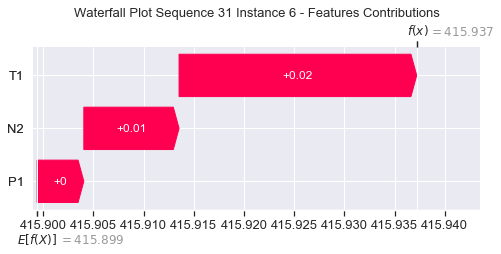

None

Contribution: [0.00551664 0.02850983 0.01311706]


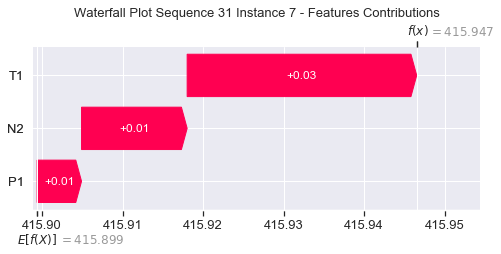

None

Contribution: [0.0063201  0.03233244 0.01742064]


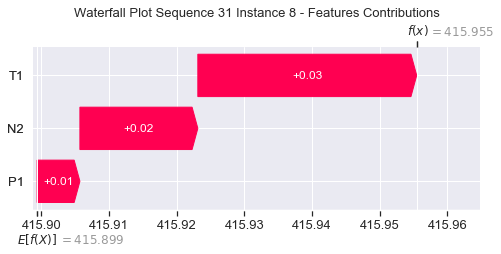

None

Contribution: [0.00499279 0.03425084 0.02185136]


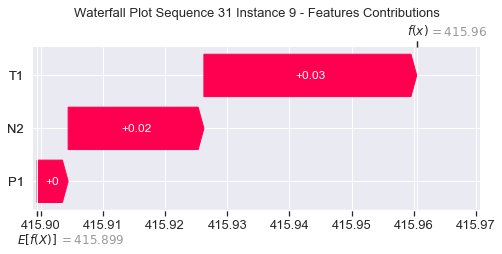

None

Contribution: [0.01074033 0.03302532 0.02791602]


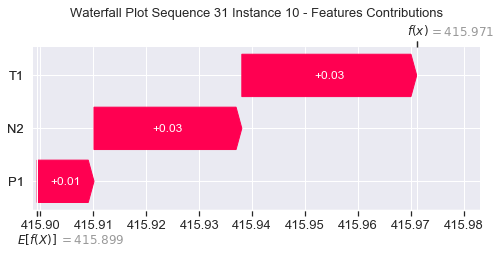

None

Contribution: [0.01129234 0.03686357 0.03487731]


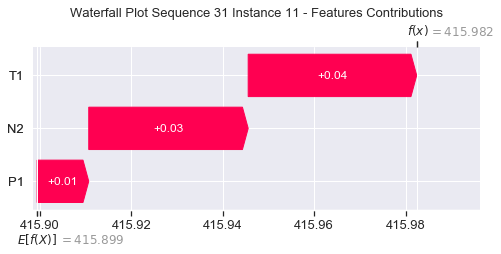

None

Contribution: [0.01598845 0.03988167 0.04397899]


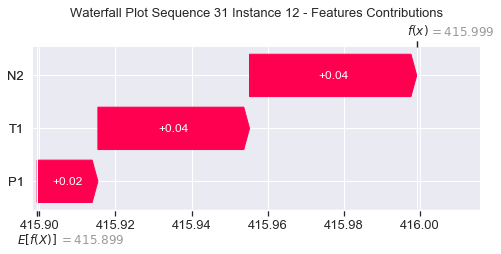

None

Contribution: [0.0176616  0.0353405  0.05243893]


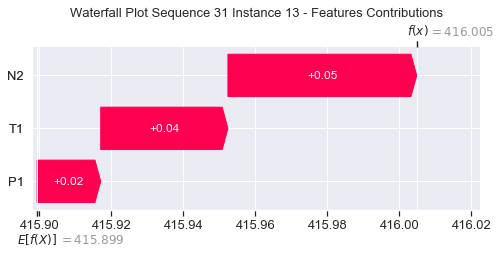

None

Contribution: [0.02127749 0.02857672 0.06282915]


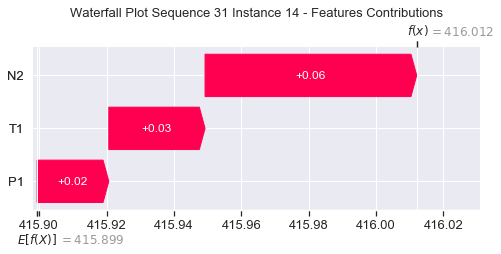

None

Contribution: [0.02506796 0.01504715 0.07654922]


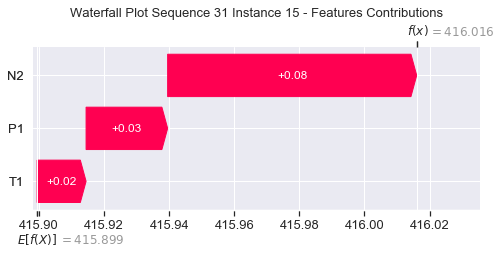

None

Contribution: [0.03047843 0.00168549 0.09558115]


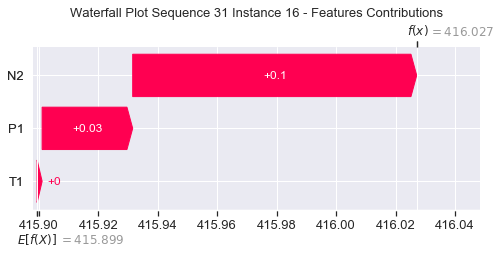

None

Contribution: [ 0.03848378 -0.04240663  0.1186152 ]


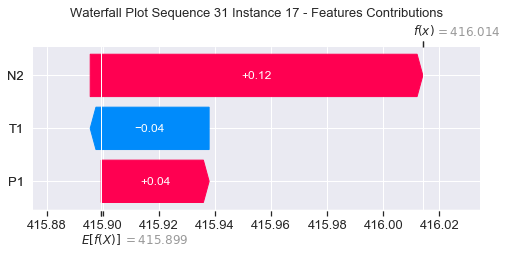

None

Contribution: [ 0.04871507 -0.10331288  0.15118113]


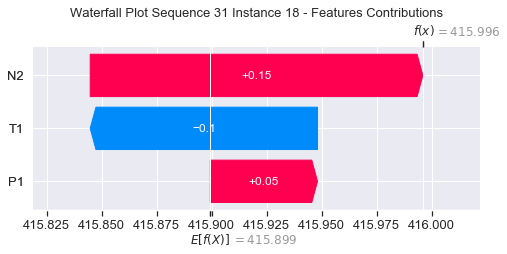

None

Contribution: [ 0.04631416 -0.21236648  0.20932435]


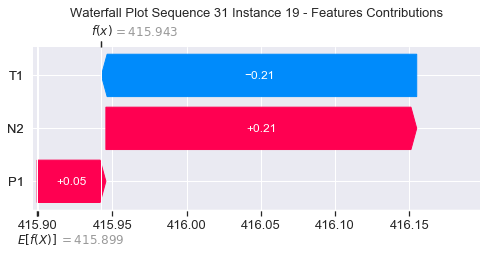

None

Contribution: [ 0.10672416 -0.36220648  0.27059478]


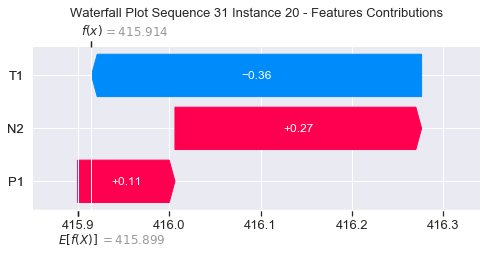

None

Contribution: [ 0.15940173 -0.64892547  0.38355538]


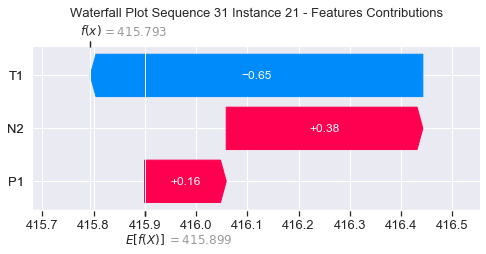

None

Contribution: [ 0.26727237 -1.4050077   0.6859133 ]


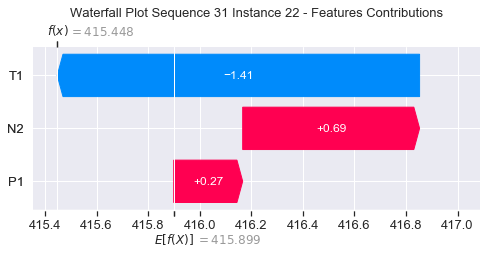

None

Contribution: [ 0.18989927 -1.54997319  0.79454207]


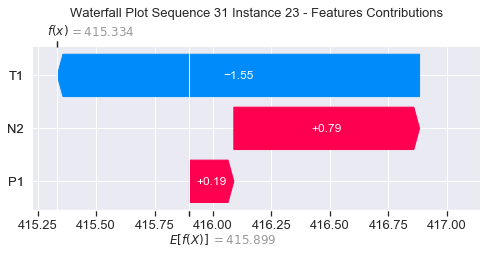

None

Contribution: [ 0.80286948 -6.14995571  2.58613568]


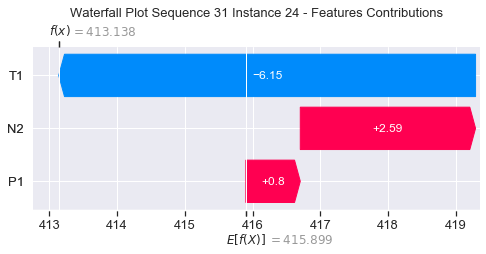

None

Contribution: [ 0.0063806   0.31975347 -0.02151712]


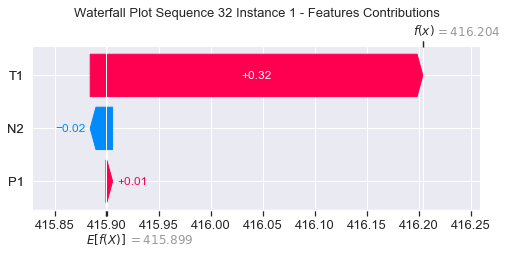

None

Contribution: [0.00172611 0.03073372 0.00051696]


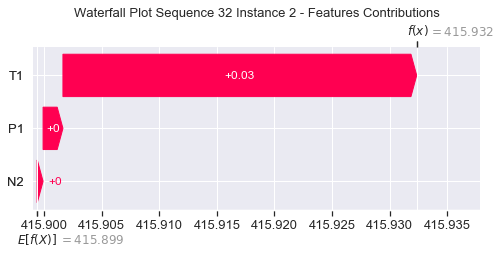

None

Contribution: [ 0.00128248  0.0149657  -0.00541582]


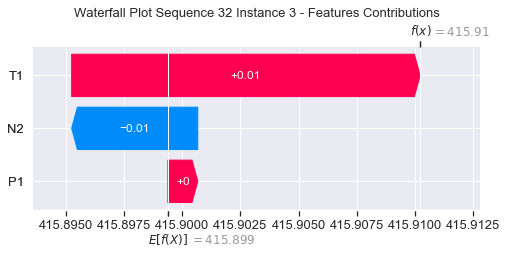

None

Contribution: [0.00079308 0.01344017 0.00123302]


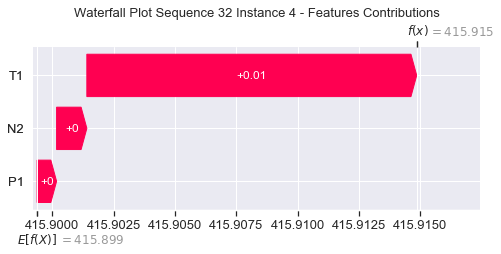

None

Contribution: [0.00047191 0.01865695 0.0045643 ]


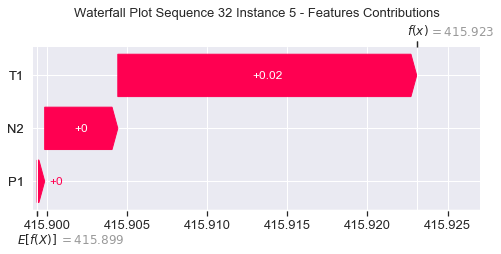

None

Contribution: [0.00116362 0.02567114 0.00694055]


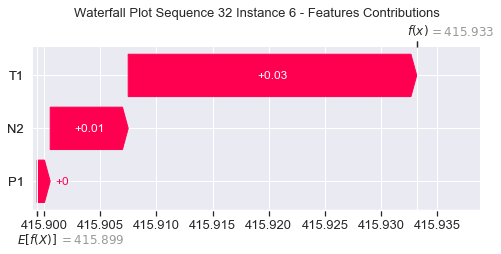

None

Contribution: [0.00208691 0.03056053 0.01015278]


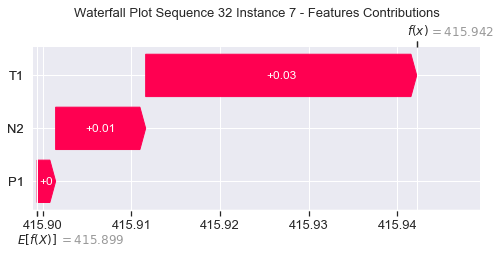

None

Contribution: [0.00377415 0.03470642 0.01462968]


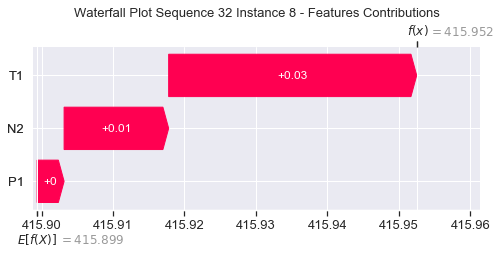

None

Contribution: [0.01220537 0.03497986 0.02246253]


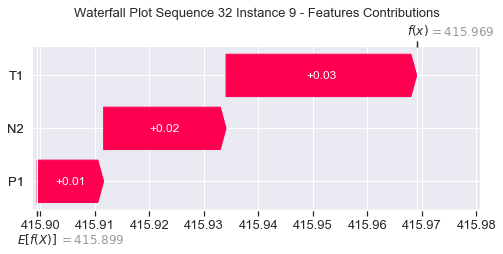

None

Contribution: [0.0181167  0.03615992 0.03010957]


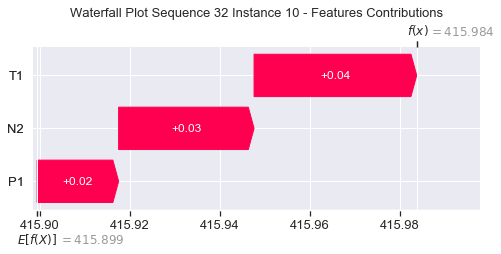

None

Contribution: [0.01526524 0.03843671 0.03466146]


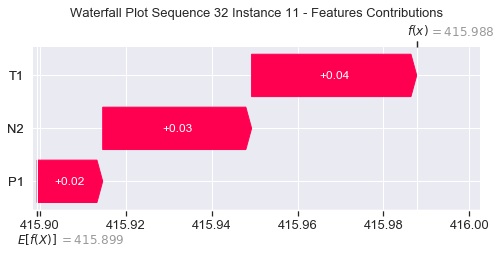

None

Contribution: [0.01122822 0.03953062 0.03948755]


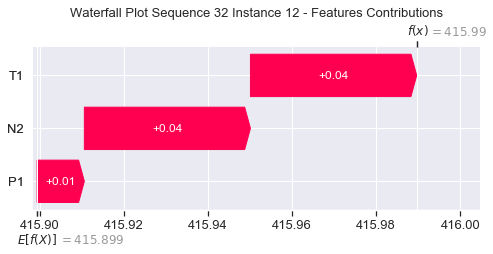

None

Contribution: [0.01451524 0.03517273 0.04876553]


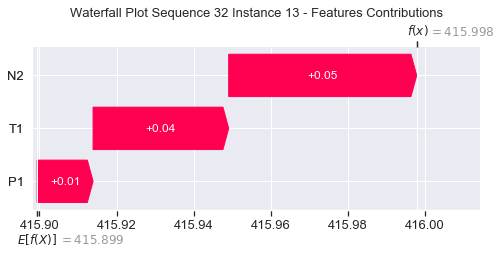

None

Contribution: [0.02021506 0.02732944 0.06061622]


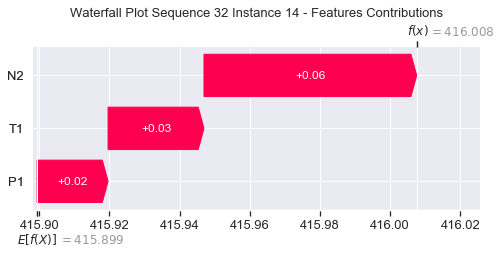

None

Contribution: [0.0246333  0.01316813 0.07578397]


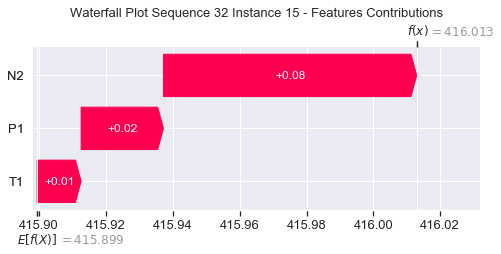

None

Contribution: [ 0.02920883 -0.01299434  0.0964498 ]


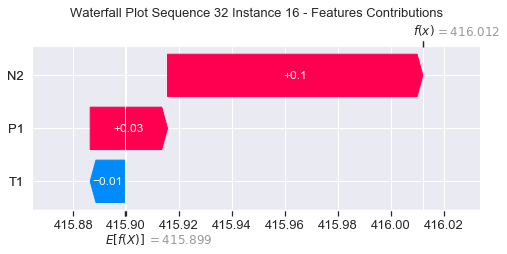

None

Contribution: [ 0.04129257 -0.05257119  0.12484657]


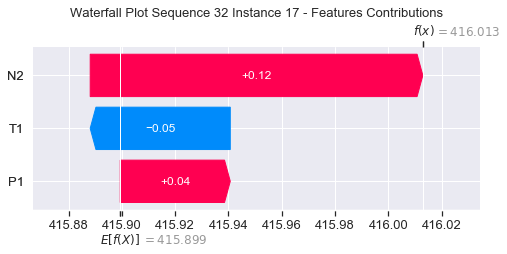

None

Contribution: [ 0.05381846 -0.1254822   0.16403004]


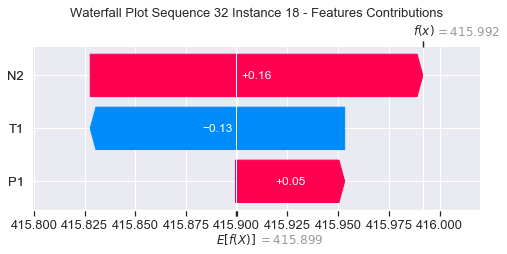

None

Contribution: [ 0.01097162 -0.31575957  0.20533749]


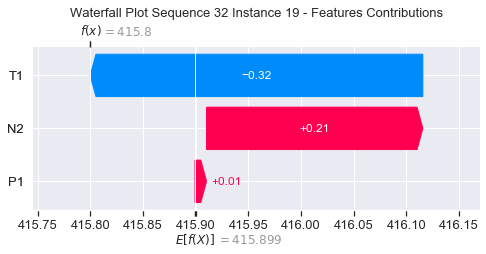

None

Contribution: [ 0.09232722 -0.45368576  0.30297457]


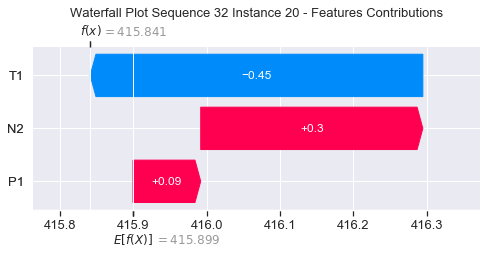

None

Contribution: [ 0.13732187 -0.78597245  0.44102766]


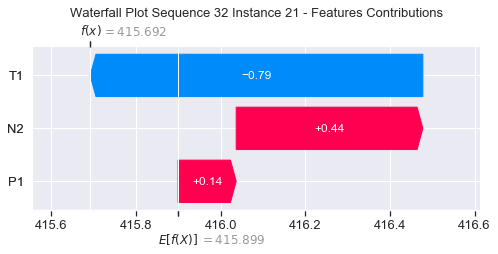

None

Contribution: [ 0.21547947 -1.73156071  0.8097981 ]


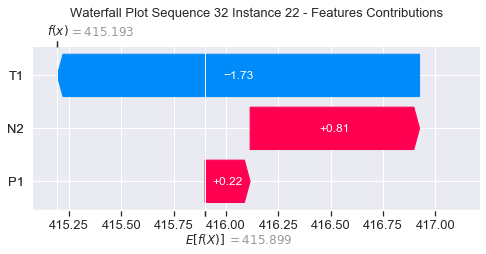

None

Contribution: [ 0.15325791 -1.90909262  0.93124393]


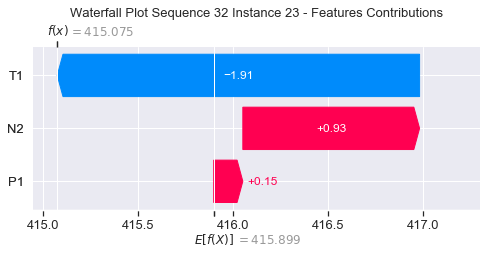

None

Contribution: [ 0.76292901 -7.33178647  3.14104579]


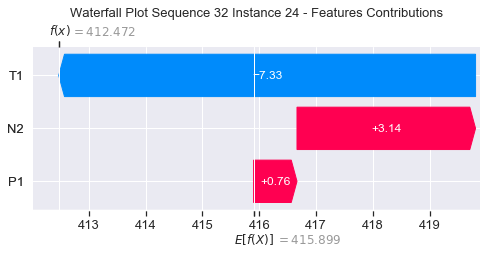

None

Contribution: [ 0.0006636   0.31366782 -0.03210979]


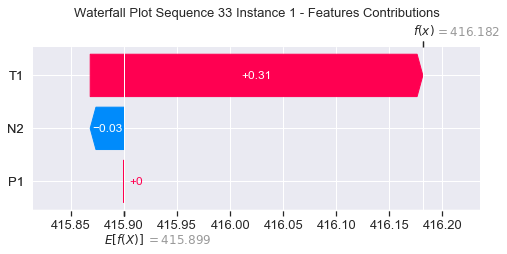

None

Contribution: [ 1.77484353e-03  3.16781929e-02 -7.42661875e-05]


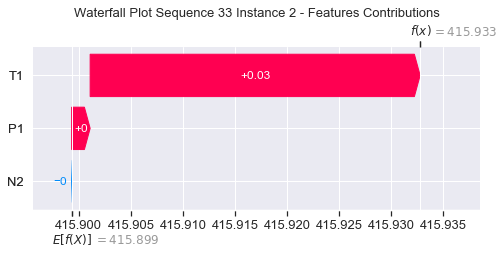

None

Contribution: [ 0.00159517  0.01859975 -0.00646404]


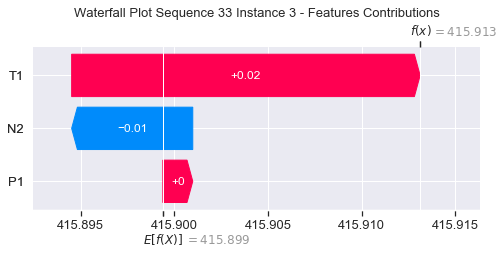

None

Contribution: [0.00051023 0.01229588 0.00116121]


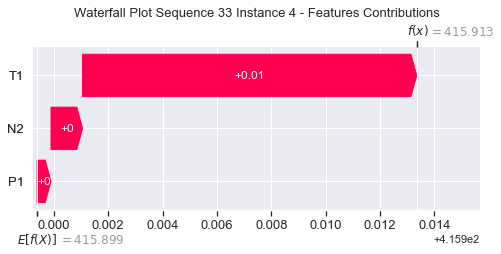

None

Contribution: [0.00422142 0.02186015 0.00594132]


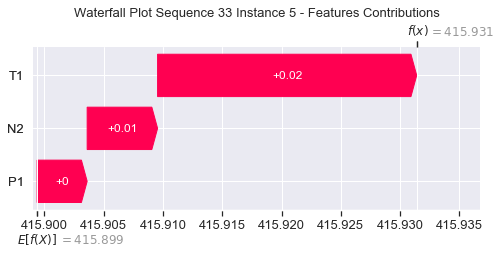

None

Contribution: [0.0030344  0.0280125  0.00826135]


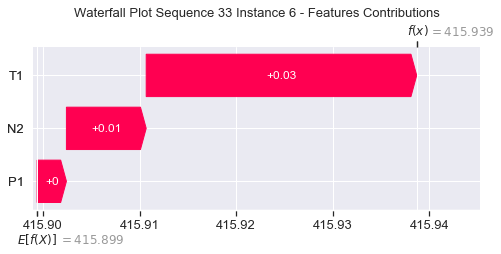

None

Contribution: [0.00495968 0.03462713 0.01207212]


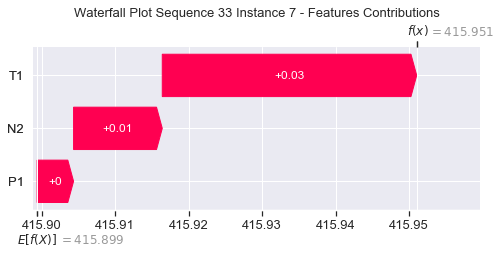

None

Contribution: [0.00688108 0.03902324 0.01651999]


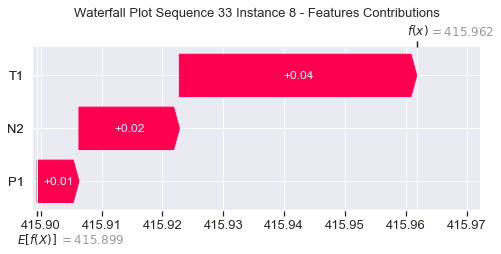

None

Contribution: [0.01710227 0.04265538 0.02271451]


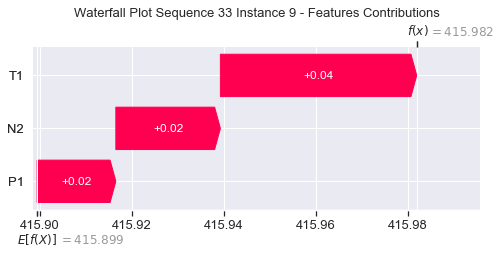

None

Contribution: [0.017595   0.04024022 0.02992238]


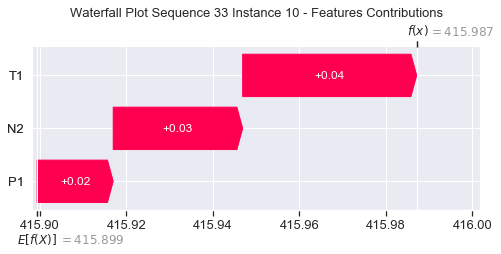

None

Contribution: [0.01633829 0.04257956 0.03403707]


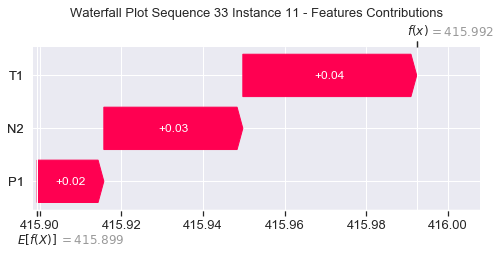

None

Contribution: [0.01387297 0.04657318 0.04290688]


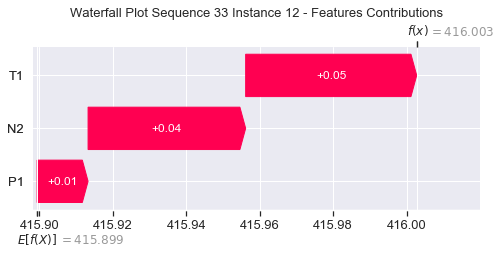

None

Contribution: [0.01746167 0.0396876  0.05198346]


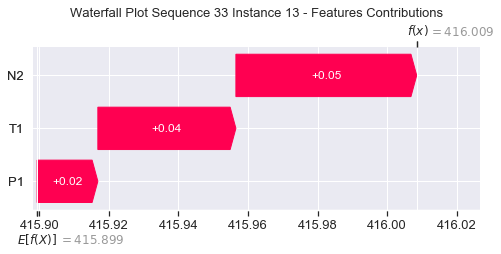

None

Contribution: [0.0211087  0.02803717 0.06347146]


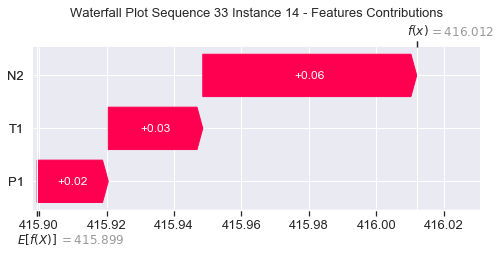

None

Contribution: [0.02498599 0.00738042 0.07652906]


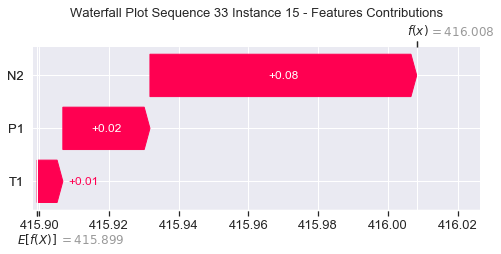

None

Contribution: [ 0.02831768 -0.02084087  0.09418699]


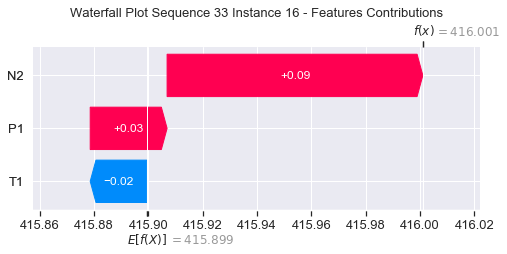

None

Contribution: [ 0.03581435 -0.08319248  0.11810879]


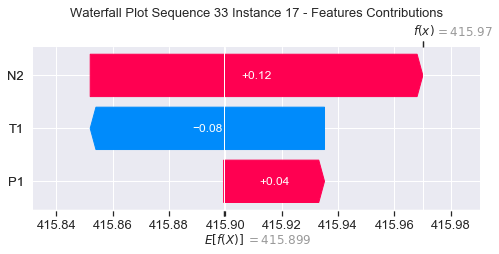

None

Contribution: [ 0.04417499 -0.17430782  0.14984191]


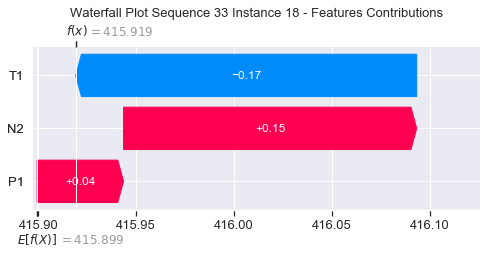

None

Contribution: [ 0.01889064 -0.3362762   0.18896725]


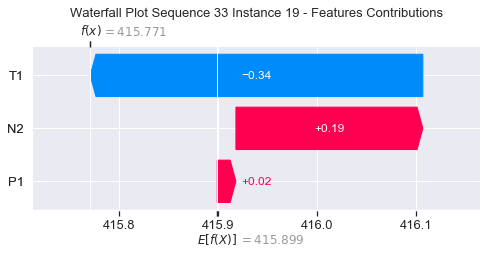

None

Contribution: [ 0.04138881 -0.57995346  0.25417631]


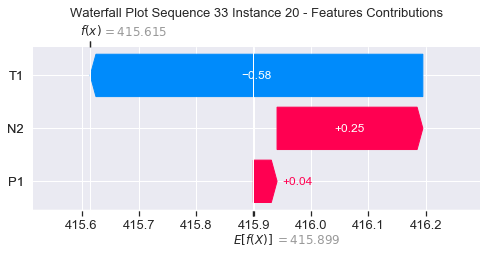

None

Contribution: [ 0.04555123 -1.01400977  0.35477987]


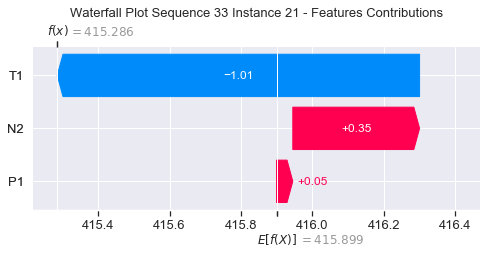

None

Contribution: [ 0.02394107 -2.21720675  0.62335397]


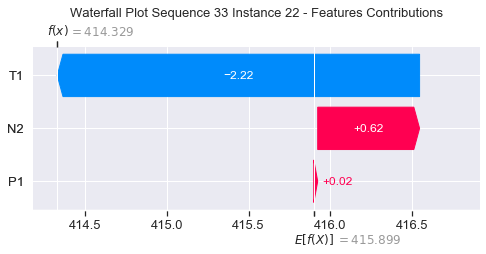

None

Contribution: [ 0.00363407 -2.34210936  0.73868241]


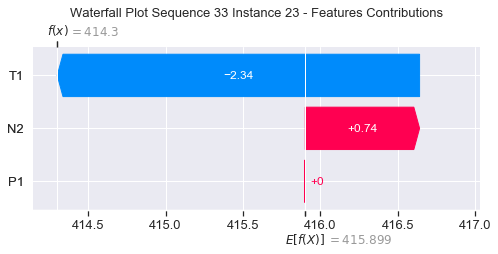

None

Contribution: [ 0.30423905 -8.79272552  2.47197899]


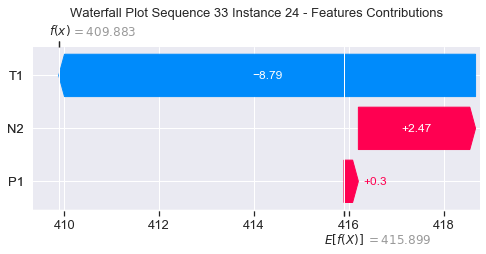

None

Contribution: [ 0.00113047  0.3333876  -0.02480132]


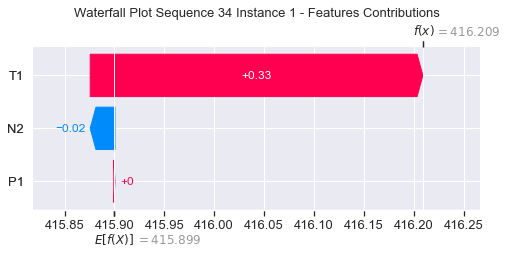

None

Contribution: [0.00195951 0.03271873 0.00110662]


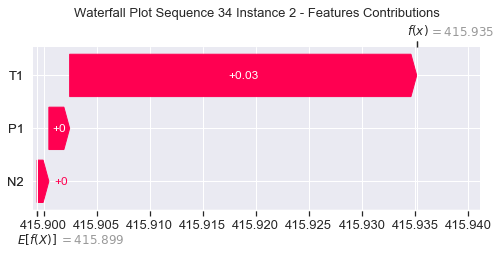

None

Contribution: [ 0.00104396  0.02481303 -0.00445832]


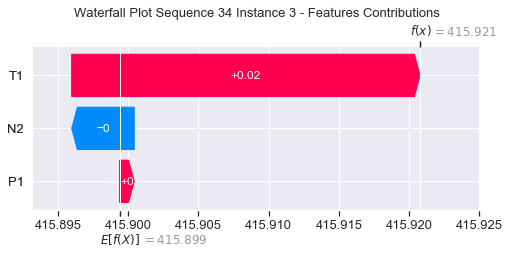

None

Contribution: [0.00292775 0.02107104 0.00349266]


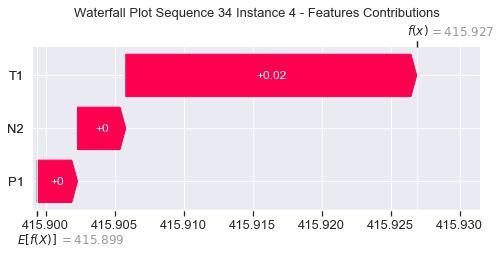

None

Contribution: [0.00569196 0.02824172 0.00929351]


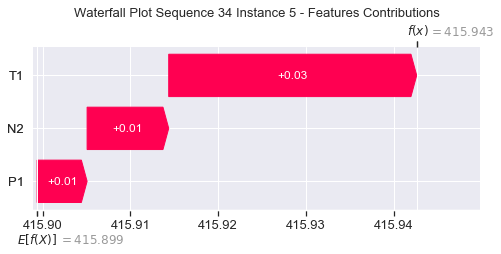

None

Contribution: [0.00702183 0.0360197  0.01182212]


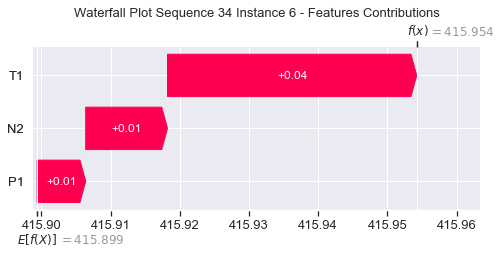

None

Contribution: [0.00876544 0.04254742 0.01559773]


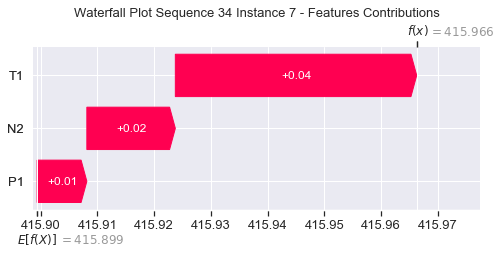

None

Contribution: [0.01143184 0.04808845 0.02027369]


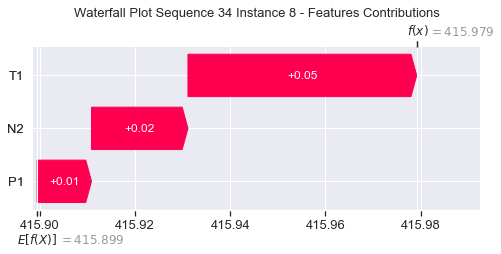

None

Contribution: [0.01926777 0.05198351 0.02451722]


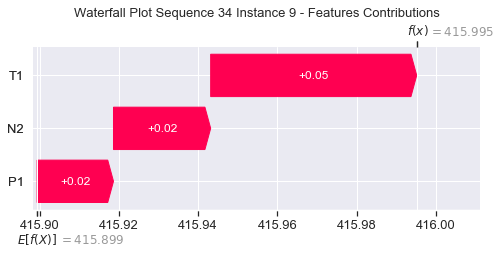

None

Contribution: [0.02386282 0.05432815 0.0295848 ]


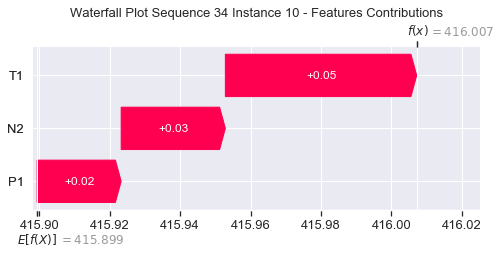

None

Contribution: [0.02500013 0.05242967 0.03677232]


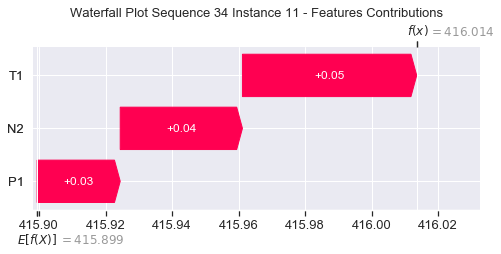

None

Contribution: [0.02259222 0.05015961 0.04491253]


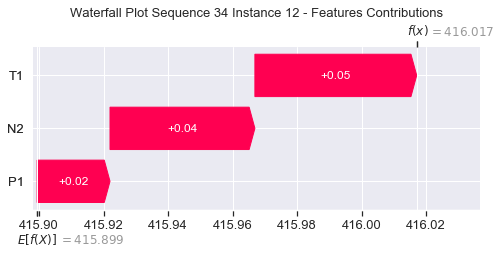

None

Contribution: [0.02355178 0.04190405 0.05354209]


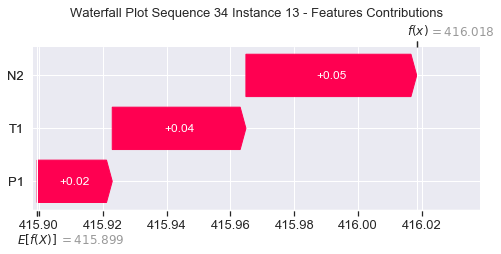

None

Contribution: [0.02804045 0.02847089 0.0638958 ]


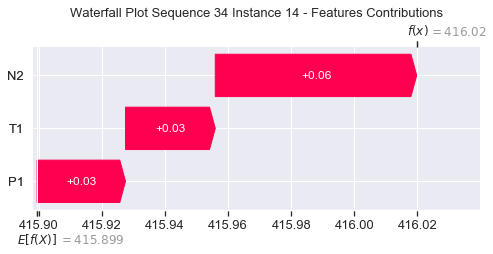

None

Contribution: [0.02565814 0.00481438 0.0770062 ]


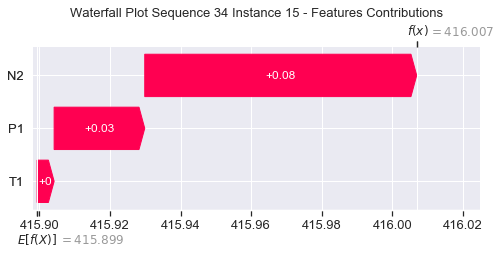

None

Contribution: [ 0.0280297  -0.0388157   0.09607678]


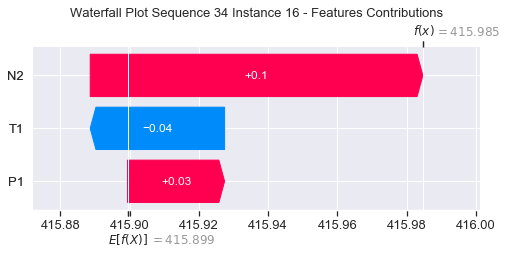

None

Contribution: [ 0.02710354 -0.09423187  0.11832448]


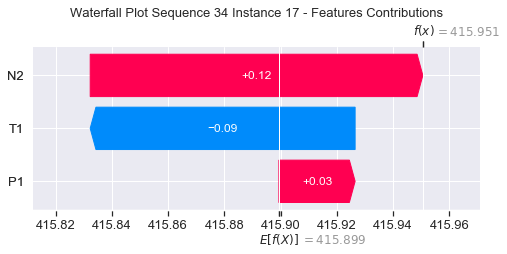

None

Contribution: [ 0.02644148 -0.19486887  0.15039474]


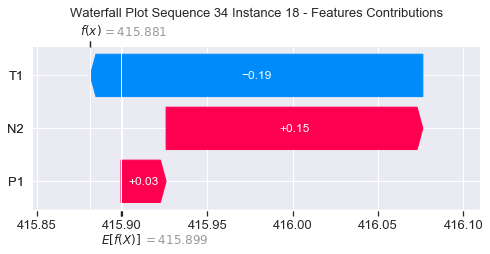

None

Contribution: [-0.01327949 -0.40176379  0.19525813]


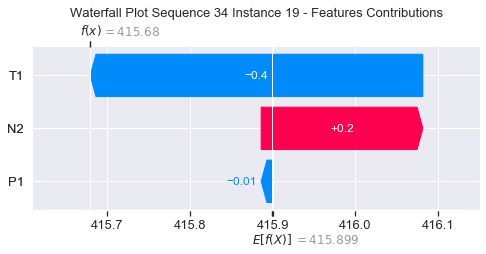

None

Contribution: [ 0.02835003 -0.63305626  0.25843438]


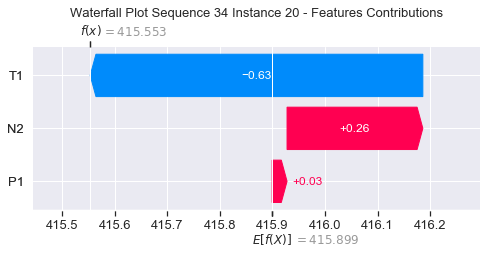

None

Contribution: [ 0.01373875 -1.084604    0.36404426]


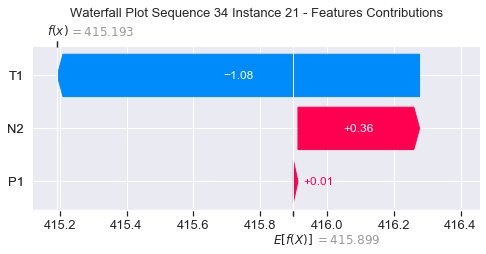

None

Contribution: [-0.0594601  -2.35297122  0.63878641]


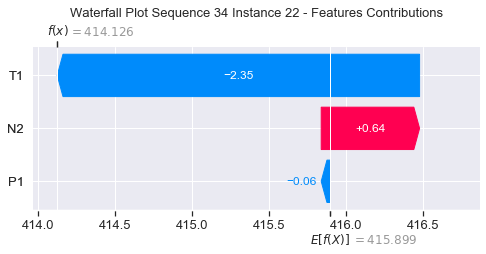

None

Contribution: [-0.1423796  -2.49513469  0.7688711 ]


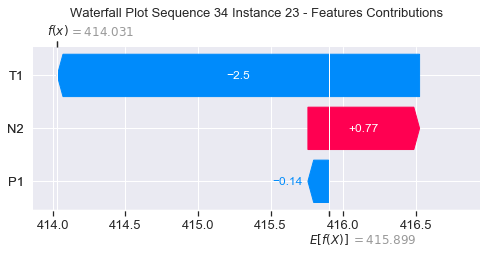

None

Contribution: [-0.06567622 -9.73191664  2.46237237]


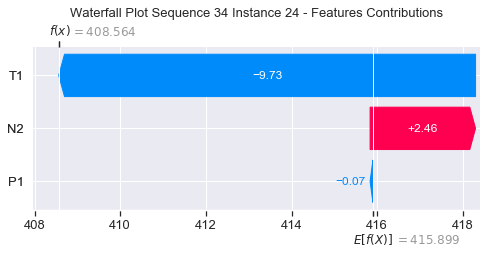

None

In [39]:
#Waterfall Plot for Consistency metric

sns.set()
instance = xtrain
explainer = shap.DeepExplainer(model3,instance)    
for s in range(0,34):
    instance=xtest[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("Waterfall Plot Sequence %s " %(s+1)+"Instance %i - Features Contributions" %(j+1),fontsize=13)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)